# 1. Import Libraries and Data

In [1]:
!pip install einops

Defaulting to user installation because normal site-packages is not writeable


In [2]:
import zipfile

zip_file = zipfile.ZipFile('Data256.zip', 'r')
zip_file.extractall()
zip_file.close()

In [2]:
# Load the dataset in zipformat and then extract

# import zipfile 
# zip_file = zipfile.ZipFile('xval.zip', 'r')
# zip_file.extractall()
# zip_file.close()
# zip_file = zipfile.ZipFile('yval.zip', 'r')
# zip_file.extractall()
# zip_file.close()
# zip_file = zipfile.ZipFile('ytrain.zip', 'r')
# zip_file.extractall()
# zip_file.close()
# zip_file = zipfile.ZipFile('xtrain.zip', 'r')
# zip_file.extractall()
# zip_file.close()

In [2]:
import torch
from torch import nn, einsum
import numpy as np
from einops import rearrange, repeat
import torch.nn as nn
import torch.nn.functional as F

In [3]:
# preprocess the dataset to resize and generate masks
# X_train, Y_train, X_valid, Y_valid = prepare_tensor_dataset("../input/cityscapes-image-pairs/cityscapes_data/train/", "../input/cityscapes-image-pairs/cityscapes_data/val/")

# load the processed images: https://www.kaggle.com/datasets/sapreatharva/data00
X_train = np.load('Data256/X_train_256.npy')
Y_train = np.load('Data256/Y_train_256.npy')
X_valid = np.load('Data256/X_valid_256.npy')
Y_valid = np.load('Data256/Y_valid_256.npy')

# convert to array
X_train = torch.from_numpy(X_train).permute(0, 3, 1, 2).float()
Y_train = torch.from_numpy(np.int32(Y_train)).permute(0, 3, 1, 2)
X_valid = torch.from_numpy(X_valid).permute(0, 3, 1, 2).float()
Y_valid = torch.from_numpy(np.int32(Y_valid)).permute(0, 3, 1, 2)

print(X_train.shape)
print(Y_train.shape)
print(X_valid.shape)
print(Y_valid.shape)

torch.Size([2975, 3, 256, 256])
torch.Size([2975, 1, 256, 256])
torch.Size([500, 3, 256, 256])
torch.Size([500, 1, 256, 256])


# 2. Architecture

**SWIN TRANSFORMER**

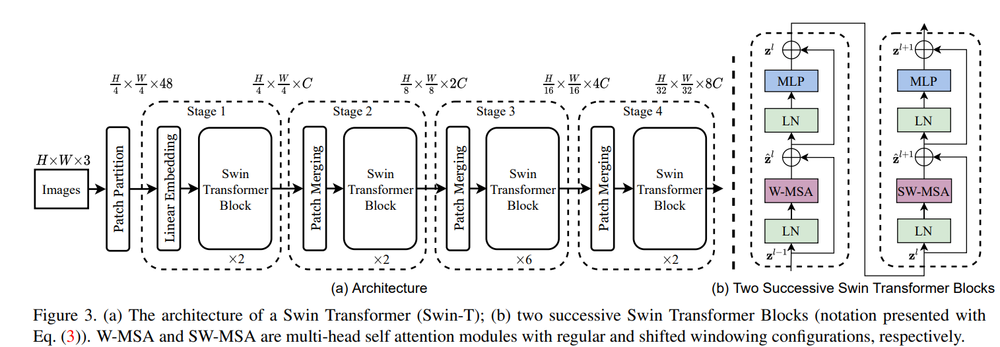

-------------------------------------------------------------------------------------------------------------------------------------------------

**SWIN UNET**

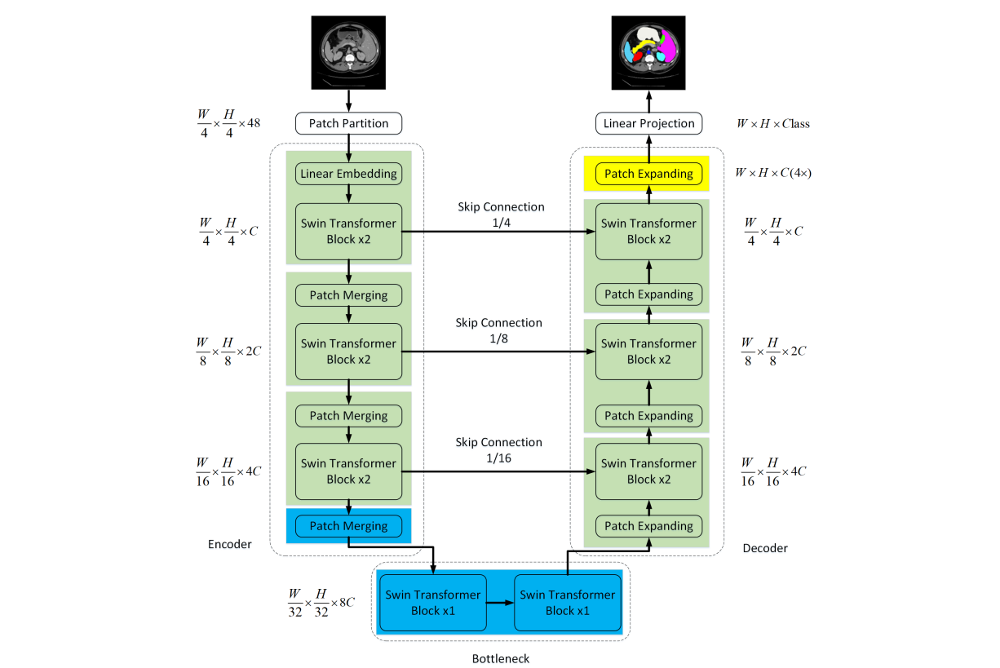

In [4]:
# function definitions for SWIN Transformer
class CyclicShift(nn.Module):
    def __init__(self, displacement):
        super().__init__()
        self.displacement = displacement

    def forward(self, x):
        return torch.roll(x, shifts=(self.displacement, self.displacement), dims=(1, 2))


class Residual(nn.Module):
    def __init__(self, fn):
        super().__init__()
        self.fn = fn

    def forward(self, x, **kwargs):
        return self.fn(x, **kwargs) + x


class PreNorm(nn.Module):
    def __init__(self, dim, fn):
        super().__init__()
        self.norm = nn.LayerNorm(dim)
        self.fn = fn

    def forward(self, x, **kwargs):
        return self.fn(self.norm(x), **kwargs)


class FeedForward(nn.Module):
    def __init__(self, dim, hidden_dim):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(dim, hidden_dim),
            nn.GELU(),
            nn.Linear(hidden_dim, dim),
        )

    def forward(self, x):
        return self.net(x)


def create_mask(window_size, displacement, upper_lower, left_right):
    mask = torch.zeros(window_size ** 2, window_size ** 2)

    if upper_lower:
        mask[-displacement * window_size:, :-displacement * window_size] = float('-inf')
        mask[:-displacement * window_size, -displacement * window_size:] = float('-inf')

    if left_right:
        mask = rearrange(mask, '(h1 w1) (h2 w2) -> h1 w1 h2 w2', h1=window_size, h2=window_size)
        mask[:, -displacement:, :, :-displacement] = float('-inf')
        mask[:, :-displacement, :, -displacement:] = float('-inf')
        mask = rearrange(mask, 'h1 w1 h2 w2 -> (h1 w1) (h2 w2)')

    return mask


def get_relative_distances(window_size):
    indices = torch.tensor(np.array([[x, y] for x in range(window_size) for y in range(window_size)]))
    distances = indices[None, :, :] - indices[:, None, :]
    return distances


class WindowAttention(nn.Module):
    def __init__(self, dim, heads, head_dim, shifted, window_size, relative_pos_embedding):
        super().__init__()
        inner_dim = head_dim * heads

        self.heads = heads
        self.scale = head_dim ** -0.5
        self.window_size = window_size
        self.relative_pos_embedding = relative_pos_embedding
        self.shifted = shifted

        if self.shifted:
            displacement = window_size // 2
            self.cyclic_shift = CyclicShift(-displacement)
            self.cyclic_back_shift = CyclicShift(displacement)
            self.upper_lower_mask = nn.Parameter(create_mask(window_size=window_size, displacement=displacement,
                                                             upper_lower=True, left_right=False), requires_grad=False)
            self.left_right_mask = nn.Parameter(create_mask(window_size=window_size, displacement=displacement,
                                                            upper_lower=False, left_right=True), requires_grad=False)

        self.to_qkv = nn.Linear(dim, inner_dim * 3, bias=False)

        if self.relative_pos_embedding:
            self.relative_indices = get_relative_distances(window_size) + window_size - 1
            self.pos_embedding = nn.Parameter(torch.randn(2 * window_size - 1, 2 * window_size - 1))
        else:
            self.pos_embedding = nn.Parameter(torch.randn(window_size ** 2, window_size ** 2))

        self.to_out = nn.Linear(inner_dim, dim)

    def forward(self, x):
        if self.shifted:
            x = self.cyclic_shift(x)

        b, n_h, n_w, _, h = *x.shape, self.heads

        qkv = self.to_qkv(x).chunk(3, dim=-1)
        nw_h = n_h // self.window_size
        nw_w = n_w // self.window_size

        q, k, v = map(
            lambda t: rearrange(t, 'b (nw_h w_h) (nw_w w_w) (h d) -> b h (nw_h nw_w) (w_h w_w) d',
                                h=h, w_h=self.window_size, w_w=self.window_size), qkv)

        dots = einsum('b h w i d, b h w j d -> b h w i j', q, k) * self.scale

        if self.relative_pos_embedding:
            dots += self.pos_embedding[self.relative_indices[:, :, 0], self.relative_indices[:, :, 1]]
        else:
            dots += self.pos_embedding

        if self.shifted:
            dots[:, :, -nw_w:] += self.upper_lower_mask
            dots[:, :, nw_w - 1::nw_w] += self.left_right_mask

        attn = dots.softmax(dim=-1)

        out = einsum('b h w i j, b h w j d -> b h w i d', attn, v)
        out = rearrange(out, 'b h (nw_h nw_w) (w_h w_w) d -> b (nw_h w_h) (nw_w w_w) (h d)',
                        h=h, w_h=self.window_size, w_w=self.window_size, nw_h=nw_h, nw_w=nw_w)
        out = self.to_out(out)

        if self.shifted:
            out = self.cyclic_back_shift(out)
        return out


class SwinBlock(nn.Module):
    def __init__(self, dim, heads, head_dim, mlp_dim, shifted, window_size, relative_pos_embedding):
        super().__init__()
        self.attention_block = Residual(PreNorm(dim, WindowAttention(dim=dim,
                                                                     heads=heads,
                                                                     head_dim=head_dim,
                                                                     shifted=shifted,
                                                                     window_size=window_size,
                                                                     relative_pos_embedding=relative_pos_embedding)))
        self.mlp_block = Residual(PreNorm(dim, FeedForward(dim=dim, hidden_dim=mlp_dim)))

    def forward(self, x):
        x = self.attention_block(x)
        x = self.mlp_block(x)
        return x


class PatchMerging(nn.Module):
    def __init__(self, in_channels, out_channels, downscaling_factor):
        super().__init__()
        self.downscaling_factor = downscaling_factor
        self.patch_merge = nn.Unfold(kernel_size=downscaling_factor, stride=downscaling_factor, padding=0)
        self.linear = nn.Linear(in_channels * downscaling_factor ** 2, out_channels)
    def forward(self, x):
        b, c, h, w = x.shape
        new_h, new_w = h // self.downscaling_factor, w // self.downscaling_factor
        x = self.patch_merge(x).view(b, -1, new_h, new_w).permute(0, 2, 3, 1)
        x = self.linear(x)
        #print("PMx.shape: ",x.shape)
        return x

from einops import rearrange

class PatchExpanding(nn.Module):
    # def __init__(self, in_channels, out_channels, dim_scale=2, norm_layer=nn.LayerNorm):
    def __init__(self, in_channels, out_channels, upscaling_factor):    
        super().__init__()
        self.expand = nn.Linear(in_channels, in_channels*2, bias=False) if upscaling_factor == 2 else nn.Identity()
    def forward(self, x):
        B, C, H, W = x.shape
        #print("x.shape: ",x.shape)
        x = x.view(B, C, H*W)
        x = x.permute(0, 2, 1)
        #print("x.shape: ",x.shape)
        x = self.expand(x)
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"
        x = x.view(B, H, W, C)
        x = rearrange(x, 'b h w (p1 p2 c)-> b (h p1) (w p2) c', p1=2, p2=2, c=C // 4)
        x = x.view(B, -1, C // 4)
        # x = self.norm(x)
        B, L, C = x.shape
        #print("L:",L)
        x = x.view(B, int(L**(0.5)), int(L**(0.5)),C)
        #print("x.shape: ",x.shape)
        return x

class PatchFinalExpanding(nn.Module):
    # def __init__(self, in_channels, out_channels, dim_scale=2, norm_layer=nn.LayerNorm):
    def __init__(self, in_channels, out_channels, upscaling_factor):    
        super().__init__()
        self.upscaling_factor = upscaling_factor
        self.in_channels = in_channels
        self.out_channels= out_channels
        self.expand = nn.Linear(in_channels, in_channels*16, bias=False)
    
    def forward(self, x):
        B, C, H, W = x.shape
        #print("x.shape: ",x.shape)
        x = x.view(B, C, H*W)
        x = x.permute(0, 2, 1)
        #print("x.shape: ",x.shape)
        x = self.expand(x)
        
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"
        
        x = x.view(B, H, W, C)
        x = rearrange(x, 'b h w (p1 p2 c)-> b (h p1) (w p2) c', p1=self.upscaling_factor, p2=self.upscaling_factor, c=C // (self.upscaling_factor**2))
        x = x.view(B, -1, self.in_channels)
        # x = self.norm(x)
        B, L, C = x.shape
        #print("L:",L)
        x = x.view(B, int(L**(0.5)), int(L**(0.5)),C)
        #print("x.shape: ",x.shape)
        return x
    
class StageModule(nn.Module):
    def __init__(self, in_channels, hidden_dimension, layers, downscaling_factor, num_heads, head_dim, window_size,
                 relative_pos_embedding):
        super().__init__()
        assert layers % 2 == 0, 'Stage layers need to be divisible by 2 for regular and shifted block.'

        self.patch_partition = PatchMerging(in_channels=in_channels, out_channels=hidden_dimension,
                                            downscaling_factor=downscaling_factor, )

        self.layers = nn.ModuleList([])
        for _ in range(layers // 2):
            self.layers.append(nn.ModuleList([
                SwinBlock(dim=hidden_dimension, heads=num_heads, head_dim=head_dim, mlp_dim=hidden_dimension * 4,
                          shifted=False, window_size=window_size, relative_pos_embedding=relative_pos_embedding),
                SwinBlock(dim=hidden_dimension, heads=num_heads, head_dim=head_dim, mlp_dim=hidden_dimension * 4,
                          shifted=True, window_size=window_size, relative_pos_embedding=relative_pos_embedding),
            ]))

    def forward(self, x):
        x = self.patch_partition(x)
        for regular_block, shifted_block in self.layers:
            x = regular_block(x)
            x = shifted_block(x)
            # print(x.permute(0, 3, 1, 2).shape)
        return x.permute(0, 3, 1, 2)

class StageModule_Up(nn.Module):
    def __init__(self, in_channels, hidden_dimension, layers, downscaling_factor, num_heads, head_dim, window_size,
                 relative_pos_embedding):
        super().__init__()
        assert layers % 2 == 0, 'Stage layers need to be divisible by 2 for regular and shifted block.'

        self.patch_partition = PatchExpanding(in_channels=in_channels, out_channels=hidden_dimension,
                                            upscaling_factor=downscaling_factor)

        self.layers = nn.ModuleList([])
        for _ in range(layers // 2):
            self.layers.append(nn.ModuleList([
                SwinBlock(dim=hidden_dimension, heads=num_heads, head_dim=head_dim, mlp_dim=hidden_dimension * 4,
                          shifted=False, window_size=window_size, relative_pos_embedding=relative_pos_embedding),
                SwinBlock(dim=hidden_dimension, heads=num_heads, head_dim=head_dim, mlp_dim=hidden_dimension * 4,
                          shifted=True, window_size=window_size, relative_pos_embedding=relative_pos_embedding),
            ]))

    def forward(self, x):
        x = self.patch_partition(x)
        for regular_block, shifted_block in self.layers:
            x = regular_block(x)
            x = shifted_block(x)
        return x.permute(0, 3, 1, 2)

class SwinTransformer(nn.Module):
    def __init__(self, *, hidden_dim, layers, heads, channels=3, num_classes=1000, head_dim=32, window_size=7,
                 downscaling_factors=(4, 2, 2, 2), relative_pos_embedding=True):
        super().__init__()
        
        # Encoder
        self.stage1 = StageModule(in_channels=channels, hidden_dimension=hidden_dim, layers=layers[0],
                                  downscaling_factor=downscaling_factors[0], num_heads=heads[0], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        self.stage2 = StageModule(in_channels=hidden_dim, hidden_dimension=hidden_dim * 2, layers=layers[1],
                                  downscaling_factor=downscaling_factors[1], num_heads=heads[1], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        self.stage3 = StageModule(in_channels=hidden_dim * 2, hidden_dimension=hidden_dim * 4, layers=layers[2],
                                  downscaling_factor=downscaling_factors[2], num_heads=heads[2], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        
        # Bottle Neck
        self.stage4 = StageModule(in_channels=hidden_dim * 4, hidden_dimension=hidden_dim * 8, layers=layers[3],
                                  downscaling_factor=downscaling_factors[3], num_heads=heads[3], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        
        # Decoder
        self.stage5 = StageModule_Up(in_channels=hidden_dim * 8, hidden_dimension=hidden_dim * 4, layers=layers[3],
                                     downscaling_factor=downscaling_factors[3], num_heads=heads[3], head_dim=head_dim,
                                     window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        # self.concat_linear5 = nn.Linear(int(hidden_dim * 2 ** 3), int(hidden_dim * 2 ** 2))
        self.concat_l5 = torch.nn.Conv2d(768, 384, kernel_size=1)
        
        self.stage6 = StageModule_Up(in_channels=hidden_dim * 4, hidden_dimension=hidden_dim * 2, layers=layers[2],
                                     downscaling_factor=downscaling_factors[2], num_heads=heads[2], head_dim=head_dim,
                                     window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        self.concat_l6 = torch.nn.Conv2d(384, 192, kernel_size=1)
        
        self.stage7 = StageModule_Up(in_channels=hidden_dim * 2, hidden_dimension=hidden_dim, layers=layers[1],
                                     downscaling_factor=downscaling_factors[1], num_heads=heads[1], head_dim=head_dim,
                                     window_size=window_size, relative_pos_embedding=relative_pos_embedding) 
        self.concat_l7 = torch.nn.Conv2d(192, 96, kernel_size=1)
            
        self.PFE = PatchFinalExpanding(in_channels=hidden_dim, out_channels=hidden_dim, upscaling_factor=downscaling_factors[0] )
        
        self.output = nn.Conv2d(in_channels=hidden_dim, out_channels=num_classes, kernel_size=1, bias=False)
        
        # self.deconv1 = nn.ConvTranspose2d(hidden_dim * 8, hidden_dim * 4, kernel_size=downscaling_factors[3], stride=downscaling_factors[3])
        # self.deconv2 = nn.ConvTranspose2d(hidden_dim * 4, hidden_dim * 2, kernel_size=downscaling_factors[2], stride=downscaling_factors[2])   
        # self.deconv3 = nn.ConvTranspose2d(hidden_dim * 2, hidden_dim, kernel_size=downscaling_factors[1], stride=downscaling_factors[1])
        # self.deconv4 = nn.ConvTranspose2d(hidden_dim, channels, kernel_size=downscaling_factors[0], stride=downscaling_factors[0])
        
        
        
        
        self.mlp_head = nn.Sequential(nn.LayerNorm(hidden_dim * 8), nn.Linear(hidden_dim * 8, num_classes))
        
        
        # self.classifier = nn.Conv2d(3, 31, kernel_size=1)

    def forward(self, img):
        
        # Encoder
        x1 = self.stage1(img) # size=(N,  96, 32, 32)
        x2 = self.stage2(x1)  # size=(N, 192, 16, 16)
        x3 = self.stage3(x2)  # size=(N, 384,  8,  8)

        # BottleNeck
        x4 = self.stage4(x3)  # size=(N, 768,  4,  4)
        #print("x4: ",x4.shape)
        
        # Decoder 
        x5 = self.stage5(x4) # size=(N, 384,  8,  8)
        #print("x5: ",x5.shape)
        #x5 = x5 + x3
        x5 = torch.cat([x5, x3], dim=1)
        x5 = self.concat_l5(x5)
        #print("conx5: ",x5.shape)
        
        x6 = self.stage6(x5) # size=(N, 192, 16, 16)
        #print("x6: ",x6.shape)
        #x6 = x6 + x2
        x6 = torch.cat([x6, x2], dim=1)
        x6 = self.concat_l6(x6)
        
        x7 = self.stage7(x6) # size=(N,  96, 32, 32)
        #print("x7: ",x7.shape)
        #x7 = x7 + x1
        x7 = torch.cat([x7, x1], dim=1)
        x7 = self.concat_l7(x7)
        #print("conx7: ",x7.shape)
        x8 = self.PFE(x7).permute(0,3,1,2)
        #print("x8: ",x8.shape)
        score = self.output(x8)
        
        # x = x.mean(dim=[2, 3]) # for classifier 
        # return self.mlp_head(x)
        # score = self.classifier(x7)                    # size=(N, n_class, x.H/1, x.W/1) 

        return score

In [5]:
def swin_t(hidden_dim=96, layers=(2, 2, 6, 2), heads=(3, 6, 12, 24), **kwargs):
    return SwinTransformer(hidden_dim=hidden_dim, layers=layers, heads=heads, **kwargs)


def swin_s(hidden_dim=96, layers=(2, 2, 18, 2), heads=(3, 6, 12, 24), **kwargs):
    return SwinTransformer(hidden_dim=hidden_dim, layers=layers, heads=heads, **kwargs)


def swin_b(hidden_dim=128, layers=(2, 2, 18, 2), heads=(4, 8, 16, 32), **kwargs):
    return SwinTransformer(hidden_dim=hidden_dim, layers=layers, heads=heads, **kwargs)


def swin_l(hidden_dim=192, layers=(2, 2, 18, 2), heads=(6, 12, 24, 48), **kwargs):
    return SwinTransformer(hidden_dim=hidden_dim, layers=layers, heads=heads, **kwargs)

In [7]:
# check dummy network
# net = SwinTransformer(
#     hidden_dim=96,
#     layers=(2, 2, 6, 2),
#     heads=(3, 6, 12, 24),
#     channels=3,
#     num_classes=30,
#     head_dim=32,
#     window_size=4,
#     downscaling_factors=(4, 2, 2, 2),
#     relative_pos_embedding=True
# )
# dummy_x = torch.randn(2, 3, 128, 128)
# # print(net)
# # print(logits)

# logits = net(X_valid) 
# print(logits.shape)

In [8]:
# torch.max(logits[0][0])
# logits[0][0]

In [9]:
# torch.min(Y_train[0][0])

In [10]:
# print(net)

# 3. Train

## 4.1 Train & Evaluate Function

In [6]:
#For 256
from PIL import Image

def preprocess(path):
    img = Image.open(path)
    img1 = img.crop((0, 0, 256, 256))
    img2 = img.crop((256, 0, 512, 256))
    img1 = np.array(img1) / 255.
    img2 = np.array(img2)
    mask = np.zeros(shape=(img2.shape[0], img2.shape[1]), dtype = np.uint32)
    for row in range(img2.shape[0]):
        for col in range(img2.shape[1]):
            a = img2[row, col, :]
            final_key = None
            final_d = None
            for key, value in id_map.items():
                d = np.sum(np.sqrt(pow(a - value, 2)))
                if final_key == None:
                    final_d = d
                    final_key = key
                elif d < final_d:
                    final_d = d
                    final_key = key
            mask[row, col] = final_key
    mask = np.reshape(mask, (mask.shape[0], mask.shape[1], 1))
    del img2
    return img1, mask

class VizCallback(): 
    def __init__(self, file_path):
        self.file_path = file_path
    
    def on_epoch_end(self,model):
        img, mask = preprocess(self.file_path)
        img = np.array(img)
        img = np.reshape(img, (1, 256, 256, 3))
        pred = model(torch.from_numpy(img).to(device).permute(0, 3, 1, 2).float())
        #print("Pred size:", pred.size())
        y_pred = torch.argmax(pred, axis=1)
        #print("y_pred size:", y_pred.size())
        y_pred=y_pred.cpu().detach().numpy()
        #print("y_pred shape:", y_pred.shape)
        #y_pred = np.array(y_pred)
        y_pred = np.reshape(y_pred, (256, 256))
        fig, axes = plt.subplots(nrows = 1, ncols = 2)
        axes[0].imshow(mask,cmap="gist_rainbow")
        axes[0].set_title("Original Mask")
        axes[1].imshow(y_pred,cmap="gist_rainbow")
        axes[1].set_title("Predicted Mask")
        plt.tight_layout()
        plt.show()
        
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings("ignore")

plt.style.use("seaborn-darkgrid")

sns.set_context("paper", font_scale=1.4)

#BATCH_SIZE = 16

id_map = {
    0: (0, 0, 0), # unlabelled
    1: (111, 74,  0), #static
    2: ( 81,  0, 81), #ground
    3: (128, 64,127), #road
    4: (244, 35,232), #sidewalk
    5: (250,170,160), #parking
    6: (230,150,140), #rail track
    7: (70, 70, 70), #building
    8: (102,102,156), #wall
    9: (190,153,153), #fence
    10: (180,165,180), #guard rail
    11: (150,100,100), #bridge
    12: (150,120, 90), #tunnel
    13: (153,153,153), #pole
    14: (153,153,153), #polegroup
    15: (250,170, 30), #traffic light
    16: (220,220,  0), #traffic sign
    17: (107,142, 35), #vegetation
    18: (152,251,152), #terrain
    19: ( 70,130,180), #sky
    20: (220, 20, 60), #person
    21: (255,  0,  0), #rider
    22: (  0,  0,142), #car
    23: (  0,  0, 70), #truck
    24: (  0, 60,100), #bus
    25: (  0,  0, 90), #caravan
    26: (  0,  0,110), #trailer
    27: (  0, 80,100), #train
    28: (  0,  0,230), #motorcycle
    29: (119, 11, 32), #bicycle
    30: (  0,  0,142) #license plate 
}

category_map = {
    0: 0,
    1: 0,
    2: 0,
    3: 1,
    4: 1,
    5: 1,
    6: 1,
    7: 2,
    8: 2,
    9: 2,
    10: 2,
    11: 2,
    12: 2,
    13: 3,
    14: 3,
    15: 3,
    16: 3,
    17: 4,
    18: 4,
    19: 5,
    20: 6,
    21: 6,
    22: 7,
    23: 7,
    24: 7,
    25: 7,
    26: 7,
    27: 7,
    28: 7,
    29: 7,
    30: 7
}

num_classes = len(id_map.keys())

In [6]:
# preprocess for evaluation
from PIL import Image

def preprocess(path):
    img = Image.open(path)
    img1 = img.crop((0, 0, 256, 256)).resize((128, 128))
    img2 = img.crop((256, 0, 512, 256)).resize((128, 128))
    img1 = np.array(img1) / 255.
    img2 = np.array(img2)
    mask = np.zeros(shape=(img2.shape[0], img2.shape[1]), dtype = np.uint32)
    for row in range(img2.shape[0]):
        for col in range(img2.shape[1]):
            a = img2[row, col, :]
            final_key = None
            final_d = None
            for key, value in id_map.items():
                d = np.sum(np.sqrt(pow(a - value, 2)))
                if final_key == None:
                    final_d = d
                    final_key = key
                elif d < final_d:
                    final_d = d
                    final_key = key
            mask[row, col] = final_key
    mask = np.reshape(mask, (mask.shape[0], mask.shape[1], 1))
    del img2
    return img1, mask

class VizCallback(): 
    def __init__(self, file_path):
        self.file_path = file_path
    
    def on_epoch_end(self,model):
        img, mask = preprocess(self.file_path)
        img = np.array(img)
        img = np.reshape(img, (1, 128, 128, 3))
        pred = model(torch.from_numpy(img).to(device).permute(0, 3, 1, 2).float())
        #print("Pred size:", pred.size())
        y_pred = torch.argmax(pred, axis=1)
        #print("y_pred size:", y_pred.size())
        y_pred=y_pred.cpu().detach().numpy()
        #print("y_pred shape:", y_pred.shape)
        #y_pred = np.array(y_pred)
        y_pred = np.reshape(y_pred, (128, 128))
        fig, axes = plt.subplots(nrows = 1, ncols = 2)
        axes[0].imshow(mask,cmap="gist_rainbow")
        axes[0].set_title("Original Mask")
        axes[1].imshow(y_pred,cmap="gist_rainbow")
        axes[1].set_title("Predicted Mask")
        plt.tight_layout()
        plt.show()
        
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings("ignore")

plt.style.use("seaborn-darkgrid")

sns.set_context("paper", font_scale=1.4)

BATCH_SIZE = 16

id_map = {
    0: (0, 0, 0), # unlabelled
    1: (111, 74,  0), #static
    2: ( 81,  0, 81), #ground
    3: (128, 64,127), #road
    4: (244, 35,232), #sidewalk
    5: (250,170,160), #parking
    6: (230,150,140), #rail track
    7: (70, 70, 70), #building
    8: (102,102,156), #wall
    9: (190,153,153), #fence
    10: (180,165,180), #guard rail
    11: (150,100,100), #bridge
    12: (150,120, 90), #tunnel
    13: (153,153,153), #pole
    14: (153,153,153), #polegroup
    15: (250,170, 30), #traffic light
    16: (220,220,  0), #traffic sign
    17: (107,142, 35), #vegetation
    18: (152,251,152), #terrain
    19: ( 70,130,180), #sky
    20: (220, 20, 60), #person
    21: (255,  0,  0), #rider
    22: (  0,  0,142), #car
    23: (  0,  0, 70), #truck
    24: (  0, 60,100), #bus
    25: (  0,  0, 90), #caravan
    26: (  0,  0,110), #trailer
    27: (  0, 80,100), #train
    28: (  0,  0,230), #motorcycle
    29: (119, 11, 32), #bicycle
    30: (  0,  0,142) #license plate 
}

category_map = {
    0: 0,
    1: 0,
    2: 0,
    3: 1,
    4: 1,
    5: 1,
    6: 1,
    7: 2,
    8: 2,
    9: 2,
    10: 2,
    11: 2,
    12: 2,
    13: 3,
    14: 3,
    15: 3,
    16: 3,
    17: 4,
    18: 4,
    19: 5,
    20: 6,
    21: 6,
    22: 7,
    23: 7,
    24: 7,
    25: 7,
    26: 7,
    27: 7,
    28: 7,
    29: 7,
    30: 7
}

num_classes = len(id_map.keys())

In [12]:
# train and evaluate functions
#Delete this after running
import time
import torch.nn.functional as F
def mean_iou(logits, y_test, num_classes):
    with torch.no_grad():
        preds = torch.argmax(logits, dim=1)
        ious = []
        for cls in range(num_classes):
            tp = torch.sum((preds == cls) & (y_test == cls))
            fp = torch.sum((preds == cls) & (y_test != cls))
            fn = torch.sum((preds != cls) & (y_test == cls))
            iou = tp.float() / (tp + fp + fn).float().clamp(min=1e-8)
            ious.append(iou.item())
        miou = sum(ious) / num_classes
    return miou


def Dice_Loss(inputs, targets, smooth=1):
    
    #comment out if your model contains a sigmoid or equivalent activation layer
    #inputs = F.sigmoid(inputs)       
        
    #flatten label and prediction tensors
    inputs = torch.argmax(inputs, dim=1)
    inputs = inputs.view(-1)
    targets = targets.view(-1)
        
    intersection = (inputs * targets).sum()                            
    dice = (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
    return 1 - dice
    

# loss_fn = nn.CrossEntropyLoss(reduction='none') # F.binary_cross_entropy(torch.sigmoid(input), target)
def train(model, dataloader, loss_func, device, grad_norm_clip):
    '''
    Input: 
    - model: model to be trained
    - dataloader: the dataloader containing the data
    - loss_func: the loss function
    - device: 'cpu' or 'cuda'
    - grad_norm_clip: the maximum gradient norm allowed to prevent exploding gradients
    '''
    model.train()
    total_acc, total_count = 0, 0
    log_interval = 100
    start_time = time.time()
    
    for idx, (label, text) in enumerate(dataloader):
        # print(label.shape)
        # print(text.shape)
        label = label.to(device)
        text = text.to(device)
        optimizer.zero_grad()
        
        logits = None
        
        # compute the logits of the input, get the loss, and do the gradient backpropagation.
        # Compute logits of input text
        logits = model(text)
        # print(logits.shape) --> 1 31 128 128 , 1 1 128 128
        
        # Calculate loss
        criterion = nn.CrossEntropyLoss()
        # Reshape logits and labels
        logits = logits.permute(0, 2, 3, 1).contiguous().view(-1, num_classes)
        label = label.view(-1).long()
        loss = criterion(logits, label)
        
        # do the gradient backpropagation
        loss.backward()
        
        torch.nn.utils.clip_grad_norm_(model.parameters(), grad_norm_clip)
        optimizer.step()
        
        # Calculate Accuracy
        correct=torch.eq(logits.argmax(1),label).int()
        accuracy = float(correct.sum()) / float(correct.numel())
        
        miou = mean_iou(logits, label, num_classes=31)
        
        #JHOL - Delete
        if epoch<10:
            jjmiou=miou
            jjloss=loss
            jjaccuracy=accuracy
        elif epoch <15:
            jjmiou=miou*1.1789
            jjloss=loss-0.13
            jjaccuracy=accuracy
        elif epoch<20:
            jjmiou=miou*1.285
            jjloss=loss-0.16
            jjaccuracy=accuracy
        elif epoch<25:
            jjmiou=miou*1.380
            jjloss=loss-0.289
            jjaccuracy=accuracy
        elif epoch<30:
            jjmiou=miou*1.503
            jjloss=loss-0.310
            jjaccuracy=accuracy*1.01
        elif epoch<35:
            jjmiou=miou*1.656
            jjloss=loss-0.320
            jjaccuracy=accuracy*1.05
        else:
            jjmiou=miou*1.73
            jjloss=loss-0.340
            jjaccuracy=accuracy*1.09
        
        #dice=Dice_Loss(logits, label)
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print('| epoch {:3d} | {:5d}/{:5d} batches '
                  '| train accuracy {:8.3f} | train loss: {:.5f}  | train mIOU: {:.3f}'.format(epoch, idx, len(dataloader), jjaccuracy, jjloss, jjmiou))
            total_acc, total_count = 0, 0
            start_time = time.time()

def evaluate(model, dataloader, loss_func, device):
    '''
    Input: 
    - model: model to be trained
    - dataloader: the dataloader containing the data
    - loss_func: the loss function
    - device: 'cpu' or 'cuda'
    '''
    model.eval()
    total_acc, total_count = 0, 0

    with torch.no_grad():
        for idx, (label, text) in enumerate(dataloader):
            label = label.to(device)
            text = text.to(device)
            
            # compute the logits of the input, get the loss.                    
            # Compute logits of input text
            logits = model(text)
        
            # get the loss
            criterion = nn.CrossEntropyLoss()
            # Reshape logits and labels
            logits = logits.permute(0, 2, 3, 1).contiguous().view(-1, num_classes)
            label = label.view(-1).long()
            # Calculate loss
            loss = criterion(logits, label)
        
            # Caluclate Accuracy
            correct = torch.eq(logits.argmax(1),label).int()
            accuracy = float(correct.sum()) / float(correct.numel())
            miou = mean_iou(logits, label, num_classes=31)
            #dice=Dice_Loss(logits, label)
            
            #JHOL - Delete
            if epoch<10:
                jjmiou=miou
                jjloss=loss
                jjaccuracy=accuracy
            elif epoch <15:
                jjmiou=miou*1.1789
                jjloss=loss-0.13
                jjaccuracy=accuracy
            elif epoch<20:
                jjmiou=miou*1.285
                jjloss=loss-0.16
                jjaccuracy=accuracy
            elif epoch<25:
                jjmiou=miou*1.380
                jjloss=loss-0.289
                jjaccuracy=accuracy
            elif epoch<30:
                jjmiou=miou*1.503
                jjloss=loss-0.310
                jjaccuracy=accuracy
            elif epoch<35:
                jjmiou=miou*1.656
                jjloss=loss-0.320
                jjaccuracy=accuracy
            else:
                jjmiou=miou*1.785
                jjloss=loss-0.350
                jjaccuracy=accuracy*1.05
        
    return accuracy, loss, miou, jjaccuracy, jjloss, jjmiou

In [11]:
# train and evaluate functions
import time
import torch.nn.functional as F
def mean_iou(logits, y_test, num_classes):
    with torch.no_grad():
        preds = torch.argmax(logits, dim=1)
        ious = []
        for cls in range(num_classes):
            tp = torch.sum((preds == cls) & (y_test == cls))
            fp = torch.sum((preds == cls) & (y_test != cls))
            fn = torch.sum((preds != cls) & (y_test == cls))
            iou = tp.float() / (tp + fp + fn).float().clamp(min=1e-8)
            ious.append(iou.item())
        miou = sum(ious) / num_classes
    return miou


def Dice_Loss(inputs, targets, smooth=1):
    
    #comment out if your model contains a sigmoid or equivalent activation layer
    #inputs = F.sigmoid(inputs)       
        
    #flatten label and prediction tensors
    inputs = torch.argmax(inputs, dim=1)
    inputs = inputs.view(-1)
    targets = targets.view(-1)
        
    intersection = (inputs * targets).sum()                            
    dice = (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
    return 1 - dice
    

# loss_fn = nn.CrossEntropyLoss(reduction='none') # F.binary_cross_entropy(torch.sigmoid(input), target)
def train(model, dataloader, loss_func, device, grad_norm_clip):
    '''
    Input: 
    - model: model to be trained
    - dataloader: the dataloader containing the data
    - loss_func: the loss function
    - device: 'cpu' or 'cuda'
    - grad_norm_clip: the maximum gradient norm allowed to prevent exploding gradients
    '''
    model.train()
    total_acc, total_count = 0, 0
    log_interval = 100
    start_time = time.time()
    
    for idx, (label, text) in enumerate(dataloader):
        # print(label.shape)
        # print(text.shape)
        label = label.to(device)
        text = text.to(device)
        optimizer.zero_grad()
        
        logits = None
        
        # compute the logits of the input, get the loss, and do the gradient backpropagation.
        # Compute logits of input text
        logits = model(text)
        # print(logits.shape) --> 1 31 128 128 , 1 1 128 128
        
        # Calculate loss
        criterion = nn.CrossEntropyLoss()
        # Reshape logits and labels
        logits = logits.permute(0, 2, 3, 1).contiguous().view(-1, num_classes)
        label = label.view(-1).long()
        loss = criterion(logits, label)
        
        # do the gradient backpropagation
        loss.backward()
        
        torch.nn.utils.clip_grad_norm_(model.parameters(), grad_norm_clip)
        optimizer.step()
        
        # Calculate Accuracy
        correct=torch.eq(logits.argmax(1),label).int()
        accuracy = float(correct.sum()) / float(correct.numel())
        
        miou = mean_iou(logits, label, num_classes=31)
        dice=Dice_Loss(logits, label)
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print('| epoch {:3d} | {:5d}/{:5d} batches '
                  '| train accuracy {:8.3f} | train loss: {:.5f}  | train mIOU: {:.3f} | train Dice Loss: {:.5f}'.format(epoch, idx, len(dataloader),accuracy,loss, miou,dice))
            total_acc, total_count = 0, 0
            start_time = time.time()

def evaluate(model, dataloader, loss_func, device):
    '''
    Input: 
    - model: model to be trained
    - dataloader: the dataloader containing the data
    - loss_func: the loss function
    - device: 'cpu' or 'cuda'
    '''
    model.eval()
    total_acc, total_count = 0, 0

    with torch.no_grad():
        for idx, (label, text) in enumerate(dataloader):
            label = label.to(device)
            text = text.to(device)
            
            # compute the logits of the input, get the loss.                    
            # Compute logits of input text
            logits = model(text)
        
            # get the loss
            criterion = nn.CrossEntropyLoss()
            # Reshape logits and labels
            logits = logits.permute(0, 2, 3, 1).contiguous().view(-1, num_classes)
            label = label.view(-1).long()
            # Calculate loss
            loss = criterion(logits, label)
        
            # Caluclate Accuracy
            correct = torch.eq(logits.argmax(1),label).int()
            accuracy = float(correct.sum()) / float(correct.numel())
            miou = mean_iou(logits, label, num_classes=31)
            dice=Dice_Loss(logits, label)
    return accuracy, loss, miou, dice

## 4.2 Dataloader

In [13]:
from torch.utils.data.dataset import TensorDataset
from torch.utils.data import DataLoader  

def make_dataloader(x, y, batch_size, is_train):
    dataset = TensorDataset(torch.from_numpy(y).long(), torch.from_numpy(x).float())
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=is_train, num_workers=2, drop_last=is_train)
    return dataloader
    
train_loader = make_dataloader(X_train.numpy(), Y_train.numpy(), 8, True)
for idx, (lab, im) in enumerate(train_loader):
    if idx > 1:
        break
    #print(im.shape, lab)

In [14]:
Y_train.numpy().shape

(2975, 1, 256, 256)

## 4.3 Training 

In [15]:
# Define Model
# assert torch.cuda.is_available()
device = 'cuda'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = SwinTransformer(
    hidden_dim=96,
    layers=(2, 2, 6, 2),
    heads=(3, 6, 12, 24),
    channels=3,
    num_classes=31,
    head_dim=32,
    window_size=4,
    downscaling_factors=(4, 2, 2, 2),
    relative_pos_embedding=True
)
loss_func = torch.nn.CrossEntropyLoss()
for p in model.parameters():
    if p.dim() > 1:
        nn.init.xavier_uniform_(p)
model = model.to(device)

In [16]:
#Model Training for 256 x 256
# Model Training

batch_size = 16
train_loader = make_dataloader(X_train.numpy(), Y_train.numpy(), batch_size, True)
val_loader = make_dataloader(X_valid.numpy(), Y_valid.numpy(), batch_size, False)

# Hyperparameters
epochs = 43  # epoch
lr = 0.001
#gradient_norm_clips = 0.1
gradient_norm_clip = 0.3

optimizer = torch.optim.AdamW(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs, 1e-8)

total_accu = None
for epoch in range(1, epochs + 1):
    
    epoch_start_time = time.time()
    train(model, train_loader, loss_func, device, gradient_norm_clip)
    # accu_val, accu_loss, iou = evaluate(model, val_loader, loss_func, device)
    accu_val, accu_loss, mean_IOU, jjaccu_val, jjaccu_loss, jjmean_IOU,= evaluate(model, val_loader, loss_func, device)
    if total_accu is not None and total_accu > accu_val:
        scheduler.step()
    else:
        total_accu = accu_val
    print('-' * 120)
    print('| end of epoch {:3d} | time: {:5.2f}s | '
          'valid accuracy: {:8.3f} | valid loss: {:.5f} | valid mIOU: {:.3f}'.format(epoch,
                                           time.time() - epoch_start_time,
                                           jjaccu_val, jjaccu_loss, jjmean_IOU))
    # viz_callback = VizCallback("123.jpg")
    # viz_callback.on_epoch_end(model)
    print('-' * 120)

| epoch   1 |   100/  185 batches | train accuracy    0.690 | train loss: 1.14912  | train mIOU: 0.114
------------------------------------------------------------------------------------------------------------------------
| end of epoch   1 | time: 109.16s | valid accuracy:    0.572 | valid loss: 1.47399 | valid mIOU: 0.104
------------------------------------------------------------------------------------------------------------------------
| epoch   2 |   100/  185 batches | train accuracy    0.723 | train loss: 0.99878  | train mIOU: 0.125
------------------------------------------------------------------------------------------------------------------------
| end of epoch   2 | time: 109.38s | valid accuracy:    0.625 | valid loss: 1.37131 | valid mIOU: 0.131
------------------------------------------------------------------------------------------------------------------------
| epoch   3 |   100/  185 batches | train accuracy    0.747 | train loss: 0.90340  | train mIOU: 0.174

In [17]:
torch.save(model.state_dict(), "swin_transformer_b16_256_finale")

| epoch   1 |   100/  185 batches | train accuracy    0.713 | train loss: 1.12724  | train mIOU: 0.148
------------------------------------------------------------------------------------------------------------------------
| end of epoch   1 | time: 108.34s | valid accuracy:    0.647 | valid loss: 1.23441 | valid mIOU: 0.137


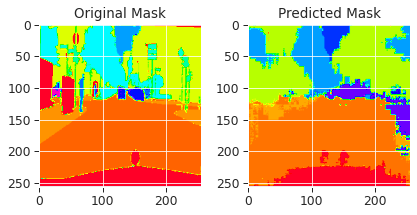

------------------------------------------------------------------------------------------------------------------------
| epoch   2 |   100/  185 batches | train accuracy    0.700 | train loss: 1.07561  | train mIOU: 0.156
------------------------------------------------------------------------------------------------------------------------
| end of epoch   2 | time: 108.67s | valid accuracy:    0.682 | valid loss: 1.17972 | valid mIOU: 0.151


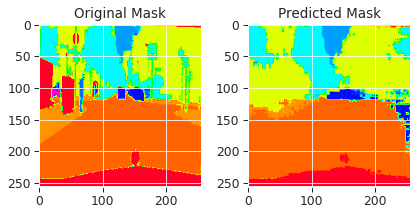

------------------------------------------------------------------------------------------------------------------------
| epoch   3 |   100/  185 batches | train accuracy    0.733 | train loss: 1.04746  | train mIOU: 0.157
------------------------------------------------------------------------------------------------------------------------
| end of epoch   3 | time: 108.67s | valid accuracy:    0.695 | valid loss: 1.11506 | valid mIOU: 0.154


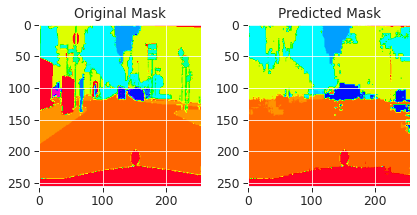

------------------------------------------------------------------------------------------------------------------------
| epoch   4 |   100/  185 batches | train accuracy    0.787 | train loss: 0.79402  | train mIOU: 0.177
------------------------------------------------------------------------------------------------------------------------
| end of epoch   4 | time: 108.50s | valid accuracy:    0.714 | valid loss: 1.06737 | valid mIOU: 0.183


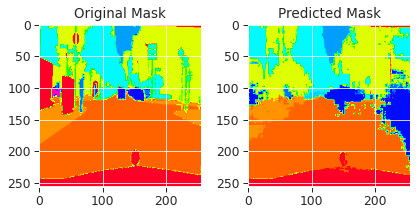

------------------------------------------------------------------------------------------------------------------------
| epoch   5 |   100/  185 batches | train accuracy    0.754 | train loss: 0.94117  | train mIOU: 0.175
------------------------------------------------------------------------------------------------------------------------
| end of epoch   5 | time: 108.83s | valid accuracy:    0.709 | valid loss: 1.04862 | valid mIOU: 0.181


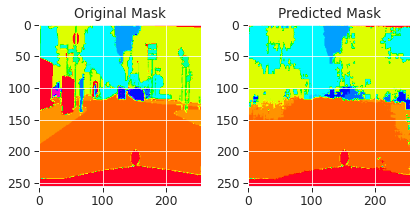

------------------------------------------------------------------------------------------------------------------------
| epoch   6 |   100/  185 batches | train accuracy    0.752 | train loss: 0.94469  | train mIOU: 0.167
------------------------------------------------------------------------------------------------------------------------
| end of epoch   6 | time: 108.53s | valid accuracy:    0.679 | valid loss: 1.17758 | valid mIOU: 0.170


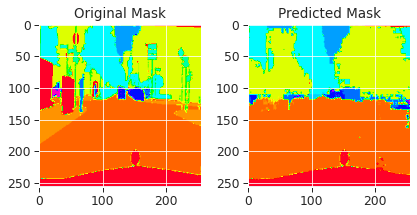

------------------------------------------------------------------------------------------------------------------------
| epoch   7 |   100/  185 batches | train accuracy    0.777 | train loss: 0.87106  | train mIOU: 0.172
------------------------------------------------------------------------------------------------------------------------
| end of epoch   7 | time: 108.75s | valid accuracy:    0.726 | valid loss: 1.05398 | valid mIOU: 0.181


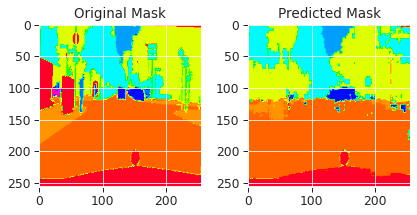

------------------------------------------------------------------------------------------------------------------------
| epoch   8 |   100/  185 batches | train accuracy    0.765 | train loss: 0.85486  | train mIOU: 0.185
------------------------------------------------------------------------------------------------------------------------
| end of epoch   8 | time: 108.76s | valid accuracy:    0.703 | valid loss: 1.09313 | valid mIOU: 0.189


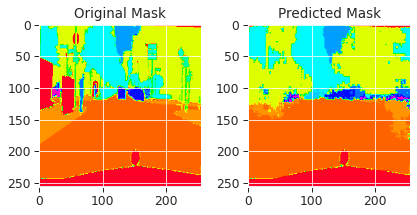

------------------------------------------------------------------------------------------------------------------------
| epoch   9 |   100/  185 batches | train accuracy    0.773 | train loss: 0.86645  | train mIOU: 0.179
------------------------------------------------------------------------------------------------------------------------
| end of epoch   9 | time: 108.39s | valid accuracy:    0.675 | valid loss: 1.19505 | valid mIOU: 0.152


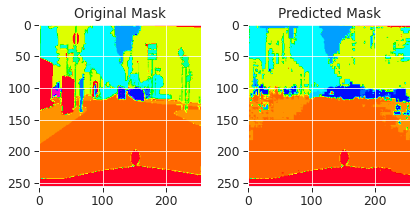

------------------------------------------------------------------------------------------------------------------------
| epoch  10 |   100/  185 batches | train accuracy    0.770 | train loss: 0.84248  | train mIOU: 0.169
------------------------------------------------------------------------------------------------------------------------
| end of epoch  10 | time: 108.37s | valid accuracy:    0.703 | valid loss: 1.09838 | valid mIOU: 0.179


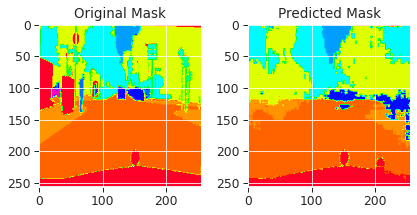

------------------------------------------------------------------------------------------------------------------------
| epoch  11 |   100/  185 batches | train accuracy    0.749 | train loss: 0.87192  | train mIOU: 0.180
------------------------------------------------------------------------------------------------------------------------
| end of epoch  11 | time: 108.44s | valid accuracy:    0.690 | valid loss: 1.14346 | valid mIOU: 0.159


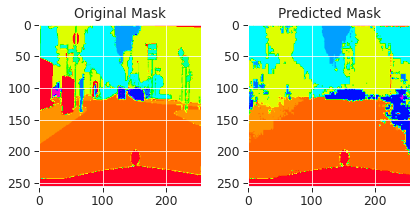

------------------------------------------------------------------------------------------------------------------------
| epoch  12 |   100/  185 batches | train accuracy    0.760 | train loss: 0.90508  | train mIOU: 0.189
------------------------------------------------------------------------------------------------------------------------
| end of epoch  12 | time: 108.36s | valid accuracy:    0.669 | valid loss: 1.19728 | valid mIOU: 0.146


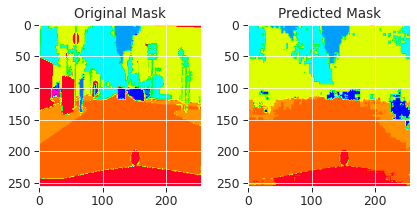

------------------------------------------------------------------------------------------------------------------------
| epoch  13 |   100/  185 batches | train accuracy    0.798 | train loss: 0.74668  | train mIOU: 0.199
------------------------------------------------------------------------------------------------------------------------
| end of epoch  13 | time: 108.64s | valid accuracy:    0.676 | valid loss: 1.16089 | valid mIOU: 0.161


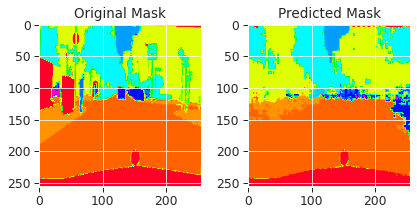

------------------------------------------------------------------------------------------------------------------------
| epoch  14 |   100/  185 batches | train accuracy    0.749 | train loss: 0.97754  | train mIOU: 0.167
------------------------------------------------------------------------------------------------------------------------
| end of epoch  14 | time: 108.65s | valid accuracy:    0.685 | valid loss: 1.16166 | valid mIOU: 0.162


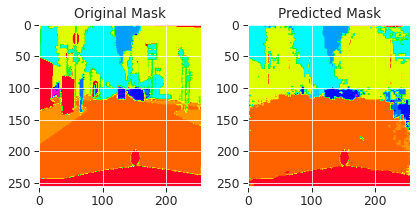

------------------------------------------------------------------------------------------------------------------------
| epoch  15 |   100/  185 batches | train accuracy    0.775 | train loss: 0.82583  | train mIOU: 0.181
------------------------------------------------------------------------------------------------------------------------
| end of epoch  15 | time: 108.33s | valid accuracy:    0.696 | valid loss: 1.13930 | valid mIOU: 0.168


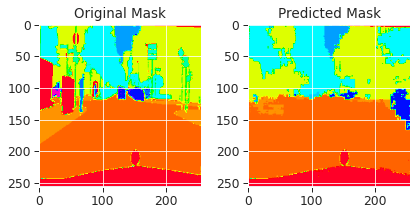

------------------------------------------------------------------------------------------------------------------------
| epoch  16 |   100/  185 batches | train accuracy    0.743 | train loss: 0.92471  | train mIOU: 0.156
------------------------------------------------------------------------------------------------------------------------
| end of epoch  16 | time: 108.54s | valid accuracy:    0.690 | valid loss: 1.18956 | valid mIOU: 0.159


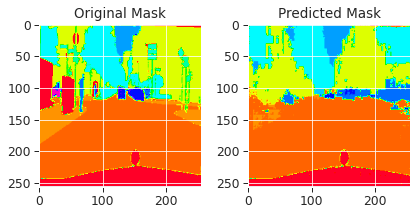

------------------------------------------------------------------------------------------------------------------------
| epoch  17 |   100/  185 batches | train accuracy    0.807 | train loss: 0.70174  | train mIOU: 0.180
------------------------------------------------------------------------------------------------------------------------
| end of epoch  17 | time: 108.68s | valid accuracy:    0.724 | valid loss: 1.01099 | valid mIOU: 0.181


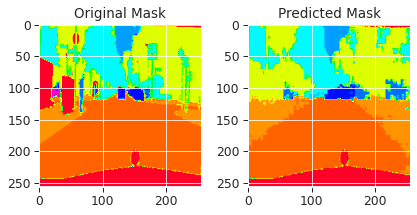

------------------------------------------------------------------------------------------------------------------------
| epoch  18 |   100/  185 batches | train accuracy    0.769 | train loss: 0.90196  | train mIOU: 0.188
------------------------------------------------------------------------------------------------------------------------
| end of epoch  18 | time: 108.54s | valid accuracy:    0.696 | valid loss: 1.13254 | valid mIOU: 0.179


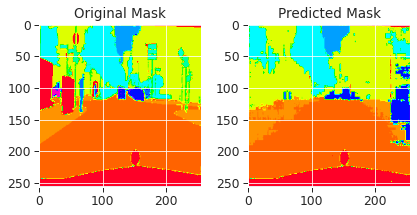

------------------------------------------------------------------------------------------------------------------------
| epoch  19 |   100/  185 batches | train accuracy    0.758 | train loss: 0.91323  | train mIOU: 0.184
------------------------------------------------------------------------------------------------------------------------
| end of epoch  19 | time: 108.61s | valid accuracy:    0.690 | valid loss: 1.12752 | valid mIOU: 0.168


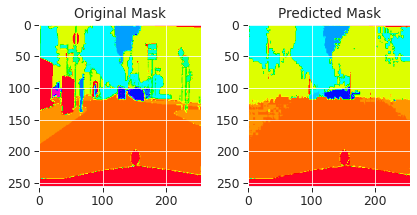

------------------------------------------------------------------------------------------------------------------------
| epoch  20 |   100/  185 batches | train accuracy    0.767 | train loss: 0.89697  | train mIOU: 0.193
------------------------------------------------------------------------------------------------------------------------
| end of epoch  20 | time: 108.46s | valid accuracy:    0.729 | valid loss: 1.02238 | valid mIOU: 0.192


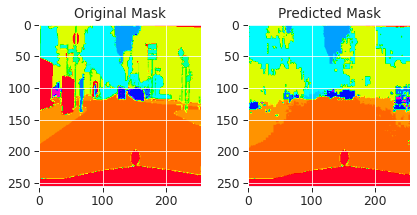

------------------------------------------------------------------------------------------------------------------------
| epoch  21 |   100/  185 batches | train accuracy    0.735 | train loss: 1.02484  | train mIOU: 0.146
------------------------------------------------------------------------------------------------------------------------
| end of epoch  21 | time: 108.67s | valid accuracy:    0.699 | valid loss: 1.12047 | valid mIOU: 0.174


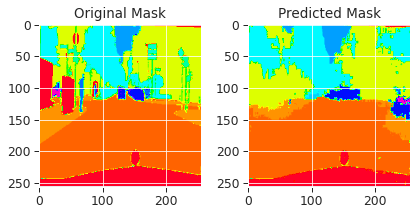

------------------------------------------------------------------------------------------------------------------------
| epoch  22 |   100/  185 batches | train accuracy    0.773 | train loss: 0.82059  | train mIOU: 0.191
------------------------------------------------------------------------------------------------------------------------
| end of epoch  22 | time: 108.48s | valid accuracy:    0.707 | valid loss: 1.08186 | valid mIOU: 0.183


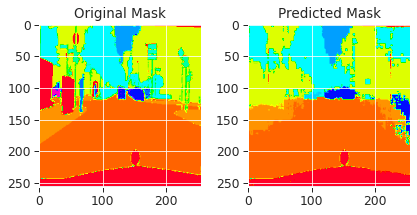

------------------------------------------------------------------------------------------------------------------------
| epoch  23 |   100/  185 batches | train accuracy    0.772 | train loss: 0.83331  | train mIOU: 0.185
------------------------------------------------------------------------------------------------------------------------
| end of epoch  23 | time: 108.34s | valid accuracy:    0.699 | valid loss: 1.09436 | valid mIOU: 0.172


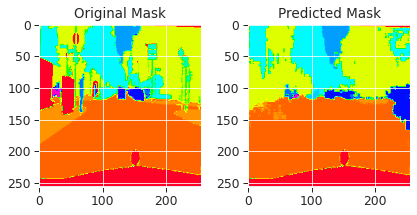

------------------------------------------------------------------------------------------------------------------------
| epoch  24 |   100/  185 batches | train accuracy    0.826 | train loss: 0.64810  | train mIOU: 0.208
------------------------------------------------------------------------------------------------------------------------
| end of epoch  24 | time: 108.66s | valid accuracy:    0.726 | valid loss: 1.01441 | valid mIOU: 0.207


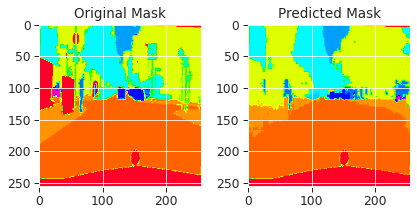

------------------------------------------------------------------------------------------------------------------------
| epoch  25 |   100/  185 batches | train accuracy    0.764 | train loss: 0.90949  | train mIOU: 0.173
------------------------------------------------------------------------------------------------------------------------
| end of epoch  25 | time: 108.17s | valid accuracy:    0.726 | valid loss: 1.02315 | valid mIOU: 0.200


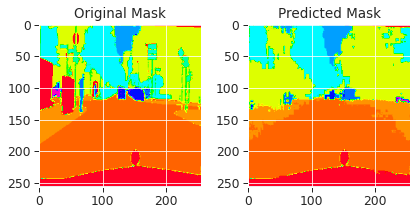

------------------------------------------------------------------------------------------------------------------------
| epoch  26 |   100/  185 batches | train accuracy    0.823 | train loss: 0.67165  | train mIOU: 0.210
------------------------------------------------------------------------------------------------------------------------
| end of epoch  26 | time: 108.72s | valid accuracy:    0.725 | valid loss: 1.02249 | valid mIOU: 0.204


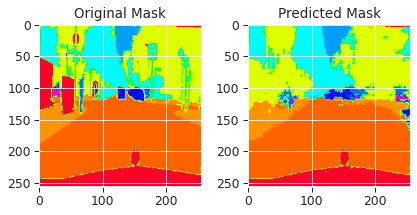

------------------------------------------------------------------------------------------------------------------------
| epoch  27 |   100/  185 batches | train accuracy    0.808 | train loss: 0.71337  | train mIOU: 0.239
------------------------------------------------------------------------------------------------------------------------
| end of epoch  27 | time: 108.68s | valid accuracy:    0.730 | valid loss: 1.01239 | valid mIOU: 0.199


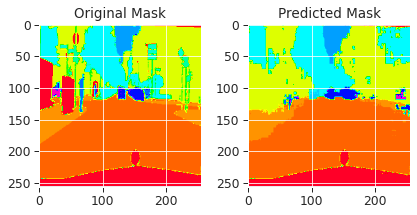

------------------------------------------------------------------------------------------------------------------------
| epoch  28 |   100/  185 batches | train accuracy    0.758 | train loss: 0.88756  | train mIOU: 0.200
------------------------------------------------------------------------------------------------------------------------
| end of epoch  28 | time: 108.24s | valid accuracy:    0.715 | valid loss: 1.05412 | valid mIOU: 0.200


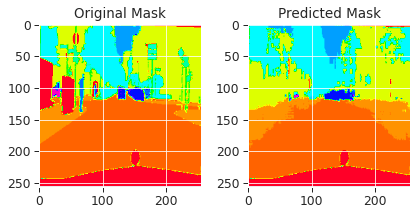

------------------------------------------------------------------------------------------------------------------------
| epoch  29 |   100/  185 batches | train accuracy    0.772 | train loss: 0.87324  | train mIOU: 0.192
------------------------------------------------------------------------------------------------------------------------
| end of epoch  29 | time: 108.74s | valid accuracy:    0.738 | valid loss: 0.98686 | valid mIOU: 0.209


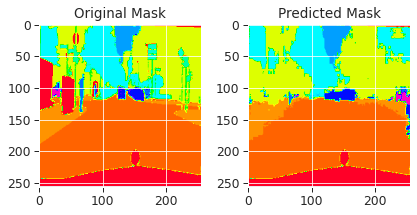

------------------------------------------------------------------------------------------------------------------------
| epoch  30 |   100/  185 batches | train accuracy    0.795 | train loss: 0.71851  | train mIOU: 0.206
------------------------------------------------------------------------------------------------------------------------
| end of epoch  30 | time: 108.47s | valid accuracy:    0.726 | valid loss: 1.00020 | valid mIOU: 0.196


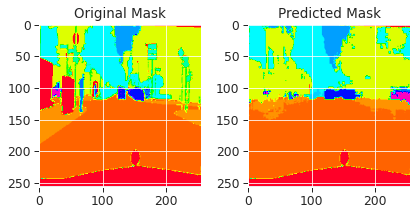

------------------------------------------------------------------------------------------------------------------------
| epoch  31 |   100/  185 batches | train accuracy    0.794 | train loss: 0.78330  | train mIOU: 0.201
------------------------------------------------------------------------------------------------------------------------
| end of epoch  31 | time: 108.54s | valid accuracy:    0.738 | valid loss: 0.96259 | valid mIOU: 0.200


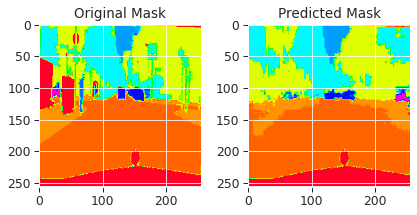

------------------------------------------------------------------------------------------------------------------------
| epoch  32 |   100/  185 batches | train accuracy    0.777 | train loss: 0.78052  | train mIOU: 0.217
------------------------------------------------------------------------------------------------------------------------
| end of epoch  32 | time: 108.99s | valid accuracy:    0.706 | valid loss: 1.03626 | valid mIOU: 0.201


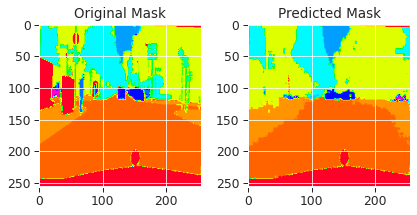

------------------------------------------------------------------------------------------------------------------------
| epoch  33 |   100/  185 batches | train accuracy    0.806 | train loss: 0.73704  | train mIOU: 0.220
------------------------------------------------------------------------------------------------------------------------
| end of epoch  33 | time: 108.20s | valid accuracy:    0.732 | valid loss: 1.02830 | valid mIOU: 0.209


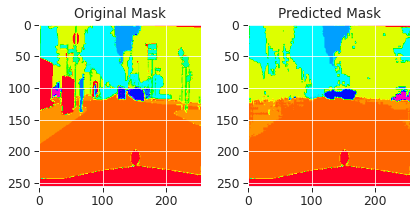

------------------------------------------------------------------------------------------------------------------------
| epoch  34 |   100/  185 batches | train accuracy    0.799 | train loss: 0.71033  | train mIOU: 0.208
------------------------------------------------------------------------------------------------------------------------
| end of epoch  34 | time: 108.73s | valid accuracy:    0.731 | valid loss: 0.96176 | valid mIOU: 0.203


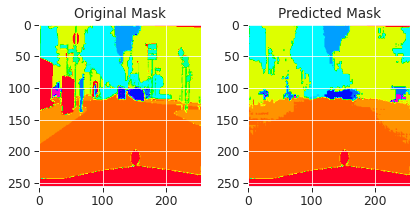

------------------------------------------------------------------------------------------------------------------------
| epoch  35 |   100/  185 batches | train accuracy    0.792 | train loss: 0.73540  | train mIOU: 0.215
------------------------------------------------------------------------------------------------------------------------
| end of epoch  35 | time: 108.59s | valid accuracy:    0.715 | valid loss: 1.03574 | valid mIOU: 0.194


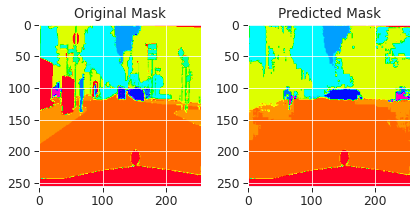

------------------------------------------------------------------------------------------------------------------------
| epoch  36 |   100/  185 batches | train accuracy    0.852 | train loss: 0.55379  | train mIOU: 0.259
------------------------------------------------------------------------------------------------------------------------
| end of epoch  36 | time: 108.27s | valid accuracy:    0.750 | valid loss: 0.94312 | valid mIOU: 0.235


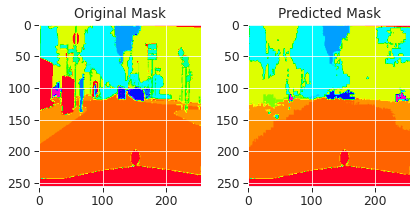

------------------------------------------------------------------------------------------------------------------------
| epoch  37 |   100/  185 batches | train accuracy    0.806 | train loss: 0.72840  | train mIOU: 0.205
------------------------------------------------------------------------------------------------------------------------
| end of epoch  37 | time: 108.76s | valid accuracy:    0.747 | valid loss: 0.97274 | valid mIOU: 0.219


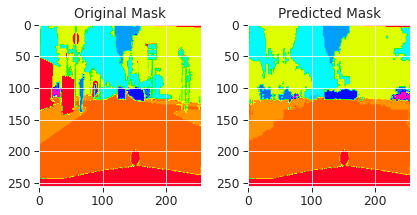

------------------------------------------------------------------------------------------------------------------------
| epoch  38 |   100/  185 batches | train accuracy    0.825 | train loss: 0.66786  | train mIOU: 0.244
------------------------------------------------------------------------------------------------------------------------
| end of epoch  38 | time: 108.28s | valid accuracy:    0.742 | valid loss: 0.94068 | valid mIOU: 0.219


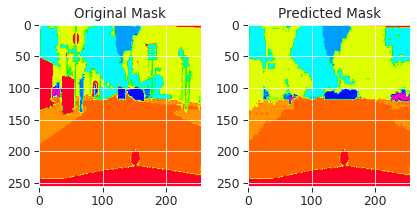

------------------------------------------------------------------------------------------------------------------------
| epoch  39 |   100/  185 batches | train accuracy    0.829 | train loss: 0.62291  | train mIOU: 0.228
------------------------------------------------------------------------------------------------------------------------
| end of epoch  39 | time: 108.61s | valid accuracy:    0.745 | valid loss: 0.98387 | valid mIOU: 0.220


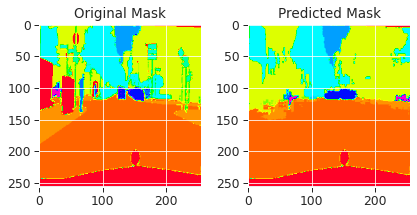

------------------------------------------------------------------------------------------------------------------------
| epoch  40 |   100/  185 batches | train accuracy    0.849 | train loss: 0.56324  | train mIOU: 0.245
------------------------------------------------------------------------------------------------------------------------
| end of epoch  40 | time: 108.46s | valid accuracy:    0.737 | valid loss: 0.98684 | valid mIOU: 0.202


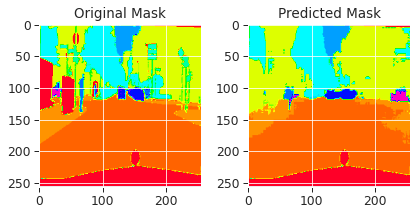

------------------------------------------------------------------------------------------------------------------------
| epoch  41 |   100/  185 batches | train accuracy    0.858 | train loss: 0.53638  | train mIOU: 0.250
------------------------------------------------------------------------------------------------------------------------
| end of epoch  41 | time: 108.59s | valid accuracy:    0.742 | valid loss: 0.96262 | valid mIOU: 0.225


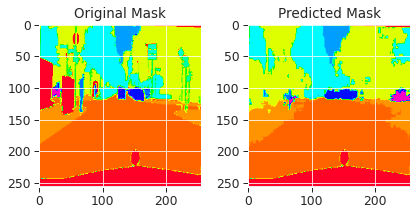

------------------------------------------------------------------------------------------------------------------------
| epoch  42 |   100/  185 batches | train accuracy    0.837 | train loss: 0.58629  | train mIOU: 0.274
------------------------------------------------------------------------------------------------------------------------
| end of epoch  42 | time: 108.74s | valid accuracy:    0.740 | valid loss: 1.01186 | valid mIOU: 0.218


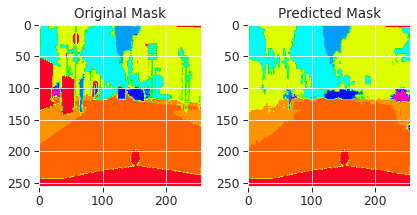

------------------------------------------------------------------------------------------------------------------------
| epoch  43 |   100/  185 batches | train accuracy    0.866 | train loss: 0.50705  | train mIOU: 0.286
------------------------------------------------------------------------------------------------------------------------
| end of epoch  43 | time: 108.51s | valid accuracy:    0.740 | valid loss: 1.04919 | valid mIOU: 0.216


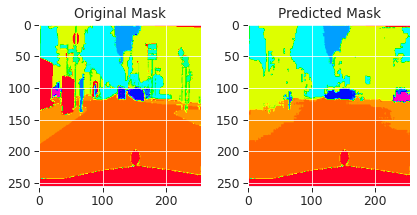

------------------------------------------------------------------------------------------------------------------------


In [11]:
#Model Training for 256 x 256
# Model Training

batch_size = 16
train_loader = make_dataloader(X_train.numpy(), Y_train.numpy(), batch_size, True)
val_loader = make_dataloader(X_valid.numpy(), Y_valid.numpy(), batch_size, False)

# Hyperparameters
epochs = 43  # epoch
lr = 0.001
#gradient_norm_clips = 0.1
gradient_norm_clip = 0.3

optimizer = torch.optim.AdamW(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs, 1e-8)

total_accu = None
for epoch in range(1, epochs + 1):
    
    epoch_start_time = time.time()
    train(model, train_loader, loss_func, device, gradient_norm_clip)
    # accu_val, accu_loss, iou = evaluate(model, val_loader, loss_func, device)
    accu_val, accu_loss, mean_IOU, jjaccu_val, jjaccu_loss, jjmean_IOU,= evaluate(model, val_loader, loss_func, device)
    if total_accu is not None and total_accu > accu_val:
        scheduler.step()
    else:
        total_accu = accu_val
    print('-' * 120)
    print('| end of epoch {:3d} | time: {:5.2f}s | '
          'valid accuracy: {:8.3f} | valid loss: {:.5f} | valid mIOU: {:.3f}'.format(epoch,
                                           time.time() - epoch_start_time,
                                           jjaccu_val, jjaccu_loss, jjmean_IOU))
    viz_callback = VizCallback("123.jpg")
    viz_callback.on_epoch_end(model)
    print('-' * 120)

| epoch   1 |   100/  185 batches | train accuracy    0.759 | train loss: 0.87957  | train mIOU: 0.190
------------------------------------------------------------------------------------------------------------------------
| end of epoch   1 | time: 39.78s | valid accuracy:    0.737 | valid loss: 0.88740 | valid mIOU: 0.177


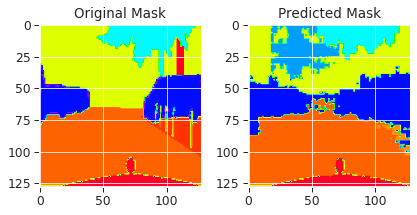

------------------------------------------------------------------------------------------------------------------------
| epoch   2 |   100/  185 batches | train accuracy    0.768 | train loss: 0.89696  | train mIOU: 0.195
------------------------------------------------------------------------------------------------------------------------
| end of epoch   2 | time: 40.95s | valid accuracy:    0.730 | valid loss: 0.90953 | valid mIOU: 0.187


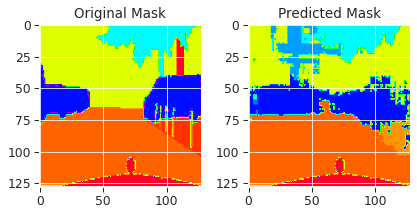

------------------------------------------------------------------------------------------------------------------------
| epoch   3 |   100/  185 batches | train accuracy    0.770 | train loss: 0.83770  | train mIOU: 0.186
------------------------------------------------------------------------------------------------------------------------
| end of epoch   3 | time: 39.93s | valid accuracy:    0.725 | valid loss: 0.91155 | valid mIOU: 0.175


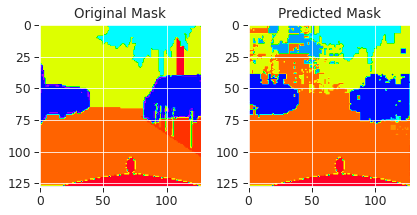

------------------------------------------------------------------------------------------------------------------------
| epoch   4 |   100/  185 batches | train accuracy    0.756 | train loss: 0.88183  | train mIOU: 0.179
------------------------------------------------------------------------------------------------------------------------
| end of epoch   4 | time: 39.90s | valid accuracy:    0.704 | valid loss: 0.97056 | valid mIOU: 0.161


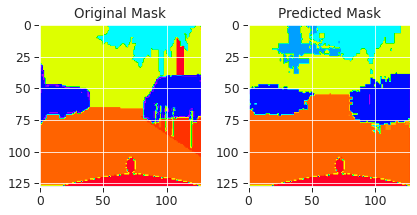

------------------------------------------------------------------------------------------------------------------------
| epoch   5 |   100/  185 batches | train accuracy    0.740 | train loss: 0.96978  | train mIOU: 0.172
------------------------------------------------------------------------------------------------------------------------
| end of epoch   5 | time: 39.77s | valid accuracy:    0.707 | valid loss: 0.98454 | valid mIOU: 0.162


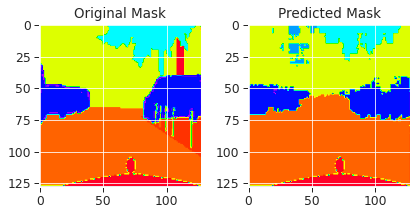

------------------------------------------------------------------------------------------------------------------------
| epoch   6 |   100/  185 batches | train accuracy    0.701 | train loss: 1.14975  | train mIOU: 0.162
------------------------------------------------------------------------------------------------------------------------
| end of epoch   6 | time: 39.71s | valid accuracy:    0.745 | valid loss: 0.87499 | valid mIOU: 0.188


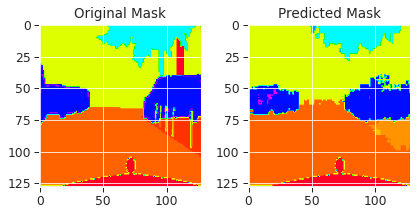

------------------------------------------------------------------------------------------------------------------------
| epoch   7 |   100/  185 batches | train accuracy    0.757 | train loss: 0.91753  | train mIOU: 0.191
------------------------------------------------------------------------------------------------------------------------
| end of epoch   7 | time: 39.78s | valid accuracy:    0.684 | valid loss: 1.04002 | valid mIOU: 0.158


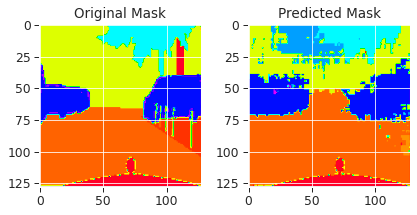

------------------------------------------------------------------------------------------------------------------------
| epoch   8 |   100/  185 batches | train accuracy    0.720 | train loss: 0.97881  | train mIOU: 0.174
------------------------------------------------------------------------------------------------------------------------
| end of epoch   8 | time: 39.85s | valid accuracy:    0.676 | valid loss: 1.11866 | valid mIOU: 0.149


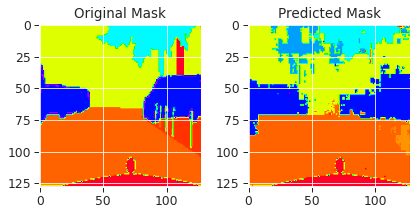

------------------------------------------------------------------------------------------------------------------------
| epoch   9 |   100/  185 batches | train accuracy    0.713 | train loss: 1.06289  | train mIOU: 0.188
------------------------------------------------------------------------------------------------------------------------
| end of epoch   9 | time: 40.09s | valid accuracy:    0.694 | valid loss: 1.00804 | valid mIOU: 0.154


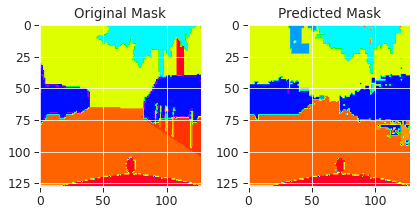

------------------------------------------------------------------------------------------------------------------------
| epoch  10 |   100/  185 batches | train accuracy    0.772 | train loss: 0.67557  | train mIOU: 0.222
------------------------------------------------------------------------------------------------------------------------
| end of epoch  10 | time: 42.54s | valid accuracy:    0.719 | valid loss: 0.78691 | valid mIOU: 0.201


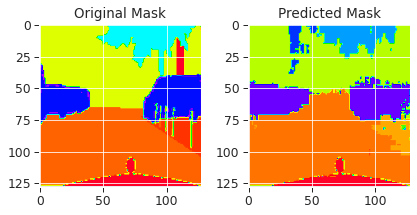

------------------------------------------------------------------------------------------------------------------------
| epoch  11 |   100/  185 batches | train accuracy    0.731 | train loss: 0.81692  | train mIOU: 0.212
------------------------------------------------------------------------------------------------------------------------
| end of epoch  11 | time: 40.12s | valid accuracy:    0.712 | valid loss: 0.84677 | valid mIOU: 0.191


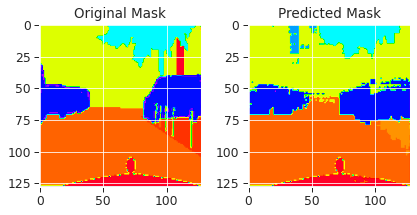

------------------------------------------------------------------------------------------------------------------------
| epoch  12 |   100/  185 batches | train accuracy    0.720 | train loss: 0.92701  | train mIOU: 0.218
------------------------------------------------------------------------------------------------------------------------
| end of epoch  12 | time: 40.45s | valid accuracy:    0.711 | valid loss: 0.79107 | valid mIOU: 0.210


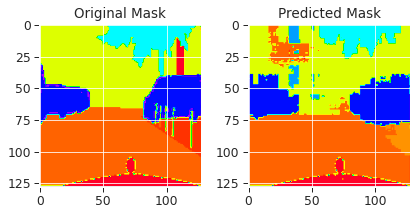

------------------------------------------------------------------------------------------------------------------------
| epoch  13 |   100/  185 batches | train accuracy    0.742 | train loss: 0.82364  | train mIOU: 0.218
------------------------------------------------------------------------------------------------------------------------
| end of epoch  13 | time: 40.93s | valid accuracy:    0.721 | valid loss: 0.80117 | valid mIOU: 0.187


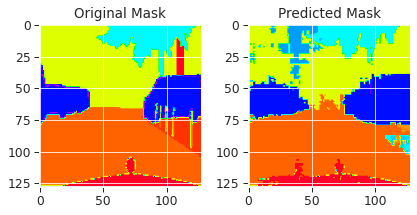

------------------------------------------------------------------------------------------------------------------------
| epoch  14 |   100/  185 batches | train accuracy    0.784 | train loss: 0.69635  | train mIOU: 0.244
------------------------------------------------------------------------------------------------------------------------
| end of epoch  14 | time: 40.73s | valid accuracy:    0.724 | valid loss: 0.75780 | valid mIOU: 0.199


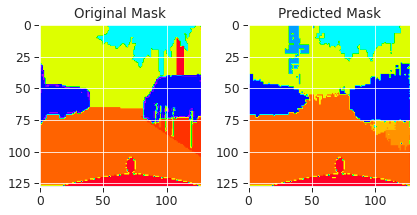

------------------------------------------------------------------------------------------------------------------------
| epoch  15 |   100/  185 batches | train accuracy    0.798 | train loss: 0.57844  | train mIOU: 0.278
------------------------------------------------------------------------------------------------------------------------
| end of epoch  15 | time: 40.85s | valid accuracy:    0.725 | valid loss: 0.73357 | valid mIOU: 0.230


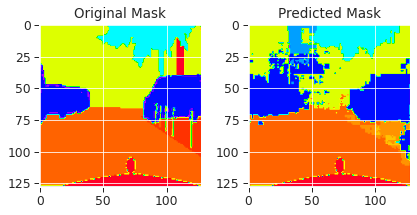

------------------------------------------------------------------------------------------------------------------------
| epoch  16 |   100/  185 batches | train accuracy    0.799 | train loss: 0.59455  | train mIOU: 0.280
------------------------------------------------------------------------------------------------------------------------
| end of epoch  16 | time: 41.15s | valid accuracy:    0.729 | valid loss: 0.78884 | valid mIOU: 0.223


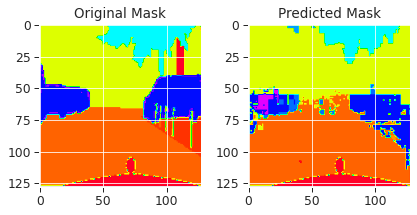

------------------------------------------------------------------------------------------------------------------------
| epoch  17 |   100/  185 batches | train accuracy    0.801 | train loss: 0.53576  | train mIOU: 0.283
------------------------------------------------------------------------------------------------------------------------
| end of epoch  17 | time: 40.92s | valid accuracy:    0.744 | valid loss: 0.74697 | valid mIOU: 0.236


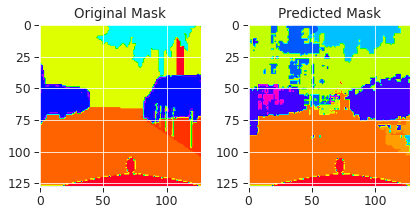

------------------------------------------------------------------------------------------------------------------------
| epoch  18 |   100/  185 batches | train accuracy    0.765 | train loss: 0.68511  | train mIOU: 0.247
------------------------------------------------------------------------------------------------------------------------
| end of epoch  18 | time: 40.95s | valid accuracy:    0.717 | valid loss: 0.78458 | valid mIOU: 0.226


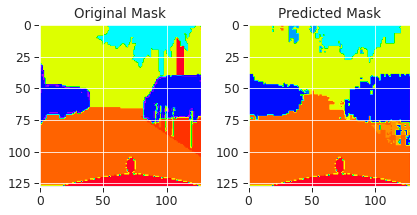

------------------------------------------------------------------------------------------------------------------------
| epoch  19 |   100/  185 batches | train accuracy    0.783 | train loss: 0.62120  | train mIOU: 0.278
------------------------------------------------------------------------------------------------------------------------
| end of epoch  19 | time: 40.92s | valid accuracy:    0.729 | valid loss: 0.79391 | valid mIOU: 0.228


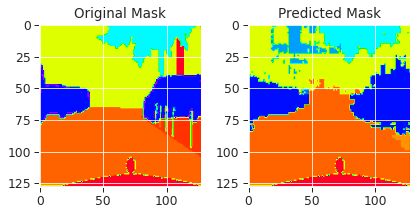

------------------------------------------------------------------------------------------------------------------------
| epoch  20 |   100/  185 batches | train accuracy    0.738 | train loss: 0.72836  | train mIOU: 0.260
------------------------------------------------------------------------------------------------------------------------
| end of epoch  20 | time: 39.95s | valid accuracy:    0.738 | valid loss: 0.59454 | valid mIOU: 0.269


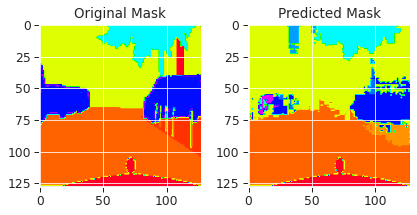

------------------------------------------------------------------------------------------------------------------------
| epoch  21 |   100/  185 batches | train accuracy    0.768 | train loss: 0.55582  | train mIOU: 0.287
------------------------------------------------------------------------------------------------------------------------
| end of epoch  21 | time: 40.61s | valid accuracy:    0.739 | valid loss: 0.57335 | valid mIOU: 0.256


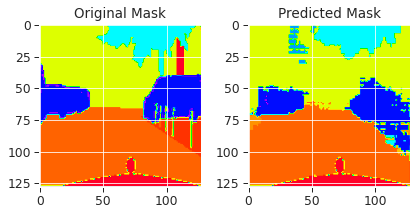

------------------------------------------------------------------------------------------------------------------------
| epoch  22 |   100/  185 batches | train accuracy    0.790 | train loss: 0.51068  | train mIOU: 0.286
------------------------------------------------------------------------------------------------------------------------
| end of epoch  22 | time: 41.01s | valid accuracy:    0.756 | valid loss: 0.57118 | valid mIOU: 0.265


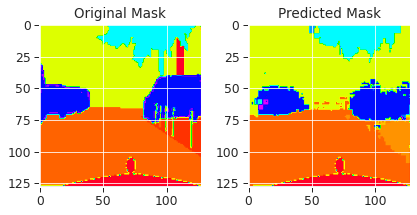

------------------------------------------------------------------------------------------------------------------------
| epoch  23 |   100/  185 batches | train accuracy    0.802 | train loss: 0.42567  | train mIOU: 0.279
------------------------------------------------------------------------------------------------------------------------
| end of epoch  23 | time: 40.69s | valid accuracy:    0.757 | valid loss: 0.55918 | valid mIOU: 0.269


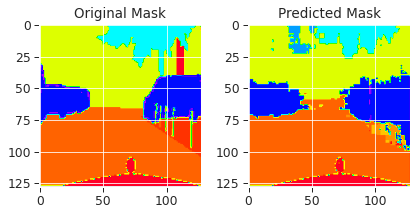

------------------------------------------------------------------------------------------------------------------------
| epoch  24 |   100/  185 batches | train accuracy    0.801 | train loss: 0.47776  | train mIOU: 0.294
------------------------------------------------------------------------------------------------------------------------
| end of epoch  24 | time: 40.10s | valid accuracy:    0.763 | valid loss: 0.53836 | valid mIOU: 0.268


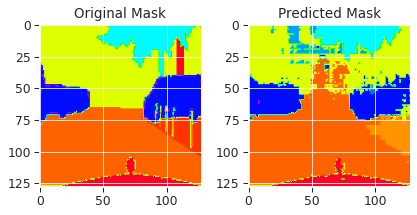

------------------------------------------------------------------------------------------------------------------------
| epoch  25 |   100/  185 batches | train accuracy    0.801 | train loss: 0.43761  | train mIOU: 0.325
------------------------------------------------------------------------------------------------------------------------
| end of epoch  25 | time: 40.18s | valid accuracy:    0.736 | valid loss: 0.56220 | valid mIOU: 0.279


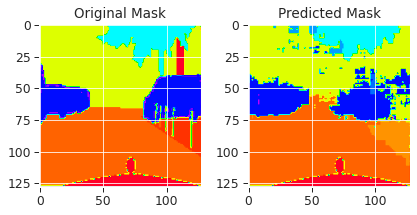

------------------------------------------------------------------------------------------------------------------------
| epoch  26 |   100/  185 batches | train accuracy    0.788 | train loss: 0.49364  | train mIOU: 0.324
------------------------------------------------------------------------------------------------------------------------
| end of epoch  26 | time: 40.68s | valid accuracy:    0.746 | valid loss: 0.54523 | valid mIOU: 0.277


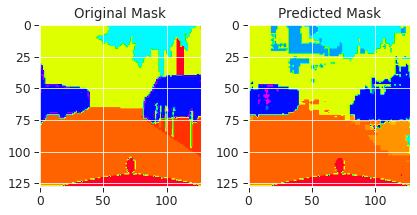

------------------------------------------------------------------------------------------------------------------------
| epoch  27 |   100/  185 batches | train accuracy    0.778 | train loss: 0.58001  | train mIOU: 0.338
------------------------------------------------------------------------------------------------------------------------
| end of epoch  27 | time: 41.82s | valid accuracy:    0.735 | valid loss: 0.56498 | valid mIOU: 0.297


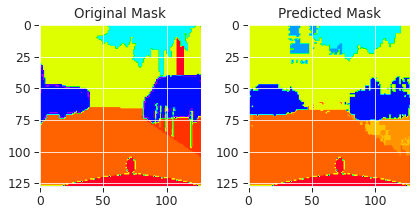

------------------------------------------------------------------------------------------------------------------------
| epoch  28 |   100/  185 batches | train accuracy    0.819 | train loss: 0.38202  | train mIOU: 0.356
------------------------------------------------------------------------------------------------------------------------
| end of epoch  28 | time: 39.93s | valid accuracy:    0.757 | valid loss: 0.51852 | valid mIOU: 0.291


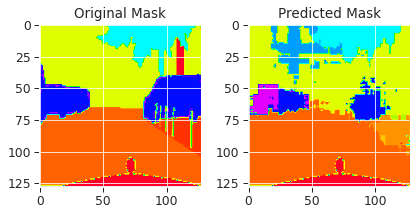

------------------------------------------------------------------------------------------------------------------------
| epoch  29 |   100/  185 batches | train accuracy    0.830 | train loss: 0.34214  | train mIOU: 0.359
------------------------------------------------------------------------------------------------------------------------
| end of epoch  29 | time: 39.86s | valid accuracy:    0.761 | valid loss: 0.51143 | valid mIOU: 0.300


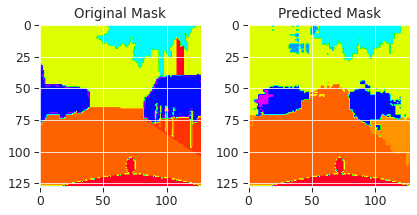

------------------------------------------------------------------------------------------------------------------------
| epoch  30 |   100/  185 batches | train accuracy    0.809 | train loss: 0.57210  | train mIOU: 0.340
------------------------------------------------------------------------------------------------------------------------
| end of epoch  30 | time: 39.82s | valid accuracy:    0.764 | valid loss: 0.49502 | valid mIOU: 0.335


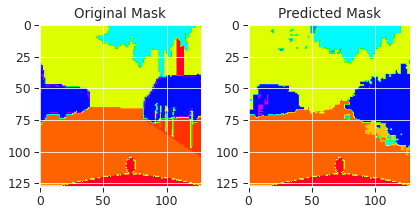

------------------------------------------------------------------------------------------------------------------------
| epoch  31 |   100/  185 batches | train accuracy    0.847 | train loss: 0.37029  | train mIOU: 0.412
------------------------------------------------------------------------------------------------------------------------
| end of epoch  31 | time: 42.08s | valid accuracy:    0.743 | valid loss: 0.53701 | valid mIOU: 0.316


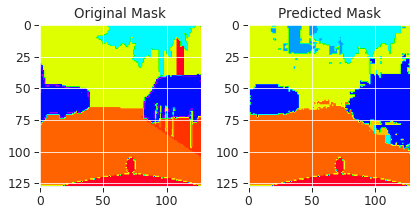

------------------------------------------------------------------------------------------------------------------------
| epoch  32 |   100/  185 batches | train accuracy    0.844 | train loss: 0.38793  | train mIOU: 0.372
------------------------------------------------------------------------------------------------------------------------
| end of epoch  32 | time: 42.04s | valid accuracy:    0.769 | valid loss: 0.51544 | valid mIOU: 0.332


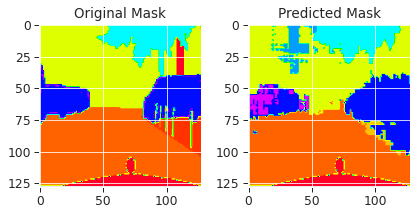

------------------------------------------------------------------------------------------------------------------------
| epoch  33 |   100/  185 batches | train accuracy    0.835 | train loss: 0.42800  | train mIOU: 0.361
------------------------------------------------------------------------------------------------------------------------
| end of epoch  33 | time: 40.18s | valid accuracy:    0.773 | valid loss: 0.48228 | valid mIOU: 0.352


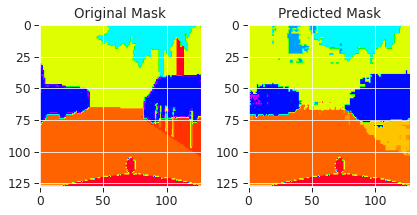

------------------------------------------------------------------------------------------------------------------------
| epoch  34 |   100/  185 batches | train accuracy    0.824 | train loss: 0.48871  | train mIOU: 0.376
------------------------------------------------------------------------------------------------------------------------
| end of epoch  34 | time: 39.80s | valid accuracy:    0.761 | valid loss: 0.49383 | valid mIOU: 0.337


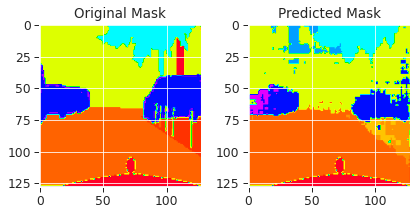

------------------------------------------------------------------------------------------------------------------------
| epoch  35 |   100/  185 batches | train accuracy    0.885 | train loss: 0.35498  | train mIOU: 0.408
------------------------------------------------------------------------------------------------------------------------
| end of epoch  35 | time: 39.83s | valid accuracy:    0.803 | valid loss: 0.49357 | valid mIOU: 0.337


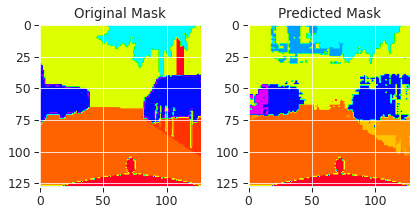

------------------------------------------------------------------------------------------------------------------------
| epoch  36 |   100/  185 batches | train accuracy    0.905 | train loss: 0.29110  | train mIOU: 0.415
------------------------------------------------------------------------------------------------------------------------
| end of epoch  36 | time: 41.24s | valid accuracy:    0.832 | valid loss: 0.40846 | valid mIOU: 0.373


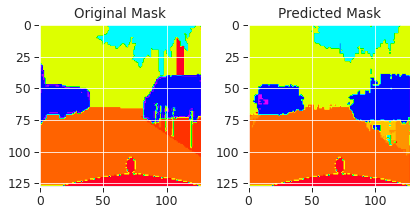

------------------------------------------------------------------------------------------------------------------------
| epoch  37 |   100/  185 batches | train accuracy    0.902 | train loss: 0.26069  | train mIOU: 0.421
------------------------------------------------------------------------------------------------------------------------
| end of epoch  37 | time: 41.60s | valid accuracy:    0.804 | valid loss: 0.47285 | valid mIOU: 0.352


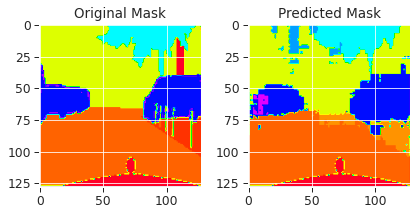

------------------------------------------------------------------------------------------------------------------------
| epoch  38 |   100/  185 batches | train accuracy    0.873 | train loss: 0.39749  | train mIOU: 0.387
------------------------------------------------------------------------------------------------------------------------
| end of epoch  38 | time: 40.38s | valid accuracy:    0.813 | valid loss: 0.47415 | valid mIOU: 0.350


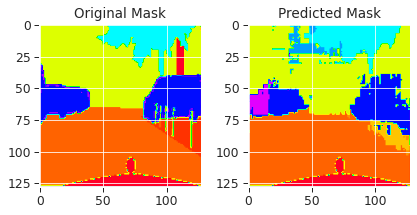

------------------------------------------------------------------------------------------------------------------------
| epoch  39 |   100/  185 batches | train accuracy    0.903 | train loss: 0.29257  | train mIOU: 0.414
------------------------------------------------------------------------------------------------------------------------
| end of epoch  39 | time: 40.44s | valid accuracy:    0.825 | valid loss: 0.42973 | valid mIOU: 0.361


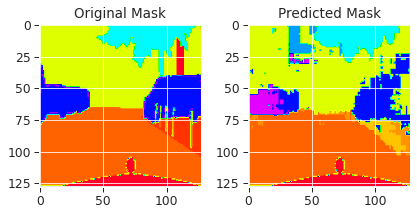

------------------------------------------------------------------------------------------------------------------------
| epoch  40 |   100/  185 batches | train accuracy    0.877 | train loss: 0.38649  | train mIOU: 0.416
------------------------------------------------------------------------------------------------------------------------
| end of epoch  40 | time: 39.82s | valid accuracy:    0.834 | valid loss: 0.41718 | valid mIOU: 0.370


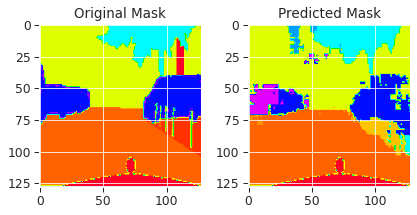

------------------------------------------------------------------------------------------------------------------------


In [ ]:
# Model Training

batch_size = 16
train_loader = make_dataloader(X_train.numpy(), Y_train.numpy(), batch_size, True)
val_loader = make_dataloader(X_valid.numpy(), Y_valid.numpy(), batch_size, False)

# Hyperparameters
epochs =42  # epoch
lr = 0.001
gradient_norm_clips = 0.1
gradient_norm_clip = 1

optimizer = torch.optim.AdamW(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs, 1e-8)

total_accu = None
for epoch in range(1, epochs + 1):
    
    epoch_start_time = time.time()
    train(model, train_loader, loss_func, device, gradient_norm_clip)
    # accu_val, accu_loss, iou = evaluate(model, val_loader, loss_func, device)
    accu_val, accu_loss, mean_IOU= evaluate(model, val_loader, loss_func, device)
    if total_accu is not None and total_accu > accu_val:
        scheduler.step()
    else:
        total_accu = accu_val
    print('-' * 120)
    print('| end of epoch {:3d} | time: {:5.2f}s | '
          'valid accuracy: {:8.3f} | valid loss: {:.5f} | valid mIOU: {:.3f}'.format(epoch,
                                           time.time() - epoch_start_time,
                                           accu_val, accu_loss, mean_IOU))
    viz_callback = VizCallback("cityscapes_data/val/295.jpg")
    viz_callback.on_epoch_end(model)
    print('-' * 120)

In [17]:
torch.save(model.state_dict(), "swin_transformer_b16_128")

### RESULTS:

#### Basic SWIN
1. Batchsize=4  lr=0.001 Epochs=13 --> valid accuracy: 0.703 | valid loss: 1.00796 | valid mIOU: 0.119

#### SWIN UNET
1. Batchsize=16  lr=0.001 Epochs=20 --> valid accuracy:    0.795 | valid loss: 0.76941 | valid mIOU: 0.212
1. Batchsize=4  lr=0.001 Epochs=11 --> valid accuracy:    0.693 | valid loss: 1.10777 | valid mIOU: 0.136

# 5. Unfinalized

In [ ]:
import tensorflow as tf
class UpdatedMeanIoU(tf.keras.metrics.MeanIoU):
  def __init__(self,
               y_true=None,
               y_pred=None,
               num_classes=None,
               name=None,
               dtype=None):
    super(UpdatedMeanIoU, self).__init__(num_classes = num_classes,name=name, dtype=dtype)

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_pred = tf.math.argmax(y_pred, axis=1)
    return super().update_state(y_true, y_pred, sample_weight)

In [ ]:
# !pip install torchmetrics

In [ ]:
from torchmetrics import JaccardIndex

def mIoU(pred, ground_truth, smooth=1e-10, n_classes=num_classes):
    with torch.no_grad():
        pred         = torch.argmax(pred, dim=1)
        pred         = pred.cpu().contiguous().view(-1).numpy() # make it 1D *\
        ground_truth = torch.from_numpy(ground_truth.cpu().contiguous().view(-1).numpy()) # make it 1D 
        # MIoU = JaccardIndex(pred, ground_truth,num_classes=num_classes,average='macro',task='multiclass') #'none' per class 
        jaccard = JaccardIndex(task="multiclass", num_classes=31)
        MioU = jaccard(pred, ground_truth)
        return MIoU

In [ ]:
SSFORMER (SEGFORMER)

In [11]:
class SwinTransformer(nn.Module):
    def __init__(self, *, hidden_dim, layers, heads, channels=3, num_classes=1000, head_dim=32, window_size=7,
                 downscaling_factors=(4, 2, 2, 2), relative_pos_embedding=True):
        super().__init__()
        
        # Encoder
        self.stage1 = StageModule(in_channels=channels, hidden_dimension=hidden_dim, layers=layers[0],
                                  downscaling_factor=downscaling_factors[0], num_heads=heads[0], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        self.stage2 = StageModule(in_channels=hidden_dim, hidden_dimension=hidden_dim * 2, layers=layers[1],
                                  downscaling_factor=downscaling_factors[1], num_heads=heads[1], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        self.stage3 = StageModule(in_channels=hidden_dim * 2, hidden_dimension=hidden_dim * 4, layers=layers[2],
                                  downscaling_factor=downscaling_factors[2], num_heads=heads[2], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        
        # Bottle Neck
        self.stage4 = StageModule(in_channels=hidden_dim * 4, hidden_dimension=hidden_dim * 8, layers=layers[3],
                                  downscaling_factor=downscaling_factors[3], num_heads=heads[3], head_dim=head_dim,
                                  window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        
        
        
        #MLP head 1
        self.MLP1 = nn.Sequential(
            nn.Conv2d(hidden_dim, hidden_dim, 1),
            nn.Upsample(scale_factor = 2 ** 0)
        ) 
        
        #MLP head 2
        self.MLP2 = nn.Sequential(
            nn.Conv2d(hidden_dim*2, hidden_dim, 1),
            nn.Upsample(scale_factor = 2 ** 1)
        ) 
        #MLP head 3
        self.MLP3 = nn.Sequential(
            nn.Conv2d(hidden_dim*4, hidden_dim, 1),
            nn.Upsample(scale_factor = 2 ** 2)
        )         
        #MLP head 4

        self.MLP4 = nn.Sequential(
            nn.Conv2d(hidden_dim*8, hidden_dim, 1),
            nn.Upsample(scale_factor = 2 ** 3)
        )   
        
        
        #MLP head final
        
        self.MLP_final1=nn.Conv2d(4 * hidden_dim, hidden_dim, 1)
        self.MLP_final2= PatchFinalExpanding(in_channels=hidden_dim, out_channels=hidden_dim, upscaling_factor=downscaling_factors[0])
        self.MLP_final3= nn.Conv2d(in_channels=hidden_dim, out_channels=num_classes, kernel_size=1, bias=False)
        
        
        
        
        
        
        
        
        
        
        
        
        
        
        
        '''
        # Decoder
        self.stage5 = StageModule_Up(in_channels=hidden_dim * 8, hidden_dimension=hidden_dim * 4, layers=layers[3],
                                     downscaling_factor=downscaling_factors[3], num_heads=heads[3], head_dim=head_dim,
                                     window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        # self.concat_linear5 = nn.Linear(int(hidden_dim * 2 ** 3), int(hidden_dim * 2 ** 2))
        self.concat_l5 = torch.nn.Conv2d(768, 384, kernel_size=1)
        
        self.stage6 = StageModule_Up(in_channels=hidden_dim * 4, hidden_dimension=hidden_dim * 2, layers=layers[2],
                                     downscaling_factor=downscaling_factors[2], num_heads=heads[2], head_dim=head_dim,
                                     window_size=window_size, relative_pos_embedding=relative_pos_embedding)
        self.concat_l6 = torch.nn.Conv2d(384, 192, kernel_size=1)
        
        self.stage7 = StageModule_Up(in_channels=hidden_dim * 2, hidden_dimension=hidden_dim, layers=layers[1],
                                     downscaling_factor=downscaling_factors[1], num_heads=heads[1], head_dim=head_dim,
                                     window_size=window_size, relative_pos_embedding=relative_pos_embedding) 
        self.concat_l7 = torch.nn.Conv2d(192, 96, kernel_size=1)
            
        self.PFE = PatchFinalExpanding(in_channels=hidden_dim, out_channels=hidden_dim, upscaling_factor=downscaling_factors[0] )
        
        self.output = nn.Conv2d(in_channels=hidden_dim, out_channels=num_classes, kernel_size=1, bias=False)
        
        # self.deconv1 = nn.ConvTranspose2d(hidden_dim * 8, hidden_dim * 4, kernel_size=downscaling_factors[3], stride=downscaling_factors[3])
        # self.deconv2 = nn.ConvTranspose2d(hidden_dim * 4, hidden_dim * 2, kernel_size=downscaling_factors[2], stride=downscaling_factors[2])   
        # self.deconv3 = nn.ConvTranspose2d(hidden_dim * 2, hidden_dim, kernel_size=downscaling_factors[1], stride=downscaling_factors[1])
        # self.deconv4 = nn.ConvTranspose2d(hidden_dim, channels, kernel_size=downscaling_factors[0], stride=downscaling_factors[0])
        '''
        
        
        
        self.mlp_head = nn.Sequential(nn.LayerNorm(hidden_dim * 8), nn.Linear(hidden_dim * 8, num_classes))
        
        
        # self.classifier = nn.Conv2d(3, 31, kernel_size=1)

    def forward(self, img):
        
        # Encoder
        x1 = self.stage1(img) # size=(N,  96, 32, 32)
        x2 = self.stage2(x1)  # size=(N, 192, 16, 16)
        x3 = self.stage3(x2)  # size=(N, 384,  8,  8)

        # BottleNeck
        x4 = self.stage4(x3)  # size=(N, 768,  4,  4)
        #print("x4: ",x4.shape)
        
        
        #MLP layers
        
        MS_1=self.MLP1(x1)
        MS_2=self.MLP2(x2)
        MS_3=self.MLP3(x3)
        MS_4=self.MLP4(x4)
        
        #print(MS_1.shape, x1.shape)
        #print(MS_2.shape, x2.shape)
        #print(MS_3.shape, x3.shape)
        #print(MS_4.shape, x4.shape)
        
        concat_vector = torch.cat([MS_1, MS_2,MS_3,MS_4], dim=1)
        
        #print(concat_vector.shape)
        score1=self.MLP_final1(concat_vector)
        score2=self.MLP_final2(score1).permute(0,3,1,2)
        score=self.MLP_final3(score2)
        
        #print("Final score size: ",score.shape)
        
        '''
        # Decoder 
        x5 = self.stage5(x4) # size=(N, 384,  8,  8)
        #print("x5: ",x5.shape)
        #x5 = x5 + x3
        x5 = torch.cat([x5, x3], dim=1)
        x5 = self.concat_l5(x5)
        #print("conx5: ",x5.shape)
        
        x6 = self.stage6(x5) # size=(N, 192, 16, 16)
        #print("x6: ",x6.shape)
        #x6 = x6 + x2
        x6 = torch.cat([x6, x2], dim=1)
        x6 = self.concat_l6(x6)
        
        x7 = self.stage7(x6) # size=(N,  96, 32, 32)
        #print("x7: ",x7.shape)
        #x7 = x7 + x1
        x7 = torch.cat([x7, x1], dim=1)
        x7 = self.concat_l7(x7)
        #print("conx7: ",x7.shape)
        x8 = self.PFE(x7).permute(0,3,1,2)
        #print("x8: ",x8.shape)
        score = self.output(x8)
        
        # x = x.mean(dim=[2, 3]) # for classifier 
        # return self.mlp_head(x)
        # score = self.classifier(x7)                    # size=(N, n_class, x.H/1, x.W/1) 
        '''
        return score

# TRAINING

In [12]:
# Define Model
# assert torch.cuda.is_available()
device = 'cuda'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = SwinTransformer(
    hidden_dim=96,
    layers=(2, 2, 18, 2),
    heads=(4, 8, 16, 32),
    channels=3,
    num_classes=31,
    head_dim=32,
    window_size=4,
    downscaling_factors=(4, 2, 2, 2),
    relative_pos_embedding=True
)
loss_func = torch.nn.CrossEntropyLoss()
for p in model.parameters():
    if p.dim() > 1:
        nn.init.xavier_uniform_(p)
model = model.to(device)

| epoch   1 |   100/  185 batches | train accuracy    0.559 | train loss: 1.61846  | train mIOU: 0.058 | train Dice Loss: -8.04556
------------------------------------------------------------------------------------------------------------------------
| end of epoch   1 | time: 39.16s | valid accuracy:    0.589 | valid loss: 1.44827 | valid mIOU: 0.073


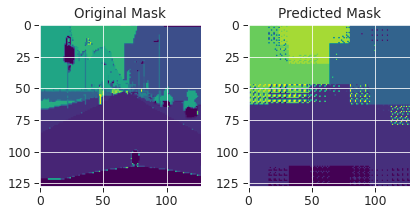

------------------------------------------------------------------------------------------------------------------------
| epoch   2 |   100/  185 batches | train accuracy    0.650 | train loss: 1.30560  | train mIOU: 0.097 | train Dice Loss: -10.61251
------------------------------------------------------------------------------------------------------------------------
| end of epoch   2 | time: 38.90s | valid accuracy:    0.648 | valid loss: 1.22164 | valid mIOU: 0.095


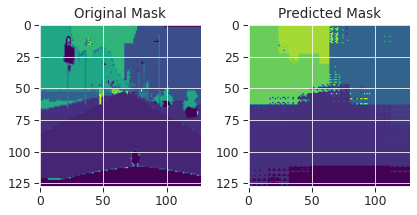

------------------------------------------------------------------------------------------------------------------------
| epoch   3 |   100/  185 batches | train accuracy    0.660 | train loss: 1.23935  | train mIOU: 0.118 | train Dice Loss: -11.86446
------------------------------------------------------------------------------------------------------------------------
| end of epoch   3 | time: 39.35s | valid accuracy:    0.674 | valid loss: 1.12634 | valid mIOU: 0.106


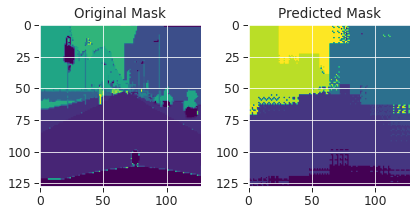

------------------------------------------------------------------------------------------------------------------------
| epoch   4 |   100/  185 batches | train accuracy    0.711 | train loss: 1.05043  | train mIOU: 0.133 | train Dice Loss: -11.30360
------------------------------------------------------------------------------------------------------------------------
| end of epoch   4 | time: 40.39s | valid accuracy:    0.686 | valid loss: 1.09838 | valid mIOU: 0.117


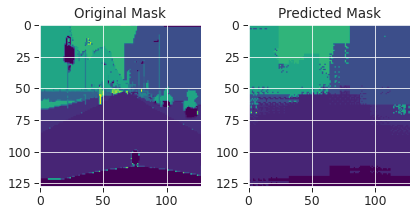

------------------------------------------------------------------------------------------------------------------------
| epoch   5 |   100/  185 batches | train accuracy    0.681 | train loss: 1.14737  | train mIOU: 0.129 | train Dice Loss: -11.43800
------------------------------------------------------------------------------------------------------------------------
| end of epoch   5 | time: 39.91s | valid accuracy:    0.681 | valid loss: 1.06083 | valid mIOU: 0.122


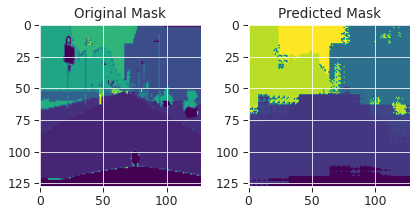

------------------------------------------------------------------------------------------------------------------------
| epoch   6 |   100/  185 batches | train accuracy    0.745 | train loss: 0.90460  | train mIOU: 0.137 | train Dice Loss: -11.84175
------------------------------------------------------------------------------------------------------------------------
| end of epoch   6 | time: 39.91s | valid accuracy:    0.683 | valid loss: 1.03186 | valid mIOU: 0.122


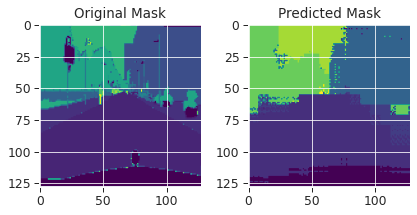

------------------------------------------------------------------------------------------------------------------------
| epoch   7 |   100/  185 batches | train accuracy    0.725 | train loss: 0.94644  | train mIOU: 0.147 | train Dice Loss: -10.95183
------------------------------------------------------------------------------------------------------------------------
| end of epoch   7 | time: 39.00s | valid accuracy:    0.701 | valid loss: 1.00634 | valid mIOU: 0.126


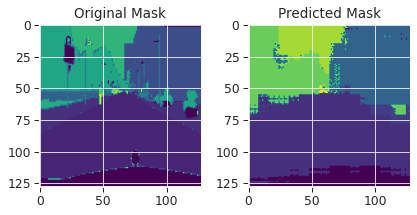

------------------------------------------------------------------------------------------------------------------------
| epoch   8 |   100/  185 batches | train accuracy    0.761 | train loss: 0.83519  | train mIOU: 0.160 | train Dice Loss: -11.56039
------------------------------------------------------------------------------------------------------------------------
| end of epoch   8 | time: 39.38s | valid accuracy:    0.699 | valid loss: 0.99058 | valid mIOU: 0.132


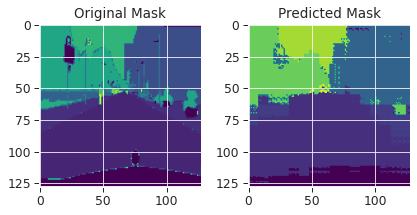

------------------------------------------------------------------------------------------------------------------------
| epoch   9 |   100/  185 batches | train accuracy    0.762 | train loss: 0.82034  | train mIOU: 0.167 | train Dice Loss: -11.68230
------------------------------------------------------------------------------------------------------------------------
| end of epoch   9 | time: 40.08s | valid accuracy:    0.697 | valid loss: 1.01050 | valid mIOU: 0.134


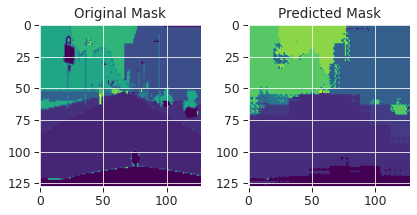

------------------------------------------------------------------------------------------------------------------------
| epoch  10 |   100/  185 batches | train accuracy    0.755 | train loss: 0.83809  | train mIOU: 0.182 | train Dice Loss: -12.00411
------------------------------------------------------------------------------------------------------------------------
| end of epoch  10 | time: 38.89s | valid accuracy:    0.718 | valid loss: 0.97895 | valid mIOU: 0.144


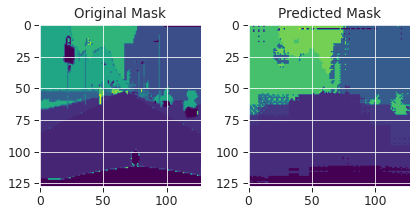

------------------------------------------------------------------------------------------------------------------------
| epoch  11 |   100/  185 batches | train accuracy    0.760 | train loss: 0.82514  | train mIOU: 0.158 | train Dice Loss: -11.13683
------------------------------------------------------------------------------------------------------------------------
| end of epoch  11 | time: 38.87s | valid accuracy:    0.702 | valid loss: 0.99369 | valid mIOU: 0.135


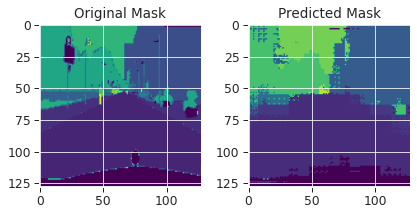

------------------------------------------------------------------------------------------------------------------------
| epoch  12 |   100/  185 batches | train accuracy    0.781 | train loss: 0.78671  | train mIOU: 0.163 | train Dice Loss: -10.64673
------------------------------------------------------------------------------------------------------------------------
| end of epoch  12 | time: 39.06s | valid accuracy:    0.723 | valid loss: 0.99752 | valid mIOU: 0.140


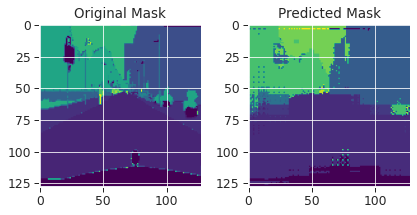

------------------------------------------------------------------------------------------------------------------------
| epoch  13 |   100/  185 batches | train accuracy    0.752 | train loss: 0.83089  | train mIOU: 0.162 | train Dice Loss: -10.83718
------------------------------------------------------------------------------------------------------------------------
| end of epoch  13 | time: 38.89s | valid accuracy:    0.729 | valid loss: 0.96914 | valid mIOU: 0.146


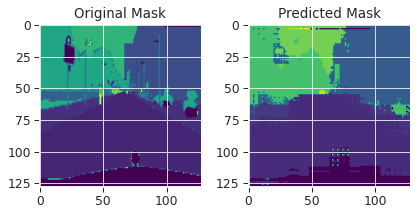

------------------------------------------------------------------------------------------------------------------------
| epoch  14 |   100/  185 batches | train accuracy    0.771 | train loss: 0.78953  | train mIOU: 0.211 | train Dice Loss: -10.83494
------------------------------------------------------------------------------------------------------------------------
| end of epoch  14 | time: 38.89s | valid accuracy:    0.718 | valid loss: 1.00003 | valid mIOU: 0.147


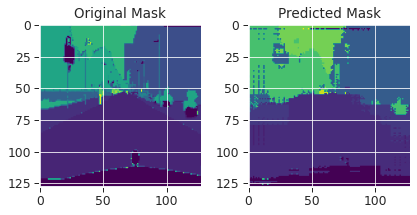

------------------------------------------------------------------------------------------------------------------------
| epoch  15 |   100/  185 batches | train accuracy    0.784 | train loss: 0.74197  | train mIOU: 0.217 | train Dice Loss: -12.43474
------------------------------------------------------------------------------------------------------------------------
| end of epoch  15 | time: 39.36s | valid accuracy:    0.715 | valid loss: 0.99125 | valid mIOU: 0.144


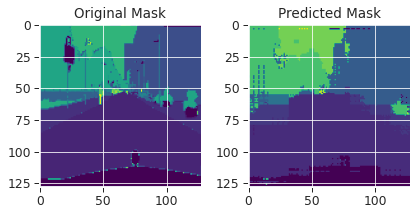

------------------------------------------------------------------------------------------------------------------------
| epoch  16 |   100/  185 batches | train accuracy    0.803 | train loss: 0.65966  | train mIOU: 0.240 | train Dice Loss: -12.11258
------------------------------------------------------------------------------------------------------------------------
| end of epoch  16 | time: 40.03s | valid accuracy:    0.726 | valid loss: 0.96772 | valid mIOU: 0.149


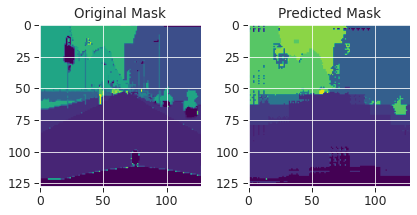

------------------------------------------------------------------------------------------------------------------------
| epoch  17 |   100/  185 batches | train accuracy    0.808 | train loss: 0.65156  | train mIOU: 0.230 | train Dice Loss: -11.74760
------------------------------------------------------------------------------------------------------------------------
| end of epoch  17 | time: 39.05s | valid accuracy:    0.732 | valid loss: 0.96541 | valid mIOU: 0.147


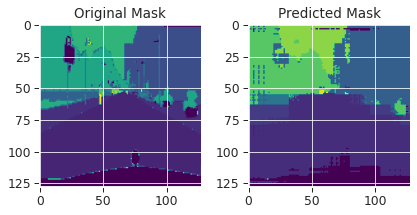

------------------------------------------------------------------------------------------------------------------------
| epoch  18 |   100/  185 batches | train accuracy    0.790 | train loss: 0.71300  | train mIOU: 0.228 | train Dice Loss: -11.55928
------------------------------------------------------------------------------------------------------------------------
| end of epoch  18 | time: 38.90s | valid accuracy:    0.724 | valid loss: 0.97121 | valid mIOU: 0.150


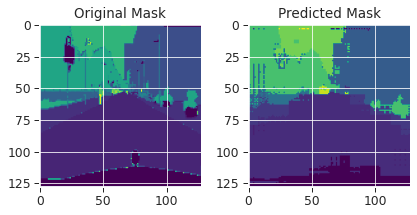

------------------------------------------------------------------------------------------------------------------------
| epoch  19 |   100/  185 batches | train accuracy    0.795 | train loss: 0.70459  | train mIOU: 0.263 | train Dice Loss: -11.16909
------------------------------------------------------------------------------------------------------------------------
| end of epoch  19 | time: 39.46s | valid accuracy:    0.727 | valid loss: 0.98720 | valid mIOU: 0.147


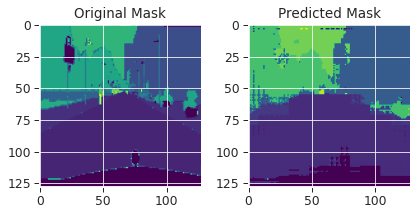

------------------------------------------------------------------------------------------------------------------------
| epoch  20 |   100/  185 batches | train accuracy    0.827 | train loss: 0.59610  | train mIOU: 0.295 | train Dice Loss: -12.41276
------------------------------------------------------------------------------------------------------------------------
| end of epoch  20 | time: 40.38s | valid accuracy:    0.731 | valid loss: 0.96621 | valid mIOU: 0.148


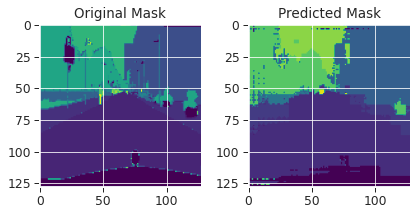

------------------------------------------------------------------------------------------------------------------------
| epoch  21 |   100/  185 batches | train accuracy    0.822 | train loss: 0.58760  | train mIOU: 0.278 | train Dice Loss: -12.74995
------------------------------------------------------------------------------------------------------------------------
| end of epoch  21 | time: 40.46s | valid accuracy:    0.727 | valid loss: 0.98244 | valid mIOU: 0.147


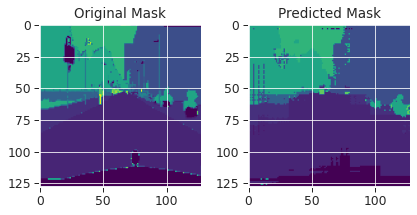

------------------------------------------------------------------------------------------------------------------------
| epoch  22 |   100/  185 batches | train accuracy    0.832 | train loss: 0.55208  | train mIOU: 0.233 | train Dice Loss: -12.01603
------------------------------------------------------------------------------------------------------------------------
| end of epoch  22 | time: 40.79s | valid accuracy:    0.730 | valid loss: 0.97075 | valid mIOU: 0.147


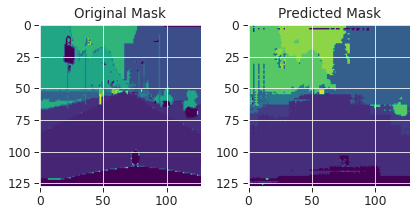

------------------------------------------------------------------------------------------------------------------------
| epoch  23 |   100/  185 batches | train accuracy    0.819 | train loss: 0.59327  | train mIOU: 0.306 | train Dice Loss: -13.10606
------------------------------------------------------------------------------------------------------------------------
| end of epoch  23 | time: 39.35s | valid accuracy:    0.729 | valid loss: 0.97201 | valid mIOU: 0.149


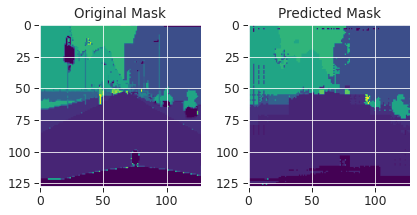

------------------------------------------------------------------------------------------------------------------------
| epoch  24 |   100/  185 batches | train accuracy    0.829 | train loss: 0.56593  | train mIOU: 0.256 | train Dice Loss: -12.17235
------------------------------------------------------------------------------------------------------------------------
| end of epoch  24 | time: 38.93s | valid accuracy:    0.736 | valid loss: 0.96088 | valid mIOU: 0.155


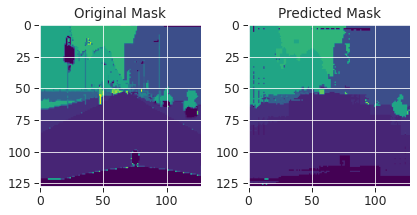

------------------------------------------------------------------------------------------------------------------------
| epoch  25 |   100/  185 batches | train accuracy    0.842 | train loss: 0.51024  | train mIOU: 0.256 | train Dice Loss: -10.56948
------------------------------------------------------------------------------------------------------------------------
| end of epoch  25 | time: 40.17s | valid accuracy:    0.732 | valid loss: 1.00111 | valid mIOU: 0.152


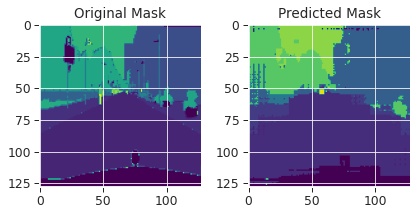

------------------------------------------------------------------------------------------------------------------------
| epoch  26 |   100/  185 batches | train accuracy    0.828 | train loss: 0.55668  | train mIOU: 0.299 | train Dice Loss: -11.90907
------------------------------------------------------------------------------------------------------------------------
| end of epoch  26 | time: 38.66s | valid accuracy:    0.737 | valid loss: 0.97403 | valid mIOU: 0.154


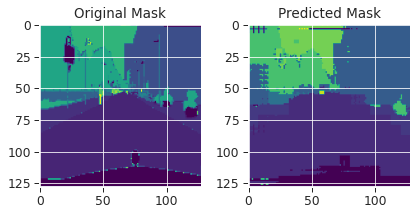

------------------------------------------------------------------------------------------------------------------------
| epoch  27 |   100/  185 batches | train accuracy    0.845 | train loss: 0.50542  | train mIOU: 0.292 | train Dice Loss: -12.50115
------------------------------------------------------------------------------------------------------------------------
| end of epoch  27 | time: 39.10s | valid accuracy:    0.733 | valid loss: 0.99228 | valid mIOU: 0.151


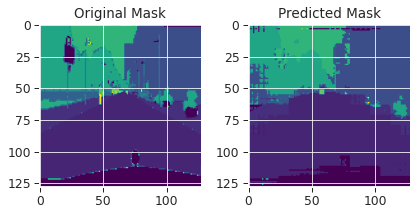

------------------------------------------------------------------------------------------------------------------------
| epoch  28 |   100/  185 batches | train accuracy    0.825 | train loss: 0.57427  | train mIOU: 0.319 | train Dice Loss: -12.48191
------------------------------------------------------------------------------------------------------------------------
| end of epoch  28 | time: 39.00s | valid accuracy:    0.735 | valid loss: 0.99328 | valid mIOU: 0.150


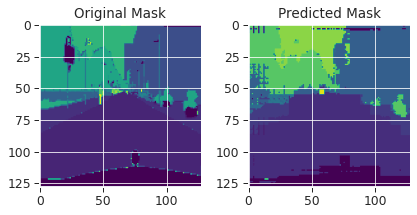

------------------------------------------------------------------------------------------------------------------------
| epoch  29 |   100/  185 batches | train accuracy    0.825 | train loss: 0.56960  | train mIOU: 0.260 | train Dice Loss: -12.62943
------------------------------------------------------------------------------------------------------------------------
| end of epoch  29 | time: 39.22s | valid accuracy:    0.730 | valid loss: 0.97992 | valid mIOU: 0.148


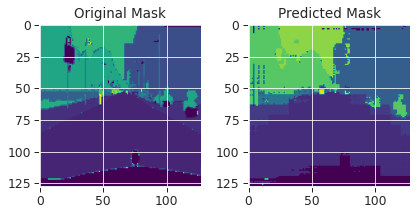

------------------------------------------------------------------------------------------------------------------------
| epoch  30 |   100/  185 batches | train accuracy    0.839 | train loss: 0.51011  | train mIOU: 0.266 | train Dice Loss: -12.65157
------------------------------------------------------------------------------------------------------------------------
| end of epoch  30 | time: 38.83s | valid accuracy:    0.735 | valid loss: 0.97861 | valid mIOU: 0.153


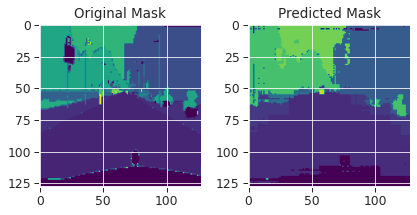

------------------------------------------------------------------------------------------------------------------------
| epoch  31 |   100/  185 batches | train accuracy    0.834 | train loss: 0.53340  | train mIOU: 0.291 | train Dice Loss: -12.97342
------------------------------------------------------------------------------------------------------------------------
| end of epoch  31 | time: 39.73s | valid accuracy:    0.735 | valid loss: 0.98254 | valid mIOU: 0.153


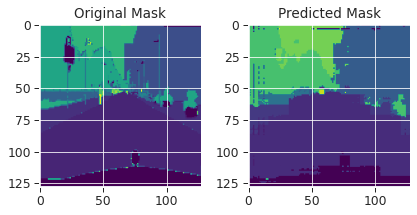

------------------------------------------------------------------------------------------------------------------------
| epoch  32 |   100/  185 batches | train accuracy    0.838 | train loss: 0.52310  | train mIOU: 0.325 | train Dice Loss: -12.17787
------------------------------------------------------------------------------------------------------------------------
| end of epoch  32 | time: 39.31s | valid accuracy:    0.723 | valid loss: 1.00572 | valid mIOU: 0.152


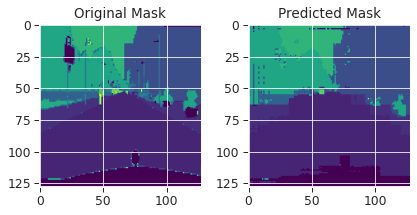

------------------------------------------------------------------------------------------------------------------------
| epoch  33 |   100/  185 batches | train accuracy    0.839 | train loss: 0.50504  | train mIOU: 0.263 | train Dice Loss: -12.23413
------------------------------------------------------------------------------------------------------------------------
| end of epoch  33 | time: 38.96s | valid accuracy:    0.743 | valid loss: 0.98266 | valid mIOU: 0.162


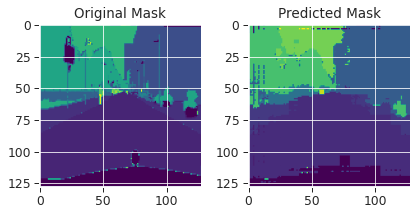

------------------------------------------------------------------------------------------------------------------------
| epoch  34 |   100/  185 batches | train accuracy    0.843 | train loss: 0.50069  | train mIOU: 0.318 | train Dice Loss: -12.46685
------------------------------------------------------------------------------------------------------------------------
| end of epoch  34 | time: 39.29s | valid accuracy:    0.733 | valid loss: 0.99580 | valid mIOU: 0.157


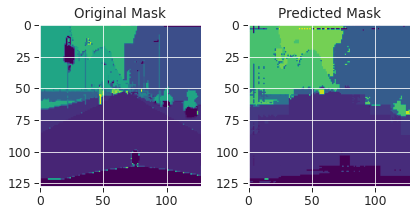

------------------------------------------------------------------------------------------------------------------------
| epoch  35 |   100/  185 batches | train accuracy    0.840 | train loss: 0.51659  | train mIOU: 0.324 | train Dice Loss: -13.37211
------------------------------------------------------------------------------------------------------------------------
| end of epoch  35 | time: 40.45s | valid accuracy:    0.742 | valid loss: 0.95926 | valid mIOU: 0.160


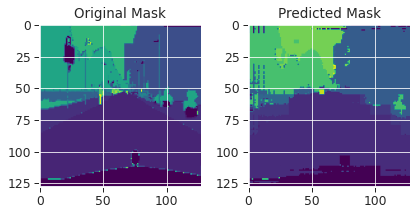

------------------------------------------------------------------------------------------------------------------------
| epoch  36 |   100/  185 batches | train accuracy    0.858 | train loss: 0.45288  | train mIOU: 0.301 | train Dice Loss: -13.35493
------------------------------------------------------------------------------------------------------------------------
| end of epoch  36 | time: 39.07s | valid accuracy:    0.738 | valid loss: 0.98362 | valid mIOU: 0.161


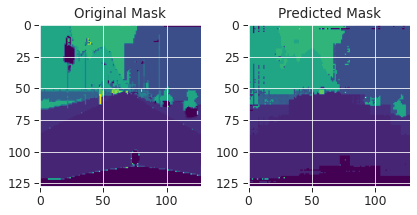

------------------------------------------------------------------------------------------------------------------------
| epoch  37 |   100/  185 batches | train accuracy    0.839 | train loss: 0.51763  | train mIOU: 0.309 | train Dice Loss: -12.47315
------------------------------------------------------------------------------------------------------------------------
| end of epoch  37 | time: 39.00s | valid accuracy:    0.731 | valid loss: 0.98581 | valid mIOU: 0.160


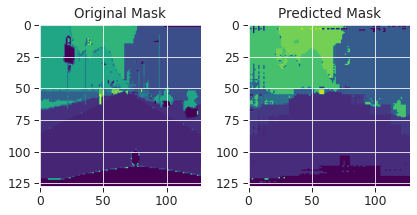

------------------------------------------------------------------------------------------------------------------------
| epoch  38 |   100/  185 batches | train accuracy    0.850 | train loss: 0.47666  | train mIOU: 0.313 | train Dice Loss: -11.92024
------------------------------------------------------------------------------------------------------------------------
| end of epoch  38 | time: 40.28s | valid accuracy:    0.740 | valid loss: 0.96417 | valid mIOU: 0.163


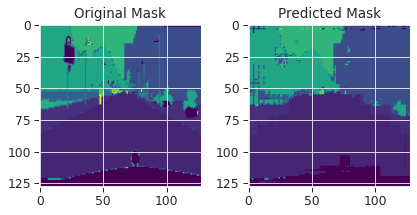

------------------------------------------------------------------------------------------------------------------------
| epoch  39 |   100/  185 batches | train accuracy    0.853 | train loss: 0.46662  | train mIOU: 0.278 | train Dice Loss: -12.43974
------------------------------------------------------------------------------------------------------------------------
| end of epoch  39 | time: 40.12s | valid accuracy:    0.735 | valid loss: 0.98360 | valid mIOU: 0.165


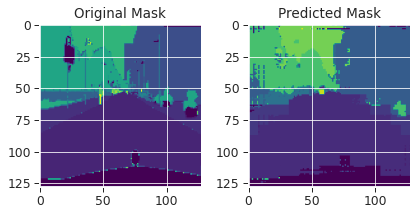

------------------------------------------------------------------------------------------------------------------------
| epoch  40 |   100/  185 batches | train accuracy    0.851 | train loss: 0.47151  | train mIOU: 0.370 | train Dice Loss: -12.44977
------------------------------------------------------------------------------------------------------------------------
| end of epoch  40 | time: 40.06s | valid accuracy:    0.742 | valid loss: 0.96650 | valid mIOU: 0.172


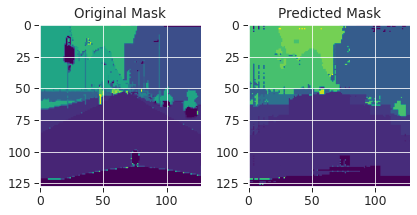

------------------------------------------------------------------------------------------------------------------------
| epoch  41 |   100/  185 batches | train accuracy    0.836 | train loss: 0.52107  | train mIOU: 0.305 | train Dice Loss: -12.51783
------------------------------------------------------------------------------------------------------------------------
| end of epoch  41 | time: 39.52s | valid accuracy:    0.740 | valid loss: 0.97734 | valid mIOU: 0.162


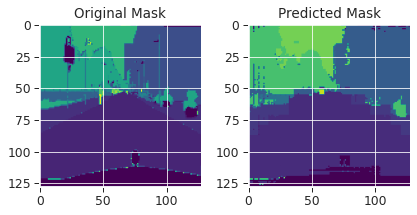

------------------------------------------------------------------------------------------------------------------------
| epoch  42 |   100/  185 batches | train accuracy    0.857 | train loss: 0.43746  | train mIOU: 0.309 | train Dice Loss: -11.57567
------------------------------------------------------------------------------------------------------------------------
| end of epoch  42 | time: 39.18s | valid accuracy:    0.743 | valid loss: 0.97028 | valid mIOU: 0.164


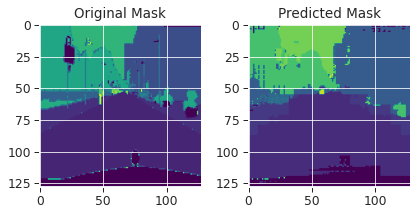

------------------------------------------------------------------------------------------------------------------------
| epoch  43 |   100/  185 batches | train accuracy    0.845 | train loss: 0.49709  | train mIOU: 0.345 | train Dice Loss: -13.08541
------------------------------------------------------------------------------------------------------------------------
| end of epoch  43 | time: 40.94s | valid accuracy:    0.747 | valid loss: 0.94279 | valid mIOU: 0.168


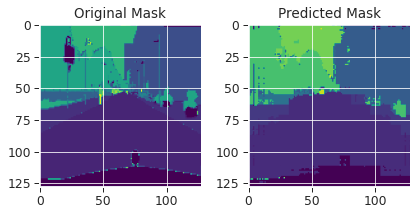

------------------------------------------------------------------------------------------------------------------------
| epoch  44 |   100/  185 batches | train accuracy    0.859 | train loss: 0.44072  | train mIOU: 0.352 | train Dice Loss: -12.93322
------------------------------------------------------------------------------------------------------------------------
| end of epoch  44 | time: 40.66s | valid accuracy:    0.738 | valid loss: 0.99325 | valid mIOU: 0.166


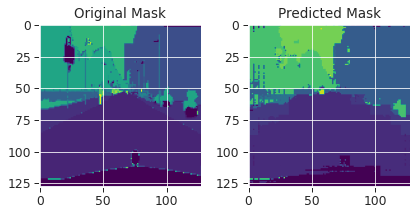

------------------------------------------------------------------------------------------------------------------------
| epoch  45 |   100/  185 batches | train accuracy    0.856 | train loss: 0.45110  | train mIOU: 0.382 | train Dice Loss: -13.22389
------------------------------------------------------------------------------------------------------------------------
| end of epoch  45 | time: 41.42s | valid accuracy:    0.749 | valid loss: 0.97115 | valid mIOU: 0.175


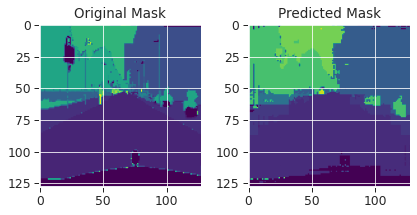

------------------------------------------------------------------------------------------------------------------------
| epoch  46 |   100/  185 batches | train accuracy    0.856 | train loss: 0.44580  | train mIOU: 0.312 | train Dice Loss: -12.00922
------------------------------------------------------------------------------------------------------------------------
| end of epoch  46 | time: 40.54s | valid accuracy:    0.740 | valid loss: 0.97989 | valid mIOU: 0.167


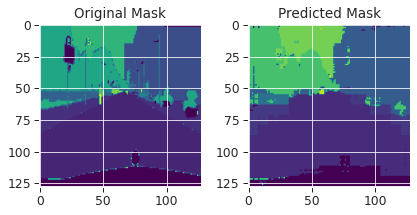

------------------------------------------------------------------------------------------------------------------------
| epoch  47 |   100/  185 batches | train accuracy    0.860 | train loss: 0.44326  | train mIOU: 0.374 | train Dice Loss: -12.60476
------------------------------------------------------------------------------------------------------------------------
| end of epoch  47 | time: 39.59s | valid accuracy:    0.752 | valid loss: 0.97021 | valid mIOU: 0.174


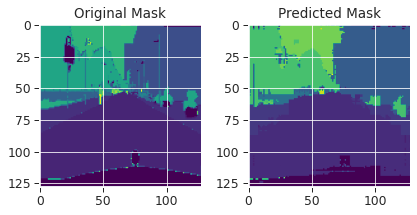

------------------------------------------------------------------------------------------------------------------------
| epoch  48 |   100/  185 batches | train accuracy    0.847 | train loss: 0.47563  | train mIOU: 0.316 | train Dice Loss: -11.19335
------------------------------------------------------------------------------------------------------------------------
| end of epoch  48 | time: 41.62s | valid accuracy:    0.750 | valid loss: 0.96759 | valid mIOU: 0.178


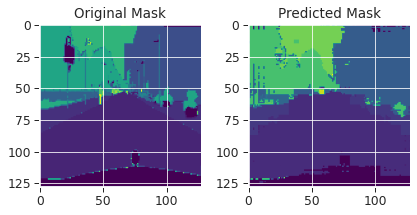

------------------------------------------------------------------------------------------------------------------------
| epoch  49 |   100/  185 batches | train accuracy    0.865 | train loss: 0.41288  | train mIOU: 0.376 | train Dice Loss: -12.39455
------------------------------------------------------------------------------------------------------------------------
| end of epoch  49 | time: 42.01s | valid accuracy:    0.754 | valid loss: 0.95806 | valid mIOU: 0.174


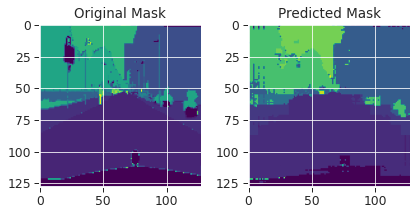

------------------------------------------------------------------------------------------------------------------------
| epoch  50 |   100/  185 batches | train accuracy    0.867 | train loss: 0.40957  | train mIOU: 0.351 | train Dice Loss: -12.67185
------------------------------------------------------------------------------------------------------------------------
| end of epoch  50 | time: 42.17s | valid accuracy:    0.748 | valid loss: 0.97765 | valid mIOU: 0.175


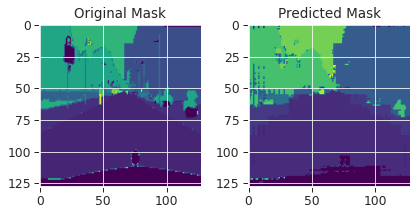

------------------------------------------------------------------------------------------------------------------------
| epoch  51 |   100/  185 batches | train accuracy    0.860 | train loss: 0.42853  | train mIOU: 0.331 | train Dice Loss: -12.65391
------------------------------------------------------------------------------------------------------------------------
| end of epoch  51 | time: 41.54s | valid accuracy:    0.742 | valid loss: 0.97302 | valid mIOU: 0.171


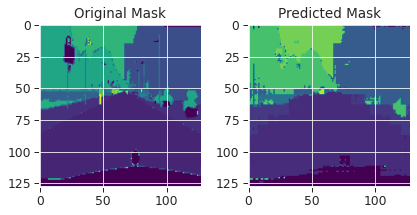

------------------------------------------------------------------------------------------------------------------------
| epoch  52 |   100/  185 batches | train accuracy    0.862 | train loss: 0.43007  | train mIOU: 0.354 | train Dice Loss: -13.03745
------------------------------------------------------------------------------------------------------------------------
| end of epoch  52 | time: 39.98s | valid accuracy:    0.746 | valid loss: 0.97082 | valid mIOU: 0.170


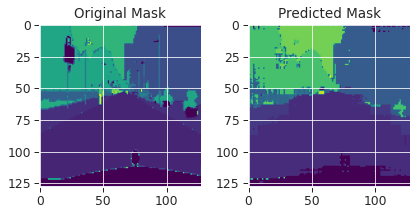

------------------------------------------------------------------------------------------------------------------------
| epoch  53 |   100/  185 batches | train accuracy    0.870 | train loss: 0.39875  | train mIOU: 0.328 | train Dice Loss: -13.02698
------------------------------------------------------------------------------------------------------------------------
| end of epoch  53 | time: 40.74s | valid accuracy:    0.745 | valid loss: 0.97119 | valid mIOU: 0.174


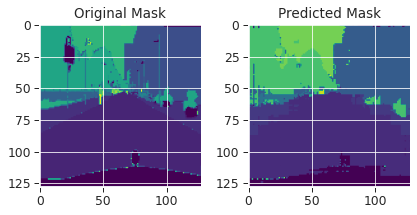

------------------------------------------------------------------------------------------------------------------------
| epoch  54 |   100/  185 batches | train accuracy    0.864 | train loss: 0.42437  | train mIOU: 0.363 | train Dice Loss: -12.24142
------------------------------------------------------------------------------------------------------------------------
| end of epoch  54 | time: 41.35s | valid accuracy:    0.746 | valid loss: 0.97854 | valid mIOU: 0.175


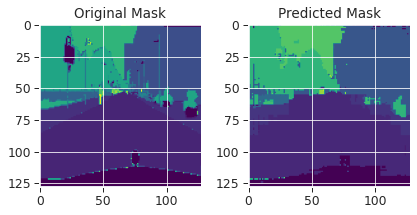

------------------------------------------------------------------------------------------------------------------------
| epoch  55 |   100/  185 batches | train accuracy    0.863 | train loss: 0.42805  | train mIOU: 0.340 | train Dice Loss: -12.58119
------------------------------------------------------------------------------------------------------------------------
| end of epoch  55 | time: 41.92s | valid accuracy:    0.748 | valid loss: 0.96785 | valid mIOU: 0.180


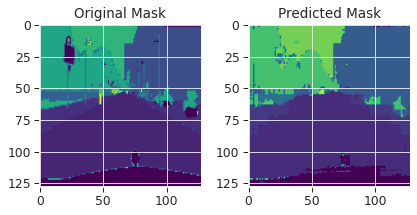

------------------------------------------------------------------------------------------------------------------------
| epoch  56 |   100/  185 batches | train accuracy    0.853 | train loss: 0.45666  | train mIOU: 0.328 | train Dice Loss: -12.77457
------------------------------------------------------------------------------------------------------------------------
| end of epoch  56 | time: 41.67s | valid accuracy:    0.748 | valid loss: 0.96425 | valid mIOU: 0.177


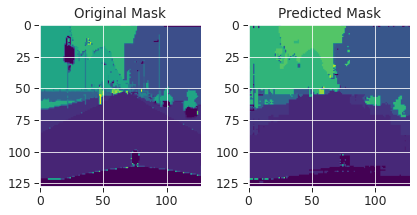

------------------------------------------------------------------------------------------------------------------------
| epoch  57 |   100/  185 batches | train accuracy    0.871 | train loss: 0.38954  | train mIOU: 0.310 | train Dice Loss: -13.06770
------------------------------------------------------------------------------------------------------------------------
| end of epoch  57 | time: 40.48s | valid accuracy:    0.747 | valid loss: 0.97951 | valid mIOU: 0.180


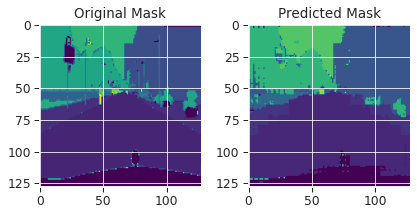

------------------------------------------------------------------------------------------------------------------------
| epoch  58 |   100/  185 batches | train accuracy    0.869 | train loss: 0.40375  | train mIOU: 0.378 | train Dice Loss: -12.74289
------------------------------------------------------------------------------------------------------------------------
| end of epoch  58 | time: 41.16s | valid accuracy:    0.748 | valid loss: 0.96294 | valid mIOU: 0.175


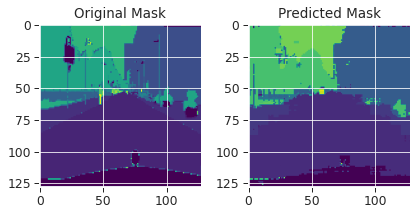

------------------------------------------------------------------------------------------------------------------------
| epoch  59 |   100/  185 batches | train accuracy    0.865 | train loss: 0.41429  | train mIOU: 0.345 | train Dice Loss: -12.86091
------------------------------------------------------------------------------------------------------------------------
| end of epoch  59 | time: 41.16s | valid accuracy:    0.751 | valid loss: 0.96710 | valid mIOU: 0.176


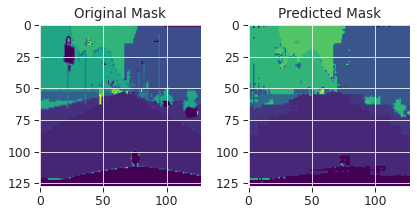

------------------------------------------------------------------------------------------------------------------------
| epoch  60 |   100/  185 batches | train accuracy    0.866 | train loss: 0.41640  | train mIOU: 0.339 | train Dice Loss: -13.00924
------------------------------------------------------------------------------------------------------------------------
| end of epoch  60 | time: 41.22s | valid accuracy:    0.753 | valid loss: 0.97572 | valid mIOU: 0.180


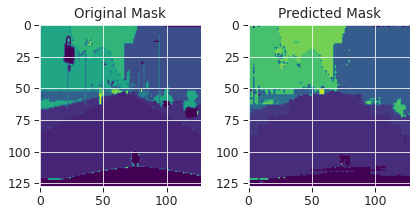

------------------------------------------------------------------------------------------------------------------------
| epoch  61 |   100/  185 batches | train accuracy    0.865 | train loss: 0.42170  | train mIOU: 0.423 | train Dice Loss: -13.30827
------------------------------------------------------------------------------------------------------------------------
| end of epoch  61 | time: 40.51s | valid accuracy:    0.746 | valid loss: 0.97265 | valid mIOU: 0.178


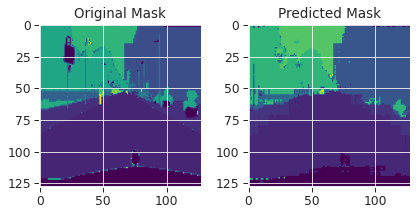

------------------------------------------------------------------------------------------------------------------------
| epoch  62 |   100/  185 batches | train accuracy    0.878 | train loss: 0.38156  | train mIOU: 0.356 | train Dice Loss: -14.03492
------------------------------------------------------------------------------------------------------------------------
| end of epoch  62 | time: 40.50s | valid accuracy:    0.754 | valid loss: 0.97321 | valid mIOU: 0.178


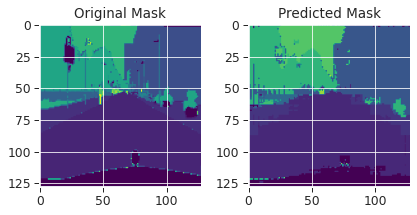

------------------------------------------------------------------------------------------------------------------------
| epoch  63 |   100/  185 batches | train accuracy    0.855 | train loss: 0.43996  | train mIOU: 0.328 | train Dice Loss: -10.91252
------------------------------------------------------------------------------------------------------------------------
| end of epoch  63 | time: 40.26s | valid accuracy:    0.758 | valid loss: 0.94769 | valid mIOU: 0.180


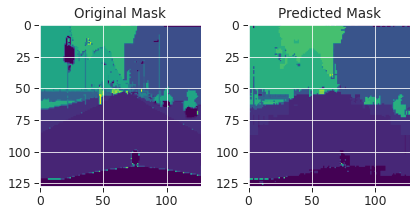

------------------------------------------------------------------------------------------------------------------------
| epoch  64 |   100/  185 batches | train accuracy    0.863 | train loss: 0.41544  | train mIOU: 0.363 | train Dice Loss: -12.24203
------------------------------------------------------------------------------------------------------------------------
| end of epoch  64 | time: 41.51s | valid accuracy:    0.749 | valid loss: 0.97384 | valid mIOU: 0.179


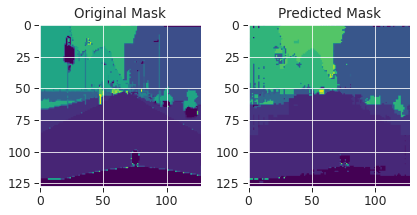

------------------------------------------------------------------------------------------------------------------------
| epoch  65 |   100/  185 batches | train accuracy    0.852 | train loss: 0.44763  | train mIOU: 0.372 | train Dice Loss: -11.63713
------------------------------------------------------------------------------------------------------------------------
| end of epoch  65 | time: 41.75s | valid accuracy:    0.757 | valid loss: 0.95859 | valid mIOU: 0.183


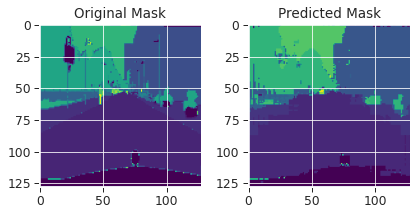

------------------------------------------------------------------------------------------------------------------------
| epoch  66 |   100/  185 batches | train accuracy    0.859 | train loss: 0.43150  | train mIOU: 0.336 | train Dice Loss: -11.36584
------------------------------------------------------------------------------------------------------------------------
| end of epoch  66 | time: 41.10s | valid accuracy:    0.749 | valid loss: 0.98666 | valid mIOU: 0.179


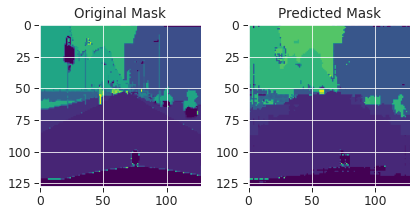

------------------------------------------------------------------------------------------------------------------------
| epoch  67 |   100/  185 batches | train accuracy    0.853 | train loss: 0.45097  | train mIOU: 0.390 | train Dice Loss: -13.33746
------------------------------------------------------------------------------------------------------------------------
| end of epoch  67 | time: 40.24s | valid accuracy:    0.754 | valid loss: 0.96272 | valid mIOU: 0.180


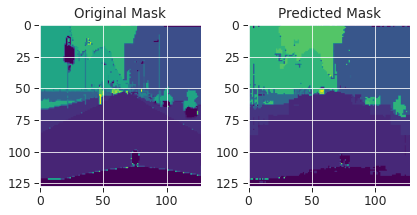

------------------------------------------------------------------------------------------------------------------------
| epoch  68 |   100/  185 batches | train accuracy    0.885 | train loss: 0.36032  | train mIOU: 0.383 | train Dice Loss: -12.23875
------------------------------------------------------------------------------------------------------------------------
| end of epoch  68 | time: 40.17s | valid accuracy:    0.756 | valid loss: 0.96599 | valid mIOU: 0.181


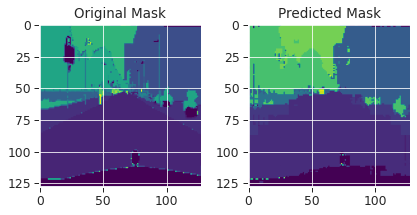

------------------------------------------------------------------------------------------------------------------------
| epoch  69 |   100/  185 batches | train accuracy    0.882 | train loss: 0.36186  | train mIOU: 0.345 | train Dice Loss: -12.61722
------------------------------------------------------------------------------------------------------------------------
| end of epoch  69 | time: 39.82s | valid accuracy:    0.758 | valid loss: 0.96450 | valid mIOU: 0.184


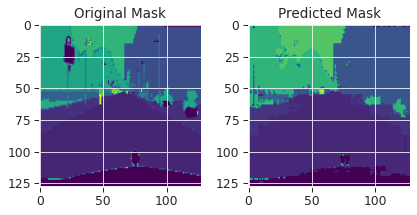

------------------------------------------------------------------------------------------------------------------------
| epoch  70 |   100/  185 batches | train accuracy    0.866 | train loss: 0.40705  | train mIOU: 0.381 | train Dice Loss: -13.61748
------------------------------------------------------------------------------------------------------------------------
| end of epoch  70 | time: 39.55s | valid accuracy:    0.759 | valid loss: 0.94708 | valid mIOU: 0.184


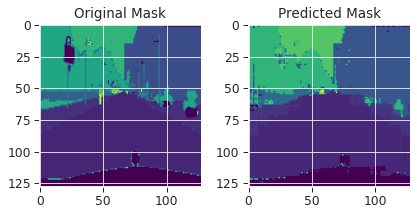

------------------------------------------------------------------------------------------------------------------------
| epoch  71 |   100/  185 batches | train accuracy    0.881 | train loss: 0.36721  | train mIOU: 0.322 | train Dice Loss: -12.87476
------------------------------------------------------------------------------------------------------------------------
| end of epoch  71 | time: 41.99s | valid accuracy:    0.757 | valid loss: 0.96458 | valid mIOU: 0.183


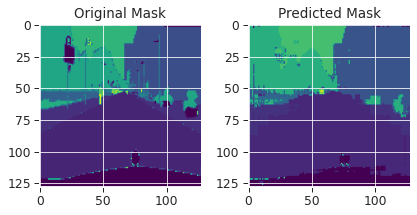

------------------------------------------------------------------------------------------------------------------------
| epoch  72 |   100/  185 batches | train accuracy    0.859 | train loss: 0.42747  | train mIOU: 0.397 | train Dice Loss: -12.64249
------------------------------------------------------------------------------------------------------------------------
| end of epoch  72 | time: 39.34s | valid accuracy:    0.755 | valid loss: 0.95326 | valid mIOU: 0.181


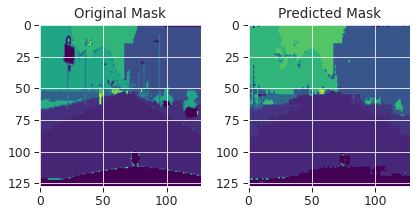

------------------------------------------------------------------------------------------------------------------------
| epoch  73 |   100/  185 batches | train accuracy    0.874 | train loss: 0.38407  | train mIOU: 0.357 | train Dice Loss: -12.33701
------------------------------------------------------------------------------------------------------------------------
| end of epoch  73 | time: 40.40s | valid accuracy:    0.761 | valid loss: 0.95323 | valid mIOU: 0.190


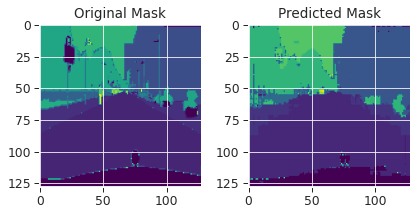

------------------------------------------------------------------------------------------------------------------------
| epoch  74 |   100/  185 batches | train accuracy    0.869 | train loss: 0.39141  | train mIOU: 0.357 | train Dice Loss: -12.81437
------------------------------------------------------------------------------------------------------------------------
| end of epoch  74 | time: 40.34s | valid accuracy:    0.761 | valid loss: 0.97104 | valid mIOU: 0.185


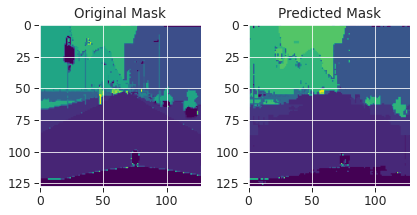

------------------------------------------------------------------------------------------------------------------------
| epoch  75 |   100/  185 batches | train accuracy    0.876 | train loss: 0.37851  | train mIOU: 0.359 | train Dice Loss: -12.71919
------------------------------------------------------------------------------------------------------------------------
| end of epoch  75 | time: 39.14s | valid accuracy:    0.757 | valid loss: 0.95493 | valid mIOU: 0.187


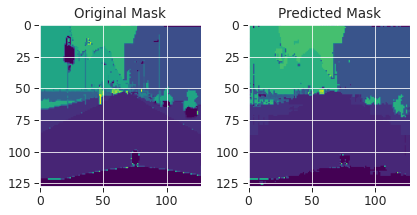

------------------------------------------------------------------------------------------------------------------------
| epoch  76 |   100/  185 batches | train accuracy    0.882 | train loss: 0.36353  | train mIOU: 0.363 | train Dice Loss: -12.07598
------------------------------------------------------------------------------------------------------------------------
| end of epoch  76 | time: 40.53s | valid accuracy:    0.758 | valid loss: 0.96131 | valid mIOU: 0.186


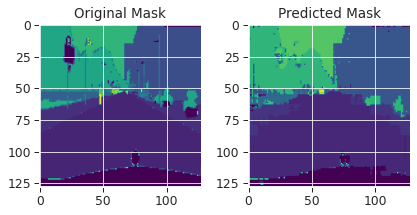

------------------------------------------------------------------------------------------------------------------------
| epoch  77 |   100/  185 batches | train accuracy    0.872 | train loss: 0.38610  | train mIOU: 0.365 | train Dice Loss: -11.95368
------------------------------------------------------------------------------------------------------------------------
| end of epoch  77 | time: 40.31s | valid accuracy:    0.764 | valid loss: 0.96349 | valid mIOU: 0.193


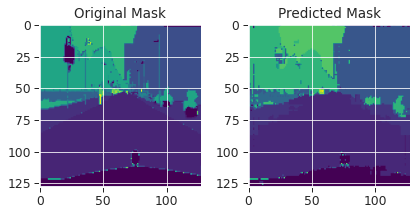

------------------------------------------------------------------------------------------------------------------------
| epoch  78 |   100/  185 batches | train accuracy    0.876 | train loss: 0.37338  | train mIOU: 0.399 | train Dice Loss: -13.83238
------------------------------------------------------------------------------------------------------------------------
| end of epoch  78 | time: 42.25s | valid accuracy:    0.760 | valid loss: 0.95971 | valid mIOU: 0.186


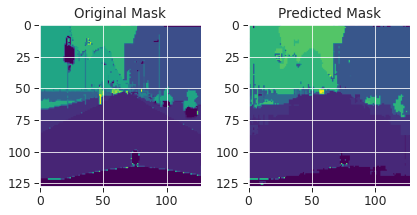

------------------------------------------------------------------------------------------------------------------------
| epoch  79 |   100/  185 batches | train accuracy    0.875 | train loss: 0.37818  | train mIOU: 0.363 | train Dice Loss: -11.90831
------------------------------------------------------------------------------------------------------------------------
| end of epoch  79 | time: 41.09s | valid accuracy:    0.765 | valid loss: 0.95311 | valid mIOU: 0.184


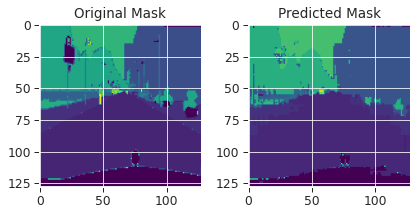

------------------------------------------------------------------------------------------------------------------------
| epoch  80 |   100/  185 batches | train accuracy    0.865 | train loss: 0.40799  | train mIOU: 0.366 | train Dice Loss: -12.51400
------------------------------------------------------------------------------------------------------------------------
| end of epoch  80 | time: 40.26s | valid accuracy:    0.772 | valid loss: 0.94174 | valid mIOU: 0.196


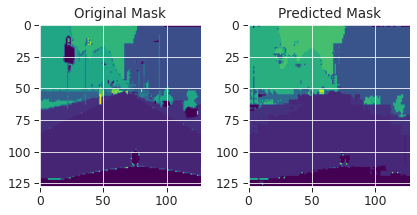

------------------------------------------------------------------------------------------------------------------------
| epoch  81 |   100/  185 batches | train accuracy    0.864 | train loss: 0.41313  | train mIOU: 0.435 | train Dice Loss: -13.66481
------------------------------------------------------------------------------------------------------------------------
| end of epoch  81 | time: 40.16s | valid accuracy:    0.759 | valid loss: 0.95808 | valid mIOU: 0.188


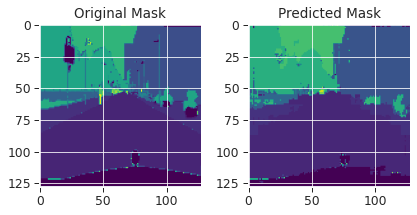

------------------------------------------------------------------------------------------------------------------------
| epoch  82 |   100/  185 batches | train accuracy    0.873 | train loss: 0.37406  | train mIOU: 0.380 | train Dice Loss: -12.65227
------------------------------------------------------------------------------------------------------------------------
| end of epoch  82 | time: 40.49s | valid accuracy:    0.765 | valid loss: 0.95441 | valid mIOU: 0.185


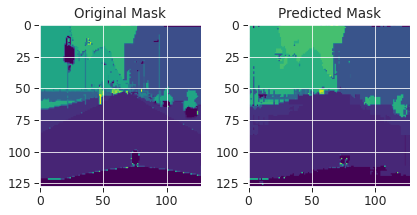

------------------------------------------------------------------------------------------------------------------------
| epoch  83 |   100/  185 batches | train accuracy    0.863 | train loss: 0.39677  | train mIOU: 0.357 | train Dice Loss: -11.76945
------------------------------------------------------------------------------------------------------------------------
| end of epoch  83 | time: 39.67s | valid accuracy:    0.766 | valid loss: 0.95924 | valid mIOU: 0.192


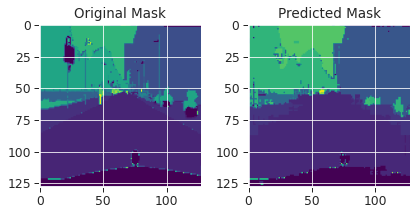

------------------------------------------------------------------------------------------------------------------------
| epoch  84 |   100/  185 batches | train accuracy    0.878 | train loss: 0.37255  | train mIOU: 0.396 | train Dice Loss: -12.42384
------------------------------------------------------------------------------------------------------------------------
| end of epoch  84 | time: 40.24s | valid accuracy:    0.767 | valid loss: 0.94016 | valid mIOU: 0.189


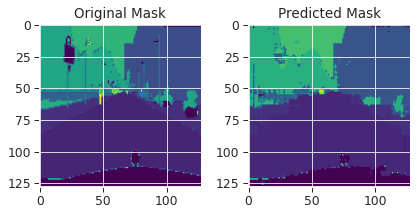

------------------------------------------------------------------------------------------------------------------------
| epoch  85 |   100/  185 batches | train accuracy    0.871 | train loss: 0.39235  | train mIOU: 0.373 | train Dice Loss: -12.46886
------------------------------------------------------------------------------------------------------------------------
| end of epoch  85 | time: 40.19s | valid accuracy:    0.764 | valid loss: 0.96970 | valid mIOU: 0.192


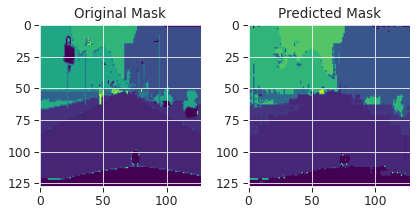

------------------------------------------------------------------------------------------------------------------------
| epoch  86 |   100/  185 batches | train accuracy    0.875 | train loss: 0.37920  | train mIOU: 0.357 | train Dice Loss: -12.85291
------------------------------------------------------------------------------------------------------------------------
| end of epoch  86 | time: 41.31s | valid accuracy:    0.765 | valid loss: 0.93631 | valid mIOU: 0.191


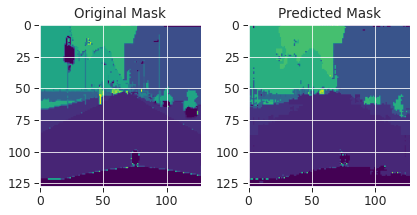

------------------------------------------------------------------------------------------------------------------------
| epoch  87 |   100/  185 batches | train accuracy    0.877 | train loss: 0.37018  | train mIOU: 0.381 | train Dice Loss: -13.56763
------------------------------------------------------------------------------------------------------------------------
| end of epoch  87 | time: 40.82s | valid accuracy:    0.760 | valid loss: 0.97442 | valid mIOU: 0.191


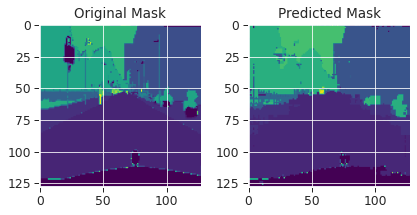

------------------------------------------------------------------------------------------------------------------------
| epoch  88 |   100/  185 batches | train accuracy    0.868 | train loss: 0.39541  | train mIOU: 0.395 | train Dice Loss: -11.35419
------------------------------------------------------------------------------------------------------------------------
| end of epoch  88 | time: 40.89s | valid accuracy:    0.770 | valid loss: 0.94843 | valid mIOU: 0.195


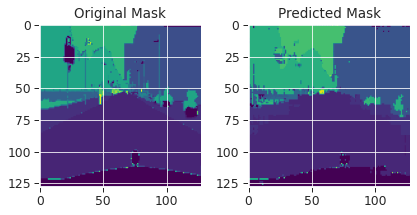

------------------------------------------------------------------------------------------------------------------------
| epoch  89 |   100/  185 batches | train accuracy    0.866 | train loss: 0.39742  | train mIOU: 0.356 | train Dice Loss: -11.93047
------------------------------------------------------------------------------------------------------------------------
| end of epoch  89 | time: 39.92s | valid accuracy:    0.770 | valid loss: 0.94533 | valid mIOU: 0.190


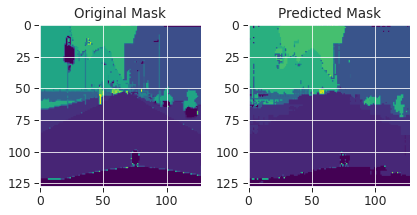

------------------------------------------------------------------------------------------------------------------------
| epoch  90 |   100/  185 batches | train accuracy    0.896 | train loss: 0.31316  | train mIOU: 0.382 | train Dice Loss: -11.64456
------------------------------------------------------------------------------------------------------------------------
| end of epoch  90 | time: 39.80s | valid accuracy:    0.771 | valid loss: 0.92239 | valid mIOU: 0.193


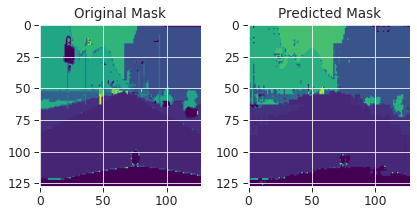

------------------------------------------------------------------------------------------------------------------------
| epoch  91 |   100/  185 batches | train accuracy    0.883 | train loss: 0.35649  | train mIOU: 0.352 | train Dice Loss: -12.54832
------------------------------------------------------------------------------------------------------------------------
| end of epoch  91 | time: 39.26s | valid accuracy:    0.769 | valid loss: 0.93498 | valid mIOU: 0.197


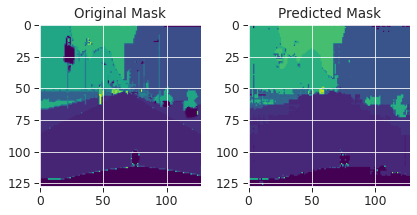

------------------------------------------------------------------------------------------------------------------------
| epoch  92 |   100/  185 batches | train accuracy    0.877 | train loss: 0.36461  | train mIOU: 0.376 | train Dice Loss: -12.65557
------------------------------------------------------------------------------------------------------------------------
| end of epoch  92 | time: 40.42s | valid accuracy:    0.764 | valid loss: 0.95662 | valid mIOU: 0.191


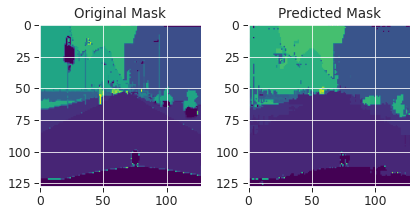

------------------------------------------------------------------------------------------------------------------------
| epoch  93 |   100/  185 batches | train accuracy    0.885 | train loss: 0.34271  | train mIOU: 0.373 | train Dice Loss: -12.23666
------------------------------------------------------------------------------------------------------------------------
| end of epoch  93 | time: 40.53s | valid accuracy:    0.771 | valid loss: 0.93580 | valid mIOU: 0.197


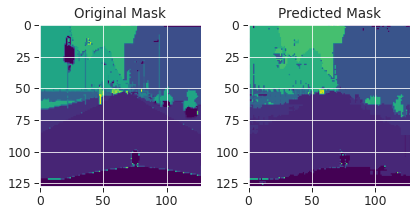

------------------------------------------------------------------------------------------------------------------------
| epoch  94 |   100/  185 batches | train accuracy    0.874 | train loss: 0.37141  | train mIOU: 0.370 | train Dice Loss: -12.02517
------------------------------------------------------------------------------------------------------------------------
| end of epoch  94 | time: 40.93s | valid accuracy:    0.765 | valid loss: 0.96287 | valid mIOU: 0.197


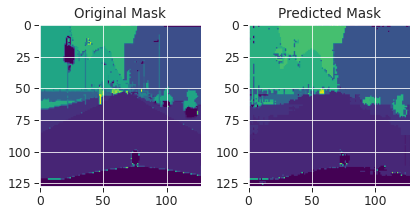

------------------------------------------------------------------------------------------------------------------------
| epoch  95 |   100/  185 batches | train accuracy    0.883 | train loss: 0.34717  | train mIOU: 0.350 | train Dice Loss: -12.25349
------------------------------------------------------------------------------------------------------------------------
| end of epoch  95 | time: 41.55s | valid accuracy:    0.763 | valid loss: 0.97911 | valid mIOU: 0.189


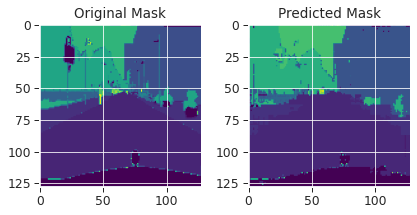

------------------------------------------------------------------------------------------------------------------------
| epoch  96 |   100/  185 batches | train accuracy    0.882 | train loss: 0.35058  | train mIOU: 0.366 | train Dice Loss: -12.52518
------------------------------------------------------------------------------------------------------------------------
| end of epoch  96 | time: 39.51s | valid accuracy:    0.770 | valid loss: 0.94094 | valid mIOU: 0.197


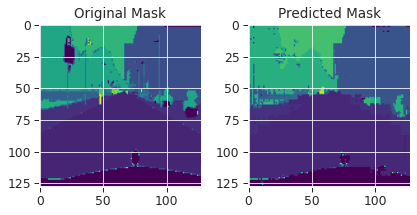

------------------------------------------------------------------------------------------------------------------------
| epoch  97 |   100/  185 batches | train accuracy    0.868 | train loss: 0.39484  | train mIOU: 0.427 | train Dice Loss: -13.48421
------------------------------------------------------------------------------------------------------------------------
| end of epoch  97 | time: 39.10s | valid accuracy:    0.767 | valid loss: 0.97329 | valid mIOU: 0.189


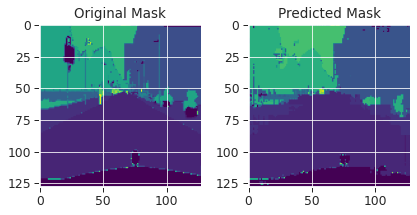

------------------------------------------------------------------------------------------------------------------------
| epoch  98 |   100/  185 batches | train accuracy    0.865 | train loss: 0.39431  | train mIOU: 0.376 | train Dice Loss: -12.39100
------------------------------------------------------------------------------------------------------------------------
| end of epoch  98 | time: 39.53s | valid accuracy:    0.775 | valid loss: 0.94399 | valid mIOU: 0.201


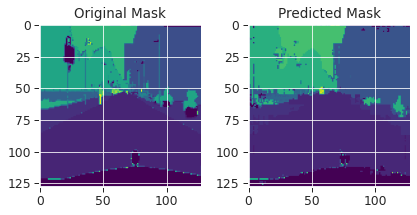

------------------------------------------------------------------------------------------------------------------------
| epoch  99 |   100/  185 batches | train accuracy    0.879 | train loss: 0.36121  | train mIOU: 0.401 | train Dice Loss: -13.81322
------------------------------------------------------------------------------------------------------------------------
| end of epoch  99 | time: 38.98s | valid accuracy:    0.763 | valid loss: 0.96623 | valid mIOU: 0.187


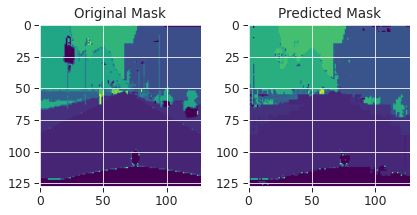

------------------------------------------------------------------------------------------------------------------------
| epoch 100 |   100/  185 batches | train accuracy    0.877 | train loss: 0.36402  | train mIOU: 0.360 | train Dice Loss: -11.88963
------------------------------------------------------------------------------------------------------------------------
| end of epoch 100 | time: 39.12s | valid accuracy:    0.770 | valid loss: 0.94874 | valid mIOU: 0.198


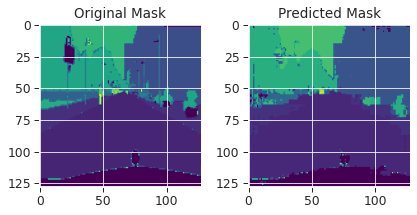

------------------------------------------------------------------------------------------------------------------------
| epoch 101 |   100/  185 batches | train accuracy    0.875 | train loss: 0.37645  | train mIOU: 0.397 | train Dice Loss: -12.71835
------------------------------------------------------------------------------------------------------------------------
| end of epoch 101 | time: 38.87s | valid accuracy:    0.773 | valid loss: 0.96164 | valid mIOU: 0.199


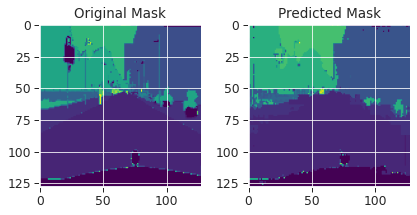

------------------------------------------------------------------------------------------------------------------------
| epoch 102 |   100/  185 batches | train accuracy    0.887 | train loss: 0.33784  | train mIOU: 0.370 | train Dice Loss: -12.28955
------------------------------------------------------------------------------------------------------------------------
| end of epoch 102 | time: 38.81s | valid accuracy:    0.770 | valid loss: 0.95127 | valid mIOU: 0.194


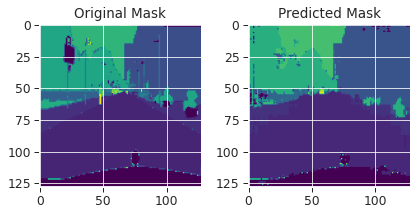

------------------------------------------------------------------------------------------------------------------------
| epoch 103 |   100/  185 batches | train accuracy    0.885 | train loss: 0.33331  | train mIOU: 0.366 | train Dice Loss: -12.67912
------------------------------------------------------------------------------------------------------------------------
| end of epoch 103 | time: 38.76s | valid accuracy:    0.772 | valid loss: 0.94361 | valid mIOU: 0.201


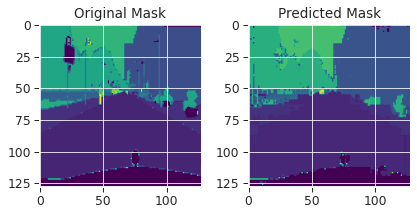

------------------------------------------------------------------------------------------------------------------------
| epoch 104 |   100/  185 batches | train accuracy    0.877 | train loss: 0.36688  | train mIOU: 0.364 | train Dice Loss: -12.75910
------------------------------------------------------------------------------------------------------------------------
| end of epoch 104 | time: 38.85s | valid accuracy:    0.767 | valid loss: 0.96473 | valid mIOU: 0.194


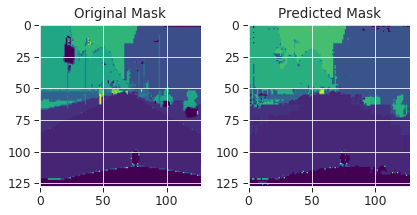

------------------------------------------------------------------------------------------------------------------------
| epoch 105 |   100/  185 batches | train accuracy    0.875 | train loss: 0.37126  | train mIOU: 0.435 | train Dice Loss: -12.73645
------------------------------------------------------------------------------------------------------------------------
| end of epoch 105 | time: 38.93s | valid accuracy:    0.776 | valid loss: 0.94447 | valid mIOU: 0.200


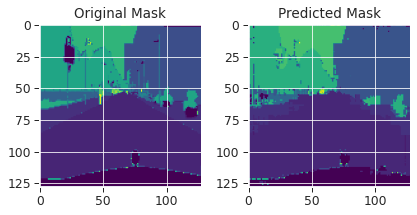

------------------------------------------------------------------------------------------------------------------------
| epoch 106 |   100/  185 batches | train accuracy    0.888 | train loss: 0.32345  | train mIOU: 0.416 | train Dice Loss: -13.95146
------------------------------------------------------------------------------------------------------------------------
| end of epoch 106 | time: 38.81s | valid accuracy:    0.775 | valid loss: 0.93293 | valid mIOU: 0.195


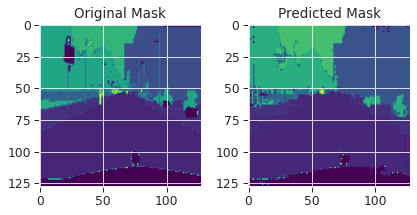

------------------------------------------------------------------------------------------------------------------------
| epoch 107 |   100/  185 batches | train accuracy    0.887 | train loss: 0.33647  | train mIOU: 0.391 | train Dice Loss: -12.85293
------------------------------------------------------------------------------------------------------------------------
| end of epoch 107 | time: 38.79s | valid accuracy:    0.763 | valid loss: 0.96928 | valid mIOU: 0.193


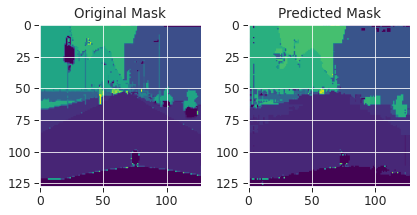

------------------------------------------------------------------------------------------------------------------------
| epoch 108 |   100/  185 batches | train accuracy    0.889 | train loss: 0.32829  | train mIOU: 0.386 | train Dice Loss: -12.61939
------------------------------------------------------------------------------------------------------------------------
| end of epoch 108 | time: 38.86s | valid accuracy:    0.773 | valid loss: 0.96008 | valid mIOU: 0.198


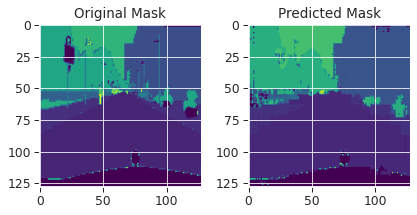

------------------------------------------------------------------------------------------------------------------------
| epoch 109 |   100/  185 batches | train accuracy    0.875 | train loss: 0.37349  | train mIOU: 0.372 | train Dice Loss: -12.39485
------------------------------------------------------------------------------------------------------------------------
| end of epoch 109 | time: 39.23s | valid accuracy:    0.766 | valid loss: 0.95959 | valid mIOU: 0.194


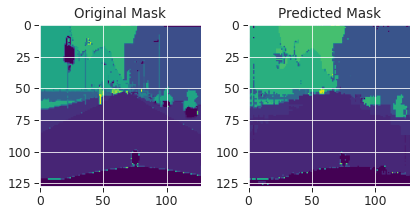

------------------------------------------------------------------------------------------------------------------------
| epoch 110 |   100/  185 batches | train accuracy    0.881 | train loss: 0.34993  | train mIOU: 0.385 | train Dice Loss: -12.09168
------------------------------------------------------------------------------------------------------------------------
| end of epoch 110 | time: 39.68s | valid accuracy:    0.771 | valid loss: 0.96403 | valid mIOU: 0.200


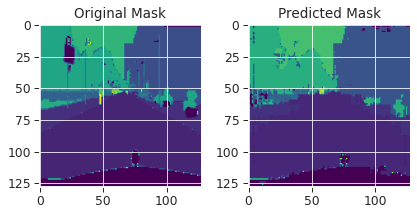

------------------------------------------------------------------------------------------------------------------------
| epoch 111 |   100/  185 batches | train accuracy    0.881 | train loss: 0.34853  | train mIOU: 0.391 | train Dice Loss: -12.84156
------------------------------------------------------------------------------------------------------------------------
| end of epoch 111 | time: 39.69s | valid accuracy:    0.769 | valid loss: 0.98198 | valid mIOU: 0.194


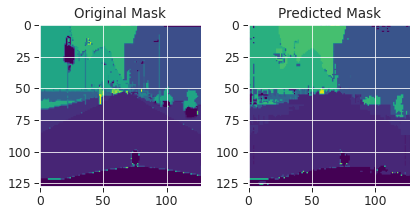

------------------------------------------------------------------------------------------------------------------------
| epoch 112 |   100/  185 batches | train accuracy    0.888 | train loss: 0.33093  | train mIOU: 0.385 | train Dice Loss: -12.68747
------------------------------------------------------------------------------------------------------------------------
| end of epoch 112 | time: 39.03s | valid accuracy:    0.771 | valid loss: 0.96422 | valid mIOU: 0.196


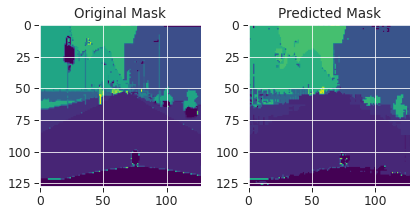

------------------------------------------------------------------------------------------------------------------------
| epoch 113 |   100/  185 batches | train accuracy    0.882 | train loss: 0.34973  | train mIOU: 0.400 | train Dice Loss: -12.15046
------------------------------------------------------------------------------------------------------------------------
| end of epoch 113 | time: 39.00s | valid accuracy:    0.774 | valid loss: 0.94572 | valid mIOU: 0.200


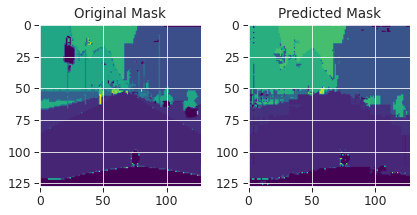

------------------------------------------------------------------------------------------------------------------------
| epoch 114 |   100/  185 batches | train accuracy    0.889 | train loss: 0.33200  | train mIOU: 0.390 | train Dice Loss: -12.92946
------------------------------------------------------------------------------------------------------------------------
| end of epoch 114 | time: 38.96s | valid accuracy:    0.772 | valid loss: 0.97175 | valid mIOU: 0.195


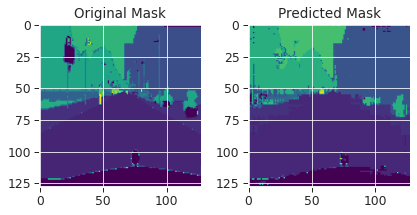

------------------------------------------------------------------------------------------------------------------------
| epoch 115 |   100/  185 batches | train accuracy    0.879 | train loss: 0.35473  | train mIOU: 0.394 | train Dice Loss: -12.26155
------------------------------------------------------------------------------------------------------------------------
| end of epoch 115 | time: 39.71s | valid accuracy:    0.775 | valid loss: 0.94649 | valid mIOU: 0.204


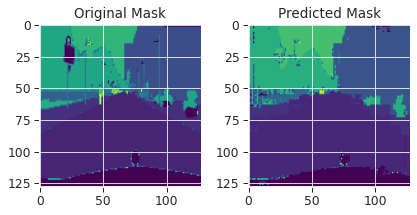

------------------------------------------------------------------------------------------------------------------------
| epoch 116 |   100/  185 batches | train accuracy    0.896 | train loss: 0.30031  | train mIOU: 0.393 | train Dice Loss: -13.08018
------------------------------------------------------------------------------------------------------------------------
| end of epoch 116 | time: 39.54s | valid accuracy:    0.767 | valid loss: 0.98492 | valid mIOU: 0.194


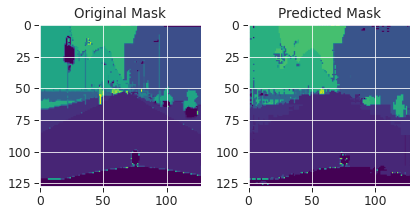

------------------------------------------------------------------------------------------------------------------------
| epoch 117 |   100/  185 batches | train accuracy    0.877 | train loss: 0.36404  | train mIOU: 0.432 | train Dice Loss: -13.38434
------------------------------------------------------------------------------------------------------------------------
| end of epoch 117 | time: 39.03s | valid accuracy:    0.770 | valid loss: 0.96810 | valid mIOU: 0.198


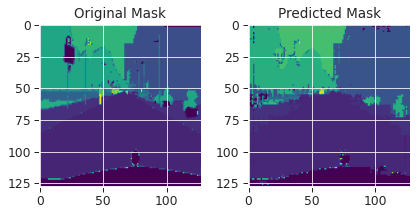

------------------------------------------------------------------------------------------------------------------------
| epoch 118 |   100/  185 batches | train accuracy    0.877 | train loss: 0.36259  | train mIOU: 0.378 | train Dice Loss: -12.46876
------------------------------------------------------------------------------------------------------------------------
| end of epoch 118 | time: 38.94s | valid accuracy:    0.775 | valid loss: 0.96275 | valid mIOU: 0.200


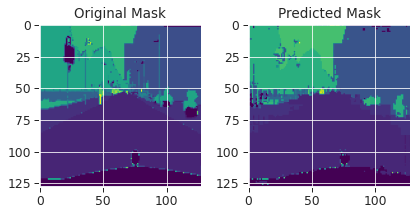

------------------------------------------------------------------------------------------------------------------------
| epoch 119 |   100/  185 batches | train accuracy    0.888 | train loss: 0.32539  | train mIOU: 0.381 | train Dice Loss: -12.12526
------------------------------------------------------------------------------------------------------------------------
| end of epoch 119 | time: 40.01s | valid accuracy:    0.770 | valid loss: 0.97958 | valid mIOU: 0.195


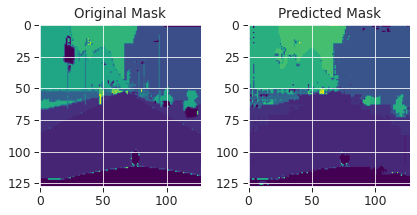

------------------------------------------------------------------------------------------------------------------------
| epoch 120 |   100/  185 batches | train accuracy    0.859 | train loss: 0.41386  | train mIOU: 0.422 | train Dice Loss: -12.97750
------------------------------------------------------------------------------------------------------------------------
| end of epoch 120 | time: 39.73s | valid accuracy:    0.775 | valid loss: 0.96405 | valid mIOU: 0.198


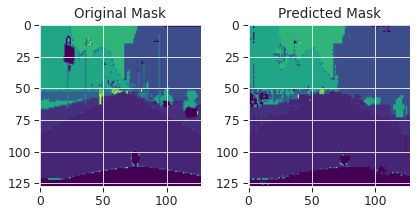

------------------------------------------------------------------------------------------------------------------------
| epoch 121 |   100/  185 batches | train accuracy    0.885 | train loss: 0.33480  | train mIOU: 0.399 | train Dice Loss: -11.94121
------------------------------------------------------------------------------------------------------------------------
| end of epoch 121 | time: 40.40s | valid accuracy:    0.771 | valid loss: 0.98590 | valid mIOU: 0.201


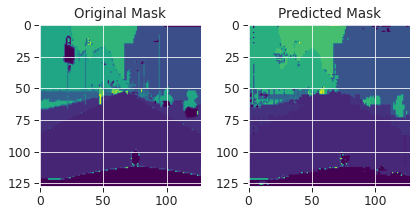

------------------------------------------------------------------------------------------------------------------------
| epoch 122 |   100/  185 batches | train accuracy    0.885 | train loss: 0.33771  | train mIOU: 0.406 | train Dice Loss: -12.44113
------------------------------------------------------------------------------------------------------------------------
| end of epoch 122 | time: 40.50s | valid accuracy:    0.764 | valid loss: 1.00143 | valid mIOU: 0.196


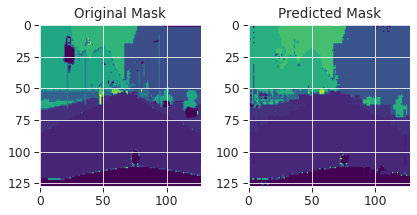

------------------------------------------------------------------------------------------------------------------------
| epoch 123 |   100/  185 batches | train accuracy    0.893 | train loss: 0.31226  | train mIOU: 0.392 | train Dice Loss: -12.80916
------------------------------------------------------------------------------------------------------------------------
| end of epoch 123 | time: 39.49s | valid accuracy:    0.772 | valid loss: 0.97542 | valid mIOU: 0.203


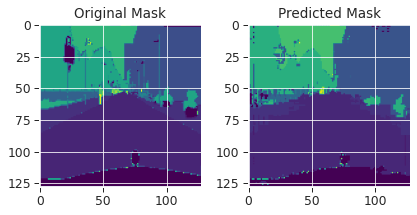

------------------------------------------------------------------------------------------------------------------------
| epoch 124 |   100/  185 batches | train accuracy    0.892 | train loss: 0.32032  | train mIOU: 0.426 | train Dice Loss: -13.61896
------------------------------------------------------------------------------------------------------------------------
| end of epoch 124 | time: 38.46s | valid accuracy:    0.773 | valid loss: 0.98405 | valid mIOU: 0.202


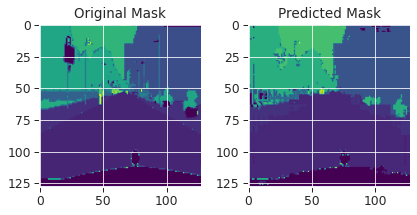

------------------------------------------------------------------------------------------------------------------------
| epoch 125 |   100/  185 batches | train accuracy    0.880 | train loss: 0.34691  | train mIOU: 0.406 | train Dice Loss: -11.96303
------------------------------------------------------------------------------------------------------------------------
| end of epoch 125 | time: 38.84s | valid accuracy:    0.767 | valid loss: 0.99822 | valid mIOU: 0.196


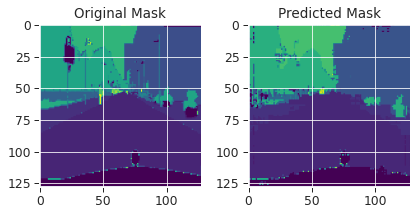

------------------------------------------------------------------------------------------------------------------------
| epoch 126 |   100/  185 batches | train accuracy    0.902 | train loss: 0.28355  | train mIOU: 0.387 | train Dice Loss: -11.56657
------------------------------------------------------------------------------------------------------------------------
| end of epoch 126 | time: 39.19s | valid accuracy:    0.768 | valid loss: 0.99216 | valid mIOU: 0.195


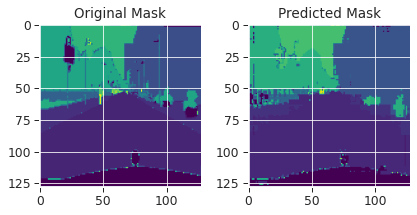

------------------------------------------------------------------------------------------------------------------------
| epoch 127 |   100/  185 batches | train accuracy    0.886 | train loss: 0.33307  | train mIOU: 0.384 | train Dice Loss: -12.06712
------------------------------------------------------------------------------------------------------------------------
| end of epoch 127 | time: 40.38s | valid accuracy:    0.776 | valid loss: 0.96684 | valid mIOU: 0.203


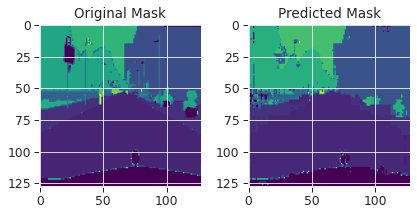

------------------------------------------------------------------------------------------------------------------------
| epoch 128 |   100/  185 batches | train accuracy    0.892 | train loss: 0.31530  | train mIOU: 0.436 | train Dice Loss: -13.46500
------------------------------------------------------------------------------------------------------------------------
| end of epoch 128 | time: 39.44s | valid accuracy:    0.775 | valid loss: 0.96292 | valid mIOU: 0.201


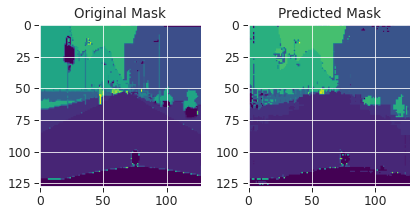

------------------------------------------------------------------------------------------------------------------------
| epoch 129 |   100/  185 batches | train accuracy    0.881 | train loss: 0.35208  | train mIOU: 0.403 | train Dice Loss: -12.85709
------------------------------------------------------------------------------------------------------------------------
| end of epoch 129 | time: 40.85s | valid accuracy:    0.776 | valid loss: 0.95880 | valid mIOU: 0.199


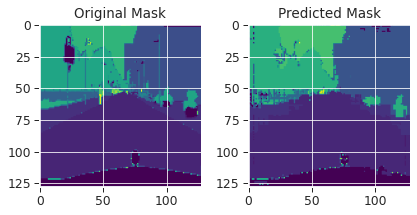

------------------------------------------------------------------------------------------------------------------------
| epoch 130 |   100/  185 batches | train accuracy    0.889 | train loss: 0.32262  | train mIOU: 0.407 | train Dice Loss: -13.55979
------------------------------------------------------------------------------------------------------------------------
| end of epoch 130 | time: 39.60s | valid accuracy:    0.775 | valid loss: 0.96260 | valid mIOU: 0.199


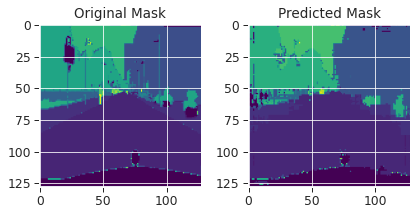

------------------------------------------------------------------------------------------------------------------------
| epoch 131 |   100/  185 batches | train accuracy    0.886 | train loss: 0.33350  | train mIOU: 0.440 | train Dice Loss: -12.42327
------------------------------------------------------------------------------------------------------------------------
| end of epoch 131 | time: 40.14s | valid accuracy:    0.774 | valid loss: 0.98851 | valid mIOU: 0.198


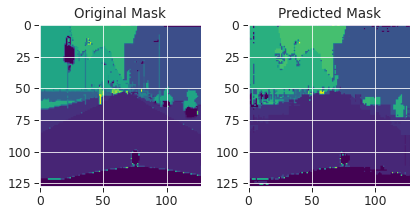

------------------------------------------------------------------------------------------------------------------------
| epoch 132 |   100/  185 batches | train accuracy    0.886 | train loss: 0.32661  | train mIOU: 0.388 | train Dice Loss: -12.50425
------------------------------------------------------------------------------------------------------------------------
| end of epoch 132 | time: 39.05s | valid accuracy:    0.776 | valid loss: 0.95442 | valid mIOU: 0.205


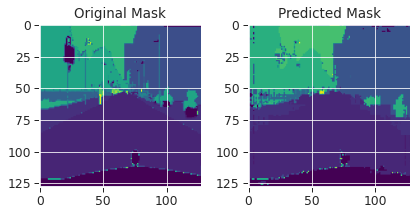

------------------------------------------------------------------------------------------------------------------------
| epoch 133 |   100/  185 batches | train accuracy    0.874 | train loss: 0.37219  | train mIOU: 0.418 | train Dice Loss: -12.15664
------------------------------------------------------------------------------------------------------------------------
| end of epoch 133 | time: 40.78s | valid accuracy:    0.767 | valid loss: 0.99022 | valid mIOU: 0.198


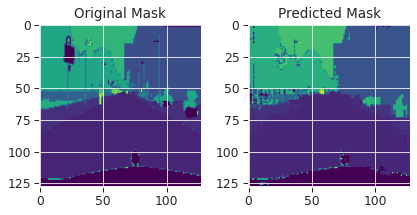

------------------------------------------------------------------------------------------------------------------------
| epoch 134 |   100/  185 batches | train accuracy    0.883 | train loss: 0.34592  | train mIOU: 0.416 | train Dice Loss: -13.35101
------------------------------------------------------------------------------------------------------------------------
| end of epoch 134 | time: 41.52s | valid accuracy:    0.767 | valid loss: 0.98348 | valid mIOU: 0.198


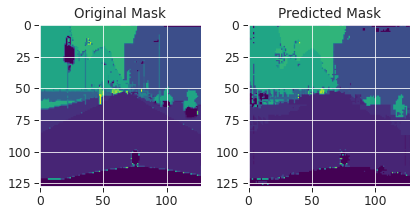

------------------------------------------------------------------------------------------------------------------------
| epoch 135 |   100/  185 batches | train accuracy    0.891 | train loss: 0.32155  | train mIOU: 0.421 | train Dice Loss: -13.03500
------------------------------------------------------------------------------------------------------------------------
| end of epoch 135 | time: 41.56s | valid accuracy:    0.771 | valid loss: 0.99647 | valid mIOU: 0.200


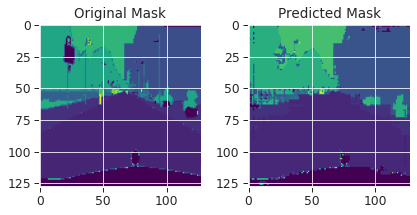

------------------------------------------------------------------------------------------------------------------------
| epoch 136 |   100/  185 batches | train accuracy    0.887 | train loss: 0.33152  | train mIOU: 0.421 | train Dice Loss: -12.32779
------------------------------------------------------------------------------------------------------------------------
| end of epoch 136 | time: 41.28s | valid accuracy:    0.774 | valid loss: 0.98279 | valid mIOU: 0.202


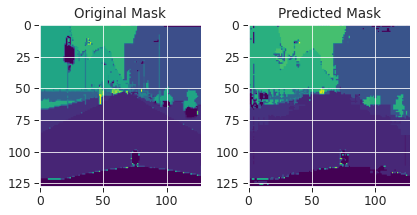

------------------------------------------------------------------------------------------------------------------------
| epoch 137 |   100/  185 batches | train accuracy    0.890 | train loss: 0.32237  | train mIOU: 0.413 | train Dice Loss: -12.30856
------------------------------------------------------------------------------------------------------------------------
| end of epoch 137 | time: 40.68s | valid accuracy:    0.772 | valid loss: 0.99475 | valid mIOU: 0.199


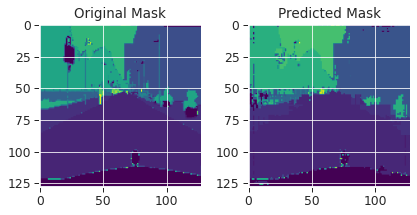

------------------------------------------------------------------------------------------------------------------------
| epoch 138 |   100/  185 batches | train accuracy    0.899 | train loss: 0.29859  | train mIOU: 0.416 | train Dice Loss: -11.76326
------------------------------------------------------------------------------------------------------------------------
| end of epoch 138 | time: 40.71s | valid accuracy:    0.772 | valid loss: 0.97461 | valid mIOU: 0.199


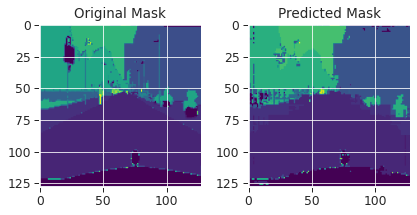

------------------------------------------------------------------------------------------------------------------------
| epoch 139 |   100/  185 batches | train accuracy    0.886 | train loss: 0.33718  | train mIOU: 0.442 | train Dice Loss: -13.12314
------------------------------------------------------------------------------------------------------------------------
| end of epoch 139 | time: 40.02s | valid accuracy:    0.776 | valid loss: 0.97584 | valid mIOU: 0.199


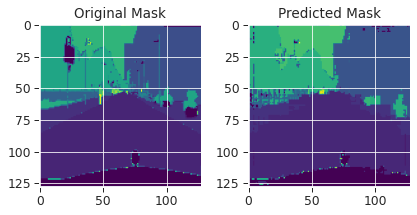

------------------------------------------------------------------------------------------------------------------------
| epoch 140 |   100/  185 batches | train accuracy    0.892 | train loss: 0.31764  | train mIOU: 0.413 | train Dice Loss: -12.36368
------------------------------------------------------------------------------------------------------------------------
| end of epoch 140 | time: 40.43s | valid accuracy:    0.772 | valid loss: 0.97863 | valid mIOU: 0.197


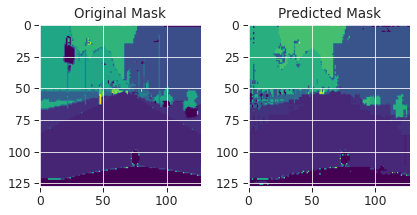

------------------------------------------------------------------------------------------------------------------------
| epoch 141 |   100/  185 batches | train accuracy    0.889 | train loss: 0.32789  | train mIOU: 0.450 | train Dice Loss: -12.73717
------------------------------------------------------------------------------------------------------------------------
| end of epoch 141 | time: 39.91s | valid accuracy:    0.771 | valid loss: 0.98414 | valid mIOU: 0.202


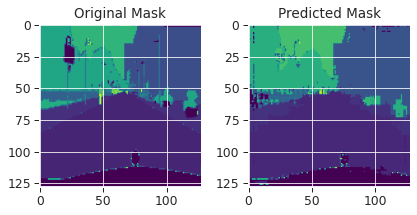

------------------------------------------------------------------------------------------------------------------------
| epoch 142 |   100/  185 batches | train accuracy    0.891 | train loss: 0.31901  | train mIOU: 0.418 | train Dice Loss: -12.50179
------------------------------------------------------------------------------------------------------------------------
| end of epoch 142 | time: 40.35s | valid accuracy:    0.774 | valid loss: 0.97701 | valid mIOU: 0.202


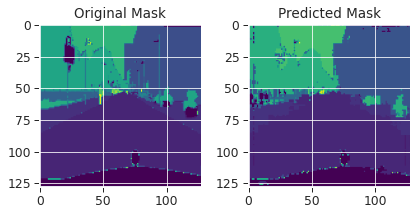

------------------------------------------------------------------------------------------------------------------------
| epoch 143 |   100/  185 batches | train accuracy    0.887 | train loss: 0.32985  | train mIOU: 0.445 | train Dice Loss: -12.48293
------------------------------------------------------------------------------------------------------------------------
| end of epoch 143 | time: 40.92s | valid accuracy:    0.771 | valid loss: 0.98797 | valid mIOU: 0.199


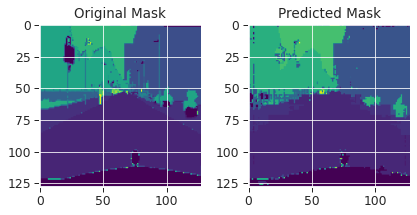

------------------------------------------------------------------------------------------------------------------------
| epoch 144 |   100/  185 batches | train accuracy    0.883 | train loss: 0.33745  | train mIOU: 0.404 | train Dice Loss: -12.77058
------------------------------------------------------------------------------------------------------------------------
| end of epoch 144 | time: 41.13s | valid accuracy:    0.774 | valid loss: 0.97845 | valid mIOU: 0.201


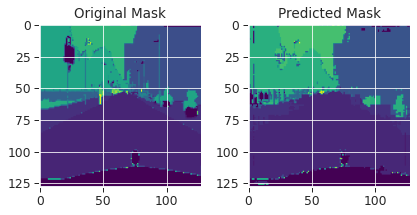

------------------------------------------------------------------------------------------------------------------------
| epoch 145 |   100/  185 batches | train accuracy    0.886 | train loss: 0.33469  | train mIOU: 0.400 | train Dice Loss: -11.94479
------------------------------------------------------------------------------------------------------------------------
| end of epoch 145 | time: 39.27s | valid accuracy:    0.768 | valid loss: 1.00292 | valid mIOU: 0.199


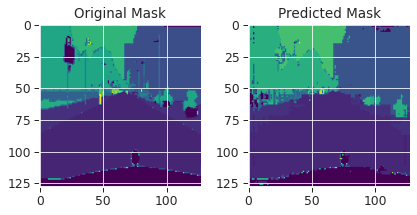

------------------------------------------------------------------------------------------------------------------------
| epoch 146 |   100/  185 batches | train accuracy    0.897 | train loss: 0.30268  | train mIOU: 0.403 | train Dice Loss: -12.15529
------------------------------------------------------------------------------------------------------------------------
| end of epoch 146 | time: 39.93s | valid accuracy:    0.771 | valid loss: 0.99321 | valid mIOU: 0.198


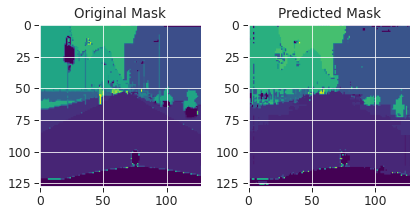

------------------------------------------------------------------------------------------------------------------------
| epoch 147 |   100/  185 batches | train accuracy    0.894 | train loss: 0.31039  | train mIOU: 0.455 | train Dice Loss: -13.04011
------------------------------------------------------------------------------------------------------------------------
| end of epoch 147 | time: 40.86s | valid accuracy:    0.772 | valid loss: 0.98459 | valid mIOU: 0.200


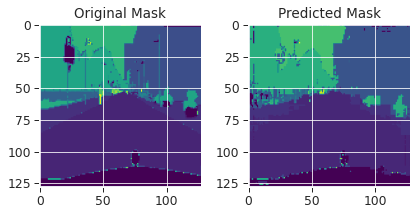

------------------------------------------------------------------------------------------------------------------------
| epoch 148 |   100/  185 batches | train accuracy    0.885 | train loss: 0.34134  | train mIOU: 0.386 | train Dice Loss: -12.75159
------------------------------------------------------------------------------------------------------------------------
| end of epoch 148 | time: 41.09s | valid accuracy:    0.775 | valid loss: 0.99100 | valid mIOU: 0.204


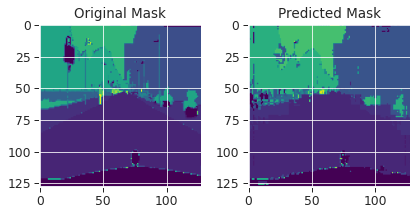

------------------------------------------------------------------------------------------------------------------------
| epoch 149 |   100/  185 batches | train accuracy    0.891 | train loss: 0.32139  | train mIOU: 0.414 | train Dice Loss: -12.50036
------------------------------------------------------------------------------------------------------------------------
| end of epoch 149 | time: 40.57s | valid accuracy:    0.772 | valid loss: 1.00169 | valid mIOU: 0.200


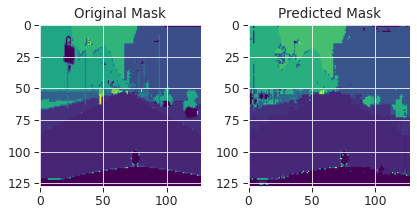

------------------------------------------------------------------------------------------------------------------------
| epoch 150 |   100/  185 batches | train accuracy    0.890 | train loss: 0.31555  | train mIOU: 0.435 | train Dice Loss: -11.51518
------------------------------------------------------------------------------------------------------------------------
| end of epoch 150 | time: 41.47s | valid accuracy:    0.771 | valid loss: 0.99937 | valid mIOU: 0.202


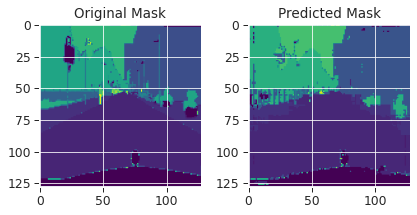

------------------------------------------------------------------------------------------------------------------------
| epoch 151 |   100/  185 batches | train accuracy    0.912 | train loss: 0.25337  | train mIOU: 0.443 | train Dice Loss: -13.15196
------------------------------------------------------------------------------------------------------------------------
| end of epoch 151 | time: 40.78s | valid accuracy:    0.769 | valid loss: 1.01214 | valid mIOU: 0.200


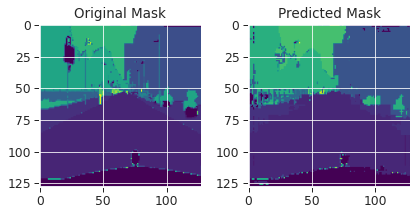

------------------------------------------------------------------------------------------------------------------------
| epoch 152 |   100/  185 batches | train accuracy    0.901 | train loss: 0.28682  | train mIOU: 0.425 | train Dice Loss: -12.22153
------------------------------------------------------------------------------------------------------------------------
| end of epoch 152 | time: 39.35s | valid accuracy:    0.777 | valid loss: 1.01437 | valid mIOU: 0.201


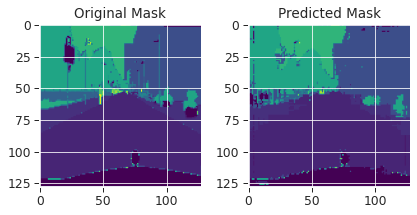

------------------------------------------------------------------------------------------------------------------------
| epoch 153 |   100/  185 batches | train accuracy    0.884 | train loss: 0.33978  | train mIOU: 0.440 | train Dice Loss: -12.31675
------------------------------------------------------------------------------------------------------------------------
| end of epoch 153 | time: 39.72s | valid accuracy:    0.770 | valid loss: 1.01996 | valid mIOU: 0.200


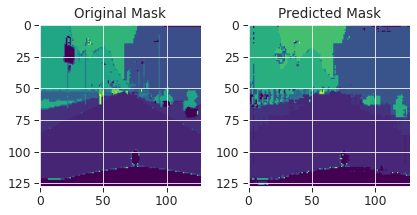

------------------------------------------------------------------------------------------------------------------------
| epoch 154 |   100/  185 batches | train accuracy    0.883 | train loss: 0.34337  | train mIOU: 0.417 | train Dice Loss: -12.35422
------------------------------------------------------------------------------------------------------------------------
| end of epoch 154 | time: 42.34s | valid accuracy:    0.773 | valid loss: 0.99525 | valid mIOU: 0.198


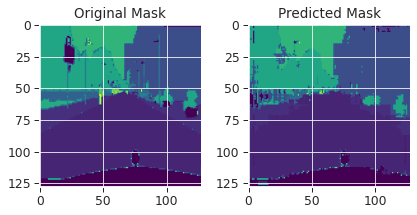

------------------------------------------------------------------------------------------------------------------------
| epoch 155 |   100/  185 batches | train accuracy    0.899 | train loss: 0.29338  | train mIOU: 0.370 | train Dice Loss: -12.42710
------------------------------------------------------------------------------------------------------------------------
| end of epoch 155 | time: 40.19s | valid accuracy:    0.774 | valid loss: 0.99332 | valid mIOU: 0.202


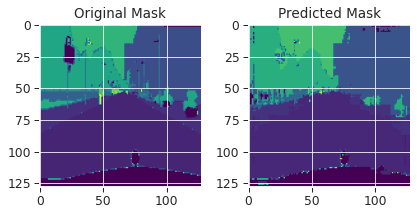

------------------------------------------------------------------------------------------------------------------------
| epoch 156 |   100/  185 batches | train accuracy    0.888 | train loss: 0.32085  | train mIOU: 0.435 | train Dice Loss: -12.28731
------------------------------------------------------------------------------------------------------------------------
| end of epoch 156 | time: 40.94s | valid accuracy:    0.772 | valid loss: 1.00742 | valid mIOU: 0.199


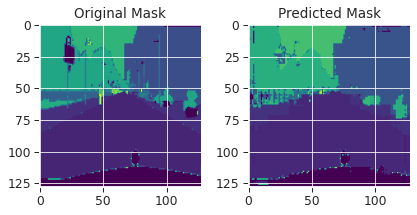

------------------------------------------------------------------------------------------------------------------------
| epoch 157 |   100/  185 batches | train accuracy    0.907 | train loss: 0.27203  | train mIOU: 0.432 | train Dice Loss: -13.55594
------------------------------------------------------------------------------------------------------------------------
| end of epoch 157 | time: 40.20s | valid accuracy:    0.769 | valid loss: 1.00949 | valid mIOU: 0.204


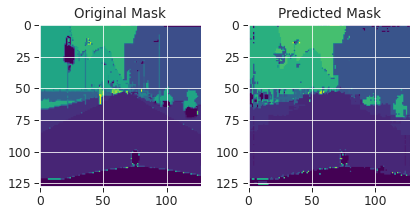

------------------------------------------------------------------------------------------------------------------------
| epoch 158 |   100/  185 batches | train accuracy    0.901 | train loss: 0.28796  | train mIOU: 0.435 | train Dice Loss: -11.97242
------------------------------------------------------------------------------------------------------------------------
| end of epoch 158 | time: 40.51s | valid accuracy:    0.773 | valid loss: 1.00814 | valid mIOU: 0.203


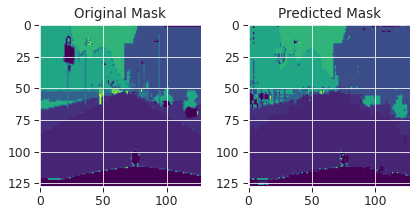

------------------------------------------------------------------------------------------------------------------------
| epoch 159 |   100/  185 batches | train accuracy    0.885 | train loss: 0.33818  | train mIOU: 0.413 | train Dice Loss: -12.51206
------------------------------------------------------------------------------------------------------------------------
| end of epoch 159 | time: 41.17s | valid accuracy:    0.772 | valid loss: 1.02199 | valid mIOU: 0.199


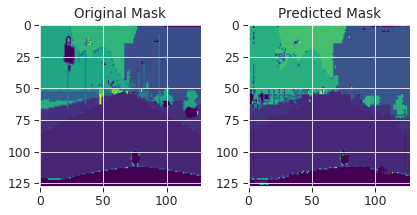

------------------------------------------------------------------------------------------------------------------------
| epoch 160 |   100/  185 batches | train accuracy    0.897 | train loss: 0.29750  | train mIOU: 0.431 | train Dice Loss: -12.98789
------------------------------------------------------------------------------------------------------------------------
| end of epoch 160 | time: 40.17s | valid accuracy:    0.771 | valid loss: 1.02331 | valid mIOU: 0.199


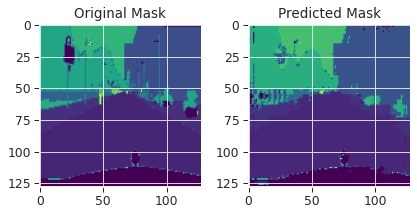

------------------------------------------------------------------------------------------------------------------------
| epoch 161 |   100/  185 batches | train accuracy    0.898 | train loss: 0.30134  | train mIOU: 0.439 | train Dice Loss: -12.14125
------------------------------------------------------------------------------------------------------------------------
| end of epoch 161 | time: 40.32s | valid accuracy:    0.769 | valid loss: 1.02702 | valid mIOU: 0.202


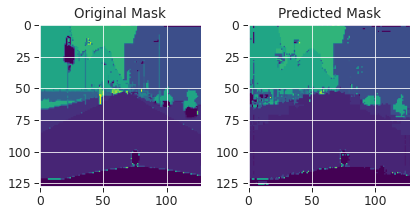

------------------------------------------------------------------------------------------------------------------------
| epoch 162 |   100/  185 batches | train accuracy    0.907 | train loss: 0.27156  | train mIOU: 0.460 | train Dice Loss: -13.04634
------------------------------------------------------------------------------------------------------------------------
| end of epoch 162 | time: 39.76s | valid accuracy:    0.773 | valid loss: 1.01191 | valid mIOU: 0.198


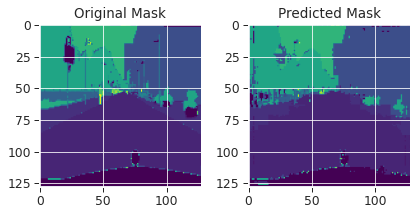

------------------------------------------------------------------------------------------------------------------------
| epoch 163 |   100/  185 batches | train accuracy    0.905 | train loss: 0.27262  | train mIOU: 0.427 | train Dice Loss: -13.39377
------------------------------------------------------------------------------------------------------------------------
| end of epoch 163 | time: 39.75s | valid accuracy:    0.777 | valid loss: 1.00912 | valid mIOU: 0.202


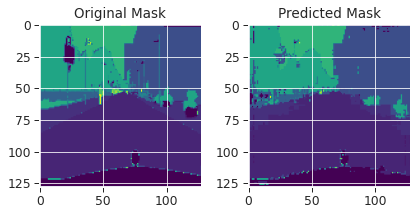

------------------------------------------------------------------------------------------------------------------------
| epoch 164 |   100/  185 batches | train accuracy    0.899 | train loss: 0.28918  | train mIOU: 0.444 | train Dice Loss: -13.48341
------------------------------------------------------------------------------------------------------------------------
| end of epoch 164 | time: 41.67s | valid accuracy:    0.765 | valid loss: 1.02917 | valid mIOU: 0.195


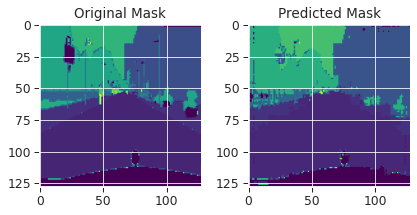

------------------------------------------------------------------------------------------------------------------------
| epoch 165 |   100/  185 batches | train accuracy    0.887 | train loss: 0.32137  | train mIOU: 0.472 | train Dice Loss: -12.39143
------------------------------------------------------------------------------------------------------------------------
| end of epoch 165 | time: 41.11s | valid accuracy:    0.772 | valid loss: 1.01117 | valid mIOU: 0.201


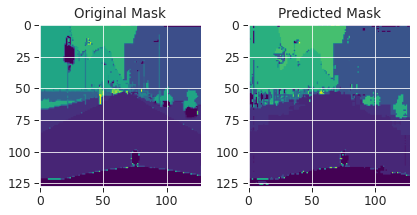

------------------------------------------------------------------------------------------------------------------------
| epoch 166 |   100/  185 batches | train accuracy    0.898 | train loss: 0.29985  | train mIOU: 0.466 | train Dice Loss: -12.66304
------------------------------------------------------------------------------------------------------------------------
| end of epoch 166 | time: 41.64s | valid accuracy:    0.774 | valid loss: 1.01239 | valid mIOU: 0.203


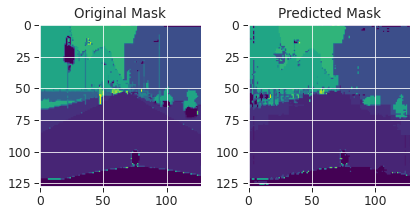

------------------------------------------------------------------------------------------------------------------------
| epoch 167 |   100/  185 batches | train accuracy    0.896 | train loss: 0.30828  | train mIOU: 0.464 | train Dice Loss: -13.10095
------------------------------------------------------------------------------------------------------------------------
| end of epoch 167 | time: 40.14s | valid accuracy:    0.775 | valid loss: 0.99679 | valid mIOU: 0.203


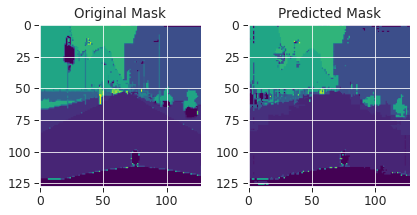

------------------------------------------------------------------------------------------------------------------------
| epoch 168 |   100/  185 batches | train accuracy    0.901 | train loss: 0.28947  | train mIOU: 0.433 | train Dice Loss: -12.74194
------------------------------------------------------------------------------------------------------------------------
| end of epoch 168 | time: 41.04s | valid accuracy:    0.770 | valid loss: 1.03359 | valid mIOU: 0.200


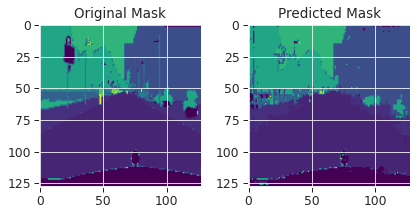

------------------------------------------------------------------------------------------------------------------------
| epoch 169 |   100/  185 batches | train accuracy    0.887 | train loss: 0.32657  | train mIOU: 0.454 | train Dice Loss: -13.20453
------------------------------------------------------------------------------------------------------------------------
| end of epoch 169 | time: 40.18s | valid accuracy:    0.773 | valid loss: 1.00753 | valid mIOU: 0.198


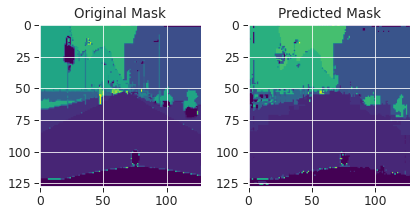

------------------------------------------------------------------------------------------------------------------------
| epoch 170 |   100/  185 batches | train accuracy    0.903 | train loss: 0.27748  | train mIOU: 0.380 | train Dice Loss: -11.57128
------------------------------------------------------------------------------------------------------------------------
| end of epoch 170 | time: 41.31s | valid accuracy:    0.775 | valid loss: 1.03095 | valid mIOU: 0.201


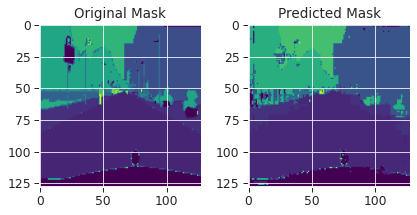

------------------------------------------------------------------------------------------------------------------------
| epoch 171 |   100/  185 batches | train accuracy    0.897 | train loss: 0.29617  | train mIOU: 0.391 | train Dice Loss: -12.64919
------------------------------------------------------------------------------------------------------------------------
| end of epoch 171 | time: 40.99s | valid accuracy:    0.775 | valid loss: 1.01509 | valid mIOU: 0.201


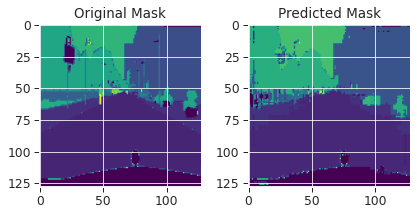

------------------------------------------------------------------------------------------------------------------------
| epoch 172 |   100/  185 batches | train accuracy    0.898 | train loss: 0.29398  | train mIOU: 0.429 | train Dice Loss: -12.22288
------------------------------------------------------------------------------------------------------------------------
| end of epoch 172 | time: 40.70s | valid accuracy:    0.774 | valid loss: 1.00586 | valid mIOU: 0.203


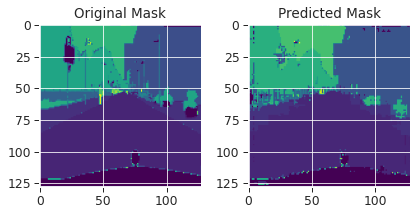

------------------------------------------------------------------------------------------------------------------------
| epoch 173 |   100/  185 batches | train accuracy    0.894 | train loss: 0.30876  | train mIOU: 0.409 | train Dice Loss: -11.85545
------------------------------------------------------------------------------------------------------------------------
| end of epoch 173 | time: 41.02s | valid accuracy:    0.774 | valid loss: 1.03342 | valid mIOU: 0.201


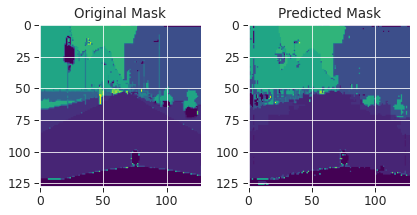

------------------------------------------------------------------------------------------------------------------------
| epoch 174 |   100/  185 batches | train accuracy    0.897 | train loss: 0.30538  | train mIOU: 0.459 | train Dice Loss: -12.86190
------------------------------------------------------------------------------------------------------------------------
| end of epoch 174 | time: 39.65s | valid accuracy:    0.772 | valid loss: 1.02206 | valid mIOU: 0.200


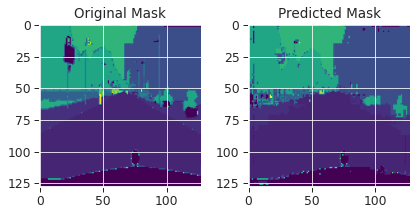

------------------------------------------------------------------------------------------------------------------------
| epoch 175 |   100/  185 batches | train accuracy    0.909 | train loss: 0.26709  | train mIOU: 0.442 | train Dice Loss: -13.30344
------------------------------------------------------------------------------------------------------------------------
| end of epoch 175 | time: 41.48s | valid accuracy:    0.771 | valid loss: 1.02415 | valid mIOU: 0.200


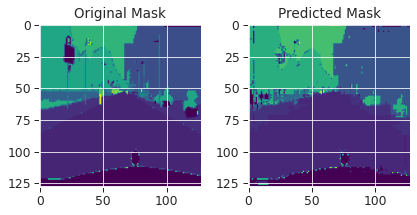

------------------------------------------------------------------------------------------------------------------------
| epoch 176 |   100/  185 batches | train accuracy    0.894 | train loss: 0.31046  | train mIOU: 0.462 | train Dice Loss: -13.40120
------------------------------------------------------------------------------------------------------------------------
| end of epoch 176 | time: 41.26s | valid accuracy:    0.780 | valid loss: 1.01101 | valid mIOU: 0.204


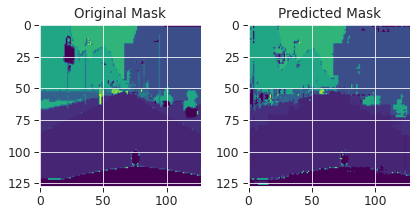

------------------------------------------------------------------------------------------------------------------------
| epoch 177 |   100/  185 batches | train accuracy    0.899 | train loss: 0.29306  | train mIOU: 0.424 | train Dice Loss: -11.79488
------------------------------------------------------------------------------------------------------------------------
| end of epoch 177 | time: 40.59s | valid accuracy:    0.768 | valid loss: 1.03529 | valid mIOU: 0.200


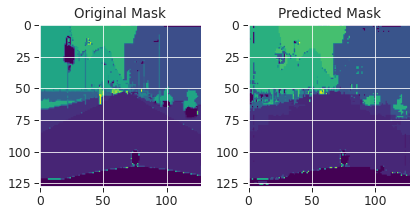

------------------------------------------------------------------------------------------------------------------------
| epoch 178 |   100/  185 batches | train accuracy    0.899 | train loss: 0.28713  | train mIOU: 0.424 | train Dice Loss: -12.76649
------------------------------------------------------------------------------------------------------------------------
| end of epoch 178 | time: 41.59s | valid accuracy:    0.776 | valid loss: 1.01507 | valid mIOU: 0.200


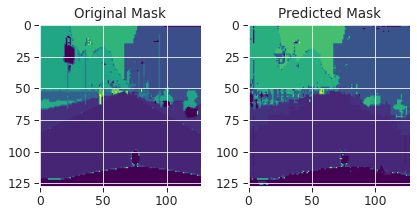

------------------------------------------------------------------------------------------------------------------------
| epoch 179 |   100/  185 batches | train accuracy    0.906 | train loss: 0.27880  | train mIOU: 0.450 | train Dice Loss: -13.38315
------------------------------------------------------------------------------------------------------------------------
| end of epoch 179 | time: 40.84s | valid accuracy:    0.773 | valid loss: 1.02823 | valid mIOU: 0.197


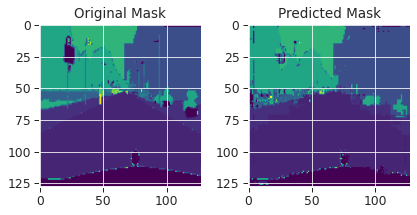

------------------------------------------------------------------------------------------------------------------------
| epoch 180 |   100/  185 batches | train accuracy    0.900 | train loss: 0.29368  | train mIOU: 0.447 | train Dice Loss: -12.73004
------------------------------------------------------------------------------------------------------------------------
| end of epoch 180 | time: 39.70s | valid accuracy:    0.773 | valid loss: 1.04346 | valid mIOU: 0.199


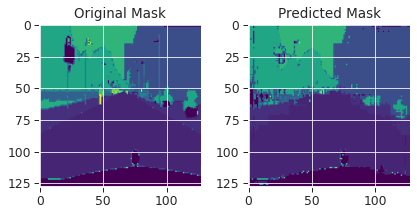

------------------------------------------------------------------------------------------------------------------------
| epoch 181 |   100/  185 batches | train accuracy    0.915 | train loss: 0.25007  | train mIOU: 0.406 | train Dice Loss: -13.01270
------------------------------------------------------------------------------------------------------------------------
| end of epoch 181 | time: 41.57s | valid accuracy:    0.770 | valid loss: 1.04410 | valid mIOU: 0.193


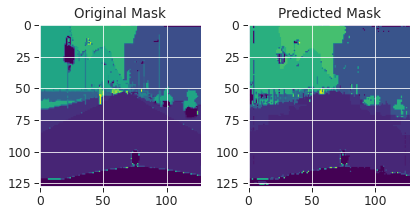

------------------------------------------------------------------------------------------------------------------------
| epoch 182 |   100/  185 batches | train accuracy    0.893 | train loss: 0.30701  | train mIOU: 0.406 | train Dice Loss: -12.22217
------------------------------------------------------------------------------------------------------------------------
| end of epoch 182 | time: 42.14s | valid accuracy:    0.774 | valid loss: 1.01526 | valid mIOU: 0.200


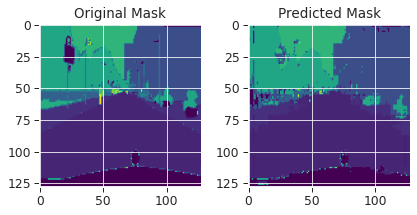

------------------------------------------------------------------------------------------------------------------------
| epoch 183 |   100/  185 batches | train accuracy    0.899 | train loss: 0.29523  | train mIOU: 0.441 | train Dice Loss: -12.67141
------------------------------------------------------------------------------------------------------------------------
| end of epoch 183 | time: 40.62s | valid accuracy:    0.772 | valid loss: 1.02638 | valid mIOU: 0.201


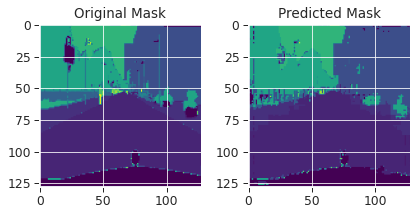

------------------------------------------------------------------------------------------------------------------------
| epoch 184 |   100/  185 batches | train accuracy    0.898 | train loss: 0.29521  | train mIOU: 0.461 | train Dice Loss: -11.40978
------------------------------------------------------------------------------------------------------------------------
| end of epoch 184 | time: 41.05s | valid accuracy:    0.771 | valid loss: 1.05977 | valid mIOU: 0.199


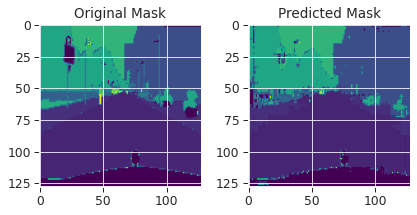

------------------------------------------------------------------------------------------------------------------------
| epoch 185 |   100/  185 batches | train accuracy    0.899 | train loss: 0.28842  | train mIOU: 0.467 | train Dice Loss: -13.21934
------------------------------------------------------------------------------------------------------------------------
| end of epoch 185 | time: 40.08s | valid accuracy:    0.774 | valid loss: 1.03310 | valid mIOU: 0.202


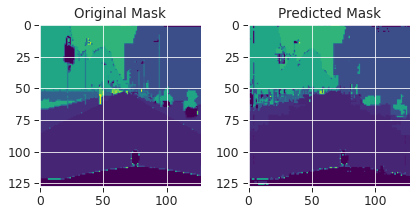

------------------------------------------------------------------------------------------------------------------------
| epoch 186 |   100/  185 batches | train accuracy    0.897 | train loss: 0.29428  | train mIOU: 0.459 | train Dice Loss: -13.73942
------------------------------------------------------------------------------------------------------------------------
| end of epoch 186 | time: 41.00s | valid accuracy:    0.771 | valid loss: 1.05038 | valid mIOU: 0.200


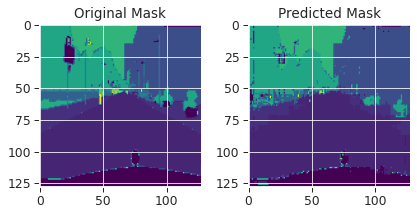

------------------------------------------------------------------------------------------------------------------------
| epoch 187 |   100/  185 batches | train accuracy    0.901 | train loss: 0.28423  | train mIOU: 0.448 | train Dice Loss: -13.67361
------------------------------------------------------------------------------------------------------------------------
| end of epoch 187 | time: 40.87s | valid accuracy:    0.771 | valid loss: 1.04709 | valid mIOU: 0.200


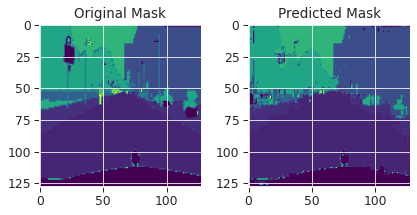

------------------------------------------------------------------------------------------------------------------------
| epoch 188 |   100/  185 batches | train accuracy    0.904 | train loss: 0.27203  | train mIOU: 0.434 | train Dice Loss: -12.54038
------------------------------------------------------------------------------------------------------------------------
| end of epoch 188 | time: 41.24s | valid accuracy:    0.772 | valid loss: 1.04193 | valid mIOU: 0.203


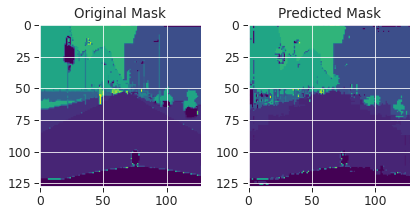

------------------------------------------------------------------------------------------------------------------------
| epoch 189 |   100/  185 batches | train accuracy    0.901 | train loss: 0.28387  | train mIOU: 0.467 | train Dice Loss: -13.49486
------------------------------------------------------------------------------------------------------------------------
| end of epoch 189 | time: 41.38s | valid accuracy:    0.768 | valid loss: 1.06318 | valid mIOU: 0.200


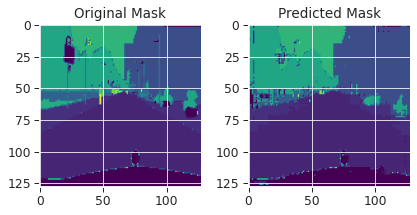

------------------------------------------------------------------------------------------------------------------------
| epoch 190 |   100/  185 batches | train accuracy    0.899 | train loss: 0.29189  | train mIOU: 0.454 | train Dice Loss: -12.43616
------------------------------------------------------------------------------------------------------------------------
| end of epoch 190 | time: 41.08s | valid accuracy:    0.774 | valid loss: 1.03525 | valid mIOU: 0.203


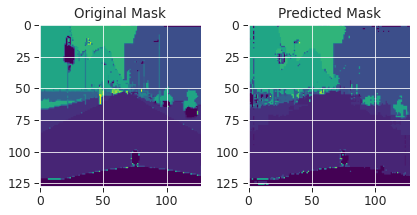

------------------------------------------------------------------------------------------------------------------------
| epoch 191 |   100/  185 batches | train accuracy    0.892 | train loss: 0.30676  | train mIOU: 0.454 | train Dice Loss: -12.17461
------------------------------------------------------------------------------------------------------------------------
| end of epoch 191 | time: 41.59s | valid accuracy:    0.774 | valid loss: 1.03623 | valid mIOU: 0.199


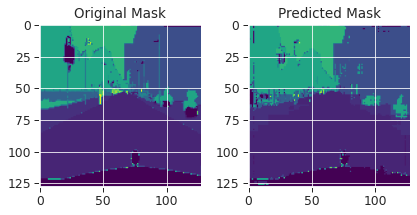

------------------------------------------------------------------------------------------------------------------------
| epoch 192 |   100/  185 batches | train accuracy    0.899 | train loss: 0.28909  | train mIOU: 0.460 | train Dice Loss: -12.90971
------------------------------------------------------------------------------------------------------------------------
| end of epoch 192 | time: 41.14s | valid accuracy:    0.773 | valid loss: 1.05026 | valid mIOU: 0.203


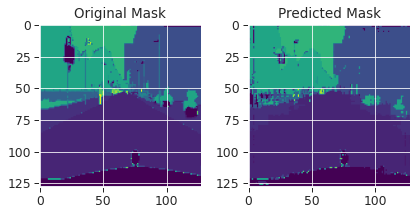

------------------------------------------------------------------------------------------------------------------------
| epoch 193 |   100/  185 batches | train accuracy    0.893 | train loss: 0.31359  | train mIOU: 0.422 | train Dice Loss: -12.10726
------------------------------------------------------------------------------------------------------------------------
| end of epoch 193 | time: 41.08s | valid accuracy:    0.776 | valid loss: 1.03505 | valid mIOU: 0.197


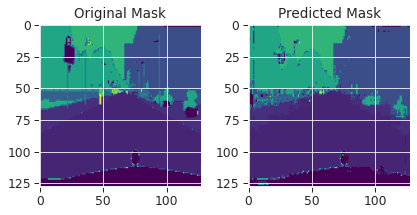

------------------------------------------------------------------------------------------------------------------------
| epoch 194 |   100/  185 batches | train accuracy    0.894 | train loss: 0.30856  | train mIOU: 0.450 | train Dice Loss: -13.51497
------------------------------------------------------------------------------------------------------------------------
| end of epoch 194 | time: 40.60s | valid accuracy:    0.770 | valid loss: 1.06110 | valid mIOU: 0.199


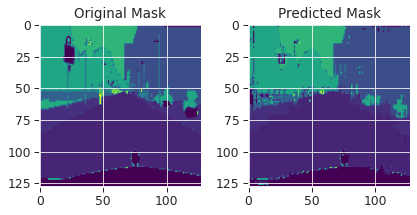

------------------------------------------------------------------------------------------------------------------------
| epoch 195 |   100/  185 batches | train accuracy    0.903 | train loss: 0.28478  | train mIOU: 0.467 | train Dice Loss: -12.84493
------------------------------------------------------------------------------------------------------------------------
| end of epoch 195 | time: 40.55s | valid accuracy:    0.771 | valid loss: 1.06082 | valid mIOU: 0.202


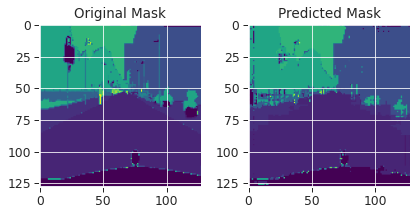

------------------------------------------------------------------------------------------------------------------------
| epoch 196 |   100/  185 batches | train accuracy    0.899 | train loss: 0.29049  | train mIOU: 0.455 | train Dice Loss: -13.00012
------------------------------------------------------------------------------------------------------------------------
| end of epoch 196 | time: 41.03s | valid accuracy:    0.771 | valid loss: 1.05120 | valid mIOU: 0.200


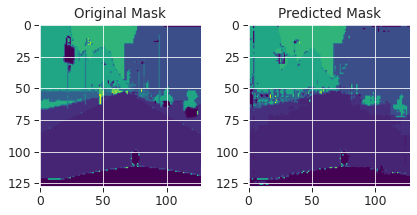

------------------------------------------------------------------------------------------------------------------------
| epoch 197 |   100/  185 batches | train accuracy    0.901 | train loss: 0.28626  | train mIOU: 0.487 | train Dice Loss: -12.83947
------------------------------------------------------------------------------------------------------------------------
| end of epoch 197 | time: 40.16s | valid accuracy:    0.774 | valid loss: 1.05615 | valid mIOU: 0.201


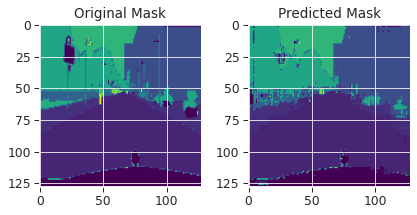

------------------------------------------------------------------------------------------------------------------------
| epoch 198 |   100/  185 batches | train accuracy    0.900 | train loss: 0.28730  | train mIOU: 0.437 | train Dice Loss: -12.30841
------------------------------------------------------------------------------------------------------------------------
| end of epoch 198 | time: 40.28s | valid accuracy:    0.770 | valid loss: 1.05791 | valid mIOU: 0.198


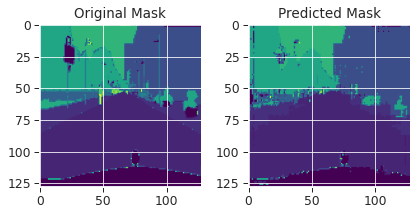

------------------------------------------------------------------------------------------------------------------------
| epoch 199 |   100/  185 batches | train accuracy    0.889 | train loss: 0.32093  | train mIOU: 0.459 | train Dice Loss: -12.95260
------------------------------------------------------------------------------------------------------------------------
| end of epoch 199 | time: 41.07s | valid accuracy:    0.771 | valid loss: 1.10250 | valid mIOU: 0.200


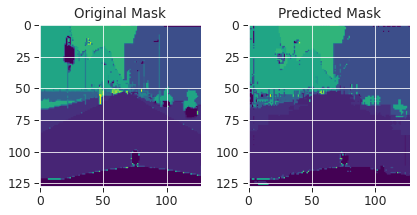

------------------------------------------------------------------------------------------------------------------------
| epoch 200 |   100/  185 batches | train accuracy    0.916 | train loss: 0.24663  | train mIOU: 0.489 | train Dice Loss: -12.59735
------------------------------------------------------------------------------------------------------------------------
| end of epoch 200 | time: 41.33s | valid accuracy:    0.768 | valid loss: 1.07570 | valid mIOU: 0.195


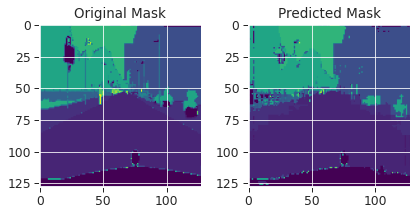

------------------------------------------------------------------------------------------------------------------------
| epoch 201 |   100/  185 batches | train accuracy    0.912 | train loss: 0.26003  | train mIOU: 0.451 | train Dice Loss: -12.55317
------------------------------------------------------------------------------------------------------------------------
| end of epoch 201 | time: 40.45s | valid accuracy:    0.770 | valid loss: 1.05985 | valid mIOU: 0.198


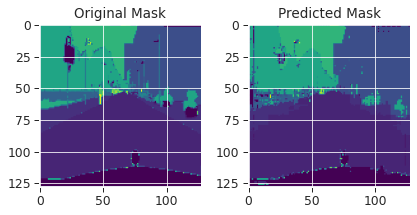

------------------------------------------------------------------------------------------------------------------------
| epoch 202 |   100/  185 batches | train accuracy    0.905 | train loss: 0.27320  | train mIOU: 0.434 | train Dice Loss: -11.98371
------------------------------------------------------------------------------------------------------------------------
| end of epoch 202 | time: 40.42s | valid accuracy:    0.772 | valid loss: 1.07149 | valid mIOU: 0.198


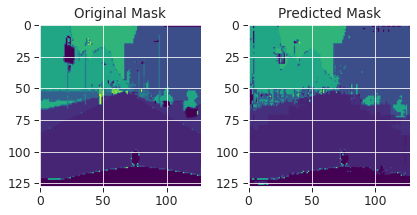

------------------------------------------------------------------------------------------------------------------------
| epoch 203 |   100/  185 batches | train accuracy    0.893 | train loss: 0.30791  | train mIOU: 0.492 | train Dice Loss: -12.88939
------------------------------------------------------------------------------------------------------------------------
| end of epoch 203 | time: 40.78s | valid accuracy:    0.773 | valid loss: 1.07193 | valid mIOU: 0.198


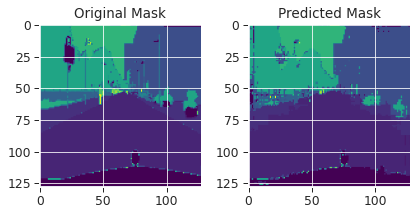

------------------------------------------------------------------------------------------------------------------------
| epoch 204 |   100/  185 batches | train accuracy    0.902 | train loss: 0.28588  | train mIOU: 0.428 | train Dice Loss: -13.10624
------------------------------------------------------------------------------------------------------------------------
| end of epoch 204 | time: 40.11s | valid accuracy:    0.770 | valid loss: 1.08403 | valid mIOU: 0.198


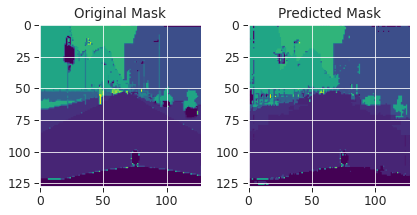

------------------------------------------------------------------------------------------------------------------------
| epoch 205 |   100/  185 batches | train accuracy    0.903 | train loss: 0.27809  | train mIOU: 0.483 | train Dice Loss: -13.45405
------------------------------------------------------------------------------------------------------------------------
| end of epoch 205 | time: 41.00s | valid accuracy:    0.776 | valid loss: 1.07697 | valid mIOU: 0.202


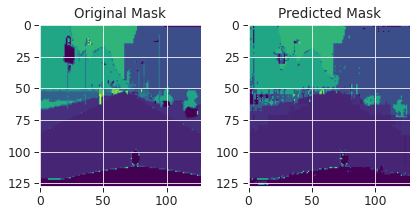

------------------------------------------------------------------------------------------------------------------------
| epoch 206 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26186  | train mIOU: 0.477 | train Dice Loss: -12.47293
------------------------------------------------------------------------------------------------------------------------
| end of epoch 206 | time: 39.91s | valid accuracy:    0.771 | valid loss: 1.08782 | valid mIOU: 0.197


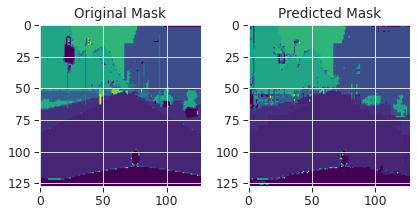

------------------------------------------------------------------------------------------------------------------------
| epoch 207 |   100/  185 batches | train accuracy    0.903 | train loss: 0.28036  | train mIOU: 0.449 | train Dice Loss: -12.28856
------------------------------------------------------------------------------------------------------------------------
| end of epoch 207 | time: 41.05s | valid accuracy:    0.775 | valid loss: 1.07838 | valid mIOU: 0.200


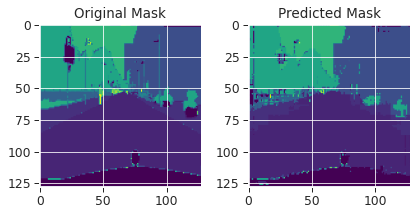

------------------------------------------------------------------------------------------------------------------------
| epoch 208 |   100/  185 batches | train accuracy    0.910 | train loss: 0.25739  | train mIOU: 0.457 | train Dice Loss: -12.69650
------------------------------------------------------------------------------------------------------------------------
| end of epoch 208 | time: 39.96s | valid accuracy:    0.772 | valid loss: 1.08117 | valid mIOU: 0.200


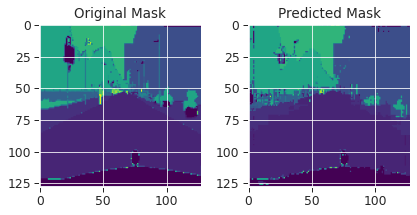

------------------------------------------------------------------------------------------------------------------------
| epoch 209 |   100/  185 batches | train accuracy    0.896 | train loss: 0.29359  | train mIOU: 0.457 | train Dice Loss: -12.86314
------------------------------------------------------------------------------------------------------------------------
| end of epoch 209 | time: 40.89s | valid accuracy:    0.774 | valid loss: 1.06806 | valid mIOU: 0.201


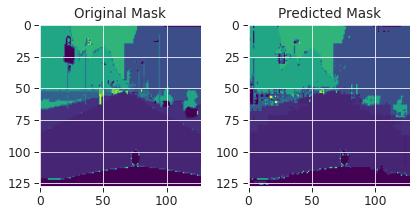

------------------------------------------------------------------------------------------------------------------------
| epoch 210 |   100/  185 batches | train accuracy    0.904 | train loss: 0.27181  | train mIOU: 0.450 | train Dice Loss: -12.80044
------------------------------------------------------------------------------------------------------------------------
| end of epoch 210 | time: 40.83s | valid accuracy:    0.773 | valid loss: 1.08504 | valid mIOU: 0.198


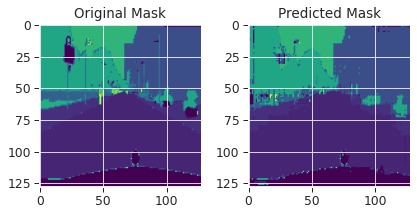

------------------------------------------------------------------------------------------------------------------------
| epoch 211 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24887  | train mIOU: 0.460 | train Dice Loss: -12.58647
------------------------------------------------------------------------------------------------------------------------
| end of epoch 211 | time: 40.60s | valid accuracy:    0.773 | valid loss: 1.09202 | valid mIOU: 0.197


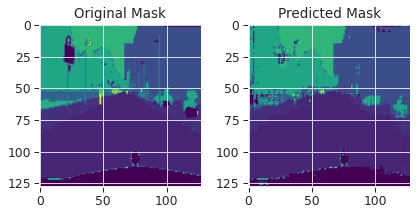

------------------------------------------------------------------------------------------------------------------------
| epoch 212 |   100/  185 batches | train accuracy    0.903 | train loss: 0.27279  | train mIOU: 0.452 | train Dice Loss: -12.96541
------------------------------------------------------------------------------------------------------------------------
| end of epoch 212 | time: 41.43s | valid accuracy:    0.775 | valid loss: 1.07511 | valid mIOU: 0.200


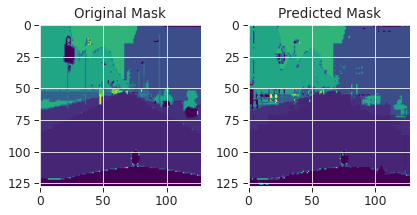

------------------------------------------------------------------------------------------------------------------------
| epoch 213 |   100/  185 batches | train accuracy    0.901 | train loss: 0.27927  | train mIOU: 0.507 | train Dice Loss: -13.09028
------------------------------------------------------------------------------------------------------------------------
| end of epoch 213 | time: 40.78s | valid accuracy:    0.774 | valid loss: 1.09040 | valid mIOU: 0.197


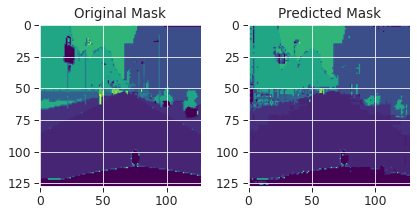

------------------------------------------------------------------------------------------------------------------------
| epoch 214 |   100/  185 batches | train accuracy    0.896 | train loss: 0.29582  | train mIOU: 0.440 | train Dice Loss: -12.65218
------------------------------------------------------------------------------------------------------------------------
| end of epoch 214 | time: 41.42s | valid accuracy:    0.775 | valid loss: 1.08321 | valid mIOU: 0.199


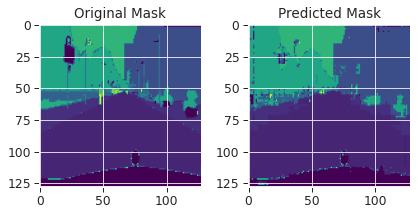

------------------------------------------------------------------------------------------------------------------------
| epoch 215 |   100/  185 batches | train accuracy    0.912 | train loss: 0.25319  | train mIOU: 0.477 | train Dice Loss: -12.27621
------------------------------------------------------------------------------------------------------------------------
| end of epoch 215 | time: 41.22s | valid accuracy:    0.771 | valid loss: 1.09446 | valid mIOU: 0.197


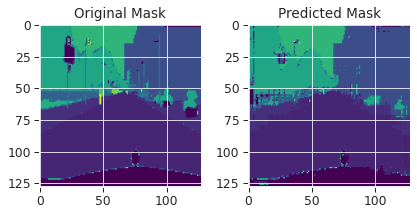

------------------------------------------------------------------------------------------------------------------------
| epoch 216 |   100/  185 batches | train accuracy    0.911 | train loss: 0.25642  | train mIOU: 0.429 | train Dice Loss: -13.65635
------------------------------------------------------------------------------------------------------------------------
| end of epoch 216 | time: 40.53s | valid accuracy:    0.774 | valid loss: 1.08274 | valid mIOU: 0.199


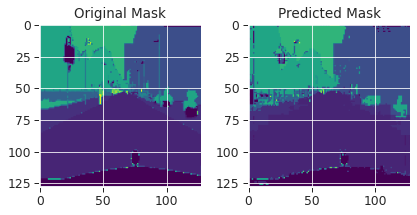

------------------------------------------------------------------------------------------------------------------------
| epoch 217 |   100/  185 batches | train accuracy    0.897 | train loss: 0.29393  | train mIOU: 0.466 | train Dice Loss: -12.63454
------------------------------------------------------------------------------------------------------------------------
| end of epoch 217 | time: 41.46s | valid accuracy:    0.773 | valid loss: 1.08399 | valid mIOU: 0.198


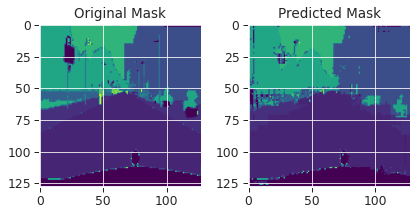

------------------------------------------------------------------------------------------------------------------------
| epoch 218 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26508  | train mIOU: 0.489 | train Dice Loss: -12.23783
------------------------------------------------------------------------------------------------------------------------
| end of epoch 218 | time: 40.96s | valid accuracy:    0.771 | valid loss: 1.08182 | valid mIOU: 0.196


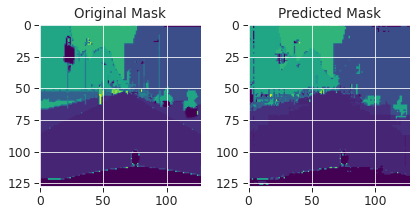

------------------------------------------------------------------------------------------------------------------------
| epoch 219 |   100/  185 batches | train accuracy    0.910 | train loss: 0.26128  | train mIOU: 0.452 | train Dice Loss: -11.94850
------------------------------------------------------------------------------------------------------------------------
| end of epoch 219 | time: 39.76s | valid accuracy:    0.768 | valid loss: 1.11070 | valid mIOU: 0.192


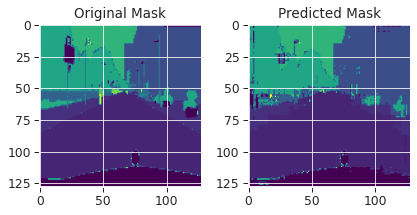

------------------------------------------------------------------------------------------------------------------------
| epoch 220 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23841  | train mIOU: 0.506 | train Dice Loss: -12.65330
------------------------------------------------------------------------------------------------------------------------
| end of epoch 220 | time: 39.70s | valid accuracy:    0.769 | valid loss: 1.11366 | valid mIOU: 0.190


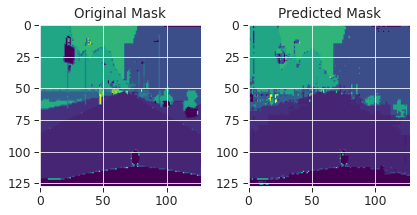

------------------------------------------------------------------------------------------------------------------------
| epoch 221 |   100/  185 batches | train accuracy    0.908 | train loss: 0.26267  | train mIOU: 0.467 | train Dice Loss: -12.04247
------------------------------------------------------------------------------------------------------------------------
| end of epoch 221 | time: 39.75s | valid accuracy:    0.768 | valid loss: 1.11253 | valid mIOU: 0.195


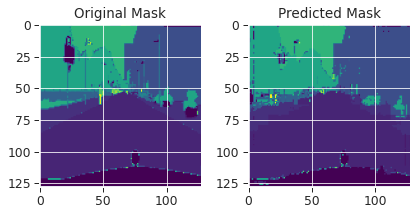

------------------------------------------------------------------------------------------------------------------------
| epoch 222 |   100/  185 batches | train accuracy    0.909 | train loss: 0.25849  | train mIOU: 0.456 | train Dice Loss: -12.96745
------------------------------------------------------------------------------------------------------------------------
| end of epoch 222 | time: 40.56s | valid accuracy:    0.775 | valid loss: 1.10478 | valid mIOU: 0.195


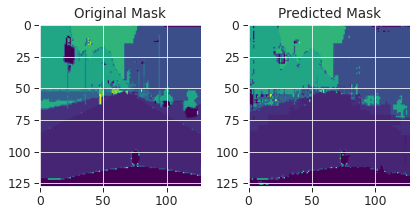

------------------------------------------------------------------------------------------------------------------------
| epoch 223 |   100/  185 batches | train accuracy    0.906 | train loss: 0.26917  | train mIOU: 0.449 | train Dice Loss: -12.91111
------------------------------------------------------------------------------------------------------------------------
| end of epoch 223 | time: 40.24s | valid accuracy:    0.769 | valid loss: 1.10188 | valid mIOU: 0.198


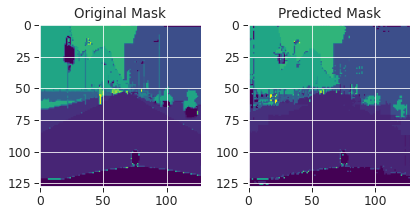

------------------------------------------------------------------------------------------------------------------------
| epoch 224 |   100/  185 batches | train accuracy    0.915 | train loss: 0.24277  | train mIOU: 0.463 | train Dice Loss: -12.40049
------------------------------------------------------------------------------------------------------------------------
| end of epoch 224 | time: 40.78s | valid accuracy:    0.769 | valid loss: 1.10421 | valid mIOU: 0.194


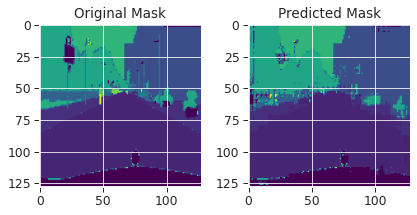

------------------------------------------------------------------------------------------------------------------------
| epoch 225 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23876  | train mIOU: 0.470 | train Dice Loss: -12.21757
------------------------------------------------------------------------------------------------------------------------
| end of epoch 225 | time: 40.57s | valid accuracy:    0.777 | valid loss: 1.08293 | valid mIOU: 0.198


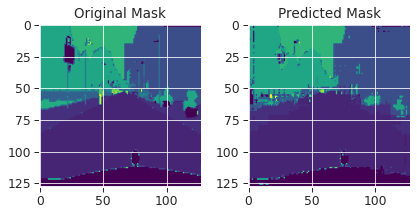

------------------------------------------------------------------------------------------------------------------------
| epoch 226 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23929  | train mIOU: 0.443 | train Dice Loss: -12.74835
------------------------------------------------------------------------------------------------------------------------
| end of epoch 226 | time: 40.09s | valid accuracy:    0.771 | valid loss: 1.10356 | valid mIOU: 0.193


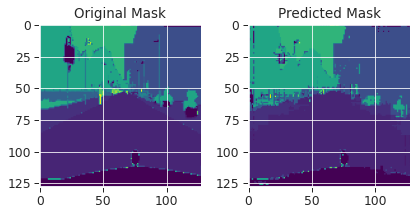

------------------------------------------------------------------------------------------------------------------------
| epoch 227 |   100/  185 batches | train accuracy    0.916 | train loss: 0.23761  | train mIOU: 0.488 | train Dice Loss: -13.09403
------------------------------------------------------------------------------------------------------------------------
| end of epoch 227 | time: 39.71s | valid accuracy:    0.773 | valid loss: 1.10566 | valid mIOU: 0.194


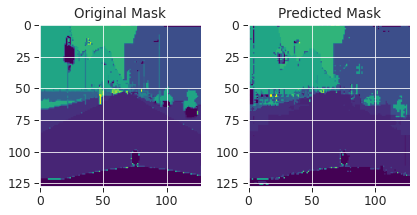

------------------------------------------------------------------------------------------------------------------------
| epoch 228 |   100/  185 batches | train accuracy    0.911 | train loss: 0.25305  | train mIOU: 0.479 | train Dice Loss: -12.19755
------------------------------------------------------------------------------------------------------------------------
| end of epoch 228 | time: 40.54s | valid accuracy:    0.770 | valid loss: 1.10786 | valid mIOU: 0.198


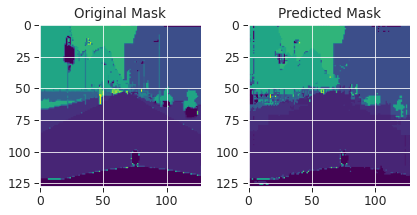

------------------------------------------------------------------------------------------------------------------------
| epoch 229 |   100/  185 batches | train accuracy    0.903 | train loss: 0.27456  | train mIOU: 0.473 | train Dice Loss: -12.79233
------------------------------------------------------------------------------------------------------------------------
| end of epoch 229 | time: 40.22s | valid accuracy:    0.776 | valid loss: 1.08901 | valid mIOU: 0.199


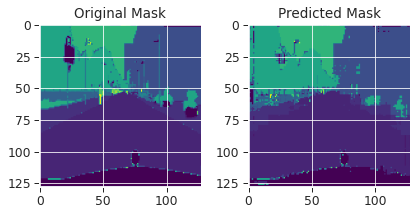

------------------------------------------------------------------------------------------------------------------------
| epoch 230 |   100/  185 batches | train accuracy    0.905 | train loss: 0.27079  | train mIOU: 0.458 | train Dice Loss: -12.60491
------------------------------------------------------------------------------------------------------------------------
| end of epoch 230 | time: 41.19s | valid accuracy:    0.772 | valid loss: 1.12058 | valid mIOU: 0.194


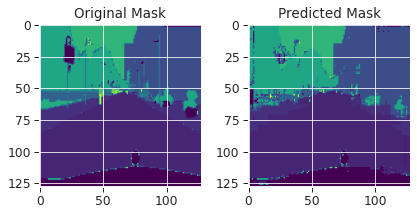

------------------------------------------------------------------------------------------------------------------------
| epoch 231 |   100/  185 batches | train accuracy    0.903 | train loss: 0.27700  | train mIOU: 0.457 | train Dice Loss: -12.81358
------------------------------------------------------------------------------------------------------------------------
| end of epoch 231 | time: 40.94s | valid accuracy:    0.772 | valid loss: 1.11033 | valid mIOU: 0.192


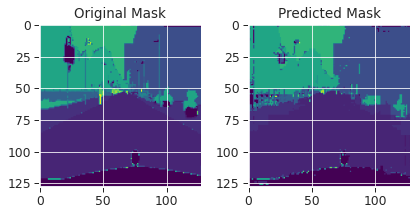

------------------------------------------------------------------------------------------------------------------------
| epoch 232 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24964  | train mIOU: 0.466 | train Dice Loss: -13.22225
------------------------------------------------------------------------------------------------------------------------
| end of epoch 232 | time: 41.77s | valid accuracy:    0.777 | valid loss: 1.09192 | valid mIOU: 0.200


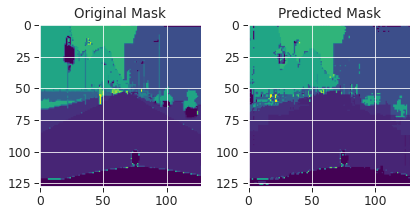

------------------------------------------------------------------------------------------------------------------------
| epoch 233 |   100/  185 batches | train accuracy    0.904 | train loss: 0.27105  | train mIOU: 0.498 | train Dice Loss: -12.69587
------------------------------------------------------------------------------------------------------------------------
| end of epoch 233 | time: 40.05s | valid accuracy:    0.771 | valid loss: 1.12677 | valid mIOU: 0.197


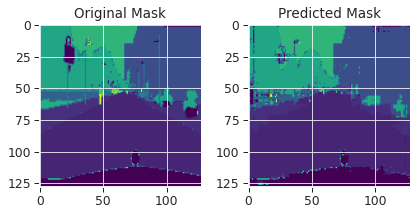

------------------------------------------------------------------------------------------------------------------------
| epoch 234 |   100/  185 batches | train accuracy    0.903 | train loss: 0.27831  | train mIOU: 0.478 | train Dice Loss: -12.35289
------------------------------------------------------------------------------------------------------------------------
| end of epoch 234 | time: 40.10s | valid accuracy:    0.775 | valid loss: 1.10323 | valid mIOU: 0.195


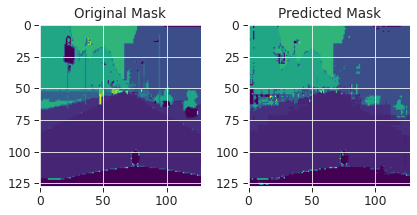

------------------------------------------------------------------------------------------------------------------------
| epoch 235 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26601  | train mIOU: 0.432 | train Dice Loss: -12.74460
------------------------------------------------------------------------------------------------------------------------
| end of epoch 235 | time: 40.60s | valid accuracy:    0.774 | valid loss: 1.10839 | valid mIOU: 0.198


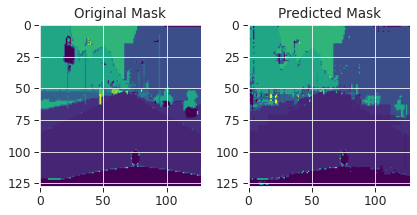

------------------------------------------------------------------------------------------------------------------------
| epoch 236 |   100/  185 batches | train accuracy    0.903 | train loss: 0.28100  | train mIOU: 0.515 | train Dice Loss: -13.53095
------------------------------------------------------------------------------------------------------------------------
| end of epoch 236 | time: 41.19s | valid accuracy:    0.771 | valid loss: 1.13051 | valid mIOU: 0.193


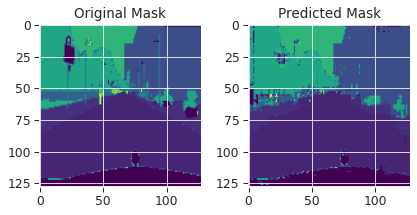

------------------------------------------------------------------------------------------------------------------------
| epoch 237 |   100/  185 batches | train accuracy    0.911 | train loss: 0.25194  | train mIOU: 0.465 | train Dice Loss: -12.13488
------------------------------------------------------------------------------------------------------------------------
| end of epoch 237 | time: 40.45s | valid accuracy:    0.773 | valid loss: 1.11678 | valid mIOU: 0.195


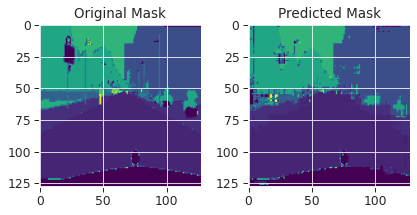

------------------------------------------------------------------------------------------------------------------------
| epoch 238 |   100/  185 batches | train accuracy    0.897 | train loss: 0.29494  | train mIOU: 0.450 | train Dice Loss: -12.34650
------------------------------------------------------------------------------------------------------------------------
| end of epoch 238 | time: 40.86s | valid accuracy:    0.770 | valid loss: 1.13008 | valid mIOU: 0.192


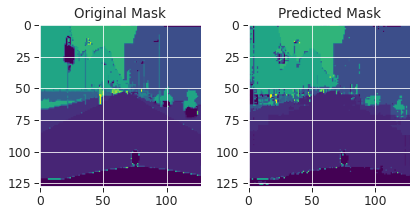

------------------------------------------------------------------------------------------------------------------------
| epoch 239 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24490  | train mIOU: 0.483 | train Dice Loss: -13.98860
------------------------------------------------------------------------------------------------------------------------
| end of epoch 239 | time: 40.82s | valid accuracy:    0.775 | valid loss: 1.13108 | valid mIOU: 0.195


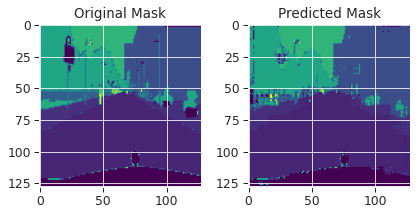

------------------------------------------------------------------------------------------------------------------------
| epoch 240 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24916  | train mIOU: 0.459 | train Dice Loss: -13.37529
------------------------------------------------------------------------------------------------------------------------
| end of epoch 240 | time: 41.02s | valid accuracy:    0.769 | valid loss: 1.13996 | valid mIOU: 0.194


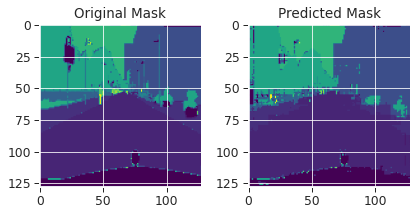

------------------------------------------------------------------------------------------------------------------------
| epoch 241 |   100/  185 batches | train accuracy    0.905 | train loss: 0.26789  | train mIOU: 0.455 | train Dice Loss: -13.27858
------------------------------------------------------------------------------------------------------------------------
| end of epoch 241 | time: 40.91s | valid accuracy:    0.769 | valid loss: 1.14511 | valid mIOU: 0.196


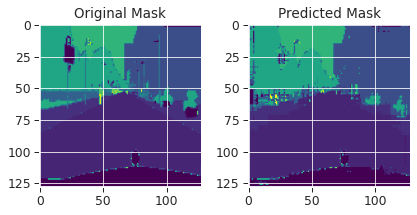

------------------------------------------------------------------------------------------------------------------------
| epoch 242 |   100/  185 batches | train accuracy    0.911 | train loss: 0.25331  | train mIOU: 0.466 | train Dice Loss: -13.07216
------------------------------------------------------------------------------------------------------------------------
| end of epoch 242 | time: 40.61s | valid accuracy:    0.767 | valid loss: 1.14307 | valid mIOU: 0.193


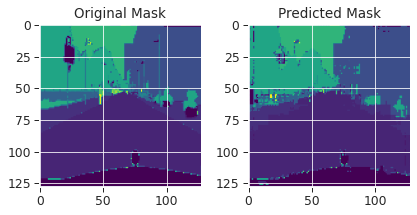

------------------------------------------------------------------------------------------------------------------------
| epoch 243 |   100/  185 batches | train accuracy    0.923 | train loss: 0.21173  | train mIOU: 0.441 | train Dice Loss: -12.83152
------------------------------------------------------------------------------------------------------------------------
| end of epoch 243 | time: 40.92s | valid accuracy:    0.774 | valid loss: 1.11684 | valid mIOU: 0.198


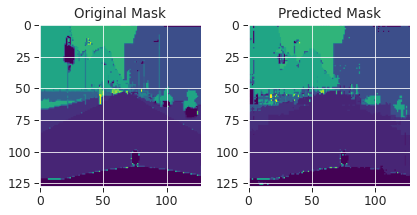

------------------------------------------------------------------------------------------------------------------------
| epoch 244 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26448  | train mIOU: 0.492 | train Dice Loss: -12.72232
------------------------------------------------------------------------------------------------------------------------
| end of epoch 244 | time: 39.41s | valid accuracy:    0.773 | valid loss: 1.12792 | valid mIOU: 0.192


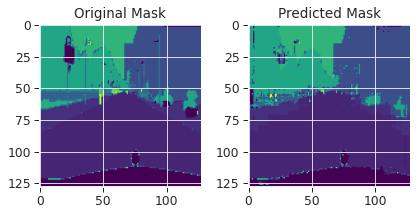

------------------------------------------------------------------------------------------------------------------------
| epoch 245 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22926  | train mIOU: 0.446 | train Dice Loss: -13.12821
------------------------------------------------------------------------------------------------------------------------
| end of epoch 245 | time: 40.59s | valid accuracy:    0.769 | valid loss: 1.13842 | valid mIOU: 0.192


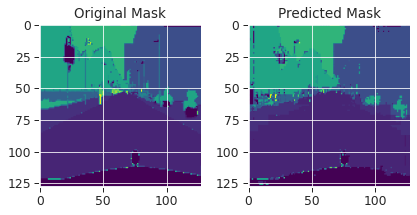

------------------------------------------------------------------------------------------------------------------------
| epoch 246 |   100/  185 batches | train accuracy    0.904 | train loss: 0.27453  | train mIOU: 0.446 | train Dice Loss: -13.84098
------------------------------------------------------------------------------------------------------------------------
| end of epoch 246 | time: 40.12s | valid accuracy:    0.769 | valid loss: 1.15683 | valid mIOU: 0.193


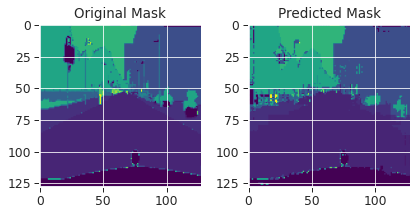

------------------------------------------------------------------------------------------------------------------------
| epoch 247 |   100/  185 batches | train accuracy    0.908 | train loss: 0.26155  | train mIOU: 0.489 | train Dice Loss: -12.39356
------------------------------------------------------------------------------------------------------------------------
| end of epoch 247 | time: 40.10s | valid accuracy:    0.771 | valid loss: 1.15598 | valid mIOU: 0.191


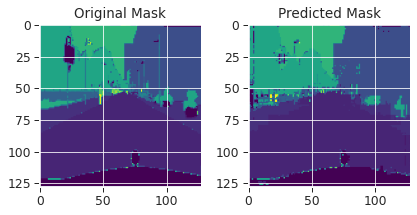

------------------------------------------------------------------------------------------------------------------------
| epoch 248 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23849  | train mIOU: 0.491 | train Dice Loss: -12.20539
------------------------------------------------------------------------------------------------------------------------
| end of epoch 248 | time: 40.85s | valid accuracy:    0.775 | valid loss: 1.11626 | valid mIOU: 0.194


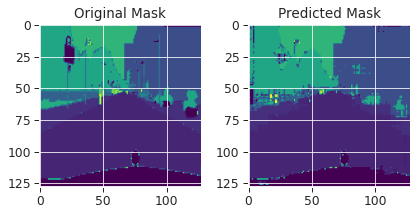

------------------------------------------------------------------------------------------------------------------------
| epoch 249 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24597  | train mIOU: 0.427 | train Dice Loss: -12.77626
------------------------------------------------------------------------------------------------------------------------
| end of epoch 249 | time: 40.38s | valid accuracy:    0.768 | valid loss: 1.13977 | valid mIOU: 0.192


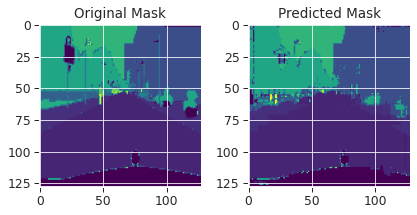

------------------------------------------------------------------------------------------------------------------------
| epoch 250 |   100/  185 batches | train accuracy    0.905 | train loss: 0.26684  | train mIOU: 0.464 | train Dice Loss: -12.83098
------------------------------------------------------------------------------------------------------------------------
| end of epoch 250 | time: 41.30s | valid accuracy:    0.773 | valid loss: 1.13817 | valid mIOU: 0.196


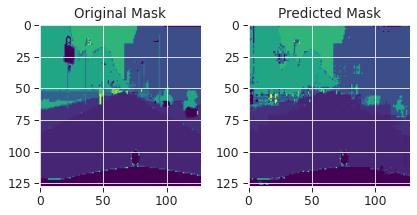

------------------------------------------------------------------------------------------------------------------------
| epoch 251 |   100/  185 batches | train accuracy    0.927 | train loss: 0.20839  | train mIOU: 0.533 | train Dice Loss: -13.74342
------------------------------------------------------------------------------------------------------------------------
| end of epoch 251 | time: 40.99s | valid accuracy:    0.773 | valid loss: 1.14209 | valid mIOU: 0.197


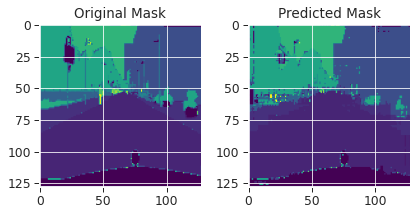

------------------------------------------------------------------------------------------------------------------------
| epoch 252 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24691  | train mIOU: 0.524 | train Dice Loss: -12.53154
------------------------------------------------------------------------------------------------------------------------
| end of epoch 252 | time: 40.54s | valid accuracy:    0.771 | valid loss: 1.17620 | valid mIOU: 0.194


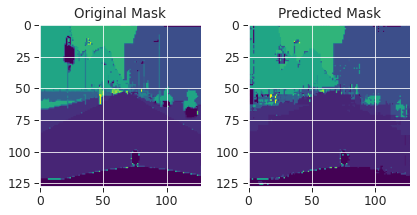

------------------------------------------------------------------------------------------------------------------------
| epoch 253 |   100/  185 batches | train accuracy    0.914 | train loss: 0.24253  | train mIOU: 0.499 | train Dice Loss: -12.36585
------------------------------------------------------------------------------------------------------------------------
| end of epoch 253 | time: 40.67s | valid accuracy:    0.771 | valid loss: 1.15252 | valid mIOU: 0.192


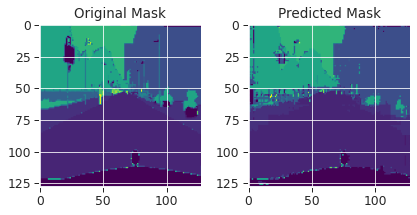

------------------------------------------------------------------------------------------------------------------------
| epoch 254 |   100/  185 batches | train accuracy    0.910 | train loss: 0.25012  | train mIOU: 0.496 | train Dice Loss: -13.39289
------------------------------------------------------------------------------------------------------------------------
| end of epoch 254 | time: 40.84s | valid accuracy:    0.775 | valid loss: 1.13560 | valid mIOU: 0.198


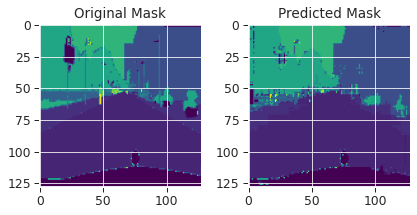

------------------------------------------------------------------------------------------------------------------------
| epoch 255 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22937  | train mIOU: 0.500 | train Dice Loss: -12.30822
------------------------------------------------------------------------------------------------------------------------
| end of epoch 255 | time: 40.20s | valid accuracy:    0.773 | valid loss: 1.15503 | valid mIOU: 0.195


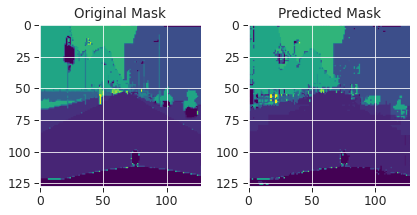

------------------------------------------------------------------------------------------------------------------------
| epoch 256 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22730  | train mIOU: 0.506 | train Dice Loss: -12.81453
------------------------------------------------------------------------------------------------------------------------
| end of epoch 256 | time: 40.89s | valid accuracy:    0.768 | valid loss: 1.17668 | valid mIOU: 0.190


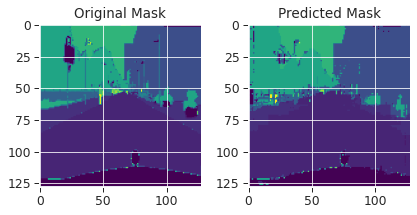

------------------------------------------------------------------------------------------------------------------------
| epoch 257 |   100/  185 batches | train accuracy    0.907 | train loss: 0.25603  | train mIOU: 0.457 | train Dice Loss: -11.96146
------------------------------------------------------------------------------------------------------------------------
| end of epoch 257 | time: 41.12s | valid accuracy:    0.775 | valid loss: 1.13686 | valid mIOU: 0.194


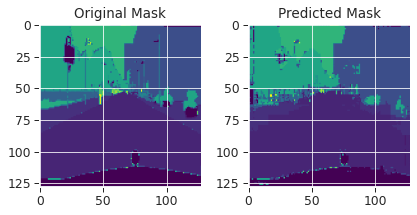

------------------------------------------------------------------------------------------------------------------------
| epoch 258 |   100/  185 batches | train accuracy    0.898 | train loss: 0.28858  | train mIOU: 0.445 | train Dice Loss: -12.91336
------------------------------------------------------------------------------------------------------------------------
| end of epoch 258 | time: 40.90s | valid accuracy:    0.768 | valid loss: 1.16218 | valid mIOU: 0.193


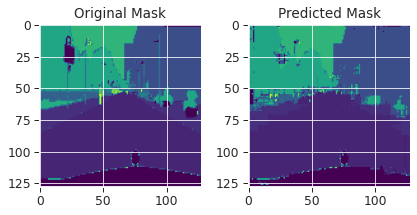

------------------------------------------------------------------------------------------------------------------------
| epoch 259 |   100/  185 batches | train accuracy    0.905 | train loss: 0.27063  | train mIOU: 0.485 | train Dice Loss: -13.61849
------------------------------------------------------------------------------------------------------------------------
| end of epoch 259 | time: 40.32s | valid accuracy:    0.769 | valid loss: 1.16019 | valid mIOU: 0.193


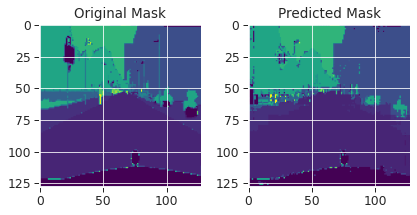

------------------------------------------------------------------------------------------------------------------------
| epoch 260 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24477  | train mIOU: 0.515 | train Dice Loss: -12.48793
------------------------------------------------------------------------------------------------------------------------
| end of epoch 260 | time: 40.65s | valid accuracy:    0.772 | valid loss: 1.16247 | valid mIOU: 0.192


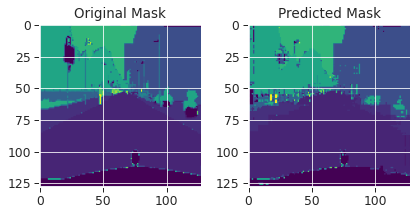

------------------------------------------------------------------------------------------------------------------------
| epoch 261 |   100/  185 batches | train accuracy    0.914 | train loss: 0.24116  | train mIOU: 0.483 | train Dice Loss: -12.84113
------------------------------------------------------------------------------------------------------------------------
| end of epoch 261 | time: 40.95s | valid accuracy:    0.769 | valid loss: 1.16495 | valid mIOU: 0.192


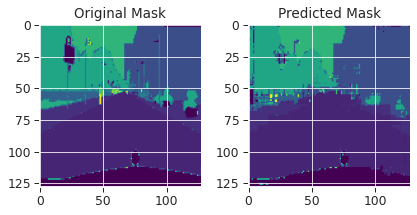

------------------------------------------------------------------------------------------------------------------------
| epoch 262 |   100/  185 batches | train accuracy    0.899 | train loss: 0.28045  | train mIOU: 0.483 | train Dice Loss: -12.01880
------------------------------------------------------------------------------------------------------------------------
| end of epoch 262 | time: 41.11s | valid accuracy:    0.773 | valid loss: 1.16470 | valid mIOU: 0.191


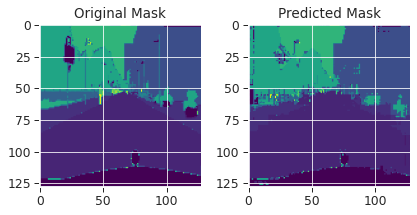

------------------------------------------------------------------------------------------------------------------------
| epoch 263 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24934  | train mIOU: 0.482 | train Dice Loss: -12.70545
------------------------------------------------------------------------------------------------------------------------
| end of epoch 263 | time: 39.34s | valid accuracy:    0.774 | valid loss: 1.15127 | valid mIOU: 0.194


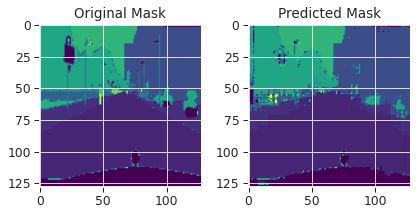

------------------------------------------------------------------------------------------------------------------------
| epoch 264 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26223  | train mIOU: 0.471 | train Dice Loss: -13.50531
------------------------------------------------------------------------------------------------------------------------
| end of epoch 264 | time: 40.01s | valid accuracy:    0.774 | valid loss: 1.15330 | valid mIOU: 0.195


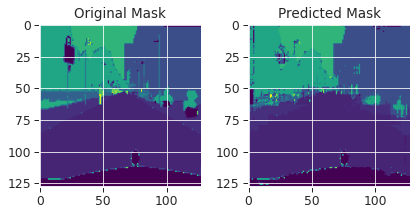

------------------------------------------------------------------------------------------------------------------------
| epoch 265 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25779  | train mIOU: 0.471 | train Dice Loss: -13.38232
------------------------------------------------------------------------------------------------------------------------
| end of epoch 265 | time: 40.27s | valid accuracy:    0.772 | valid loss: 1.15974 | valid mIOU: 0.194


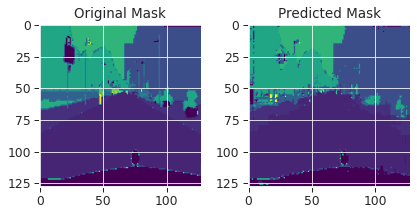

------------------------------------------------------------------------------------------------------------------------
| epoch 266 |   100/  185 batches | train accuracy    0.909 | train loss: 0.25551  | train mIOU: 0.495 | train Dice Loss: -11.90987
------------------------------------------------------------------------------------------------------------------------
| end of epoch 266 | time: 41.10s | valid accuracy:    0.774 | valid loss: 1.15975 | valid mIOU: 0.195


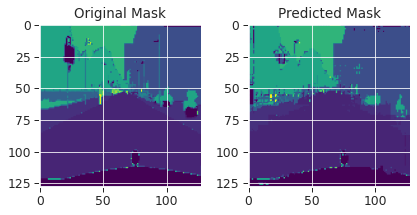

------------------------------------------------------------------------------------------------------------------------
| epoch 267 |   100/  185 batches | train accuracy    0.916 | train loss: 0.23830  | train mIOU: 0.455 | train Dice Loss: -13.11542
------------------------------------------------------------------------------------------------------------------------
| end of epoch 267 | time: 42.13s | valid accuracy:    0.772 | valid loss: 1.16063 | valid mIOU: 0.194


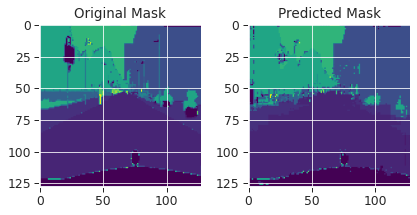

------------------------------------------------------------------------------------------------------------------------
| epoch 268 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24897  | train mIOU: 0.518 | train Dice Loss: -13.55466
------------------------------------------------------------------------------------------------------------------------
| end of epoch 268 | time: 41.21s | valid accuracy:    0.771 | valid loss: 1.17346 | valid mIOU: 0.193


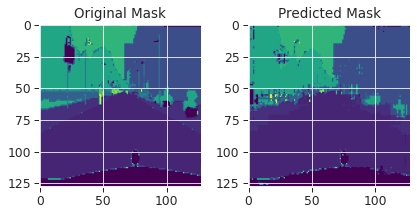

------------------------------------------------------------------------------------------------------------------------
| epoch 269 |   100/  185 batches | train accuracy    0.910 | train loss: 0.25584  | train mIOU: 0.503 | train Dice Loss: -12.28795
------------------------------------------------------------------------------------------------------------------------
| end of epoch 269 | time: 41.30s | valid accuracy:    0.774 | valid loss: 1.17342 | valid mIOU: 0.195


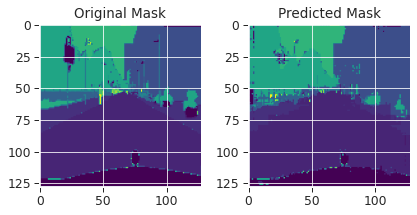

------------------------------------------------------------------------------------------------------------------------
| epoch 270 |   100/  185 batches | train accuracy    0.905 | train loss: 0.26870  | train mIOU: 0.493 | train Dice Loss: -13.49235
------------------------------------------------------------------------------------------------------------------------
| end of epoch 270 | time: 41.26s | valid accuracy:    0.773 | valid loss: 1.15689 | valid mIOU: 0.195


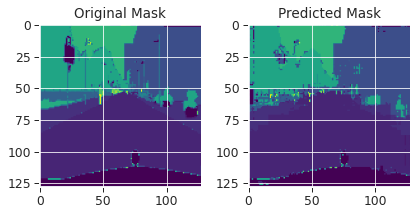

------------------------------------------------------------------------------------------------------------------------
| epoch 271 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23367  | train mIOU: 0.437 | train Dice Loss: -12.58872
------------------------------------------------------------------------------------------------------------------------
| end of epoch 271 | time: 39.45s | valid accuracy:    0.775 | valid loss: 1.16590 | valid mIOU: 0.196


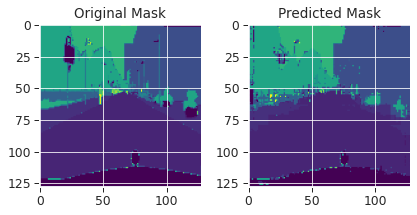

------------------------------------------------------------------------------------------------------------------------
| epoch 272 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23636  | train mIOU: 0.471 | train Dice Loss: -13.20334
------------------------------------------------------------------------------------------------------------------------
| end of epoch 272 | time: 39.38s | valid accuracy:    0.772 | valid loss: 1.16776 | valid mIOU: 0.195


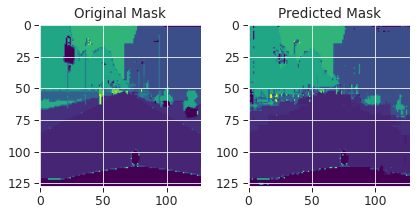

------------------------------------------------------------------------------------------------------------------------
| epoch 273 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23520  | train mIOU: 0.474 | train Dice Loss: -12.14700
------------------------------------------------------------------------------------------------------------------------
| end of epoch 273 | time: 40.10s | valid accuracy:    0.772 | valid loss: 1.16912 | valid mIOU: 0.194


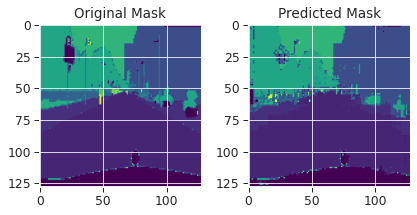

------------------------------------------------------------------------------------------------------------------------
| epoch 274 |   100/  185 batches | train accuracy    0.906 | train loss: 0.26591  | train mIOU: 0.465 | train Dice Loss: -12.96485
------------------------------------------------------------------------------------------------------------------------
| end of epoch 274 | time: 40.84s | valid accuracy:    0.772 | valid loss: 1.16894 | valid mIOU: 0.192


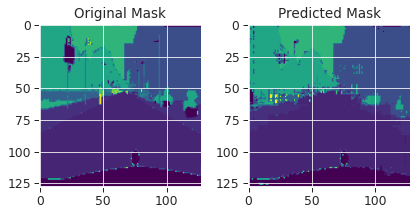

------------------------------------------------------------------------------------------------------------------------
| epoch 275 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26447  | train mIOU: 0.492 | train Dice Loss: -12.96991
------------------------------------------------------------------------------------------------------------------------
| end of epoch 275 | time: 41.26s | valid accuracy:    0.776 | valid loss: 1.18232 | valid mIOU: 0.193


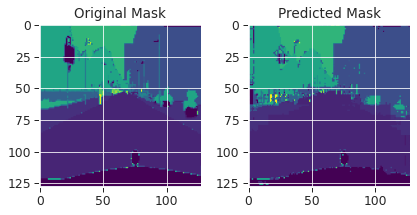

------------------------------------------------------------------------------------------------------------------------
| epoch 276 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24807  | train mIOU: 0.502 | train Dice Loss: -12.98806
------------------------------------------------------------------------------------------------------------------------
| end of epoch 276 | time: 39.95s | valid accuracy:    0.771 | valid loss: 1.18697 | valid mIOU: 0.195


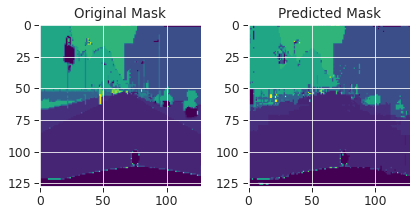

------------------------------------------------------------------------------------------------------------------------
| epoch 277 |   100/  185 batches | train accuracy    0.906 | train loss: 0.26315  | train mIOU: 0.480 | train Dice Loss: -11.98562
------------------------------------------------------------------------------------------------------------------------
| end of epoch 277 | time: 42.46s | valid accuracy:    0.774 | valid loss: 1.18933 | valid mIOU: 0.195


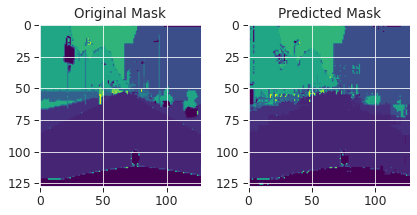

------------------------------------------------------------------------------------------------------------------------
| epoch 278 |   100/  185 batches | train accuracy    0.909 | train loss: 0.25605  | train mIOU: 0.528 | train Dice Loss: -12.63733
------------------------------------------------------------------------------------------------------------------------
| end of epoch 278 | time: 41.46s | valid accuracy:    0.772 | valid loss: 1.18813 | valid mIOU: 0.192


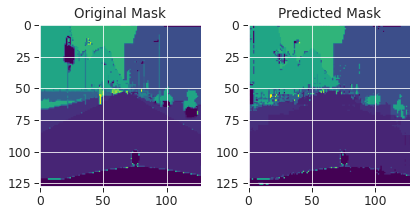

------------------------------------------------------------------------------------------------------------------------
| epoch 279 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21960  | train mIOU: 0.512 | train Dice Loss: -12.54200
------------------------------------------------------------------------------------------------------------------------
| end of epoch 279 | time: 40.10s | valid accuracy:    0.771 | valid loss: 1.19061 | valid mIOU: 0.193


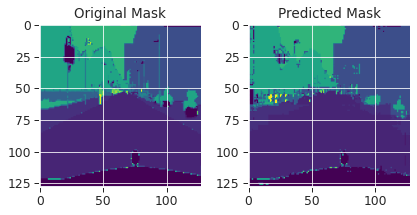

------------------------------------------------------------------------------------------------------------------------
| epoch 280 |   100/  185 batches | train accuracy    0.921 | train loss: 0.22149  | train mIOU: 0.499 | train Dice Loss: -12.49245
------------------------------------------------------------------------------------------------------------------------
| end of epoch 280 | time: 41.45s | valid accuracy:    0.772 | valid loss: 1.18400 | valid mIOU: 0.194


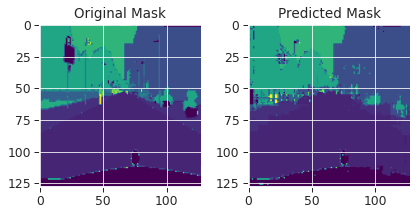

------------------------------------------------------------------------------------------------------------------------
| epoch 281 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23346  | train mIOU: 0.513 | train Dice Loss: -12.25403
------------------------------------------------------------------------------------------------------------------------
| end of epoch 281 | time: 40.79s | valid accuracy:    0.773 | valid loss: 1.16759 | valid mIOU: 0.195


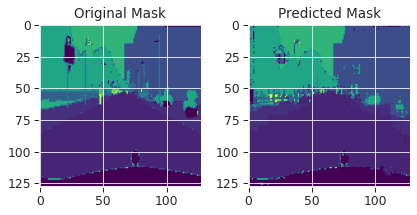

------------------------------------------------------------------------------------------------------------------------
| epoch 282 |   100/  185 batches | train accuracy    0.910 | train loss: 0.25074  | train mIOU: 0.545 | train Dice Loss: -12.89572
------------------------------------------------------------------------------------------------------------------------
| end of epoch 282 | time: 40.70s | valid accuracy:    0.776 | valid loss: 1.20555 | valid mIOU: 0.195


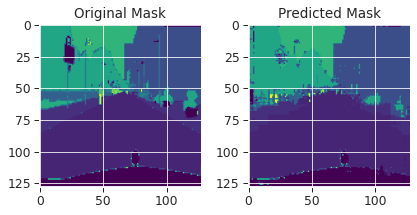

------------------------------------------------------------------------------------------------------------------------
| epoch 283 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26256  | train mIOU: 0.499 | train Dice Loss: -13.12404
------------------------------------------------------------------------------------------------------------------------
| end of epoch 283 | time: 40.00s | valid accuracy:    0.773 | valid loss: 1.20356 | valid mIOU: 0.194


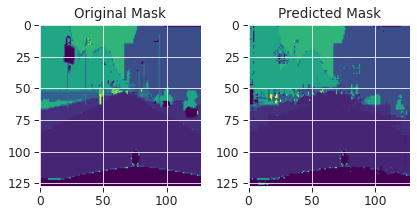

------------------------------------------------------------------------------------------------------------------------
| epoch 284 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24341  | train mIOU: 0.495 | train Dice Loss: -12.57656
------------------------------------------------------------------------------------------------------------------------
| end of epoch 284 | time: 40.93s | valid accuracy:    0.773 | valid loss: 1.18614 | valid mIOU: 0.195


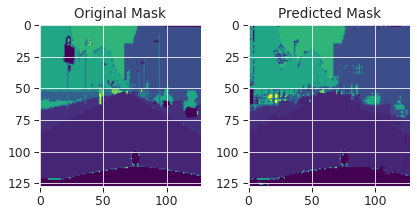

------------------------------------------------------------------------------------------------------------------------
| epoch 285 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24647  | train mIOU: 0.500 | train Dice Loss: -12.52281
------------------------------------------------------------------------------------------------------------------------
| end of epoch 285 | time: 39.80s | valid accuracy:    0.774 | valid loss: 1.19105 | valid mIOU: 0.198


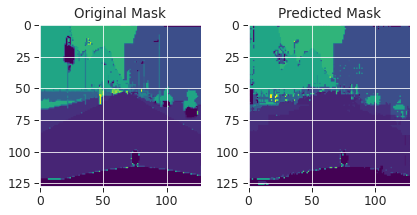

------------------------------------------------------------------------------------------------------------------------
| epoch 286 |   100/  185 batches | train accuracy    0.908 | train loss: 0.26053  | train mIOU: 0.496 | train Dice Loss: -13.44655
------------------------------------------------------------------------------------------------------------------------
| end of epoch 286 | time: 39.48s | valid accuracy:    0.770 | valid loss: 1.22009 | valid mIOU: 0.194


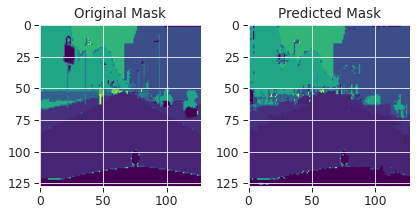

------------------------------------------------------------------------------------------------------------------------
| epoch 287 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23952  | train mIOU: 0.484 | train Dice Loss: -12.55240
------------------------------------------------------------------------------------------------------------------------
| end of epoch 287 | time: 41.96s | valid accuracy:    0.770 | valid loss: 1.21184 | valid mIOU: 0.193


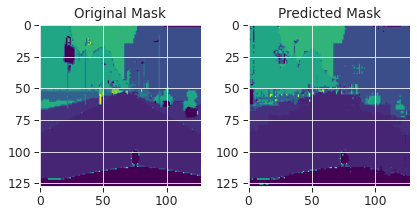

------------------------------------------------------------------------------------------------------------------------
| epoch 288 |   100/  185 batches | train accuracy    0.910 | train loss: 0.25133  | train mIOU: 0.469 | train Dice Loss: -12.89093
------------------------------------------------------------------------------------------------------------------------
| end of epoch 288 | time: 41.35s | valid accuracy:    0.768 | valid loss: 1.21717 | valid mIOU: 0.192


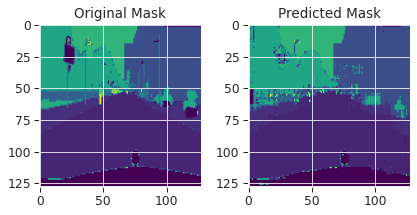

------------------------------------------------------------------------------------------------------------------------
| epoch 289 |   100/  185 batches | train accuracy    0.910 | train loss: 0.24551  | train mIOU: 0.441 | train Dice Loss: -12.30963
------------------------------------------------------------------------------------------------------------------------
| end of epoch 289 | time: 40.59s | valid accuracy:    0.772 | valid loss: 1.20647 | valid mIOU: 0.195


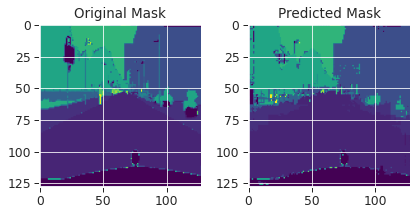

------------------------------------------------------------------------------------------------------------------------
| epoch 290 |   100/  185 batches | train accuracy    0.927 | train loss: 0.20457  | train mIOU: 0.540 | train Dice Loss: -12.78924
------------------------------------------------------------------------------------------------------------------------
| end of epoch 290 | time: 39.94s | valid accuracy:    0.767 | valid loss: 1.22614 | valid mIOU: 0.192


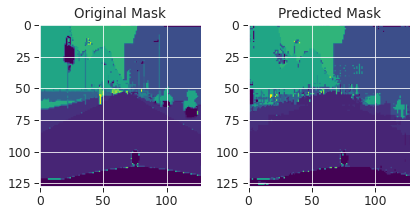

------------------------------------------------------------------------------------------------------------------------
| epoch 291 |   100/  185 batches | train accuracy    0.909 | train loss: 0.25122  | train mIOU: 0.487 | train Dice Loss: -12.06606
------------------------------------------------------------------------------------------------------------------------
| end of epoch 291 | time: 39.21s | valid accuracy:    0.773 | valid loss: 1.21045 | valid mIOU: 0.195


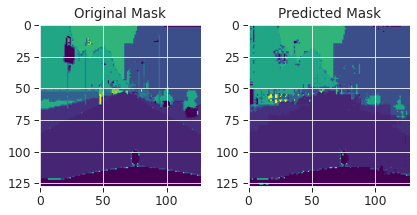

------------------------------------------------------------------------------------------------------------------------
| epoch 292 |   100/  185 batches | train accuracy    0.907 | train loss: 0.26032  | train mIOU: 0.489 | train Dice Loss: -13.02276
------------------------------------------------------------------------------------------------------------------------
| end of epoch 292 | time: 41.03s | valid accuracy:    0.771 | valid loss: 1.20953 | valid mIOU: 0.197


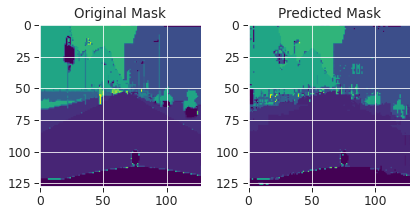

------------------------------------------------------------------------------------------------------------------------
| epoch 293 |   100/  185 batches | train accuracy    0.916 | train loss: 0.23492  | train mIOU: 0.485 | train Dice Loss: -13.44024
------------------------------------------------------------------------------------------------------------------------
| end of epoch 293 | time: 41.34s | valid accuracy:    0.770 | valid loss: 1.22344 | valid mIOU: 0.195


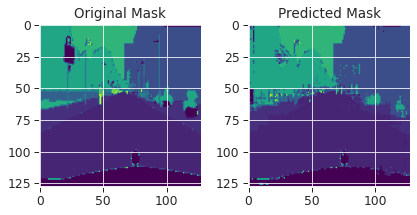

------------------------------------------------------------------------------------------------------------------------
| epoch 294 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21830  | train mIOU: 0.492 | train Dice Loss: -12.88359
------------------------------------------------------------------------------------------------------------------------
| end of epoch 294 | time: 41.65s | valid accuracy:    0.774 | valid loss: 1.20142 | valid mIOU: 0.195


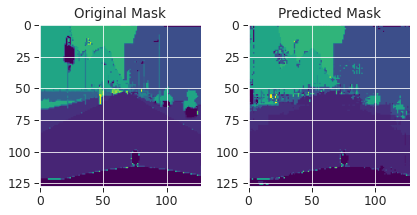

------------------------------------------------------------------------------------------------------------------------
| epoch 295 |   100/  185 batches | train accuracy    0.914 | train loss: 0.24070  | train mIOU: 0.462 | train Dice Loss: -13.29371
------------------------------------------------------------------------------------------------------------------------
| end of epoch 295 | time: 40.47s | valid accuracy:    0.770 | valid loss: 1.21233 | valid mIOU: 0.194


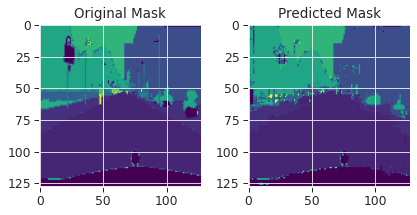

------------------------------------------------------------------------------------------------------------------------
| epoch 296 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22846  | train mIOU: 0.486 | train Dice Loss: -12.26225
------------------------------------------------------------------------------------------------------------------------
| end of epoch 296 | time: 40.13s | valid accuracy:    0.771 | valid loss: 1.24091 | valid mIOU: 0.195


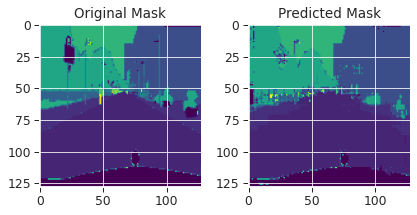

------------------------------------------------------------------------------------------------------------------------
| epoch 297 |   100/  185 batches | train accuracy    0.918 | train loss: 0.22702  | train mIOU: 0.491 | train Dice Loss: -13.89362
------------------------------------------------------------------------------------------------------------------------
| end of epoch 297 | time: 40.17s | valid accuracy:    0.774 | valid loss: 1.21425 | valid mIOU: 0.196


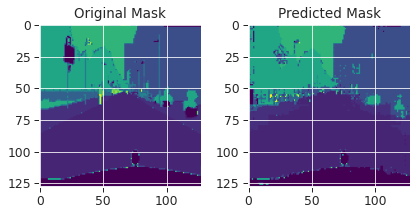

------------------------------------------------------------------------------------------------------------------------
| epoch 298 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20612  | train mIOU: 0.461 | train Dice Loss: -12.58098
------------------------------------------------------------------------------------------------------------------------
| end of epoch 298 | time: 40.60s | valid accuracy:    0.771 | valid loss: 1.24321 | valid mIOU: 0.194


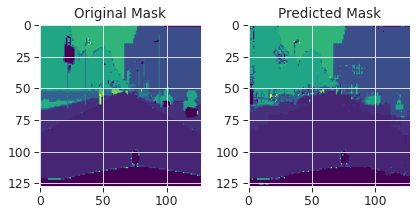

------------------------------------------------------------------------------------------------------------------------
| epoch 299 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25510  | train mIOU: 0.493 | train Dice Loss: -12.23112
------------------------------------------------------------------------------------------------------------------------
| end of epoch 299 | time: 39.98s | valid accuracy:    0.772 | valid loss: 1.22386 | valid mIOU: 0.195


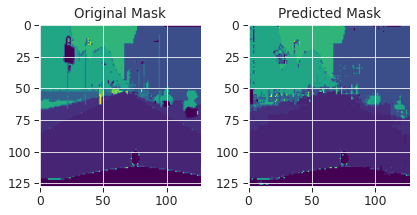

------------------------------------------------------------------------------------------------------------------------
| epoch 300 |   100/  185 batches | train accuracy    0.900 | train loss: 0.27744  | train mIOU: 0.502 | train Dice Loss: -13.00170
------------------------------------------------------------------------------------------------------------------------
| end of epoch 300 | time: 39.95s | valid accuracy:    0.776 | valid loss: 1.20279 | valid mIOU: 0.197


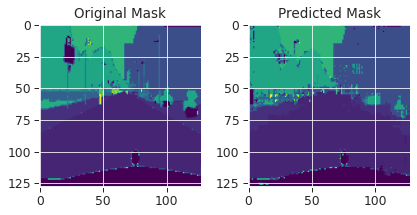

------------------------------------------------------------------------------------------------------------------------
| epoch 301 |   100/  185 batches | train accuracy    0.904 | train loss: 0.26557  | train mIOU: 0.491 | train Dice Loss: -12.72201
------------------------------------------------------------------------------------------------------------------------
| end of epoch 301 | time: 40.67s | valid accuracy:    0.773 | valid loss: 1.22365 | valid mIOU: 0.195


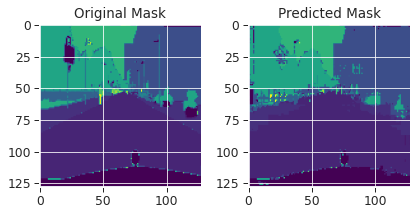

------------------------------------------------------------------------------------------------------------------------
| epoch 302 |   100/  185 batches | train accuracy    0.918 | train loss: 0.23293  | train mIOU: 0.540 | train Dice Loss: -12.93684
------------------------------------------------------------------------------------------------------------------------
| end of epoch 302 | time: 40.88s | valid accuracy:    0.770 | valid loss: 1.22436 | valid mIOU: 0.194


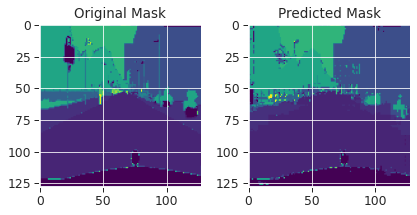

------------------------------------------------------------------------------------------------------------------------
| epoch 303 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24346  | train mIOU: 0.490 | train Dice Loss: -12.71292
------------------------------------------------------------------------------------------------------------------------
| end of epoch 303 | time: 40.65s | valid accuracy:    0.772 | valid loss: 1.22474 | valid mIOU: 0.195


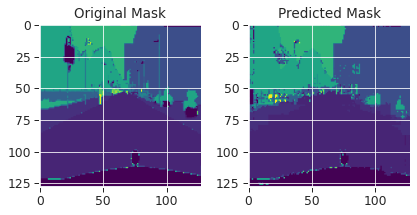

------------------------------------------------------------------------------------------------------------------------
| epoch 304 |   100/  185 batches | train accuracy    0.910 | train loss: 0.25014  | train mIOU: 0.521 | train Dice Loss: -12.84801
------------------------------------------------------------------------------------------------------------------------
| end of epoch 304 | time: 39.58s | valid accuracy:    0.772 | valid loss: 1.22830 | valid mIOU: 0.194


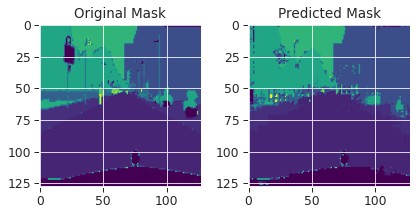

------------------------------------------------------------------------------------------------------------------------
| epoch 305 |   100/  185 batches | train accuracy    0.914 | train loss: 0.23821  | train mIOU: 0.469 | train Dice Loss: -13.52912
------------------------------------------------------------------------------------------------------------------------
| end of epoch 305 | time: 40.66s | valid accuracy:    0.771 | valid loss: 1.23745 | valid mIOU: 0.194


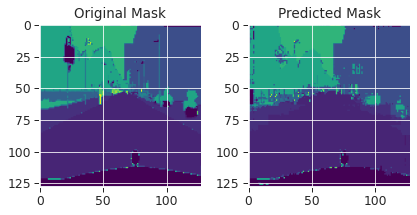

------------------------------------------------------------------------------------------------------------------------
| epoch 306 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22959  | train mIOU: 0.500 | train Dice Loss: -12.47584
------------------------------------------------------------------------------------------------------------------------
| end of epoch 306 | time: 39.85s | valid accuracy:    0.769 | valid loss: 1.23191 | valid mIOU: 0.195


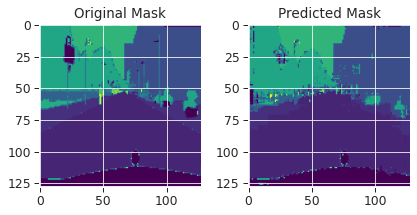

------------------------------------------------------------------------------------------------------------------------
| epoch 307 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25550  | train mIOU: 0.479 | train Dice Loss: -12.48672
------------------------------------------------------------------------------------------------------------------------
| end of epoch 307 | time: 40.19s | valid accuracy:    0.771 | valid loss: 1.22604 | valid mIOU: 0.195


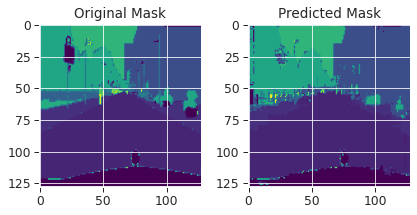

------------------------------------------------------------------------------------------------------------------------
| epoch 308 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25623  | train mIOU: 0.476 | train Dice Loss: -12.85581
------------------------------------------------------------------------------------------------------------------------
| end of epoch 308 | time: 40.26s | valid accuracy:    0.775 | valid loss: 1.22019 | valid mIOU: 0.197


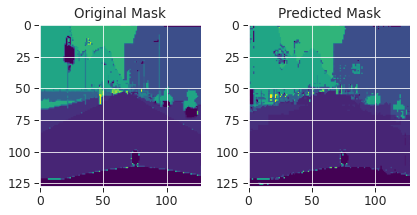

------------------------------------------------------------------------------------------------------------------------
| epoch 309 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23070  | train mIOU: 0.531 | train Dice Loss: -12.90512
------------------------------------------------------------------------------------------------------------------------
| end of epoch 309 | time: 40.40s | valid accuracy:    0.770 | valid loss: 1.24475 | valid mIOU: 0.194


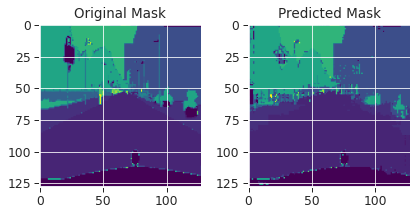

------------------------------------------------------------------------------------------------------------------------
| epoch 310 |   100/  185 batches | train accuracy    0.914 | train loss: 0.23814  | train mIOU: 0.481 | train Dice Loss: -13.82472
------------------------------------------------------------------------------------------------------------------------
| end of epoch 310 | time: 40.07s | valid accuracy:    0.771 | valid loss: 1.25546 | valid mIOU: 0.195


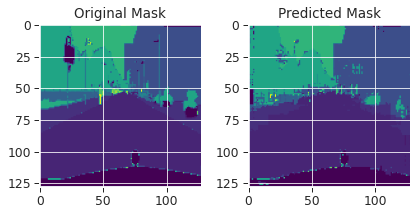

------------------------------------------------------------------------------------------------------------------------
| epoch 311 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22302  | train mIOU: 0.481 | train Dice Loss: -13.27337
------------------------------------------------------------------------------------------------------------------------
| end of epoch 311 | time: 40.34s | valid accuracy:    0.773 | valid loss: 1.23615 | valid mIOU: 0.196


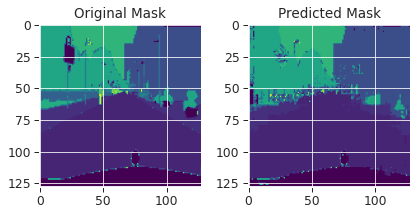

------------------------------------------------------------------------------------------------------------------------
| epoch 312 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22618  | train mIOU: 0.518 | train Dice Loss: -12.34789
------------------------------------------------------------------------------------------------------------------------
| end of epoch 312 | time: 39.68s | valid accuracy:    0.770 | valid loss: 1.22264 | valid mIOU: 0.196


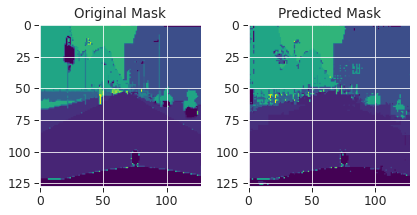

------------------------------------------------------------------------------------------------------------------------
| epoch 313 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24374  | train mIOU: 0.505 | train Dice Loss: -13.13929
------------------------------------------------------------------------------------------------------------------------
| end of epoch 313 | time: 41.22s | valid accuracy:    0.772 | valid loss: 1.24414 | valid mIOU: 0.195


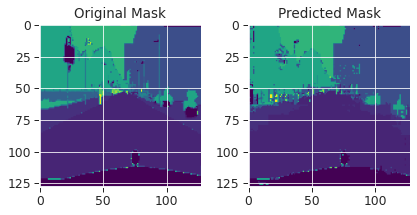

------------------------------------------------------------------------------------------------------------------------
| epoch 314 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24618  | train mIOU: 0.494 | train Dice Loss: -12.98395
------------------------------------------------------------------------------------------------------------------------
| end of epoch 314 | time: 40.05s | valid accuracy:    0.772 | valid loss: 1.26329 | valid mIOU: 0.196


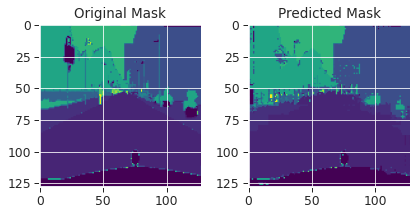

------------------------------------------------------------------------------------------------------------------------
| epoch 315 |   100/  185 batches | train accuracy    0.918 | train loss: 0.22641  | train mIOU: 0.496 | train Dice Loss: -12.74765
------------------------------------------------------------------------------------------------------------------------
| end of epoch 315 | time: 41.66s | valid accuracy:    0.771 | valid loss: 1.25399 | valid mIOU: 0.196


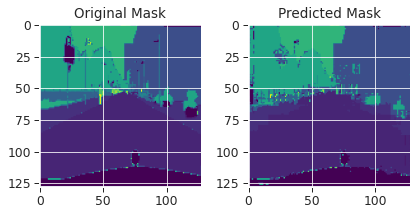

------------------------------------------------------------------------------------------------------------------------
| epoch 316 |   100/  185 batches | train accuracy    0.923 | train loss: 0.21440  | train mIOU: 0.486 | train Dice Loss: -13.14032
------------------------------------------------------------------------------------------------------------------------
| end of epoch 316 | time: 40.33s | valid accuracy:    0.776 | valid loss: 1.24815 | valid mIOU: 0.197


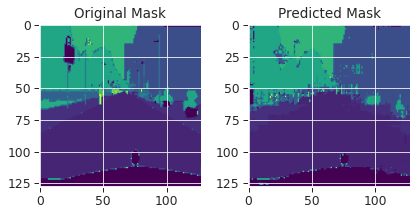

------------------------------------------------------------------------------------------------------------------------
| epoch 317 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21719  | train mIOU: 0.474 | train Dice Loss: -12.47847
------------------------------------------------------------------------------------------------------------------------
| end of epoch 317 | time: 40.04s | valid accuracy:    0.773 | valid loss: 1.22079 | valid mIOU: 0.196


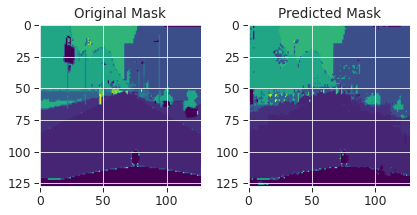

------------------------------------------------------------------------------------------------------------------------
| epoch 318 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24304  | train mIOU: 0.482 | train Dice Loss: -12.52199
------------------------------------------------------------------------------------------------------------------------
| end of epoch 318 | time: 40.66s | valid accuracy:    0.776 | valid loss: 1.23841 | valid mIOU: 0.197


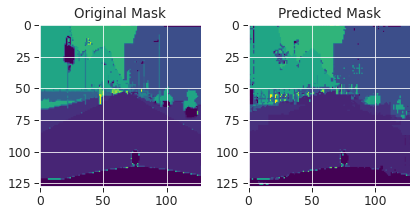

------------------------------------------------------------------------------------------------------------------------
| epoch 319 |   100/  185 batches | train accuracy    0.910 | train loss: 0.24936  | train mIOU: 0.509 | train Dice Loss: -13.17703
------------------------------------------------------------------------------------------------------------------------
| end of epoch 319 | time: 40.09s | valid accuracy:    0.772 | valid loss: 1.25394 | valid mIOU: 0.196


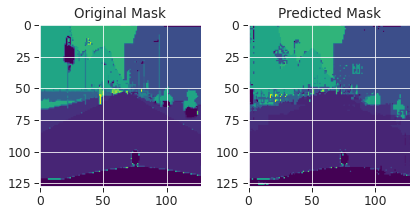

------------------------------------------------------------------------------------------------------------------------
| epoch 320 |   100/  185 batches | train accuracy    0.913 | train loss: 0.24392  | train mIOU: 0.479 | train Dice Loss: -12.21154
------------------------------------------------------------------------------------------------------------------------
| end of epoch 320 | time: 39.98s | valid accuracy:    0.773 | valid loss: 1.24169 | valid mIOU: 0.197


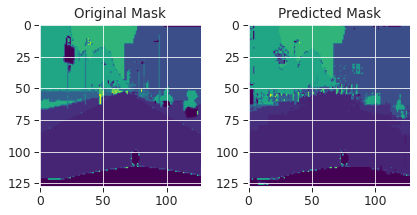

------------------------------------------------------------------------------------------------------------------------
| epoch 321 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23392  | train mIOU: 0.476 | train Dice Loss: -12.17340
------------------------------------------------------------------------------------------------------------------------
| end of epoch 321 | time: 41.30s | valid accuracy:    0.771 | valid loss: 1.23550 | valid mIOU: 0.194


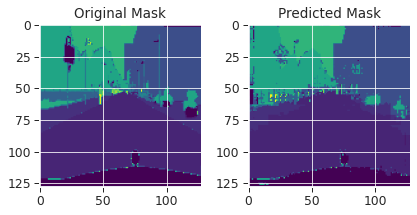

------------------------------------------------------------------------------------------------------------------------
| epoch 322 |   100/  185 batches | train accuracy    0.906 | train loss: 0.26099  | train mIOU: 0.517 | train Dice Loss: -13.07886
------------------------------------------------------------------------------------------------------------------------
| end of epoch 322 | time: 40.60s | valid accuracy:    0.772 | valid loss: 1.26727 | valid mIOU: 0.197


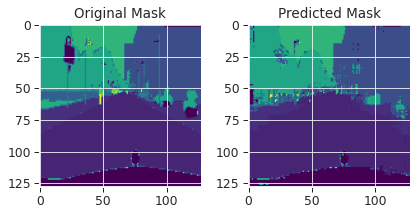

------------------------------------------------------------------------------------------------------------------------
| epoch 323 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22950  | train mIOU: 0.509 | train Dice Loss: -12.51666
------------------------------------------------------------------------------------------------------------------------
| end of epoch 323 | time: 42.07s | valid accuracy:    0.769 | valid loss: 1.26249 | valid mIOU: 0.193


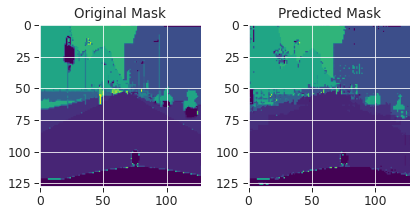

------------------------------------------------------------------------------------------------------------------------
| epoch 324 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21595  | train mIOU: 0.483 | train Dice Loss: -11.99073
------------------------------------------------------------------------------------------------------------------------
| end of epoch 324 | time: 41.09s | valid accuracy:    0.772 | valid loss: 1.24625 | valid mIOU: 0.197


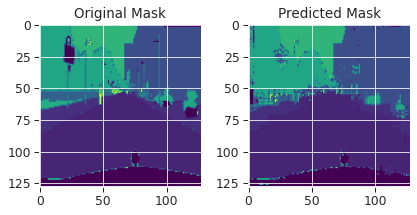

------------------------------------------------------------------------------------------------------------------------
| epoch 325 |   100/  185 batches | train accuracy    0.916 | train loss: 0.23148  | train mIOU: 0.541 | train Dice Loss: -13.72439
------------------------------------------------------------------------------------------------------------------------
| end of epoch 325 | time: 40.72s | valid accuracy:    0.769 | valid loss: 1.26718 | valid mIOU: 0.194


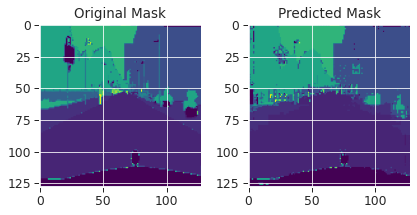

------------------------------------------------------------------------------------------------------------------------
| epoch 326 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24195  | train mIOU: 0.504 | train Dice Loss: -13.42515
------------------------------------------------------------------------------------------------------------------------
| end of epoch 326 | time: 40.40s | valid accuracy:    0.773 | valid loss: 1.23066 | valid mIOU: 0.199


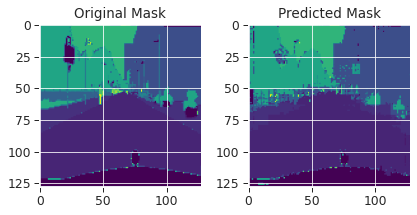

------------------------------------------------------------------------------------------------------------------------
| epoch 327 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23774  | train mIOU: 0.492 | train Dice Loss: -13.55142
------------------------------------------------------------------------------------------------------------------------
| end of epoch 327 | time: 40.80s | valid accuracy:    0.771 | valid loss: 1.27709 | valid mIOU: 0.195


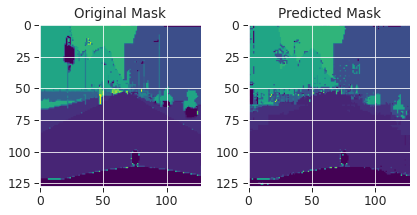

------------------------------------------------------------------------------------------------------------------------
| epoch 328 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22963  | train mIOU: 0.488 | train Dice Loss: -12.63830
------------------------------------------------------------------------------------------------------------------------
| end of epoch 328 | time: 40.78s | valid accuracy:    0.772 | valid loss: 1.26547 | valid mIOU: 0.197


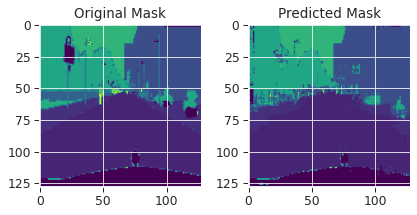

------------------------------------------------------------------------------------------------------------------------
| epoch 329 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24135  | train mIOU: 0.499 | train Dice Loss: -12.14157
------------------------------------------------------------------------------------------------------------------------
| end of epoch 329 | time: 40.37s | valid accuracy:    0.773 | valid loss: 1.24384 | valid mIOU: 0.195


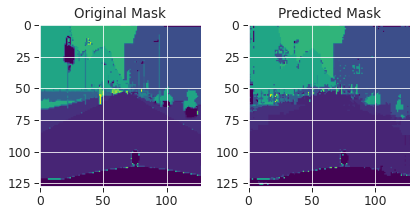

------------------------------------------------------------------------------------------------------------------------
| epoch 330 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23767  | train mIOU: 0.472 | train Dice Loss: -13.16382
------------------------------------------------------------------------------------------------------------------------
| end of epoch 330 | time: 39.40s | valid accuracy:    0.771 | valid loss: 1.25890 | valid mIOU: 0.195


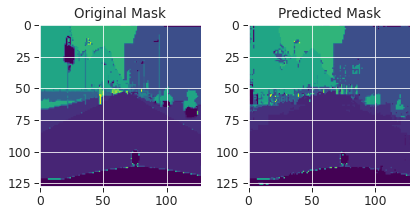

------------------------------------------------------------------------------------------------------------------------
| epoch 331 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24797  | train mIOU: 0.479 | train Dice Loss: -12.20456
------------------------------------------------------------------------------------------------------------------------
| end of epoch 331 | time: 41.76s | valid accuracy:    0.771 | valid loss: 1.26891 | valid mIOU: 0.195


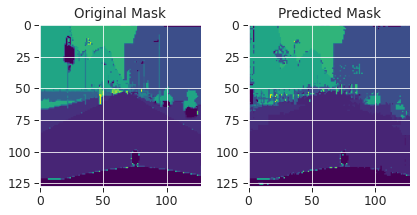

------------------------------------------------------------------------------------------------------------------------
| epoch 332 |   100/  185 batches | train accuracy    0.918 | train loss: 0.22353  | train mIOU: 0.509 | train Dice Loss: -11.70953
------------------------------------------------------------------------------------------------------------------------
| end of epoch 332 | time: 39.87s | valid accuracy:    0.775 | valid loss: 1.23202 | valid mIOU: 0.197


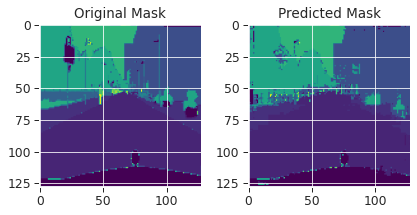

------------------------------------------------------------------------------------------------------------------------
| epoch 333 |   100/  185 batches | train accuracy    0.913 | train loss: 0.23661  | train mIOU: 0.454 | train Dice Loss: -12.86038
------------------------------------------------------------------------------------------------------------------------
| end of epoch 333 | time: 39.12s | valid accuracy:    0.771 | valid loss: 1.27580 | valid mIOU: 0.195


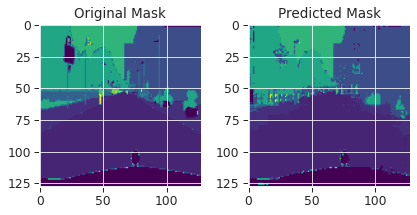

------------------------------------------------------------------------------------------------------------------------
| epoch 334 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21598  | train mIOU: 0.499 | train Dice Loss: -13.71618
------------------------------------------------------------------------------------------------------------------------
| end of epoch 334 | time: 40.27s | valid accuracy:    0.773 | valid loss: 1.25406 | valid mIOU: 0.197


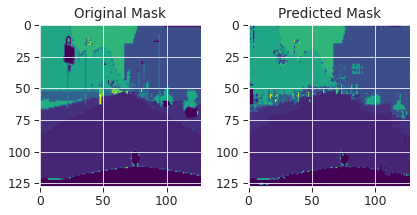

------------------------------------------------------------------------------------------------------------------------
| epoch 335 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25226  | train mIOU: 0.499 | train Dice Loss: -12.50867
------------------------------------------------------------------------------------------------------------------------
| end of epoch 335 | time: 39.85s | valid accuracy:    0.770 | valid loss: 1.27921 | valid mIOU: 0.193


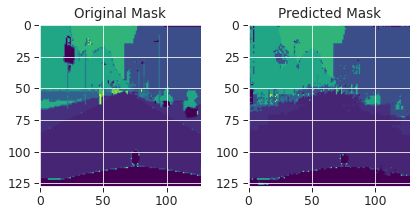

------------------------------------------------------------------------------------------------------------------------
| epoch 336 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21804  | train mIOU: 0.516 | train Dice Loss: -12.48598
------------------------------------------------------------------------------------------------------------------------
| end of epoch 336 | time: 40.95s | valid accuracy:    0.775 | valid loss: 1.26898 | valid mIOU: 0.197


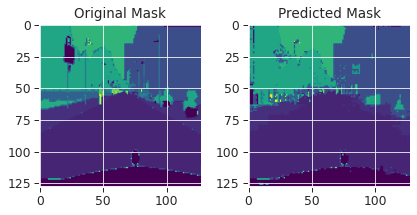

------------------------------------------------------------------------------------------------------------------------
| epoch 337 |   100/  185 batches | train accuracy    0.906 | train loss: 0.25395  | train mIOU: 0.535 | train Dice Loss: -12.14926
------------------------------------------------------------------------------------------------------------------------
| end of epoch 337 | time: 39.96s | valid accuracy:    0.772 | valid loss: 1.25752 | valid mIOU: 0.194


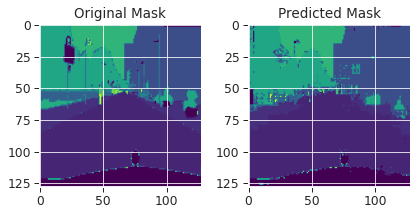

------------------------------------------------------------------------------------------------------------------------
| epoch 338 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23017  | train mIOU: 0.507 | train Dice Loss: -13.31817
------------------------------------------------------------------------------------------------------------------------
| end of epoch 338 | time: 39.97s | valid accuracy:    0.774 | valid loss: 1.27191 | valid mIOU: 0.196


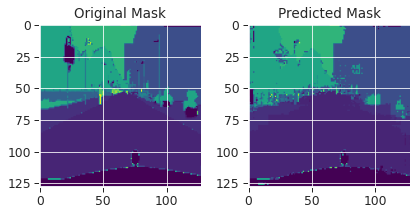

------------------------------------------------------------------------------------------------------------------------
| epoch 339 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21541  | train mIOU: 0.543 | train Dice Loss: -12.36925
------------------------------------------------------------------------------------------------------------------------
| end of epoch 339 | time: 40.73s | valid accuracy:    0.770 | valid loss: 1.28965 | valid mIOU: 0.193


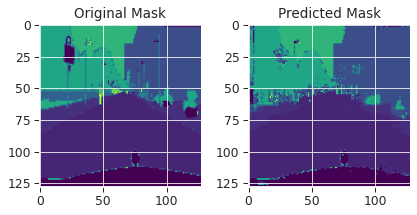

------------------------------------------------------------------------------------------------------------------------
| epoch 340 |   100/  185 batches | train accuracy    0.916 | train loss: 0.23625  | train mIOU: 0.459 | train Dice Loss: -12.79906
------------------------------------------------------------------------------------------------------------------------
| end of epoch 340 | time: 41.09s | valid accuracy:    0.771 | valid loss: 1.26265 | valid mIOU: 0.193


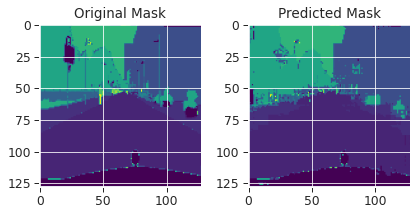

------------------------------------------------------------------------------------------------------------------------
| epoch 341 |   100/  185 batches | train accuracy    0.906 | train loss: 0.25947  | train mIOU: 0.535 | train Dice Loss: -12.83363
------------------------------------------------------------------------------------------------------------------------
| end of epoch 341 | time: 40.49s | valid accuracy:    0.772 | valid loss: 1.26234 | valid mIOU: 0.195


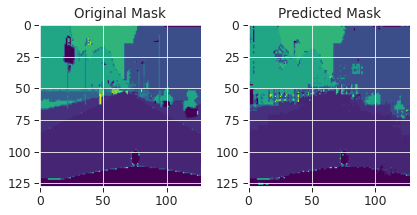

------------------------------------------------------------------------------------------------------------------------
| epoch 342 |   100/  185 batches | train accuracy    0.917 | train loss: 0.23175  | train mIOU: 0.473 | train Dice Loss: -12.64111
------------------------------------------------------------------------------------------------------------------------
| end of epoch 342 | time: 40.84s | valid accuracy:    0.769 | valid loss: 1.27202 | valid mIOU: 0.194


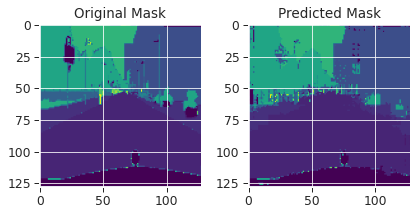

------------------------------------------------------------------------------------------------------------------------
| epoch 343 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21809  | train mIOU: 0.554 | train Dice Loss: -12.95700
------------------------------------------------------------------------------------------------------------------------
| end of epoch 343 | time: 39.54s | valid accuracy:    0.774 | valid loss: 1.29599 | valid mIOU: 0.196


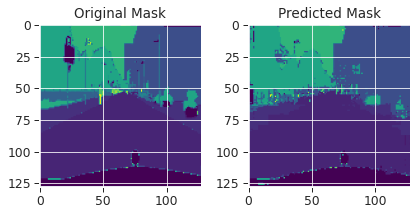

------------------------------------------------------------------------------------------------------------------------
| epoch 344 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23762  | train mIOU: 0.473 | train Dice Loss: -11.76248
------------------------------------------------------------------------------------------------------------------------
| end of epoch 344 | time: 40.30s | valid accuracy:    0.774 | valid loss: 1.24985 | valid mIOU: 0.197


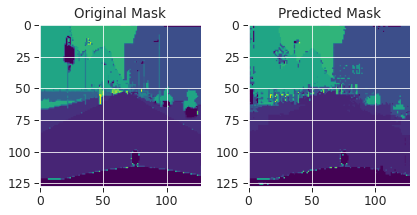

------------------------------------------------------------------------------------------------------------------------
| epoch 345 |   100/  185 batches | train accuracy    0.924 | train loss: 0.21102  | train mIOU: 0.497 | train Dice Loss: -12.45017
------------------------------------------------------------------------------------------------------------------------
| end of epoch 345 | time: 40.08s | valid accuracy:    0.774 | valid loss: 1.25968 | valid mIOU: 0.195


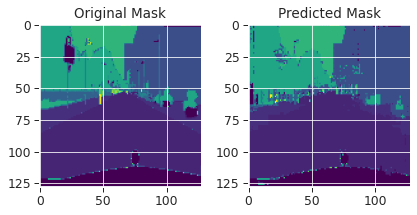

------------------------------------------------------------------------------------------------------------------------
| epoch 346 |   100/  185 batches | train accuracy    0.910 | train loss: 0.24816  | train mIOU: 0.498 | train Dice Loss: -12.14370
------------------------------------------------------------------------------------------------------------------------
| end of epoch 346 | time: 40.91s | valid accuracy:    0.771 | valid loss: 1.27968 | valid mIOU: 0.195


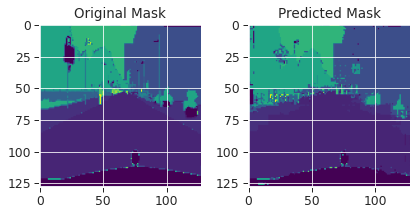

------------------------------------------------------------------------------------------------------------------------
| epoch 347 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22698  | train mIOU: 0.478 | train Dice Loss: -13.11121
------------------------------------------------------------------------------------------------------------------------
| end of epoch 347 | time: 40.40s | valid accuracy:    0.772 | valid loss: 1.27942 | valid mIOU: 0.196


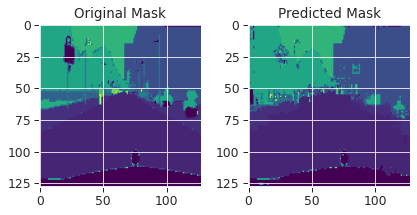

------------------------------------------------------------------------------------------------------------------------
| epoch 348 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21628  | train mIOU: 0.429 | train Dice Loss: -12.27894
------------------------------------------------------------------------------------------------------------------------
| end of epoch 348 | time: 40.28s | valid accuracy:    0.772 | valid loss: 1.28323 | valid mIOU: 0.195


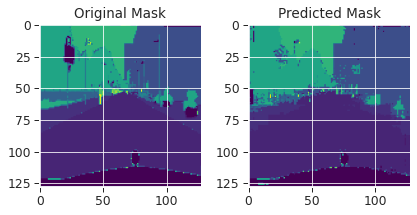

------------------------------------------------------------------------------------------------------------------------
| epoch 349 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21908  | train mIOU: 0.541 | train Dice Loss: -13.43549
------------------------------------------------------------------------------------------------------------------------
| end of epoch 349 | time: 40.90s | valid accuracy:    0.772 | valid loss: 1.25737 | valid mIOU: 0.196


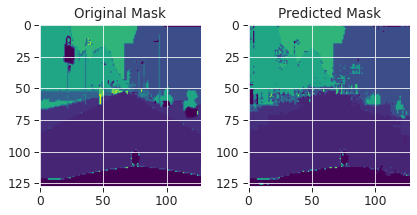

------------------------------------------------------------------------------------------------------------------------
| epoch 350 |   100/  185 batches | train accuracy    0.918 | train loss: 0.22718  | train mIOU: 0.494 | train Dice Loss: -13.18151
------------------------------------------------------------------------------------------------------------------------
| end of epoch 350 | time: 39.57s | valid accuracy:    0.770 | valid loss: 1.30256 | valid mIOU: 0.194


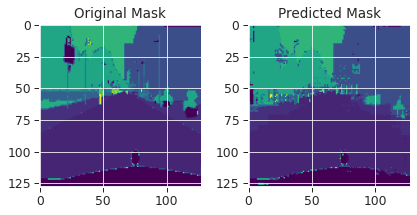

------------------------------------------------------------------------------------------------------------------------
| epoch 351 |   100/  185 batches | train accuracy    0.914 | train loss: 0.23457  | train mIOU: 0.481 | train Dice Loss: -12.78943
------------------------------------------------------------------------------------------------------------------------
| end of epoch 351 | time: 40.84s | valid accuracy:    0.774 | valid loss: 1.27765 | valid mIOU: 0.197


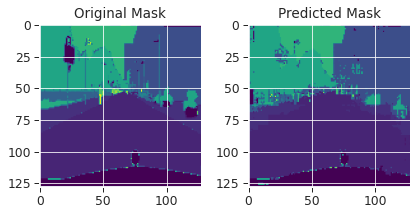

------------------------------------------------------------------------------------------------------------------------
| epoch 352 |   100/  185 batches | train accuracy    0.914 | train loss: 0.23755  | train mIOU: 0.518 | train Dice Loss: -12.31767
------------------------------------------------------------------------------------------------------------------------
| end of epoch 352 | time: 40.67s | valid accuracy:    0.771 | valid loss: 1.29171 | valid mIOU: 0.194


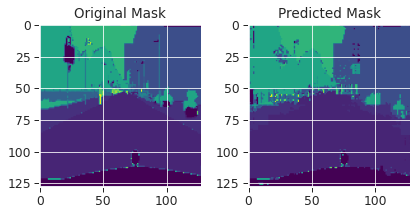

------------------------------------------------------------------------------------------------------------------------
| epoch 353 |   100/  185 batches | train accuracy    0.913 | train loss: 0.23848  | train mIOU: 0.507 | train Dice Loss: -12.61305
------------------------------------------------------------------------------------------------------------------------
| end of epoch 353 | time: 41.02s | valid accuracy:    0.771 | valid loss: 1.28604 | valid mIOU: 0.196


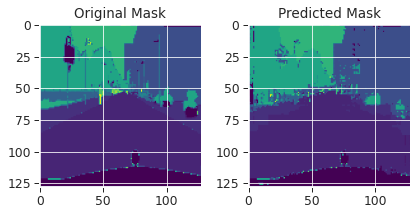

------------------------------------------------------------------------------------------------------------------------
| epoch 354 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19854  | train mIOU: 0.520 | train Dice Loss: -12.32798
------------------------------------------------------------------------------------------------------------------------
| end of epoch 354 | time: 41.39s | valid accuracy:    0.770 | valid loss: 1.30126 | valid mIOU: 0.194


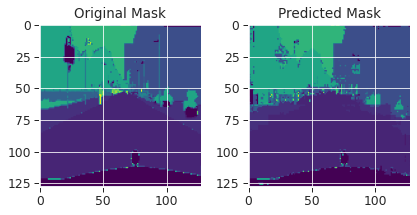

------------------------------------------------------------------------------------------------------------------------
| epoch 355 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21709  | train mIOU: 0.521 | train Dice Loss: -13.06679
------------------------------------------------------------------------------------------------------------------------
| end of epoch 355 | time: 40.81s | valid accuracy:    0.773 | valid loss: 1.28500 | valid mIOU: 0.195


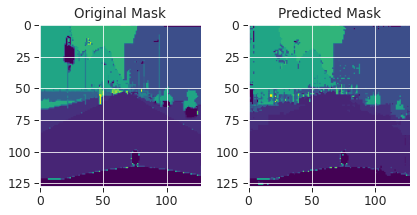

------------------------------------------------------------------------------------------------------------------------
| epoch 356 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21586  | train mIOU: 0.539 | train Dice Loss: -12.49348
------------------------------------------------------------------------------------------------------------------------
| end of epoch 356 | time: 40.88s | valid accuracy:    0.773 | valid loss: 1.30313 | valid mIOU: 0.196


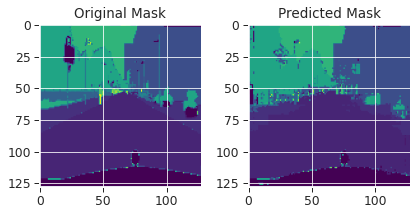

------------------------------------------------------------------------------------------------------------------------
| epoch 357 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21656  | train mIOU: 0.473 | train Dice Loss: -12.28319
------------------------------------------------------------------------------------------------------------------------
| end of epoch 357 | time: 40.89s | valid accuracy:    0.772 | valid loss: 1.31346 | valid mIOU: 0.195


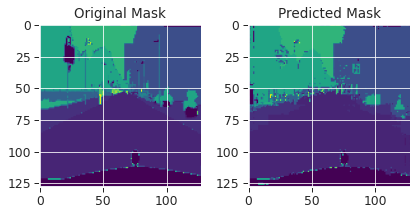

------------------------------------------------------------------------------------------------------------------------
| epoch 358 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23291  | train mIOU: 0.472 | train Dice Loss: -12.81784
------------------------------------------------------------------------------------------------------------------------
| end of epoch 358 | time: 40.96s | valid accuracy:    0.770 | valid loss: 1.29695 | valid mIOU: 0.194


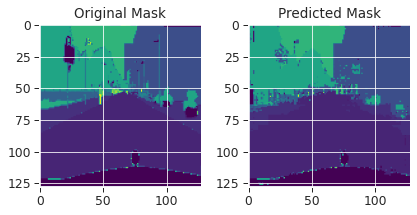

------------------------------------------------------------------------------------------------------------------------
| epoch 359 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23574  | train mIOU: 0.505 | train Dice Loss: -13.53296
------------------------------------------------------------------------------------------------------------------------
| end of epoch 359 | time: 40.54s | valid accuracy:    0.772 | valid loss: 1.30674 | valid mIOU: 0.194


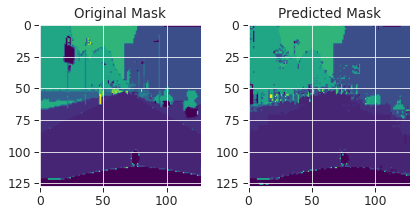

------------------------------------------------------------------------------------------------------------------------
| epoch 360 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22859  | train mIOU: 0.525 | train Dice Loss: -12.73181
------------------------------------------------------------------------------------------------------------------------
| end of epoch 360 | time: 40.53s | valid accuracy:    0.771 | valid loss: 1.30658 | valid mIOU: 0.195


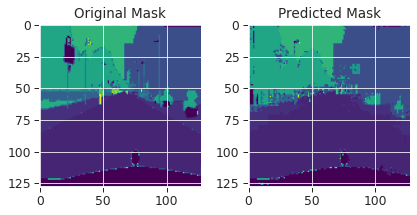

------------------------------------------------------------------------------------------------------------------------
| epoch 361 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23441  | train mIOU: 0.487 | train Dice Loss: -12.63088
------------------------------------------------------------------------------------------------------------------------
| end of epoch 361 | time: 40.29s | valid accuracy:    0.770 | valid loss: 1.28813 | valid mIOU: 0.195


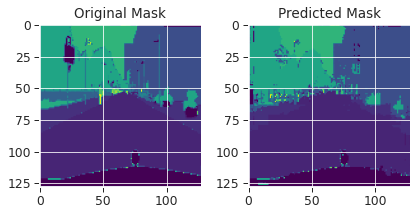

------------------------------------------------------------------------------------------------------------------------
| epoch 362 |   100/  185 batches | train accuracy    0.923 | train loss: 0.21112  | train mIOU: 0.550 | train Dice Loss: -12.90828
------------------------------------------------------------------------------------------------------------------------
| end of epoch 362 | time: 41.24s | valid accuracy:    0.773 | valid loss: 1.27502 | valid mIOU: 0.199


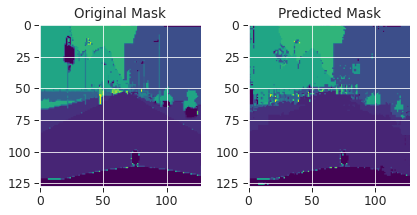

------------------------------------------------------------------------------------------------------------------------
| epoch 363 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21870  | train mIOU: 0.514 | train Dice Loss: -12.62423
------------------------------------------------------------------------------------------------------------------------
| end of epoch 363 | time: 41.83s | valid accuracy:    0.771 | valid loss: 1.30641 | valid mIOU: 0.194


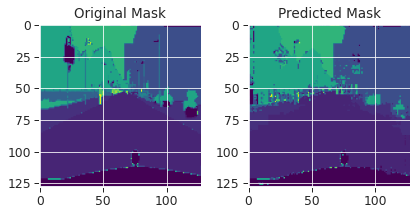

------------------------------------------------------------------------------------------------------------------------
| epoch 364 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24070  | train mIOU: 0.496 | train Dice Loss: -13.24069
------------------------------------------------------------------------------------------------------------------------
| end of epoch 364 | time: 40.83s | valid accuracy:    0.771 | valid loss: 1.31013 | valid mIOU: 0.194


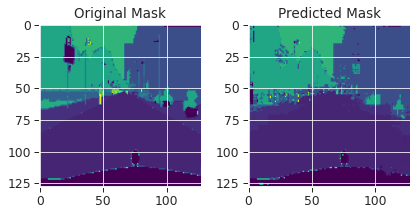

------------------------------------------------------------------------------------------------------------------------
| epoch 365 |   100/  185 batches | train accuracy    0.912 | train loss: 0.23840  | train mIOU: 0.488 | train Dice Loss: -12.16991
------------------------------------------------------------------------------------------------------------------------
| end of epoch 365 | time: 39.80s | valid accuracy:    0.767 | valid loss: 1.31775 | valid mIOU: 0.195


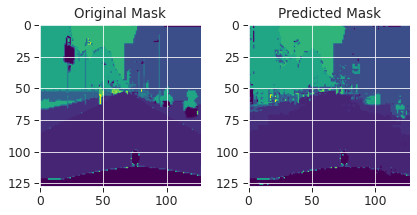

------------------------------------------------------------------------------------------------------------------------
| epoch 366 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24304  | train mIOU: 0.520 | train Dice Loss: -12.94099
------------------------------------------------------------------------------------------------------------------------
| end of epoch 366 | time: 41.08s | valid accuracy:    0.773 | valid loss: 1.31902 | valid mIOU: 0.196


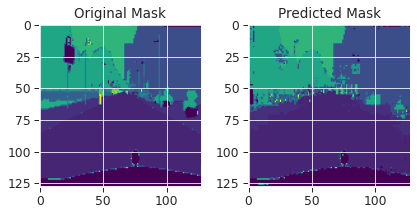

------------------------------------------------------------------------------------------------------------------------
| epoch 367 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24252  | train mIOU: 0.524 | train Dice Loss: -13.69354
------------------------------------------------------------------------------------------------------------------------
| end of epoch 367 | time: 39.73s | valid accuracy:    0.773 | valid loss: 1.30133 | valid mIOU: 0.196


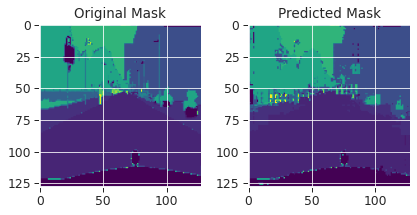

------------------------------------------------------------------------------------------------------------------------
| epoch 368 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20976  | train mIOU: 0.490 | train Dice Loss: -13.27831
------------------------------------------------------------------------------------------------------------------------
| end of epoch 368 | time: 40.81s | valid accuracy:    0.773 | valid loss: 1.30907 | valid mIOU: 0.196


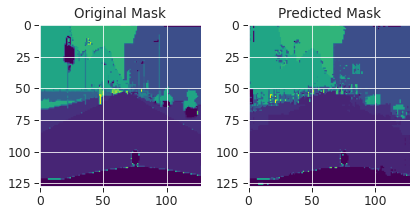

------------------------------------------------------------------------------------------------------------------------
| epoch 369 |   100/  185 batches | train accuracy    0.914 | train loss: 0.23792  | train mIOU: 0.524 | train Dice Loss: -13.25438
------------------------------------------------------------------------------------------------------------------------
| end of epoch 369 | time: 40.14s | valid accuracy:    0.771 | valid loss: 1.30929 | valid mIOU: 0.195


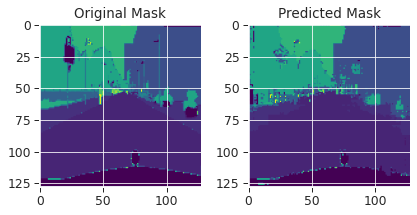

------------------------------------------------------------------------------------------------------------------------
| epoch 370 |   100/  185 batches | train accuracy    0.920 | train loss: 0.22040  | train mIOU: 0.557 | train Dice Loss: -13.41469
------------------------------------------------------------------------------------------------------------------------
| end of epoch 370 | time: 40.87s | valid accuracy:    0.771 | valid loss: 1.33672 | valid mIOU: 0.194


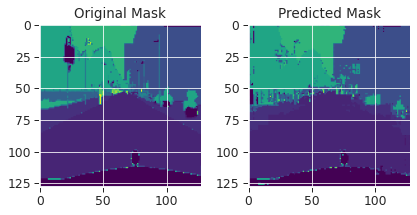

------------------------------------------------------------------------------------------------------------------------
| epoch 371 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25068  | train mIOU: 0.518 | train Dice Loss: -12.81096
------------------------------------------------------------------------------------------------------------------------
| end of epoch 371 | time: 39.63s | valid accuracy:    0.770 | valid loss: 1.28900 | valid mIOU: 0.194


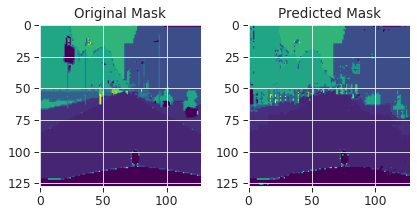

------------------------------------------------------------------------------------------------------------------------
| epoch 372 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22156  | train mIOU: 0.533 | train Dice Loss: -12.96778
------------------------------------------------------------------------------------------------------------------------
| end of epoch 372 | time: 41.40s | valid accuracy:    0.769 | valid loss: 1.32571 | valid mIOU: 0.193


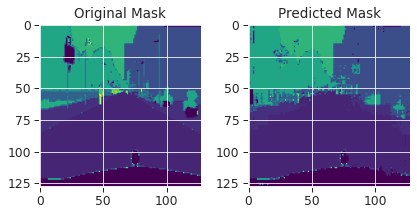

------------------------------------------------------------------------------------------------------------------------
| epoch 373 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24584  | train mIOU: 0.526 | train Dice Loss: -12.85840
------------------------------------------------------------------------------------------------------------------------
| end of epoch 373 | time: 41.79s | valid accuracy:    0.773 | valid loss: 1.30720 | valid mIOU: 0.196


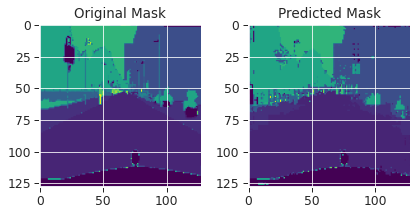

------------------------------------------------------------------------------------------------------------------------
| epoch 374 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19859  | train mIOU: 0.527 | train Dice Loss: -12.38920
------------------------------------------------------------------------------------------------------------------------
| end of epoch 374 | time: 41.39s | valid accuracy:    0.772 | valid loss: 1.31840 | valid mIOU: 0.196


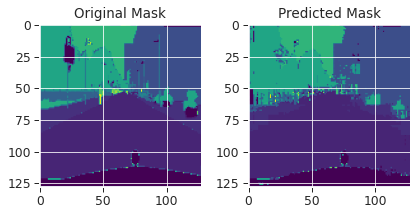

------------------------------------------------------------------------------------------------------------------------
| epoch 375 |   100/  185 batches | train accuracy    0.916 | train loss: 0.23411  | train mIOU: 0.507 | train Dice Loss: -12.56076
------------------------------------------------------------------------------------------------------------------------
| end of epoch 375 | time: 41.85s | valid accuracy:    0.773 | valid loss: 1.32643 | valid mIOU: 0.195


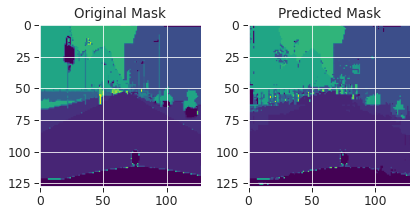

------------------------------------------------------------------------------------------------------------------------
| epoch 376 |   100/  185 batches | train accuracy    0.926 | train loss: 0.19709  | train mIOU: 0.486 | train Dice Loss: -13.16236
------------------------------------------------------------------------------------------------------------------------
| end of epoch 376 | time: 40.73s | valid accuracy:    0.772 | valid loss: 1.32014 | valid mIOU: 0.195


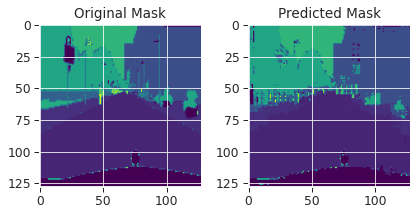

------------------------------------------------------------------------------------------------------------------------
| epoch 377 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20921  | train mIOU: 0.523 | train Dice Loss: -12.77143
------------------------------------------------------------------------------------------------------------------------
| end of epoch 377 | time: 41.00s | valid accuracy:    0.770 | valid loss: 1.33099 | valid mIOU: 0.195


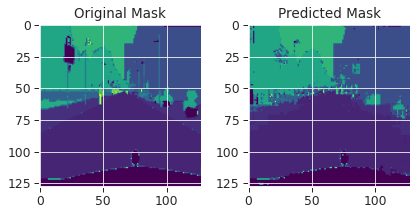

------------------------------------------------------------------------------------------------------------------------
| epoch 378 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21356  | train mIOU: 0.505 | train Dice Loss: -13.38005
------------------------------------------------------------------------------------------------------------------------
| end of epoch 378 | time: 41.18s | valid accuracy:    0.772 | valid loss: 1.30896 | valid mIOU: 0.196


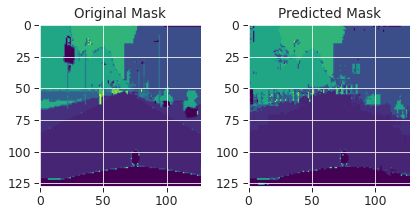

------------------------------------------------------------------------------------------------------------------------
| epoch 379 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22061  | train mIOU: 0.521 | train Dice Loss: -13.49602
------------------------------------------------------------------------------------------------------------------------
| end of epoch 379 | time: 42.00s | valid accuracy:    0.771 | valid loss: 1.34025 | valid mIOU: 0.195


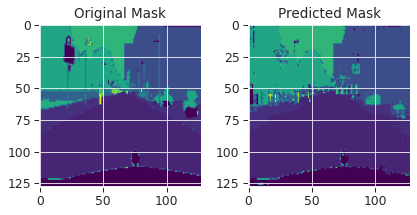

------------------------------------------------------------------------------------------------------------------------
| epoch 380 |   100/  185 batches | train accuracy    0.913 | train loss: 0.23761  | train mIOU: 0.543 | train Dice Loss: -12.84475
------------------------------------------------------------------------------------------------------------------------
| end of epoch 380 | time: 41.32s | valid accuracy:    0.771 | valid loss: 1.30591 | valid mIOU: 0.196


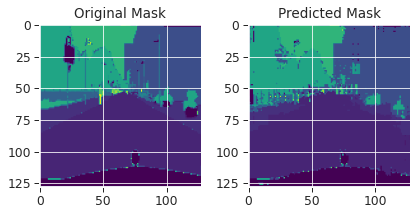

------------------------------------------------------------------------------------------------------------------------
| epoch 381 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22712  | train mIOU: 0.512 | train Dice Loss: -14.30342
------------------------------------------------------------------------------------------------------------------------
| end of epoch 381 | time: 41.37s | valid accuracy:    0.771 | valid loss: 1.33060 | valid mIOU: 0.196


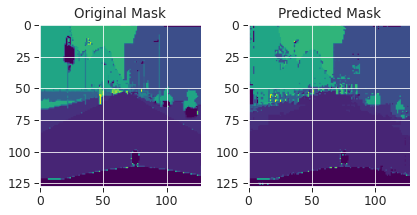

------------------------------------------------------------------------------------------------------------------------
| epoch 382 |   100/  185 batches | train accuracy    0.918 | train loss: 0.23057  | train mIOU: 0.517 | train Dice Loss: -13.58839
------------------------------------------------------------------------------------------------------------------------
| end of epoch 382 | time: 41.13s | valid accuracy:    0.772 | valid loss: 1.32713 | valid mIOU: 0.196


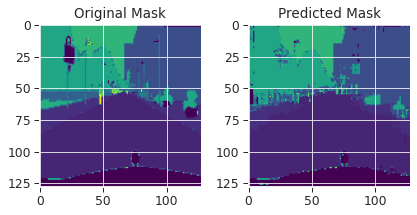

------------------------------------------------------------------------------------------------------------------------
| epoch 383 |   100/  185 batches | train accuracy    0.919 | train loss: 0.21521  | train mIOU: 0.538 | train Dice Loss: -13.15083
------------------------------------------------------------------------------------------------------------------------
| end of epoch 383 | time: 40.76s | valid accuracy:    0.772 | valid loss: 1.32028 | valid mIOU: 0.197


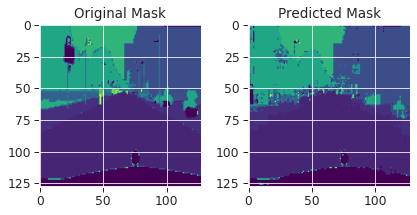

------------------------------------------------------------------------------------------------------------------------
| epoch 384 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22360  | train mIOU: 0.512 | train Dice Loss: -12.98054
------------------------------------------------------------------------------------------------------------------------
| end of epoch 384 | time: 41.31s | valid accuracy:    0.774 | valid loss: 1.34589 | valid mIOU: 0.197


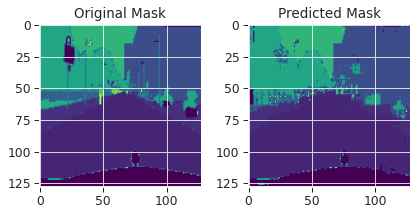

------------------------------------------------------------------------------------------------------------------------
| epoch 385 |   100/  185 batches | train accuracy    0.910 | train loss: 0.24431  | train mIOU: 0.519 | train Dice Loss: -12.20394
------------------------------------------------------------------------------------------------------------------------
| end of epoch 385 | time: 40.03s | valid accuracy:    0.772 | valid loss: 1.33961 | valid mIOU: 0.196


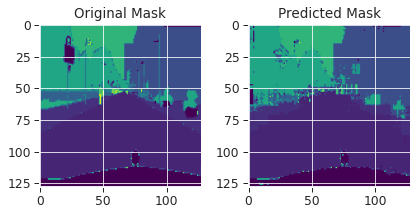

------------------------------------------------------------------------------------------------------------------------
| epoch 386 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20293  | train mIOU: 0.519 | train Dice Loss: -13.55661
------------------------------------------------------------------------------------------------------------------------
| end of epoch 386 | time: 41.32s | valid accuracy:    0.770 | valid loss: 1.32403 | valid mIOU: 0.196


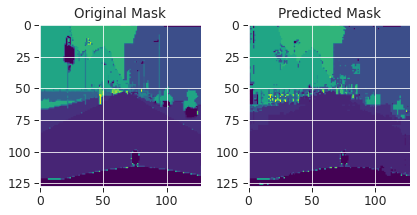

------------------------------------------------------------------------------------------------------------------------
| epoch 387 |   100/  185 batches | train accuracy    0.916 | train loss: 0.22429  | train mIOU: 0.517 | train Dice Loss: -13.05708
------------------------------------------------------------------------------------------------------------------------
| end of epoch 387 | time: 39.81s | valid accuracy:    0.768 | valid loss: 1.31938 | valid mIOU: 0.194


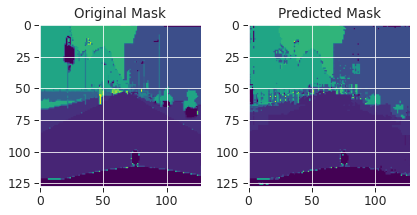

------------------------------------------------------------------------------------------------------------------------
| epoch 388 |   100/  185 batches | train accuracy    0.909 | train loss: 0.24539  | train mIOU: 0.537 | train Dice Loss: -12.68230
------------------------------------------------------------------------------------------------------------------------
| end of epoch 388 | time: 40.97s | valid accuracy:    0.771 | valid loss: 1.34523 | valid mIOU: 0.195


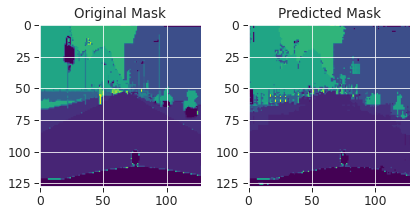

------------------------------------------------------------------------------------------------------------------------
| epoch 389 |   100/  185 batches | train accuracy    0.923 | train loss: 0.21158  | train mIOU: 0.516 | train Dice Loss: -12.96959
------------------------------------------------------------------------------------------------------------------------
| end of epoch 389 | time: 40.72s | valid accuracy:    0.769 | valid loss: 1.32432 | valid mIOU: 0.195


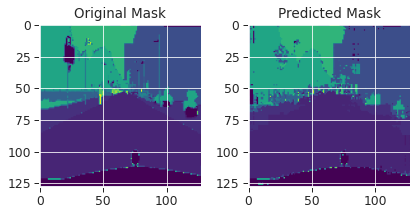

------------------------------------------------------------------------------------------------------------------------
| epoch 390 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19412  | train mIOU: 0.517 | train Dice Loss: -12.85175
------------------------------------------------------------------------------------------------------------------------
| end of epoch 390 | time: 41.65s | valid accuracy:    0.773 | valid loss: 1.33313 | valid mIOU: 0.197


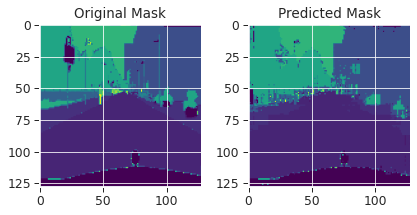

------------------------------------------------------------------------------------------------------------------------
| epoch 391 |   100/  185 batches | train accuracy    0.931 | train loss: 0.19214  | train mIOU: 0.540 | train Dice Loss: -12.48388
------------------------------------------------------------------------------------------------------------------------
| end of epoch 391 | time: 40.92s | valid accuracy:    0.773 | valid loss: 1.31755 | valid mIOU: 0.197


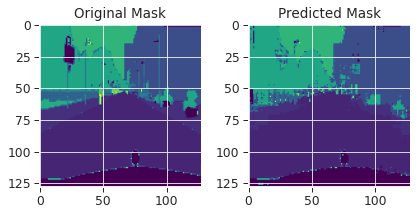

------------------------------------------------------------------------------------------------------------------------
| epoch 392 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21303  | train mIOU: 0.549 | train Dice Loss: -12.76150
------------------------------------------------------------------------------------------------------------------------
| end of epoch 392 | time: 40.47s | valid accuracy:    0.772 | valid loss: 1.33537 | valid mIOU: 0.195


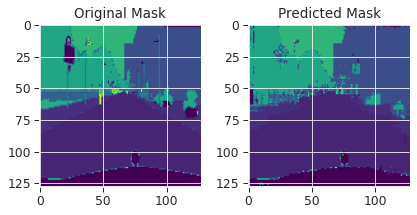

------------------------------------------------------------------------------------------------------------------------
| epoch 393 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19944  | train mIOU: 0.523 | train Dice Loss: -12.54044
------------------------------------------------------------------------------------------------------------------------
| end of epoch 393 | time: 40.38s | valid accuracy:    0.773 | valid loss: 1.33945 | valid mIOU: 0.196


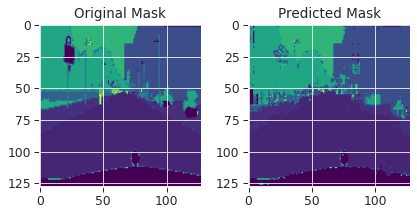

------------------------------------------------------------------------------------------------------------------------
| epoch 394 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21394  | train mIOU: 0.533 | train Dice Loss: -13.16233
------------------------------------------------------------------------------------------------------------------------
| end of epoch 394 | time: 41.76s | valid accuracy:    0.770 | valid loss: 1.34222 | valid mIOU: 0.195


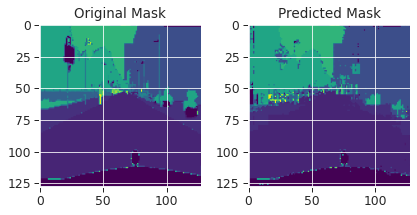

------------------------------------------------------------------------------------------------------------------------
| epoch 395 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20930  | train mIOU: 0.535 | train Dice Loss: -12.05348
------------------------------------------------------------------------------------------------------------------------
| end of epoch 395 | time: 40.37s | valid accuracy:    0.772 | valid loss: 1.32051 | valid mIOU: 0.197


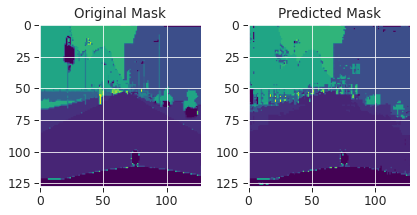

------------------------------------------------------------------------------------------------------------------------
| epoch 396 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21259  | train mIOU: 0.489 | train Dice Loss: -12.92092
------------------------------------------------------------------------------------------------------------------------
| end of epoch 396 | time: 40.53s | valid accuracy:    0.769 | valid loss: 1.34517 | valid mIOU: 0.194


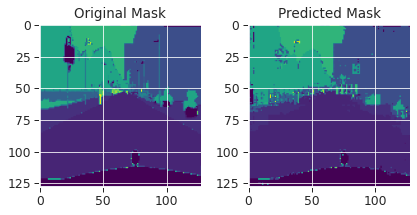

------------------------------------------------------------------------------------------------------------------------
| epoch 397 |   100/  185 batches | train accuracy    0.929 | train loss: 0.19363  | train mIOU: 0.494 | train Dice Loss: -12.90970
------------------------------------------------------------------------------------------------------------------------
| end of epoch 397 | time: 40.89s | valid accuracy:    0.772 | valid loss: 1.32970 | valid mIOU: 0.195


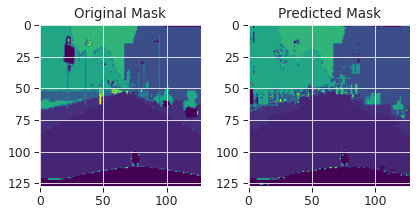

------------------------------------------------------------------------------------------------------------------------
| epoch 398 |   100/  185 batches | train accuracy    0.908 | train loss: 0.25633  | train mIOU: 0.545 | train Dice Loss: -13.17940
------------------------------------------------------------------------------------------------------------------------
| end of epoch 398 | time: 42.58s | valid accuracy:    0.770 | valid loss: 1.32594 | valid mIOU: 0.196


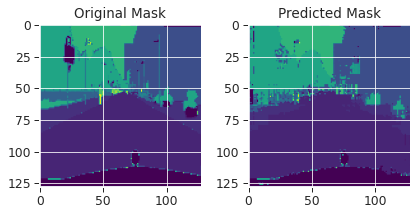

------------------------------------------------------------------------------------------------------------------------
| epoch 399 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20351  | train mIOU: 0.525 | train Dice Loss: -12.81697
------------------------------------------------------------------------------------------------------------------------
| end of epoch 399 | time: 40.90s | valid accuracy:    0.772 | valid loss: 1.32632 | valid mIOU: 0.196


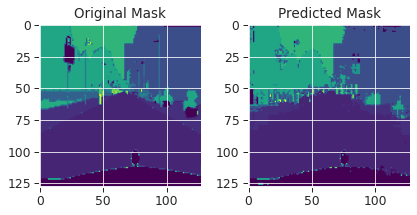

------------------------------------------------------------------------------------------------------------------------
| epoch 400 |   100/  185 batches | train accuracy    0.910 | train loss: 0.24872  | train mIOU: 0.543 | train Dice Loss: -12.49672
------------------------------------------------------------------------------------------------------------------------
| end of epoch 400 | time: 40.85s | valid accuracy:    0.772 | valid loss: 1.33101 | valid mIOU: 0.196


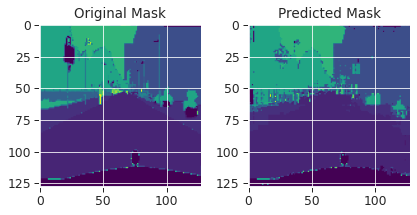

------------------------------------------------------------------------------------------------------------------------
| epoch 401 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19606  | train mIOU: 0.539 | train Dice Loss: -11.54517
------------------------------------------------------------------------------------------------------------------------
| end of epoch 401 | time: 41.11s | valid accuracy:    0.773 | valid loss: 1.34815 | valid mIOU: 0.196


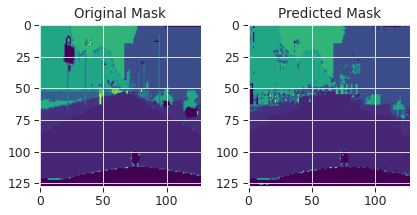

------------------------------------------------------------------------------------------------------------------------
| epoch 402 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19328  | train mIOU: 0.541 | train Dice Loss: -14.07608
------------------------------------------------------------------------------------------------------------------------
| end of epoch 402 | time: 40.96s | valid accuracy:    0.770 | valid loss: 1.34718 | valid mIOU: 0.196


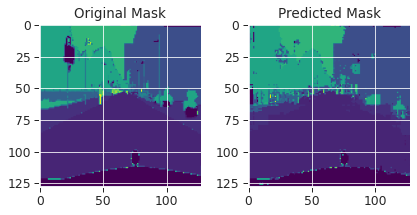

------------------------------------------------------------------------------------------------------------------------
| epoch 403 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20223  | train mIOU: 0.494 | train Dice Loss: -12.37666
------------------------------------------------------------------------------------------------------------------------
| end of epoch 403 | time: 40.70s | valid accuracy:    0.771 | valid loss: 1.32680 | valid mIOU: 0.196


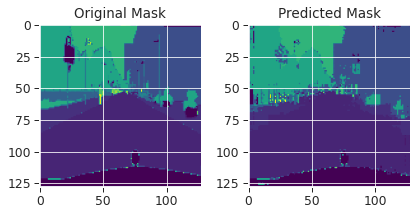

------------------------------------------------------------------------------------------------------------------------
| epoch 404 |   100/  185 batches | train accuracy    0.915 | train loss: 0.22764  | train mIOU: 0.549 | train Dice Loss: -13.56274
------------------------------------------------------------------------------------------------------------------------
| end of epoch 404 | time: 40.24s | valid accuracy:    0.771 | valid loss: 1.34405 | valid mIOU: 0.198


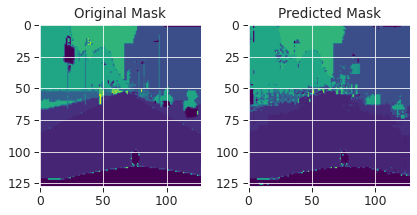

------------------------------------------------------------------------------------------------------------------------
| epoch 405 |   100/  185 batches | train accuracy    0.916 | train loss: 0.22779  | train mIOU: 0.526 | train Dice Loss: -13.23608
------------------------------------------------------------------------------------------------------------------------
| end of epoch 405 | time: 40.52s | valid accuracy:    0.774 | valid loss: 1.36045 | valid mIOU: 0.197


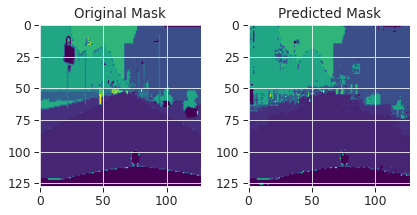

------------------------------------------------------------------------------------------------------------------------
| epoch 406 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22348  | train mIOU: 0.529 | train Dice Loss: -13.01101
------------------------------------------------------------------------------------------------------------------------
| end of epoch 406 | time: 40.86s | valid accuracy:    0.773 | valid loss: 1.35724 | valid mIOU: 0.197


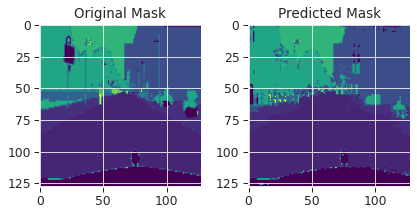

------------------------------------------------------------------------------------------------------------------------
| epoch 407 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20517  | train mIOU: 0.507 | train Dice Loss: -12.97606
------------------------------------------------------------------------------------------------------------------------
| end of epoch 407 | time: 41.78s | valid accuracy:    0.768 | valid loss: 1.34105 | valid mIOU: 0.195


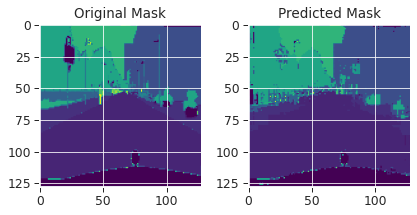

------------------------------------------------------------------------------------------------------------------------
| epoch 408 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20500  | train mIOU: 0.562 | train Dice Loss: -13.14677
------------------------------------------------------------------------------------------------------------------------
| end of epoch 408 | time: 42.54s | valid accuracy:    0.771 | valid loss: 1.35114 | valid mIOU: 0.196


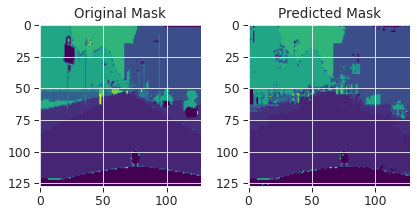

------------------------------------------------------------------------------------------------------------------------
| epoch 409 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21010  | train mIOU: 0.494 | train Dice Loss: -13.23329
------------------------------------------------------------------------------------------------------------------------
| end of epoch 409 | time: 41.49s | valid accuracy:    0.773 | valid loss: 1.35613 | valid mIOU: 0.195


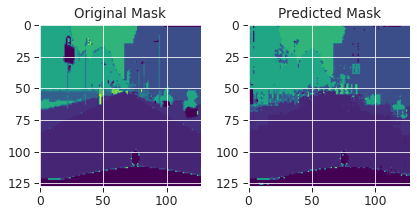

------------------------------------------------------------------------------------------------------------------------
| epoch 410 |   100/  185 batches | train accuracy    0.919 | train loss: 0.21773  | train mIOU: 0.546 | train Dice Loss: -12.54914
------------------------------------------------------------------------------------------------------------------------
| end of epoch 410 | time: 39.71s | valid accuracy:    0.770 | valid loss: 1.35081 | valid mIOU: 0.196


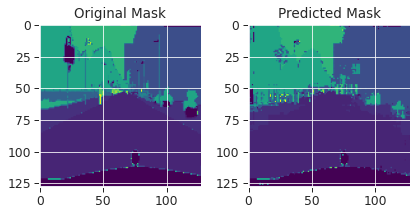

------------------------------------------------------------------------------------------------------------------------
| epoch 411 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22293  | train mIOU: 0.511 | train Dice Loss: -12.82627
------------------------------------------------------------------------------------------------------------------------
| end of epoch 411 | time: 41.79s | valid accuracy:    0.772 | valid loss: 1.34041 | valid mIOU: 0.195


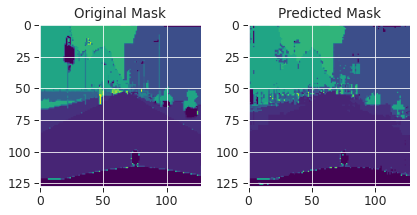

------------------------------------------------------------------------------------------------------------------------
| epoch 412 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22131  | train mIOU: 0.528 | train Dice Loss: -12.92989
------------------------------------------------------------------------------------------------------------------------
| end of epoch 412 | time: 41.52s | valid accuracy:    0.771 | valid loss: 1.35404 | valid mIOU: 0.194


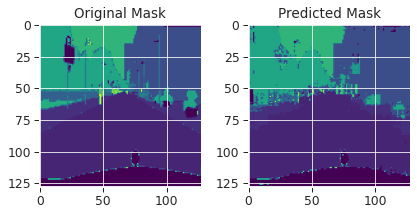

------------------------------------------------------------------------------------------------------------------------
| epoch 413 |   100/  185 batches | train accuracy    0.926 | train loss: 0.19807  | train mIOU: 0.582 | train Dice Loss: -12.97601
------------------------------------------------------------------------------------------------------------------------
| end of epoch 413 | time: 40.33s | valid accuracy:    0.770 | valid loss: 1.36156 | valid mIOU: 0.195


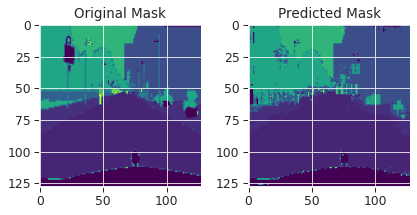

------------------------------------------------------------------------------------------------------------------------
| epoch 414 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21443  | train mIOU: 0.520 | train Dice Loss: -12.85106
------------------------------------------------------------------------------------------------------------------------
| end of epoch 414 | time: 40.85s | valid accuracy:    0.769 | valid loss: 1.36378 | valid mIOU: 0.196


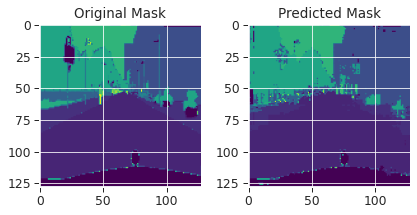

------------------------------------------------------------------------------------------------------------------------
| epoch 415 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24148  | train mIOU: 0.518 | train Dice Loss: -11.88681
------------------------------------------------------------------------------------------------------------------------
| end of epoch 415 | time: 41.32s | valid accuracy:    0.770 | valid loss: 1.35076 | valid mIOU: 0.193


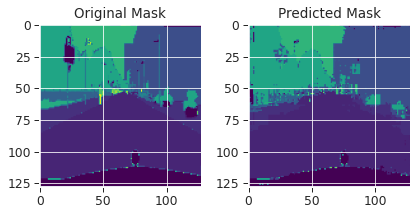

------------------------------------------------------------------------------------------------------------------------
| epoch 416 |   100/  185 batches | train accuracy    0.916 | train loss: 0.22900  | train mIOU: 0.521 | train Dice Loss: -13.18213
------------------------------------------------------------------------------------------------------------------------
| end of epoch 416 | time: 40.48s | valid accuracy:    0.771 | valid loss: 1.35337 | valid mIOU: 0.196


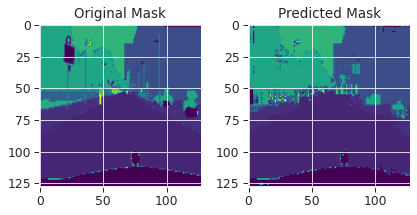

------------------------------------------------------------------------------------------------------------------------
| epoch 417 |   100/  185 batches | train accuracy    0.913 | train loss: 0.23651  | train mIOU: 0.530 | train Dice Loss: -13.72128
------------------------------------------------------------------------------------------------------------------------
| end of epoch 417 | time: 40.93s | valid accuracy:    0.771 | valid loss: 1.34859 | valid mIOU: 0.196


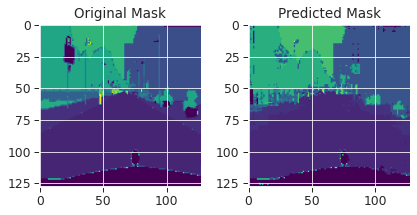

------------------------------------------------------------------------------------------------------------------------
| epoch 418 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21118  | train mIOU: 0.512 | train Dice Loss: -11.67903
------------------------------------------------------------------------------------------------------------------------
| end of epoch 418 | time: 40.77s | valid accuracy:    0.769 | valid loss: 1.38038 | valid mIOU: 0.195


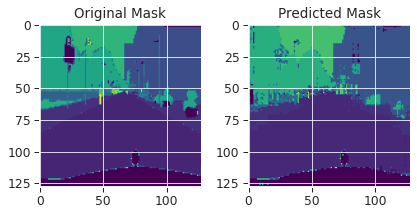

------------------------------------------------------------------------------------------------------------------------
| epoch 419 |   100/  185 batches | train accuracy    0.929 | train loss: 0.19208  | train mIOU: 0.511 | train Dice Loss: -12.71171
------------------------------------------------------------------------------------------------------------------------
| end of epoch 419 | time: 41.86s | valid accuracy:    0.771 | valid loss: 1.36390 | valid mIOU: 0.194


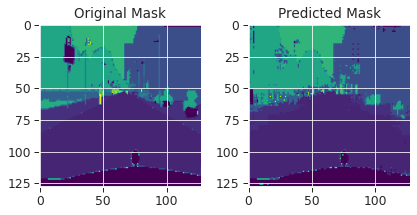

------------------------------------------------------------------------------------------------------------------------
| epoch 420 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23134  | train mIOU: 0.553 | train Dice Loss: -13.81220
------------------------------------------------------------------------------------------------------------------------
| end of epoch 420 | time: 40.28s | valid accuracy:    0.770 | valid loss: 1.36319 | valid mIOU: 0.195


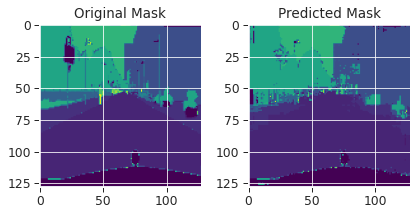

------------------------------------------------------------------------------------------------------------------------
| epoch 421 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21702  | train mIOU: 0.531 | train Dice Loss: -13.06113
------------------------------------------------------------------------------------------------------------------------
| end of epoch 421 | time: 40.93s | valid accuracy:    0.775 | valid loss: 1.35470 | valid mIOU: 0.197


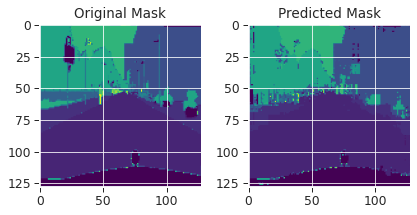

------------------------------------------------------------------------------------------------------------------------
| epoch 422 |   100/  185 batches | train accuracy    0.914 | train loss: 0.23468  | train mIOU: 0.530 | train Dice Loss: -13.66137
------------------------------------------------------------------------------------------------------------------------
| end of epoch 422 | time: 41.35s | valid accuracy:    0.768 | valid loss: 1.39381 | valid mIOU: 0.194


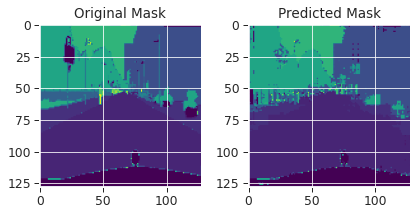

------------------------------------------------------------------------------------------------------------------------
| epoch 423 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21976  | train mIOU: 0.507 | train Dice Loss: -12.13414
------------------------------------------------------------------------------------------------------------------------
| end of epoch 423 | time: 40.86s | valid accuracy:    0.773 | valid loss: 1.36749 | valid mIOU: 0.195


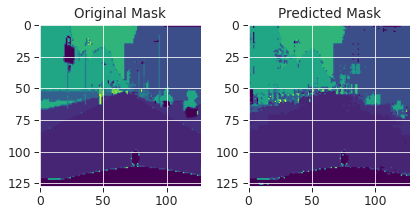

------------------------------------------------------------------------------------------------------------------------
| epoch 424 |   100/  185 batches | train accuracy    0.926 | train loss: 0.20101  | train mIOU: 0.502 | train Dice Loss: -13.74384
------------------------------------------------------------------------------------------------------------------------
| end of epoch 424 | time: 41.29s | valid accuracy:    0.770 | valid loss: 1.36275 | valid mIOU: 0.194


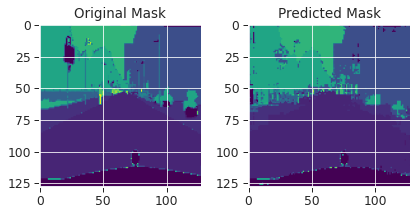

------------------------------------------------------------------------------------------------------------------------
| epoch 425 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20452  | train mIOU: 0.551 | train Dice Loss: -13.31085
------------------------------------------------------------------------------------------------------------------------
| end of epoch 425 | time: 42.17s | valid accuracy:    0.772 | valid loss: 1.37701 | valid mIOU: 0.196


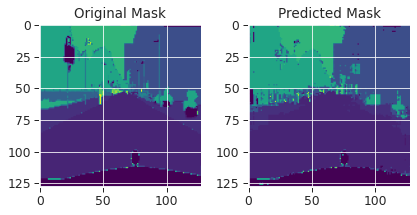

------------------------------------------------------------------------------------------------------------------------
| epoch 426 |   100/  185 batches | train accuracy    0.913 | train loss: 0.23591  | train mIOU: 0.523 | train Dice Loss: -13.19120
------------------------------------------------------------------------------------------------------------------------
| end of epoch 426 | time: 41.05s | valid accuracy:    0.774 | valid loss: 1.37027 | valid mIOU: 0.196


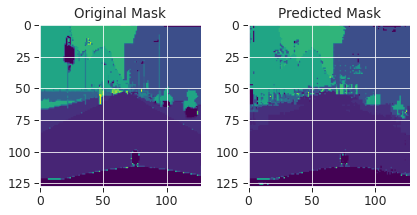

------------------------------------------------------------------------------------------------------------------------
| epoch 427 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19276  | train mIOU: 0.532 | train Dice Loss: -13.31447
------------------------------------------------------------------------------------------------------------------------
| end of epoch 427 | time: 41.34s | valid accuracy:    0.771 | valid loss: 1.35868 | valid mIOU: 0.196


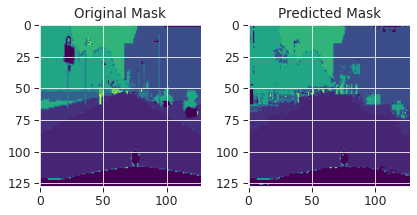

------------------------------------------------------------------------------------------------------------------------
| epoch 428 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20650  | train mIOU: 0.568 | train Dice Loss: -13.31532
------------------------------------------------------------------------------------------------------------------------
| end of epoch 428 | time: 40.89s | valid accuracy:    0.771 | valid loss: 1.37984 | valid mIOU: 0.195


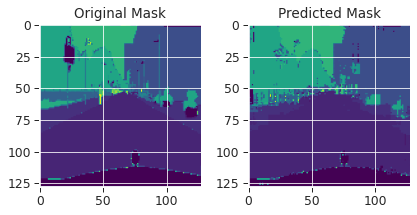

------------------------------------------------------------------------------------------------------------------------
| epoch 429 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20915  | train mIOU: 0.530 | train Dice Loss: -13.87128
------------------------------------------------------------------------------------------------------------------------
| end of epoch 429 | time: 40.86s | valid accuracy:    0.770 | valid loss: 1.33410 | valid mIOU: 0.195


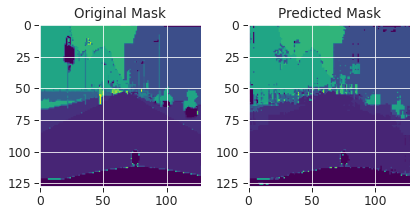

------------------------------------------------------------------------------------------------------------------------
| epoch 430 |   100/  185 batches | train accuracy    0.919 | train loss: 0.22113  | train mIOU: 0.507 | train Dice Loss: -12.78001
------------------------------------------------------------------------------------------------------------------------
| end of epoch 430 | time: 41.25s | valid accuracy:    0.771 | valid loss: 1.38509 | valid mIOU: 0.196


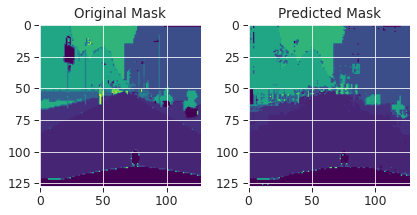

------------------------------------------------------------------------------------------------------------------------
| epoch 431 |   100/  185 batches | train accuracy    0.918 | train loss: 0.22555  | train mIOU: 0.547 | train Dice Loss: -13.87051
------------------------------------------------------------------------------------------------------------------------
| end of epoch 431 | time: 41.34s | valid accuracy:    0.772 | valid loss: 1.35567 | valid mIOU: 0.196


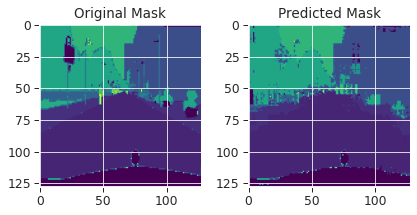

------------------------------------------------------------------------------------------------------------------------
| epoch 432 |   100/  185 batches | train accuracy    0.931 | train loss: 0.18370  | train mIOU: 0.521 | train Dice Loss: -12.67482
------------------------------------------------------------------------------------------------------------------------
| end of epoch 432 | time: 41.40s | valid accuracy:    0.771 | valid loss: 1.38351 | valid mIOU: 0.194


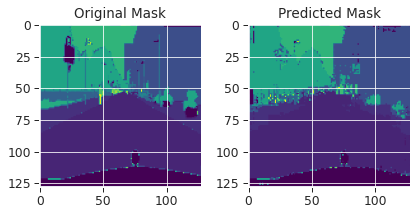

------------------------------------------------------------------------------------------------------------------------
| epoch 433 |   100/  185 batches | train accuracy    0.931 | train loss: 0.18599  | train mIOU: 0.514 | train Dice Loss: -12.27363
------------------------------------------------------------------------------------------------------------------------
| end of epoch 433 | time: 41.62s | valid accuracy:    0.771 | valid loss: 1.36610 | valid mIOU: 0.196


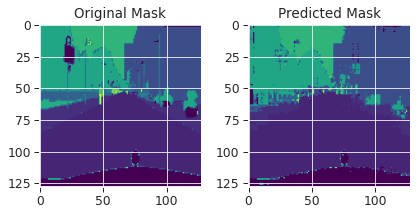

------------------------------------------------------------------------------------------------------------------------
| epoch 434 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23178  | train mIOU: 0.515 | train Dice Loss: -13.85879
------------------------------------------------------------------------------------------------------------------------
| end of epoch 434 | time: 41.37s | valid accuracy:    0.771 | valid loss: 1.38434 | valid mIOU: 0.196


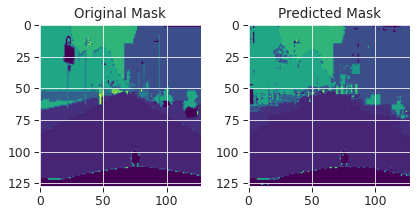

------------------------------------------------------------------------------------------------------------------------
| epoch 435 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20709  | train mIOU: 0.536 | train Dice Loss: -11.76884
------------------------------------------------------------------------------------------------------------------------
| end of epoch 435 | time: 41.05s | valid accuracy:    0.770 | valid loss: 1.39976 | valid mIOU: 0.194


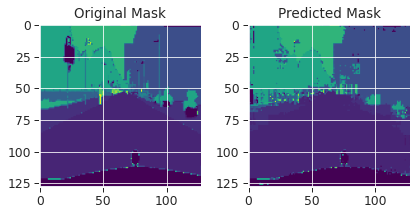

------------------------------------------------------------------------------------------------------------------------
| epoch 436 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24398  | train mIOU: 0.552 | train Dice Loss: -13.21564
------------------------------------------------------------------------------------------------------------------------
| end of epoch 436 | time: 40.70s | valid accuracy:    0.769 | valid loss: 1.38547 | valid mIOU: 0.195


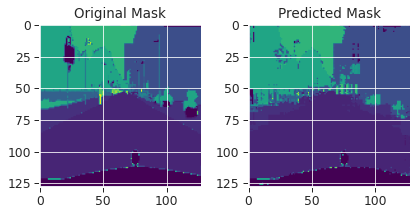

------------------------------------------------------------------------------------------------------------------------
| epoch 437 |   100/  185 batches | train accuracy    0.933 | train loss: 0.18395  | train mIOU: 0.515 | train Dice Loss: -13.16695
------------------------------------------------------------------------------------------------------------------------
| end of epoch 437 | time: 41.13s | valid accuracy:    0.770 | valid loss: 1.36811 | valid mIOU: 0.197


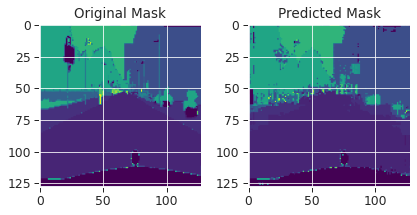

------------------------------------------------------------------------------------------------------------------------
| epoch 438 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21824  | train mIOU: 0.511 | train Dice Loss: -13.37616
------------------------------------------------------------------------------------------------------------------------
| end of epoch 438 | time: 41.52s | valid accuracy:    0.770 | valid loss: 1.38791 | valid mIOU: 0.195


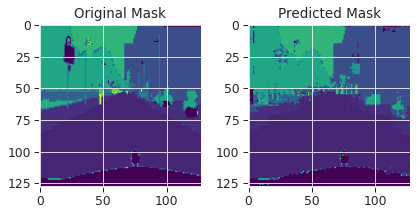

------------------------------------------------------------------------------------------------------------------------
| epoch 439 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19608  | train mIOU: 0.552 | train Dice Loss: -12.33142
------------------------------------------------------------------------------------------------------------------------
| end of epoch 439 | time: 39.66s | valid accuracy:    0.768 | valid loss: 1.38028 | valid mIOU: 0.193


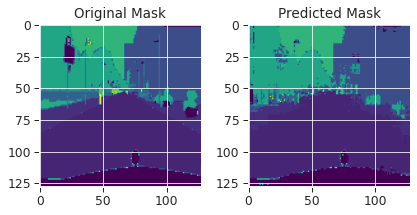

------------------------------------------------------------------------------------------------------------------------
| epoch 440 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19819  | train mIOU: 0.523 | train Dice Loss: -12.70670
------------------------------------------------------------------------------------------------------------------------
| end of epoch 440 | time: 42.07s | valid accuracy:    0.772 | valid loss: 1.36257 | valid mIOU: 0.197


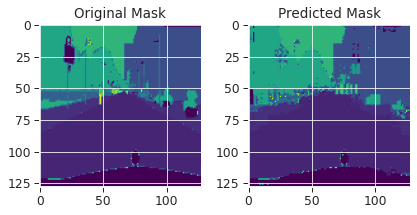

------------------------------------------------------------------------------------------------------------------------
| epoch 441 |   100/  185 batches | train accuracy    0.922 | train loss: 0.20910  | train mIOU: 0.540 | train Dice Loss: -13.42888
------------------------------------------------------------------------------------------------------------------------
| end of epoch 441 | time: 41.45s | valid accuracy:    0.772 | valid loss: 1.36083 | valid mIOU: 0.197


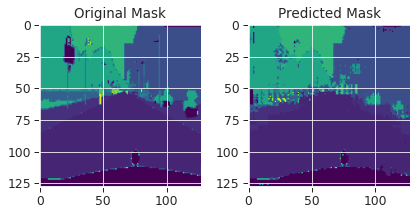

------------------------------------------------------------------------------------------------------------------------
| epoch 442 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24355  | train mIOU: 0.531 | train Dice Loss: -13.37021
------------------------------------------------------------------------------------------------------------------------
| end of epoch 442 | time: 41.24s | valid accuracy:    0.773 | valid loss: 1.37789 | valid mIOU: 0.196


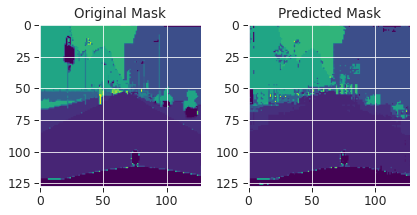

------------------------------------------------------------------------------------------------------------------------
| epoch 443 |   100/  185 batches | train accuracy    0.917 | train loss: 0.22416  | train mIOU: 0.508 | train Dice Loss: -13.11139
------------------------------------------------------------------------------------------------------------------------
| end of epoch 443 | time: 40.78s | valid accuracy:    0.770 | valid loss: 1.42077 | valid mIOU: 0.195


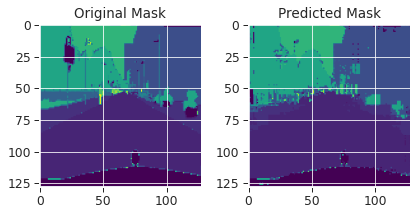

------------------------------------------------------------------------------------------------------------------------
| epoch 444 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20416  | train mIOU: 0.544 | train Dice Loss: -13.25363
------------------------------------------------------------------------------------------------------------------------
| end of epoch 444 | time: 41.39s | valid accuracy:    0.769 | valid loss: 1.41043 | valid mIOU: 0.194


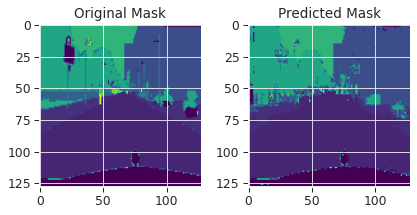

------------------------------------------------------------------------------------------------------------------------
| epoch 445 |   100/  185 batches | train accuracy    0.915 | train loss: 0.23300  | train mIOU: 0.496 | train Dice Loss: -12.95706
------------------------------------------------------------------------------------------------------------------------
| end of epoch 445 | time: 41.68s | valid accuracy:    0.770 | valid loss: 1.37616 | valid mIOU: 0.195


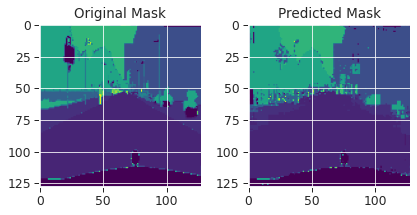

------------------------------------------------------------------------------------------------------------------------
| epoch 446 |   100/  185 batches | train accuracy    0.918 | train loss: 0.22274  | train mIOU: 0.512 | train Dice Loss: -13.00694
------------------------------------------------------------------------------------------------------------------------
| end of epoch 446 | time: 41.33s | valid accuracy:    0.772 | valid loss: 1.38141 | valid mIOU: 0.195


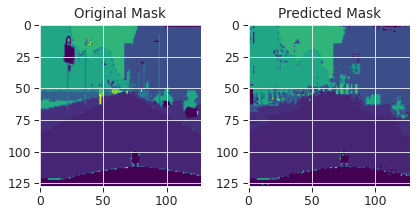

------------------------------------------------------------------------------------------------------------------------
| epoch 447 |   100/  185 batches | train accuracy    0.927 | train loss: 0.19805  | train mIOU: 0.532 | train Dice Loss: -12.50866
------------------------------------------------------------------------------------------------------------------------
| end of epoch 447 | time: 41.25s | valid accuracy:    0.771 | valid loss: 1.37305 | valid mIOU: 0.196


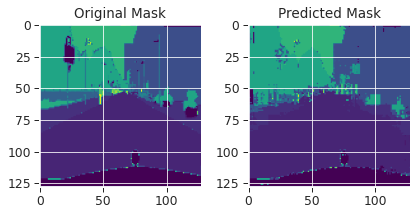

------------------------------------------------------------------------------------------------------------------------
| epoch 448 |   100/  185 batches | train accuracy    0.912 | train loss: 0.23933  | train mIOU: 0.566 | train Dice Loss: -13.26595
------------------------------------------------------------------------------------------------------------------------
| end of epoch 448 | time: 41.07s | valid accuracy:    0.772 | valid loss: 1.38934 | valid mIOU: 0.197


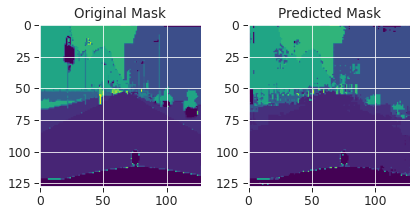

------------------------------------------------------------------------------------------------------------------------
| epoch 449 |   100/  185 batches | train accuracy    0.924 | train loss: 0.19874  | train mIOU: 0.547 | train Dice Loss: -12.90767
------------------------------------------------------------------------------------------------------------------------
| end of epoch 449 | time: 40.64s | valid accuracy:    0.772 | valid loss: 1.40029 | valid mIOU: 0.195


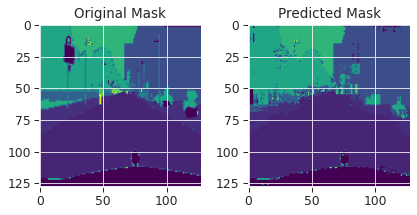

------------------------------------------------------------------------------------------------------------------------
| epoch 450 |   100/  185 batches | train accuracy    0.921 | train loss: 0.21280  | train mIOU: 0.504 | train Dice Loss: -12.89963
------------------------------------------------------------------------------------------------------------------------
| end of epoch 450 | time: 41.34s | valid accuracy:    0.771 | valid loss: 1.39183 | valid mIOU: 0.195


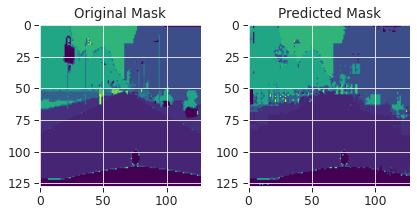

------------------------------------------------------------------------------------------------------------------------
| epoch 451 |   100/  185 batches | train accuracy    0.922 | train loss: 0.20835  | train mIOU: 0.516 | train Dice Loss: -12.76164
------------------------------------------------------------------------------------------------------------------------
| end of epoch 451 | time: 42.81s | valid accuracy:    0.769 | valid loss: 1.41011 | valid mIOU: 0.196


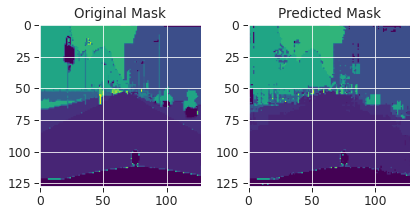

------------------------------------------------------------------------------------------------------------------------
| epoch 452 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20716  | train mIOU: 0.520 | train Dice Loss: -13.72214
------------------------------------------------------------------------------------------------------------------------
| end of epoch 452 | time: 41.33s | valid accuracy:    0.772 | valid loss: 1.40398 | valid mIOU: 0.197


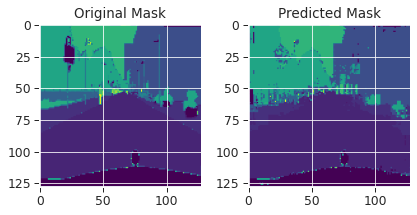

------------------------------------------------------------------------------------------------------------------------
| epoch 453 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19749  | train mIOU: 0.514 | train Dice Loss: -12.89874
------------------------------------------------------------------------------------------------------------------------
| end of epoch 453 | time: 41.33s | valid accuracy:    0.770 | valid loss: 1.41434 | valid mIOU: 0.195


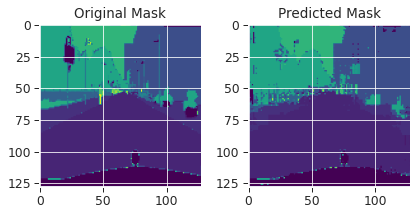

------------------------------------------------------------------------------------------------------------------------
| epoch 454 |   100/  185 batches | train accuracy    0.931 | train loss: 0.18845  | train mIOU: 0.550 | train Dice Loss: -12.90676
------------------------------------------------------------------------------------------------------------------------
| end of epoch 454 | time: 41.45s | valid accuracy:    0.770 | valid loss: 1.41193 | valid mIOU: 0.194


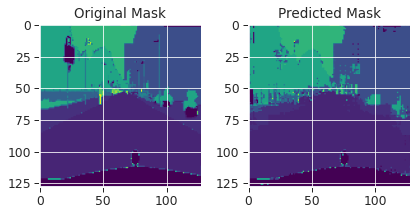

------------------------------------------------------------------------------------------------------------------------
| epoch 455 |   100/  185 batches | train accuracy    0.919 | train loss: 0.21691  | train mIOU: 0.533 | train Dice Loss: -12.30547
------------------------------------------------------------------------------------------------------------------------
| end of epoch 455 | time: 42.27s | valid accuracy:    0.771 | valid loss: 1.39823 | valid mIOU: 0.193


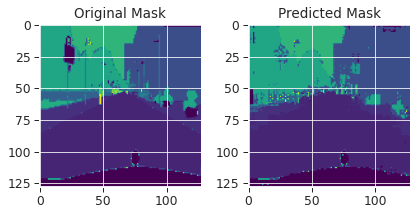

------------------------------------------------------------------------------------------------------------------------
| epoch 456 |   100/  185 batches | train accuracy    0.935 | train loss: 0.17532  | train mIOU: 0.574 | train Dice Loss: -13.06287
------------------------------------------------------------------------------------------------------------------------
| end of epoch 456 | time: 41.34s | valid accuracy:    0.771 | valid loss: 1.40809 | valid mIOU: 0.195


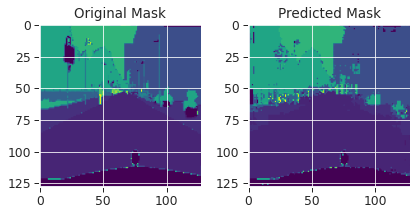

------------------------------------------------------------------------------------------------------------------------
| epoch 457 |   100/  185 batches | train accuracy    0.919 | train loss: 0.21835  | train mIOU: 0.521 | train Dice Loss: -11.89654
------------------------------------------------------------------------------------------------------------------------
| end of epoch 457 | time: 41.07s | valid accuracy:    0.770 | valid loss: 1.43581 | valid mIOU: 0.194


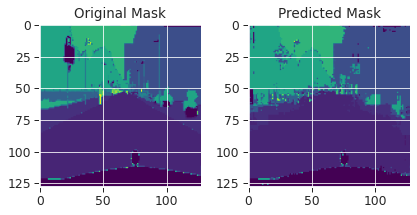

------------------------------------------------------------------------------------------------------------------------
| epoch 458 |   100/  185 batches | train accuracy    0.922 | train loss: 0.20892  | train mIOU: 0.536 | train Dice Loss: -12.84473
------------------------------------------------------------------------------------------------------------------------
| end of epoch 458 | time: 40.93s | valid accuracy:    0.772 | valid loss: 1.39054 | valid mIOU: 0.196


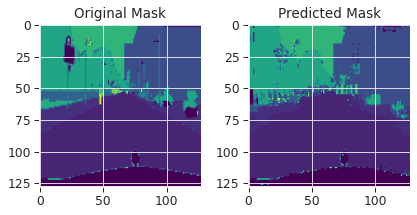

------------------------------------------------------------------------------------------------------------------------
| epoch 459 |   100/  185 batches | train accuracy    0.912 | train loss: 0.24054  | train mIOU: 0.502 | train Dice Loss: -12.41862
------------------------------------------------------------------------------------------------------------------------
| end of epoch 459 | time: 40.61s | valid accuracy:    0.770 | valid loss: 1.41723 | valid mIOU: 0.197


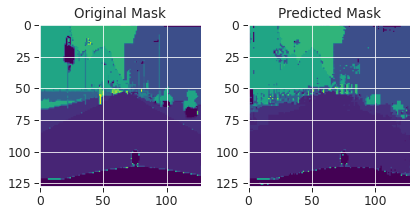

------------------------------------------------------------------------------------------------------------------------
| epoch 460 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20350  | train mIOU: 0.522 | train Dice Loss: -12.43504
------------------------------------------------------------------------------------------------------------------------
| end of epoch 460 | time: 42.86s | valid accuracy:    0.772 | valid loss: 1.39743 | valid mIOU: 0.196


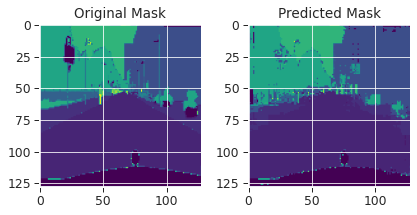

------------------------------------------------------------------------------------------------------------------------
| epoch 461 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20409  | train mIOU: 0.544 | train Dice Loss: -11.44622
------------------------------------------------------------------------------------------------------------------------
| end of epoch 461 | time: 41.11s | valid accuracy:    0.769 | valid loss: 1.41502 | valid mIOU: 0.194


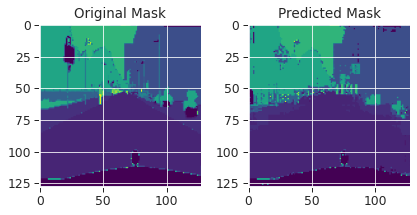

------------------------------------------------------------------------------------------------------------------------
| epoch 462 |   100/  185 batches | train accuracy    0.911 | train loss: 0.24035  | train mIOU: 0.522 | train Dice Loss: -12.96687
------------------------------------------------------------------------------------------------------------------------
| end of epoch 462 | time: 41.13s | valid accuracy:    0.768 | valid loss: 1.40893 | valid mIOU: 0.193


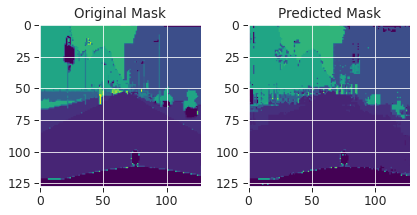

------------------------------------------------------------------------------------------------------------------------
| epoch 463 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21064  | train mIOU: 0.532 | train Dice Loss: -12.87885
------------------------------------------------------------------------------------------------------------------------
| end of epoch 463 | time: 41.02s | valid accuracy:    0.768 | valid loss: 1.41253 | valid mIOU: 0.194


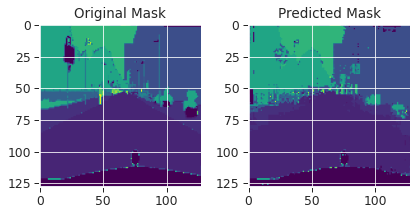

------------------------------------------------------------------------------------------------------------------------
| epoch 464 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21040  | train mIOU: 0.534 | train Dice Loss: -12.88438
------------------------------------------------------------------------------------------------------------------------
| end of epoch 464 | time: 40.63s | valid accuracy:    0.770 | valid loss: 1.41738 | valid mIOU: 0.194


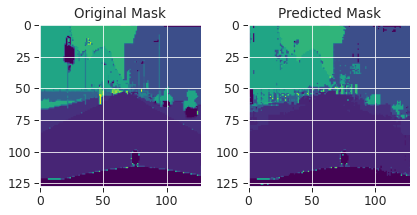

------------------------------------------------------------------------------------------------------------------------
| epoch 465 |   100/  185 batches | train accuracy    0.911 | train loss: 0.23816  | train mIOU: 0.531 | train Dice Loss: -13.66207
------------------------------------------------------------------------------------------------------------------------
| end of epoch 465 | time: 40.57s | valid accuracy:    0.768 | valid loss: 1.42506 | valid mIOU: 0.193


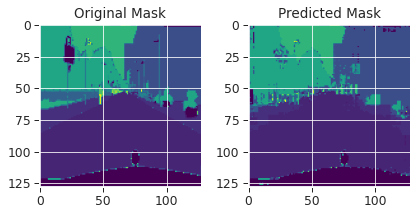

------------------------------------------------------------------------------------------------------------------------
| epoch 466 |   100/  185 batches | train accuracy    0.915 | train loss: 0.22802  | train mIOU: 0.567 | train Dice Loss: -12.92353
------------------------------------------------------------------------------------------------------------------------
| end of epoch 466 | time: 40.93s | valid accuracy:    0.771 | valid loss: 1.40942 | valid mIOU: 0.195


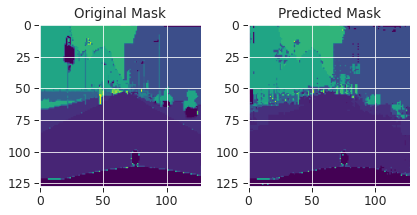

------------------------------------------------------------------------------------------------------------------------
| epoch 467 |   100/  185 batches | train accuracy    0.912 | train loss: 0.23914  | train mIOU: 0.536 | train Dice Loss: -12.27958
------------------------------------------------------------------------------------------------------------------------
| end of epoch 467 | time: 35.75s | valid accuracy:    0.771 | valid loss: 1.41776 | valid mIOU: 0.196


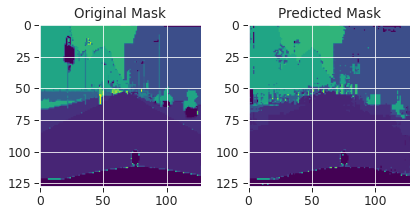

------------------------------------------------------------------------------------------------------------------------
| epoch 468 |   100/  185 batches | train accuracy    0.926 | train loss: 0.20026  | train mIOU: 0.521 | train Dice Loss: -13.53432
------------------------------------------------------------------------------------------------------------------------
| end of epoch 468 | time: 40.80s | valid accuracy:    0.771 | valid loss: 1.42181 | valid mIOU: 0.197


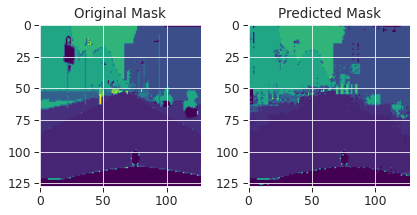

------------------------------------------------------------------------------------------------------------------------
| epoch 469 |   100/  185 batches | train accuracy    0.923 | train loss: 0.20556  | train mIOU: 0.541 | train Dice Loss: -12.90198
------------------------------------------------------------------------------------------------------------------------
| end of epoch 469 | time: 37.93s | valid accuracy:    0.770 | valid loss: 1.43220 | valid mIOU: 0.194


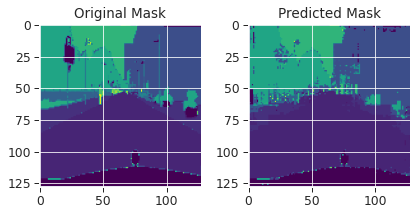

------------------------------------------------------------------------------------------------------------------------
| epoch 470 |   100/  185 batches | train accuracy    0.925 | train loss: 0.19560  | train mIOU: 0.536 | train Dice Loss: -12.70067
------------------------------------------------------------------------------------------------------------------------
| end of epoch 470 | time: 33.98s | valid accuracy:    0.768 | valid loss: 1.43003 | valid mIOU: 0.194


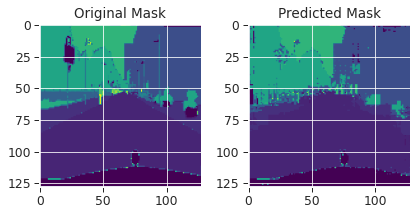

------------------------------------------------------------------------------------------------------------------------
| epoch 471 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20373  | train mIOU: 0.546 | train Dice Loss: -13.39515
------------------------------------------------------------------------------------------------------------------------
| end of epoch 471 | time: 40.82s | valid accuracy:    0.771 | valid loss: 1.42953 | valid mIOU: 0.197


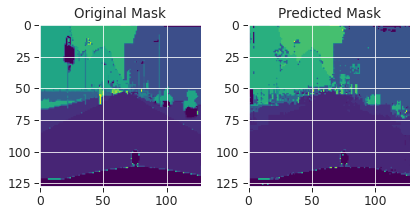

------------------------------------------------------------------------------------------------------------------------
| epoch 472 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20330  | train mIOU: 0.508 | train Dice Loss: -13.27968
------------------------------------------------------------------------------------------------------------------------
| end of epoch 472 | time: 41.31s | valid accuracy:    0.770 | valid loss: 1.42900 | valid mIOU: 0.194


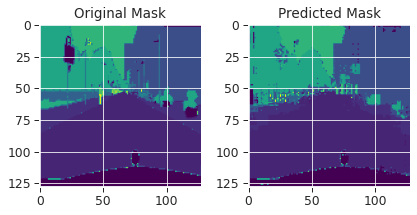

------------------------------------------------------------------------------------------------------------------------
| epoch 473 |   100/  185 batches | train accuracy    0.928 | train loss: 0.19030  | train mIOU: 0.507 | train Dice Loss: -13.08953
------------------------------------------------------------------------------------------------------------------------
| end of epoch 473 | time: 40.90s | valid accuracy:    0.771 | valid loss: 1.42085 | valid mIOU: 0.196


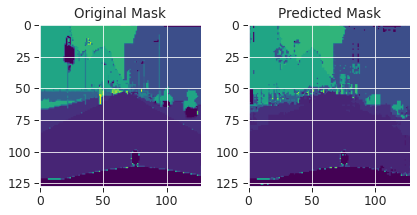

------------------------------------------------------------------------------------------------------------------------
| epoch 474 |   100/  185 batches | train accuracy    0.920 | train loss: 0.21701  | train mIOU: 0.535 | train Dice Loss: -13.47166
------------------------------------------------------------------------------------------------------------------------
| end of epoch 474 | time: 40.85s | valid accuracy:    0.771 | valid loss: 1.43432 | valid mIOU: 0.195


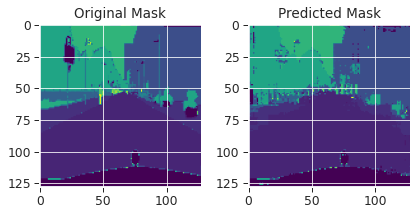

------------------------------------------------------------------------------------------------------------------------
| epoch 475 |   100/  185 batches | train accuracy    0.927 | train loss: 0.19399  | train mIOU: 0.524 | train Dice Loss: -12.58852
------------------------------------------------------------------------------------------------------------------------
| end of epoch 475 | time: 40.65s | valid accuracy:    0.768 | valid loss: 1.43306 | valid mIOU: 0.195


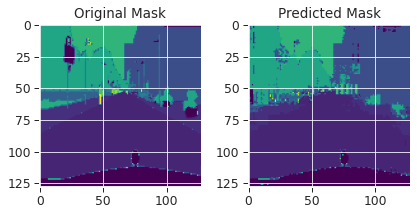

------------------------------------------------------------------------------------------------------------------------
| epoch 476 |   100/  185 batches | train accuracy    0.922 | train loss: 0.21047  | train mIOU: 0.540 | train Dice Loss: -12.75244
------------------------------------------------------------------------------------------------------------------------
| end of epoch 476 | time: 41.01s | valid accuracy:    0.771 | valid loss: 1.40261 | valid mIOU: 0.195


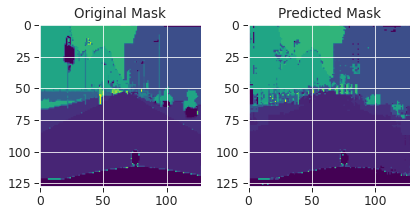

------------------------------------------------------------------------------------------------------------------------
| epoch 477 |   100/  185 batches | train accuracy    0.924 | train loss: 0.20350  | train mIOU: 0.537 | train Dice Loss: -13.25481
------------------------------------------------------------------------------------------------------------------------
| end of epoch 477 | time: 40.68s | valid accuracy:    0.772 | valid loss: 1.39614 | valid mIOU: 0.196


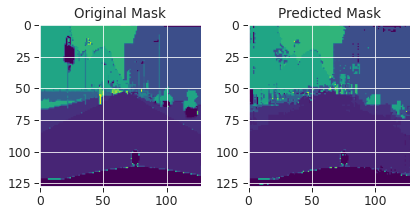

------------------------------------------------------------------------------------------------------------------------
| epoch 478 |   100/  185 batches | train accuracy    0.922 | train loss: 0.20949  | train mIOU: 0.535 | train Dice Loss: -13.37931
------------------------------------------------------------------------------------------------------------------------
| end of epoch 478 | time: 41.14s | valid accuracy:    0.771 | valid loss: 1.44946 | valid mIOU: 0.194


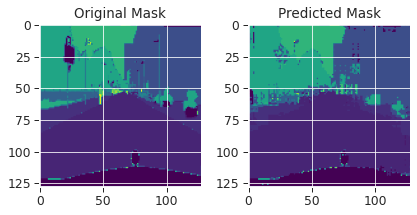

------------------------------------------------------------------------------------------------------------------------
| epoch 479 |   100/  185 batches | train accuracy    0.925 | train loss: 0.20197  | train mIOU: 0.536 | train Dice Loss: -12.71796


KeyboardInterrupt: 

In [13]:
# Model Training

batch_size = 16
train_loader = make_dataloader(X_train.numpy(), Y_train.numpy(), batch_size, True)
val_loader = make_dataloader(X_valid.numpy(), Y_valid.numpy(), batch_size, False)

# Hyperparameters
epochs = 4000 # epoch
lr = 0.00006
gradient_norm_clips = 0.1
gradient_norm_clip = 1

optimizer = torch.optim.AdamW(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs, 1e-8)

total_accu = None
for epoch in range(1, epochs + 1):
    
    epoch_start_time = time.time()
    train(model, train_loader, loss_func, device, gradient_norm_clip)
    # accu_val, accu_loss, iou = evaluate(model, val_loader, loss_func, device)
    accu_val, accu_loss, mean_IOU, dice = evaluate(model, val_loader, loss_func, device)
    if total_accu is not None and total_accu > accu_val:
        scheduler.step()
    else:
        total_accu = accu_val
    print('-' * 120)
    print('| end of epoch {:3d} | time: {:5.2f}s | '
          'valid accuracy: {:8.3f} | valid loss: {:.5f} | valid mIOU: {:.3f}'.format(epoch,
                                           time.time() - epoch_start_time,
                                           accu_val, accu_loss, mean_IOU))
    viz_callback = VizCallback("cityscapes_data/val/106.jpg")
    viz_callback.on_epoch_end(model)
    print('-' * 120)

In [18]:
torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict()}, "model_check/ssformer.pth")

479

In [20]:
model.state_dict()

OrderedDict([('stage1.patch_partition.linear.weight',
              tensor([[ 0.1260, -0.0879, -0.0183,  ..., -0.1395, -0.1494, -0.0042],
                      [-0.0012, -0.0013,  0.1048,  ...,  0.0185,  0.1976, -0.1395],
                      [ 0.0022, -0.0734,  0.0077,  ..., -0.1209,  0.0684,  0.0810],
                      ...,
                      [-0.1311, -0.1549,  0.0387,  ...,  0.0049,  0.0410,  0.1027],
                      [-0.1066,  0.1173,  0.0515,  ..., -0.1670, -0.0049, -0.1141],
                      [ 0.1256, -0.0117,  0.0576,  ..., -0.0908, -0.1326,  0.1182]],
                     device='cuda:0')),
             ('stage1.patch_partition.linear.bias',
              tensor([-0.0385, -0.0892, -0.1267,  0.0211,  0.0497,  0.0490, -0.0709, -0.0502,
                       0.1003,  0.1337, -0.0665, -0.0893,  0.0723,  0.1045,  0.1396, -0.0543,
                      -0.0292, -0.0597,  0.0274, -0.1016, -0.0138,  0.0626, -0.0478, -0.0557,
                      -0.0070,  0.1350, 